# Imports

In [1]:
# Set jemalloc config early
import os
import psutil

# os.environ["POLARS_VERBOSE"]=str(1)

os.environ["POLARS_MAX_THREADS"] = str(max(1, int(psutil.cpu_count(logical=False) / 1)))
print(f"Using {os.environ['POLARS_MAX_THREADS']} polars threads")
os.environ["_RJEM_MALLOC_CONF"] = "muzzy_decay_ms:500"  # prevents memory leak in polars

Using 16 polars threads


In [2]:
import logging
from pyutilz.logginglib import init_logging

logger = init_logging(
    default_caller_name="astronomy.py",
    level=logging.INFO,
    format="%(asctime)s - %(levelname)s - %(funcName)s-line:%(lineno)d - %(message)s",
)

logger.info(f"test")

2026-01-15 00:58:04,117 - INFO - <module>-line:10 - test


In [26]:
try:
    from IPython.core.display import display, HTML

    display(HTML("<style>.container { width:100% !important; }</style>"))
except Exception as e:
    pass

%load_ext memory_profiler
%load_ext jupyter_black
%load_ext line_profiler
%load_ext autoreload
%load_ext autotime
%autosave 300
%autoreload 2

C:\Users\Administrator\AppData\Local\Temp\ipykernel_12732\3193644951.py:2: DeprecationWarning:

Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display



The memory_profiler extension is already loaded. To reload it, use:
  %reload_ext memory_profiler
The jupyter_black extension is already loaded. To reload it, use:
  %reload_ext jupyter_black
The line_profiler extension is already loaded. To reload it, use:
  %reload_ext line_profiler
The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
The autotime extension is already loaded. To reload it, use:
  %reload_ext autotime


Autosaving every 300 seconds
time: 31 ms (started: 2026-01-15 02:11:15 +03:00)


In [27]:
from astro_flares import *

import plotly.io as pio

pio.renderers.default = "jupyterlab"  # или "jupyterlab" если JupyterLab

time: 15 ms (started: 2026-01-15 02:11:17 +03:00)


In [28]:
from mlframe.training.core import train_mlframe_models_suite
from mlframe.profiling.profile_training import create_synthetic_data
from mlframe.training.extractors import SimpleFeaturesAndTargetsExtractor
from mlframe.training.configs import PolarsPipelineConfig, TrainingSplitConfig

from mlframe.training_old import report_model_perf

show_perf_chart = True
report_title = "OOS"
charts_dir = None

report_params = {
    "report_ndigits": 2,
    "calib_report_ndigits": 2,
    "print_report": True,
    "report_title": report_title,
    "use_weights": True,
    "show_perf_chart": show_perf_chart,
}

time: 0 ns (started: 2026-01-15 02:11:18 +03:00)


In [29]:
from recurrent_classifier import RecurrentClassifierWrapper, RecurrentConfig, InputMode
from build_labeled_dataset import (
    train_recurrent_classifier,
    build_labeled_dataset,
    _extract_sequence_from_hf_dataset,
    prepare_recurrent_training_data,
)
from recurrent_classifier import RNNType, InputMode

from os.path import join
from labels import surely_pos, surely_neg, maybe_neg
from active_learning_pipeline import run_active_learning_pipeline

time: 0 ns (started: 2026-01-15 02:11:19 +03:00)


In [7]:
dataset = load_dataset(
    "snad-space/ztf-m-dwarf-flares-2025", cache_dir="R:\Caches\huggingface"
)
dataset

Resolving data files:   0%|          | 0/314 [00:00<?, ?it/s]

Resolving data files:   0%|          | 0/314 [00:00<?, ?it/s]

Loading dataset shards:   0%|          | 0/124 [00:00<?, ?it/s]

DatasetDict({
    train: Dataset({
        features: ['id', 'class', 'mjd', 'mag', 'magerr'],
        num_rows: 1620543
    })
    test: Dataset({
        features: ['id', 'class', 'mjd', 'mag', 'magerr'],
        num_rows: 99
    })
    target: Dataset({
        features: ['id', 'class', 'mjd', 'mag', 'magerr'],
        num_rows: 94028217
    })
})

time: 47.5 s (started: 2026-01-15 00:59:33 +03:00)


In [12]:
COLS_TO_USE = [
    "id",
    "class",
    "norm_to_argmin_q25",
    "norm_to_argmin_mean",
    "velocity_from_argmin_mean",
    "norm_wv_haar_d4_skewness",
    "norm_from_argmin_n_below_2sigma",
    "velocity_from_argmin_max",
    "norm_wv_sym4_d1_kurtosis",
    "velocity_from_argmin_skewness",
    "norm_max_consecutive_below_2sigma",
    "norm_wv_sym4_d2_kurtosis",
    "norm_wv_haar_d5_skewness",
    "norm_wv_haar_d2_mean",
    "norm_wv_haar_d3_skewness",
    "vel_max_consecutive_above_1sigma",
    "mag_kurtosis",
    "norm_to_argmin_kurtosis",
    "mag_skewness",
    "norm_wv_db6_d1_kurtosis",
    "norm_wv_db4_d1_rel_energy",
    "norm_wv_haar_d3_rel_energy",
    "norm_max_consecutive_frac_below_2sigma",
    "norm_from_argmin_iqr",
    "norm_rise_decay_time_ratio",
    "norm_wv_db4_d1_kurtosis",
    "norm_first_second_half_diff",
    "norm_wv_haar_detail_ratio",
    "norm_from_argmin_q25",
    "mag_to_argmin_kurtosis",
    "velocity_from_argmin_median",
    "vel_frac_below_1sigma",
    "norm_from_argmin_std",
    "norm_n_runs_above_1sigma",
    "norm_wv_db4_d1_mad",
    "velocity_to_argmin_min",
    "velocity_from_argmin_std",
    "vel_frac_below_2sigma",
    "mag_to_argmin_n_below_2sigma",
    "norm_wv_haar_d3_mean",
    "velocity_from_argmin_q25",
    "norm_wv_haar_d2_rel_energy",
    "norm_to_argmin_min",
    "norm_wv_sym4_d2_skewness",
    "norm_from_argmin_q75",
    "vel_first_second_half_diff",
    "mjd_diff_kurtosis",
    "mjd_diff_trend_changes",
    "velocity_from_argmin_len",
    "norm_to_argmin_energy",
    "vel_run_length_ratio",
    "norm_q25",
    "norm_wv_db4_d3_energy",
    "norm_wv_haar_detail_approx_ratio",
    "norm_mean_run_below_2sigma",
    "mag_from_argmin_slope",
    "norm_n_below_3sigma",
    "velocity_from_argmin_q75",
    "norm_run_length_ratio",
    "velocity_to_argmin_max",
    "velocity_to_argmin_mean",
    "norm_to_argmin_n_below_2sigma",
    "norm_from_argmin_slope",
    "norm_kurtosis",
    "norm_wv_db4_d2_skewness",
    "norm_to_argmin_median",
    "norm_wv_sym4_d1_rel_energy",
    "norm_wv_db6_max_detail",
    "mjd_diff_std",
    "mjd_diff_mean",
    "vel_mean_run_above_1sigma",
    "norm_wv_haar_d2_kurtosis",
    "norm_from_argmin_energy",
    "mjd_span",
    "norm_from_argmin_max",
    "norm_wv_haar_d3_mad",
    "vel_peak_depth",
    "norm_n_zero_crossings",
    "norm_frac_below_1sigma",
    "mag_from_argmin_skewness",
    "norm_wv_haar_d2_std",
    "norm_to_argmin_range",
    "mag_from_argmin_range",
    "mag_from_argmin_energy",
    "norm_wv_db4_d3_kurtosis",
    "norm_from_argmin_skewness",
    "norm_wv_haar_d1_mean",
    "mag_first_second_half_diff",
    "norm_rise_decay_idx_ratio",
    "norm_wv_sym4_d1_skewness",
    "norm_from_argmin_mean",
    "norm_wv_sym4_d3_mad",
    "norm_frac_below_3sigma",
    "norm_wv_haar_d1_rel_energy",
    "norm_wv_db4_d2_rel_energy",
    "velocity_to_argmin_median",
    "norm_std",
    "norm_max",
    "norm_wv_haar_d4_rel_energy",
    "norm_wv_db4_d2_mean",
    "norm_frac_zero_crossings",
    "mag_monotonic_ratio",
    "norm_wv_sym4_d3_rel_energy",
    "norm_frac_local_minima",
    "norm_from_argmin_n_below_3sigma",
    "velocity_from_argmin_n_above_3sigma",
    "norm_wv_coif3_d1_mean",
    "norm_wv_haar_d4_mad",
    "norm_wv_haar_entropy",
    "norm_wv_haar_d1_std",
    "velocity_to_argmin_skewness",
    "norm_wv_sym4_max_detail",
    "norm_wv_db4_d1_std",
    "norm_wv_db4_d3_mad",
    "norm_wv_haar_d3_kurtosis",
    "norm_peak_position_ratio",
    "norm_wv_haar_d2_energy",
    "norm_wv_sym4_d3_kurtosis",
    "norm_wv_db6_d2_mad",
    "norm_skewness",
    "vel_rise_decay_idx_ratio",
    "norm_from_argmin_median",
    "mag_n_unique",
    "mag_peak_depth",
    "norm_wv_coif3_d1_kurtosis",
    "norm_wv_db4_d3_frac_above_2std",
    "velocity_to_argmin_q75",
    "norm_to_argmin_iqr",
    "vel_minima_maxima_ratio",
    "norm_wv_haar_d1_skewness",
    "norm_wv_db4_d2_kurtosis",
    "norm_wv_db6_d1_mean",
    "mag_first",
    "norm_wv_db6_d2_frac_above_2std",
    "norm_wv_db4_d3_std",
    "norm_wv_db4_d1_skewness",
    "norm_to_argmin_skewness",
    "mag_to_argmin_slope",
    "norm_wv_db4_max_detail",
    "norm_wv_sym4_d3_mean",
    "norm_wv_sym4_entropy",
    "norm_wv_db6_d1_rel_energy",
    "velocity_to_argmin_kurtosis",
    "norm_wv_db6_d1_skewness",
    "norm_wv_db6_d2_kurtosis",
    "norm_wv_haar_d4_mean",
    "norm_wv_sym4_d1_mad",
    "norm_wv_db4_entropy",
    "norm_wv_haar_d5_frac_above_2std",
    "velocity_from_argmin_energy",
    "norm_wv_haar_d5_mean",
    "norm_wv_db4_detail_ratio",
    "norm_from_argmin_range",
    "norm_last",
    "mag_from_argmin_len",
    "norm_wv_sym4_d2_rel_energy",
    "velocity_from_argmin_range",
    "velocity_from_argmin_kurtosis",
    "norm_to_argmin_max",
    "mag_longest_monotonic_increase",
    "norm_min",
    "norm_wv_db6_d1_std",
    "norm_wv_haar_max_detail",
    "mag_from_argmin_std",
    "norm_wv_haar_d3_std",
    "magerr_entropy",
    "velocity_from_argmin_slope",
    "norm_wv_db4_d1_energy",
    "norm_wv_haar_d4_std",
    "norm_frac_below_2sigma",
    "mag_arg_max",
    "norm_wv_sym4_d2_mean",
    "norm_mean_run_above_1sigma",
    "norm_q75",
    "magerr_arg_max",
    "norm_wv_haar_d5_kurtosis",
    "mag_to_argmin_skewness",
    "norm_wv_haar_d2_mad",
    "norm_to_argmin_q75",
    "mag_minima_maxima_ratio",
    "norm_wv_coif3_max_detail",
    "mjd_diff_skewness",
    "norm_wv_sym4_total_energy",
    "magerr_skewness",
    "mag_std",
    "norm_wv_sym4_d1_energy",
    "mjd_diff_arg_min",
    "norm_wv_haar_d3_energy",
    "vel_max_consecutive_below_2sigma",
    "norm_wv_sym4_detail_approx_ratio",
    "norm_wv_db6_d1_mad",
    "mag_from_argmin_iqr",
    "norm_wv_sym4_d3_std",
    "vel_n_local_maxima",
    "mag_to_argmin_std",
    "norm_wv_haar_d1_energy",
    "velocity_to_argmin_iqr",
    "norm_wv_sym4_d3_skewness",
    "norm_wv_haar_d4_energy",
    "norm_wv_sym4_d2_mad",
    "mag_to_argmin_range",
]

time: 0 ns (started: 2026-01-15 01:01:46 +03:00)


# EDA

In [7]:
df["class"].mean()

0.3829228844899518

time: 0 ns (started: 2025-12-17 04:38:41 +03:00)


In [8]:
norm_series(df, 13)

time: 812 ms (started: 2025-12-17 04:38:44 +03:00)


In [9]:
compare_classes(df)

time: 203 ms (started: 2025-12-17 04:38:47 +03:00)


# ML

In [45]:
features = extract_features_polars(df)
features

id,class,npoints,mag_std,mag_skewness,mag_kurtosis,mag_amplitude_sigma,mag_mean,mag_median,magerr_std,magerr_skewness,magerr_kurtosis,magerr_amplitude_sigma,magerr_mean,magerr_median,norm_std,norm_skewness,norm_kurtosis,norm_amplitude_sigma,norm_mean,norm_median
str,i32,u32,f32,f64,f64,f32,f32,f32,f32,f64,f64,f32,f32,f32,f32,f64,f64,f32,f32,f32
"""ZTFDR730205300044373_MJD58455.…",0,39,0.05864,-0.487522,0.17598,0.268312,18.040049,18.04834,0.000752,-0.342352,0.008401,0.003416,0.026799,0.026888,2.180901,-0.487522,0.17598,9.978983,-0.308391,0.0
"""ZTFDR655205200002175_MJD58786.…",0,12,0.1553,-0.205899,-0.930407,0.513088,19.417023,19.437876,0.009281,-0.038016,-0.943449,0.030774,0.079637,0.080492,1.929374,-0.205899,-0.930407,6.374374,-0.25908,0.0
"""ZTFDR436202200055092_MJD59015.…",0,44,0.477234,0.479898,-0.409008,1.930096,19.138649,19.093185,0.02294,1.050148,0.284357,0.087416,0.0735,0.06818,6.999612,0.479898,-0.409008,28.308773,0.666802,0.0
"""ZTFDR487207100046084_MJD58697.…",0,16,0.036377,-0.392952,-0.363239,0.135784,16.048895,16.048555,0.0001,-0.323464,-0.451851,0.00037,0.019029,0.019026,1.911953,-0.392952,-0.363239,7.13667,0.017782,0.0
"""ZTFDR800204400016836_MJD58441.…",0,82,0.214686,-1.089743,1.883778,1.103382,20.357958,20.385025,0.018553,-0.817091,0.778695,0.088591,0.135131,0.137215,1.564592,-1.089743,1.883778,8.041247,-0.197261,-0.000007
…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…
"""TIC260972843_CADENCE38934_ZTFD…",1,11,0.120239,-1.63149,0.726838,0.325521,17.268621,17.316807,0.001126,0.108974,-1.436223,0.003179,0.02074,0.020352,5.907923,-1.63149,0.726838,15.994493,-2.367646,0.0
"""TIC326393023_CADENCE143305_ZTF…",1,73,0.098379,-2.001384,3.898588,0.505289,17.766716,17.795734,0.002396,0.083707,0.55543,0.013954,0.026194,0.02603,3.779484,-2.001384,3.898588,19.412037,-1.114872,0.0
"""TIC302296434_CADENCE284896_ZTF…",1,12,0.327059,-0.526396,0.778102,1.273535,18.298306,18.287445,0.018411,1.486849,1.830714,0.068085,0.050098,0.044546,7.342123,-0.526397,0.778103,28.589464,0.243812,0.0


time: 12.5 s (started: 2025-12-17 09:15:10 +03:00)


In [46]:
ft_extractor = SimpleFeaturesAndTargetsExtractor(
    classification_targets=["class"], columns_to_drop=set(["id"]), verbose=1
)

time: 15 ms (started: 2025-12-17 09:15:51 +03:00)


Raw data:
<class 'polars.dataframe.frame.DataFrame'>
RangeIndex: 1620543 entries, 0 to 1620542
Columns: 21 entries, id to norm_median
dtypes: Float32(12), Float64(6), Int32(1), String(1), UInt32(1)
memory usage: 0.2+ GB
Processed data:
<class 'polars.dataframe.frame.DataFrame'>
RangeIndex: 1620543 entries, 0 to 1620542
Columns: 21 entries, id to norm_median
dtypes: Float32(12), Float64(6), Int32(1), String(1), UInt32(1)
memory usage: 0.2+ GB


,id,class,npoints,mag_skewness,mag_kurtosis,magerr_skewness,magerr_kurtosis,norm_skewness,norm_kurtosis
0,ZTFDR730205300044373_MJD58455.18165,0,39,-0.487522,0.175980,-0.342352,0.008401,-0.487522,0.175980
1,ZTFDR655205200002175_MJD58786.38102,0,12,-0.205899,-0.930407,-0.038016,-0.943449,-0.205899,-0.930407
2,ZTFDR436202200055092_MJD59015.41453,0,44,0.479898,-0.409008,1.050148,0.284357,0.479898,-0.409008
3,ZTFDR487207100046084_MJD58697.22421,0,16,-0.392952,-0.363239,-0.323464,-0.451851,-0.392952,-0.363239
4,ZTFDR800204400016836_MJD58441.07085,0,82,-1.089743,1.883778,-0.817091,0.778695,-1.089743,1.883778


'binary_classification class'

,proportion
i8,f64
0,0.617077
1,0.382923


,id,class,npoints,mag_std,mag_skewness,mag_kurtosis,mag_amplitude_sigma,mag_mean,mag_median,magerr_std,...,magerr_kurtosis,magerr_amplitude_sigma,magerr_mean,magerr_median,norm_std,norm_skewness,norm_kurtosis,norm_amplitude_sigma,norm_mean,norm_median
0,ZTFDR730205300044373_MJD58455.18165,0,39,0.058640,-0.487522,0.175980,0.268312,18.040049,18.048340,0.000752,...,0.008401,0.003416,0.026799,0.026888,2.180901,-0.487522,0.175980,9.978983,-0.308391,0.000000
1,ZTFDR655205200002175_MJD58786.38102,0,12,0.155300,-0.205899,-0.930407,0.513088,19.417023,19.437876,0.009281,...,-0.943449,0.030774,0.079637,0.080492,1.929374,-0.205899,-0.930407,6.374374,-0.259080,0.000000
2,ZTFDR436202200055092_MJD59015.41453,0,44,0.477234,0.479898,-0.409008,1.930096,19.138649,19.093185,0.022940,...,0.284357,0.087416,0.073500,0.068180,6.999612,0.479898,-0.409008,28.308773,0.666802,0.000000
3,ZTFDR487207100046084_MJD58697.22421,0,16,0.036377,-0.392952,-0.363239,0.135784,16.048895,16.048555,0.000100,...,-0.451851,0.000370,0.019029,0.019026,1.911953,-0.392952,-0.363239,7.136670,0.017782,0.000000
4,ZTFDR800204400016836_MJD58441.07085,0,82,0.214686,-1.089743,1.883778,1.103382,20.357958,20.385025,0.018553,...,0.778695,0.088591,0.135131,0.137215,1.564592,-1.089743,1.883778,8.041247,-0.197261,-0.000007


,id,class,npoints,mag_std,mag_skewness,mag_kurtosis,mag_amplitude_sigma,mag_mean,mag_median,magerr_std,...,magerr_kurtosis,magerr_amplitude_sigma,magerr_mean,magerr_median,norm_std,norm_skewness,norm_kurtosis,norm_amplitude_sigma,norm_mean,norm_median
0,TIC260972843_CADENCE38934_ZTFDR485211400020097...,1,11,0.120239,-1.631490,0.726838,0.325521,17.268621,17.316807,0.001126,...,-1.436223,0.003179,0.020740,0.020352,5.907923,-1.631490,0.726838,15.994493,-2.367646,0.0
1,TIC326393023_CADENCE143305_ZTFDR28221020001426...,1,73,0.098379,-2.001384,3.898588,0.505289,17.766716,17.795734,0.002396,...,0.555430,0.013954,0.026194,0.026030,3.779484,-2.001384,3.898588,19.412037,-1.114872,0.0
2,TIC302296434_CADENCE284896_ZTFDR53821410003625...,1,12,0.327059,-0.526396,0.778102,1.273535,18.298306,18.287445,0.018411,...,1.830714,0.068085,0.050098,0.044546,7.342123,-0.526397,0.778103,28.589464,0.243812,0.0
3,TIC80055369_CADENCE205813_ZTFDR284204300028952...,1,14,0.113808,-1.418632,1.034221,0.399027,18.082355,18.100996,0.002437,...,-1.156376,0.007776,0.027818,0.027553,4.130527,-1.418632,1.034221,14.482251,-0.676513,0.0
4,TIC279742103_CADENCE258833_ZTFDR83021140005986...,1,91,0.050343,-1.324724,2.594328,0.290445,17.620676,17.631287,0.001727,...,-0.120219,0.008359,0.023920,0.024007,2.097031,-1.324724,2.594328,12.098385,-0.441985,0.0


target type:   0%|          | 0/1 [00:00<?, ?it/s]

target:   0%|          | 0/1 [00:00<?, ?it/s]

pre_pipeline:   0%|          | 0/1 [00:00<?, ?it/s]

mlframe model:   0%|          | 0/1 [00:00<?, ?it/s]

weighting schema:   0%|          | 0/1 [00:00<?, ?it/s]

es_best_iter: 697


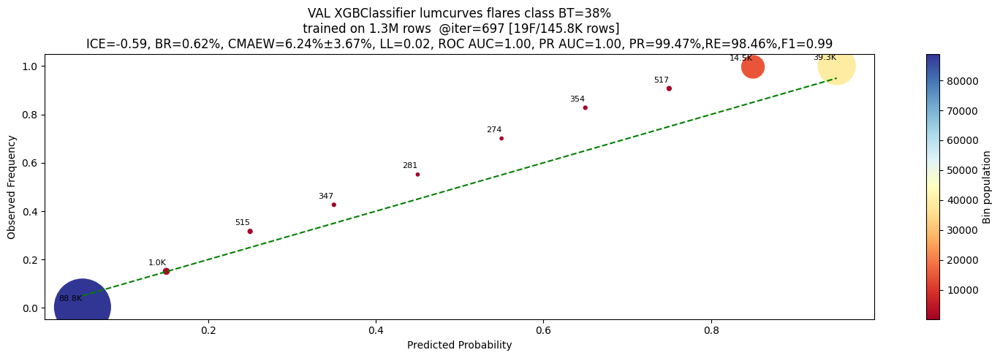

VAL XGBClassifier lumcurves flares class BT=38%
 trained on 1.3M rows  @iter=697
              precision    recall  f1-score   support

           0     0.9906    0.9968    0.9937     90271
           1     0.9947    0.9846    0.9896     55578

    accuracy                         0.9921    145849
   macro avg     0.9926    0.9907    0.9916    145849
weighted avg     0.9921    0.9921    0.9921    145849

ROC AUCs: 1=0.9994
PR AUCs: 1=0.9992
CALIBRATIONs: 
	1: MAEW=6.24%, STD=3.67%, COV=100%
BRIER LOSSes: 
	1=0.6232%
LOG_LOSSes: 
	1=0.0239
ICEs: 
	1=-0.5859
TOTAL INTEGRAL ERROR: -0.5859


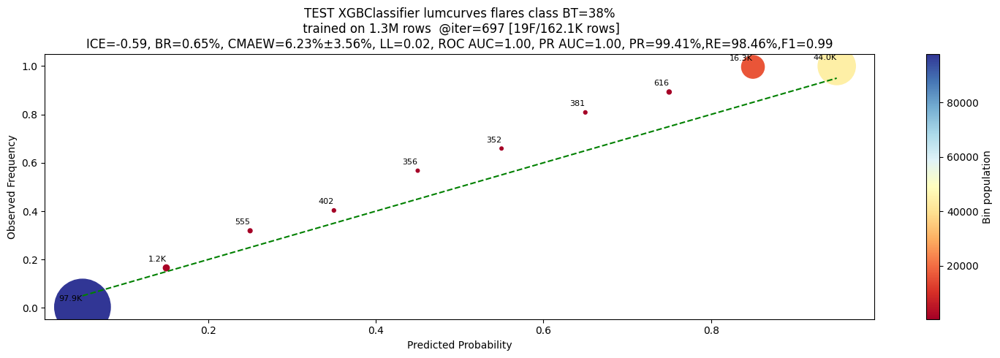

TEST XGBClassifier lumcurves flares class BT=38%
 trained on 1.3M rows  @iter=697
              precision    recall  f1-score   support

           0     0.9904    0.9963    0.9933     99599
           1     0.9941    0.9846    0.9893     62456

    accuracy                         0.9918    162055
   macro avg     0.9922    0.9905    0.9913    162055
weighted avg     0.9918    0.9918    0.9918    162055

ROC AUCs: 1=0.9994
PR AUCs: 1=0.9992
CALIBRATIONs: 
	1: MAEW=6.23%, STD=3.56%, COV=100%
BRIER LOSSes: 
	1=0.6491%
LOG_LOSSes: 
	1=0.0244
ICEs: 
	1=-0.5884
TOTAL INTEGRAL ERROR: -0.5884


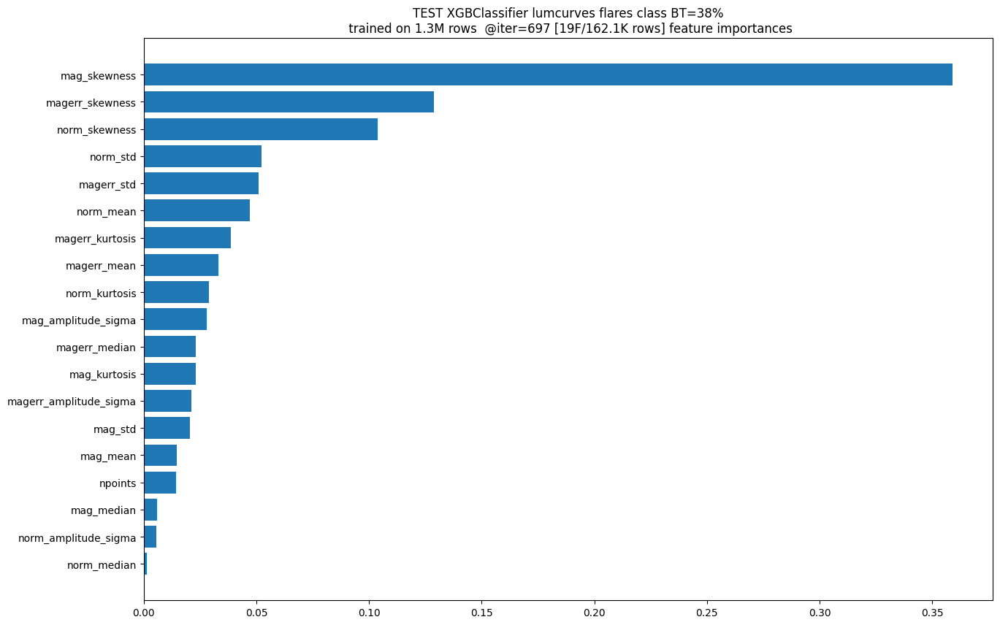

time: 1min 25s (started: 2025-12-17 09:17:58 +03:00)


In [48]:
target_name = "lumcurves"

models, metadata = train_mlframe_models_suite(
    df=features,
    target_name=target_name,
    model_name=f"flares",
    features_and_targets_extractor=ft_extractor,
    mlframe_models="xgb".split(),
    init_common_params={"show_perf_chart": True, "show_fi": True},
    use_ordinary_models=True,
    split_config=TrainingSplitConfig(shuffle_val=True, shuffle_test=True),
    use_mlframe_ensembles=True,
    data_dir="data",
    # models_dir=None,
    verbose=True,
)

# OOS features

In [9]:
def enrich_features(main_features, additional_features):
    combined = pl.concat([main_features, additional_features], how="horizontal")
    fractions = compute_fraction_features(combined)
    main_features = pl.concat(
        [combined, fractions],
        how="horizontal",
    )

    return main_features


freaky_held_out_indices = [
    5,
    12,
    36,
    41,
    43,
    47,
    87,
] + [
    66,
]

DATASET_NAME = "snad-space/ztf-m-dwarf-flares-2025"
HF_CACHE_DIR = r"R:\Caches\huggingface"
SPLIT = "test"

time: 0 ns (started: 2026-01-15 01:00:24 +03:00)


In [13]:
from astro_flares import extract_all_features

oos_features = extract_all_features(
    dataset_name=DATASET_NAME,
    split="test",
    hf_cache_dir=HF_CACHE_DIR,
    argextremum_stats_col="mag",  # Optional
    od_col="mag",
    od_iqr=40,
)

if COLS_TO_USE:
    oos_features = oos_features.select(COLS_TO_USE)

oos_features

Resolving data files:   0%|          | 0/314 [00:00<?, ?it/s]

Resolving data files:   0%|          | 0/314 [00:00<?, ?it/s]

2026-01-15 01:01:58,076 - INFO - extract_all_features-line:3533 - [all_features] Extracting features using 16 cores, wavelets=['haar', 'db4', 'db6', 'coif3', 'sym4']
2026-01-15 01:01:58,910 - INFO - extract_all_features-line:3542 - [all_features] Computing in-memory (len=99, sliced=False)...
wavelet features: 100%|██████████████████████████████████████████████████████████████| 99/99 [00:00<00:00, 512.88row/s]


id,class,norm_to_argmin_q25,norm_to_argmin_mean,velocity_from_argmin_mean,norm_wv_haar_d4_skewness,norm_from_argmin_n_below_2sigma,velocity_from_argmin_max,norm_wv_sym4_d1_kurtosis,velocity_from_argmin_skewness,norm_max_consecutive_below_2sigma,norm_wv_sym4_d2_kurtosis,norm_wv_haar_d5_skewness,norm_wv_haar_d2_mean,norm_wv_haar_d3_skewness,vel_max_consecutive_above_1sigma,mag_kurtosis,norm_to_argmin_kurtosis,mag_skewness,norm_wv_db6_d1_kurtosis,norm_wv_db4_d1_rel_energy,norm_wv_haar_d3_rel_energy,norm_max_consecutive_frac_below_2sigma,norm_from_argmin_iqr,norm_rise_decay_time_ratio,norm_wv_db4_d1_kurtosis,norm_first_second_half_diff,norm_wv_haar_detail_ratio,norm_from_argmin_q25,mag_to_argmin_kurtosis,velocity_from_argmin_median,vel_frac_below_1sigma,norm_from_argmin_std,norm_n_runs_above_1sigma,norm_wv_db4_d1_mad,velocity_to_argmin_min,velocity_from_argmin_std,…,norm_wv_haar_d3_std,magerr_entropy,velocity_from_argmin_slope,norm_wv_db4_d1_energy,norm_wv_haar_d4_std,norm_frac_below_2sigma,mag_arg_max,norm_wv_sym4_d2_mean,norm_mean_run_above_1sigma,norm_q75,magerr_arg_max,norm_wv_haar_d5_kurtosis,mag_to_argmin_skewness,norm_wv_haar_d2_mad,norm_to_argmin_q75,mag_minima_maxima_ratio,norm_wv_coif3_max_detail,mjd_diff_skewness,norm_wv_sym4_total_energy,magerr_skewness,mag_std,norm_wv_sym4_d1_energy,mjd_diff_arg_min,norm_wv_haar_d3_energy,vel_max_consecutive_below_2sigma,norm_wv_sym4_detail_approx_ratio,norm_wv_db6_d1_mad,mag_from_argmin_iqr,norm_wv_sym4_d3_std,vel_n_local_maxima,mag_to_argmin_std,norm_wv_haar_d1_energy,velocity_to_argmin_iqr,norm_wv_sym4_d3_skewness,norm_wv_haar_d4_energy,norm_wv_sym4_d2_mad,mag_to_argmin_range
str,i32,f32,f32,f32,f32,u32,f32,f32,f32,i32,f32,f32,f32,f32,i32,f32,f32,f32,f32,f32,f32,f64,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,f32,f32,f32,…,f32,f32,f32,f32,f32,f32,u32,f32,f32,f32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,f32,i32,f32,f32,f32,f32,i32,f32,f32,f32,f32,f32,f32,f32
"""ZTFDR257209100009778""",1,-25.921282,-3.266363,66.828751,2.00415,3,436.695129,3.19444,-0.473035,37,0.05191,2.190136,1.283981,1.671364,17,0.250924,-1.030226,0.2315,3.929102,0.003954,0.040443,0.45679,18.88867,1.660651,3.341357,-15.743662,0.104627,-11.484693,-1.030226,81.466133,0.475,12.724609,3,3.144768,-879.882935,173.237823,…,17.796698,4.231629,-3.204128,539.052429,6.30856,0.45679,0,0.157205,13.0,7.546613,0,5.592112,0.557091,7.411727,10.146516,1.0,4.915936,7.244775,99017.6875,2.5264,0.750536,1830.143188,2,2585.401123,21,0.019631,1.131147,0.857204,1.284173,26,1.12671,2806.387939,412.592834,-1.784275,642.716675,0.644375,3.358015
"""ZTFDR260208100017563""",1,0.347383,0.542241,133.508789,2.644903,2,660.764648,5.35406,-0.307384,30,-0.514493,1.011306,-2.01604,0.20016,6,0.312565,17.308165,-1.082484,3.753299,0.350475,0.017732,0.375,3.905126,3.998388,1.802618,4.889719,0.76851,-6.713912,17.308165,166.197922,0.417722,2.749203,10,2.619919,-2203.974121,329.612732,…,0.998324,4.319683,37.719841,250.993652,1.997595,0.4,38,-0.107822,2.5,1.224752,38,0.749355,-3.870384,2.714874,1.402172,1.041667,2.006993,1.710251,734.440674,-0.744423,0.696953,48.51202,0,9.946115,3,0.103471,0.814947,0.754667,0.50302,29,0.400737,285.216217,411.99469,-0.47241,64.55471,0.584645,2.531651
"""ZTFDR280214400089687""",1,0.31649,0.730257,56.796265,-0.3502,2,608.679077,4.715528,-1.443583,25,8.714713,-0.242272,1.066958,2.074453,6,0.645175,15.630827,-1.102585,3.616675,0.048757,0.283368,0.260417,3.16232,2.35714,1.456472,4.03211,0.649904,-5.337314,15.630819,96.179016,0.505263,2.488254,16,0.865701,-2809.820068,390.379944,…,3.922568,4.534921,43.277828,25.085657,0.947306,0.3125,5,0.330982,1.5625,1.005198,5,-0.340183,-2.905007,3.781871,1.324462,1.030303,3.92266,1.772013,528.267639,-0.915431,0.501157,52.608711,0,130.358643,3,0.313318,0.890398,0.536552,0.869124,39,0.233859,21.785475,577.640625,-1.588077,16.676493,0.798633,1.767681
"""ZTFDR281201100016537""",1,7.603844,7.196687,53.219173,2.524386,1,462.393951,2.305757,-0.137626,25,4.792299,0.527928,4.110994,1.726868,4,-1.

time: 7.48 s (started: 2026-01-15 01:01:52 +03:00)


## Old

In [26]:
oos_df = dataset["test"].to_polars()
oos_features = extract_features_sparingly(dataset["test"])

main features: 100%|██████████████████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.58s/batch]


time: 4.31 s (started: 2026-01-13 22:52:13 +03:00)


In [10]:
additional_oos_features = extract_additional_features_sparingly(dataset["test"])
oos_features = enrich_features(oos_features, additional_oos_features)

additional features: 100%|████████████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.18s/batch]


time: 1.92 s (started: 2026-01-12 23:44:21 +03:00)


In [27]:
oos_wave_features = extract_wavelet_features_sparingly(
    dataset_name=DATASET_NAME,
    split=SPLIT,
    hf_cache_dir=HF_CACHE_DIR,
)

Resolving data files:   0%|          | 0/314 [00:00<?, ?it/s]

Resolving data files:   0%|          | 0/314 [00:00<?, ?it/s]

2026-01-13 22:52:29,013 - INFO - extract_wavelet_features_sparingly-line:3082 - [wavelet] Extracting features using 16 cores, wavelets=['haar', 'db4', 'db6', 'coif3', 'sym4']
2026-01-13 22:52:29,034 - INFO - extract_wavelet_features_sparingly-line:3086 - [wavelet] Dataset small (99 < 10000), computing in-memory...


Resolving data files:   0%|          | 0/314 [00:00<?, ?it/s]

Resolving data files:   0%|          | 0/314 [00:00<?, ?it/s]

wavelet features: 100%|██████████████████████████████████████████████████████████████| 99/99 [00:00<00:00, 117.48row/s]


time: 18.4 s (started: 2026-01-13 22:52:18 +03:00)


In [12]:
oos_features = pl.concat(
    [oos_features, oos_wave_features],
    how="horizontal",
).drop("row_index")

oos_features

id,class,npoints,mag_mean,mag_std,mag_min,mag_max,mag_median,mag_q25,mag_q75,mag_skewness,mag_kurtosis,mag_entropy,mag_first,mag_last,mag_arg_min,mag_arg_max,mag_n_unique,mag_trend_changes,magerr_mean,magerr_std,magerr_min,magerr_max,magerr_median,magerr_q25,magerr_q75,magerr_skewness,magerr_kurtosis,magerr_entropy,magerr_first,magerr_last,magerr_arg_min,magerr_arg_max,magerr_n_unique,magerr_trend_changes,norm_mean,norm_std,…,mjd_diff_arg_min,mjd_diff_arg_max,mjd_diff_n_unique,mjd_diff_trend_changes,ts,norm_n_below_3sigma,norm_max_consecutive_below_2sigma,norm_rise_decay_idx_ratio,norm_n_local_minima,norm_n_zero_crossings,norm_rise_decay_time_ratio,mjd_span,norm_frac_below_3sigma,norm_max_consecutive_frac_below_2sigma,norm_frac_local_minima,norm_frac_zero_crossings,wv_haar_total_energy,wv_haar_detail_ratio,wv_haar_max_detail,wv_haar_d1_energy,wv_haar_d2_energy,wv_haar_d3_energy,wv_haar_d4_energy,wv_db4_total_energy,wv_db4_detail_ratio,wv_db4_max_detail,wv_db4_d1_energy,wv_db4_d2_energy,wv_db4_d3_energy,wv_db4_d4_energy,wv_sym4_total_energy,wv_sym4_detail_ratio,wv_sym4_max_detail,wv_sym4_d1_energy,wv_sym4_d2_energy,wv_sym4_d3_energy,wv_sym4_d4_energy
str,i32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,…,u32,u32,u32,u32,"datetime[μs, UTC]",i32,i32,f32,i32,i32,f32,f32,f64,f64,f64,f64,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32
"""ZTFDR257209100009778""",1,81,18.277956,0.750536,17.015057,20.387354,18.423584,17.687233,18.766064,0.2315,0.250924,4.393619,20.387354,18.864996,21,0,81,26,0.048074,0.031054,0.017062,0.183053,0.045382,0.026185,0.059344,2.5264,8.290339,4.231629,0.183053,0.064138,21,0,81,26,-3.208962,16.538218,…,2,0,3,28,2018-12-19 00:00:00 UTC,36,37,0.366667,13,2,1.660651,0.07169,0.444444,0.45679,0.160494,0.024691,63926.714844,0.060727,46.667149,439.842834,2585.401123,642.716675,214.115494,136329.15625,0.004641,16.342651,539.052429,59.429768,34.210453,0.0,99017.6875,0.019253,31.774305,1830.143188,18.38929,57.819233,0.0
"""ZTFDR260208100017563""",1,80,19.993542,0.696953,17.942547,20.743458,20.307732,19.590908,20.544415,-1.082484,0.312565,4.381419,20.544455,19.909906,49,38,80,47,0.167013,0.05541,0.03964,0.230914,0.19325,0.125968,0.212915,-0.744423,-0.753964,4.319683,0.212918,0.155199,49,38,80,47,-1.625814,3.606474,…,0,1,3,41,2019-01-10 00:00:00 UTC,24,30,1.612903,24,11,3.998388,0.070811,0.3,0.375,0.3,0.1375,560.91864,0.26003,7.486448,62.012299,9.946115,64.55471,9.342354,716.152771,0.385121,10.830528,250.993652,10.966204,13.845322,0.0,734.440674,0.093768,6.360921,48.51202,11.47657,8.878702,0.0
"""ZTFDR280214400089687""",1,96,20.389763,0.501157,18.74905,21.139164,20.576591,20.130533,20.747143,-1.102585,0.645175,4.564046,20.861336,20.375034,58,5,96,65,0.155814,0.036119,0.05539,0.211005,0.16967,0.13486,0.182202,-0.915431,-0.110681,4.534921,0.190592,0.154399,58,5,96,65,-1.101141,2.953708,…,0,1,2,45,2018-07-04 00:00:00 UTC,21,25,1.552632,33,17,2.35714,0.059836,0.21875,0.260417,0.34375,0.177083,460.032196,0.602547,11.113524,119.002472,130.358643,16.676493,11.153612,514.503418,0.175024,4.857607,25.085657,22.019785,42.944954,0.0,528.267639,0.23857,6.318733,52.608711,46.819347,26.600685,0.0
"""ZTFDR281201100016537""",1,83,19.894436,0.774005,18.632027,21.014927,19.637901,19.265348,20.693279,-0.011298,-1.517447,4.418092,20.624474,19.675564,47,24,83,48,0.120904,0.050061,0.050351,0.195758,0.099438,0.077366,0.173587,0.122181,-1.639616,4.332079,0.168845,0.101924,47,24,83,48,2.579839,7.783825,…,2,0,2,42,2019-06-02 00:00:00 UTC,24,25,1.333333,24,6,2.811501,0.063659,0.289157,0.301205,0.289157,0.072289,5676.127441,0.249947,27.840044,866.38562,380.510864,137.046539,34.786995,9586.669922,0.014445,5.013647,56.862946,55.540249,26.072416,0.0,7396.131836,0.039483,10.363238,198.517502,69.541054,23.963301,0.0
"""ZTFDR283211100006940""",1,23,19.219332,0.60785,17.624674,19.872463,19.485464,19.005825,19.649889,-1.313293,0.

time: 63 ms (started: 2026-01-12 23:44:42 +03:00)


# OOS predictions

In [17]:
xgb_model = models["class"]["binary_classification"][0]

NameError: name 'models' is not defined

time: 110 ms (started: 2025-12-18 04:47:26 +03:00)


time: 31 ms (started: 2025-12-17 09:19:27 +03:00)


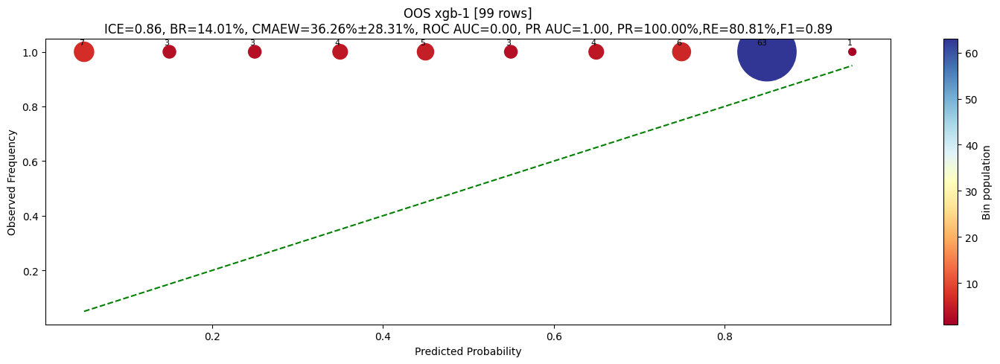

OOS xgb
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       1.00      0.19      0.32        99

    accuracy                           0.19        99
   macro avg       0.50      0.10      0.16        99
weighted avg       1.00      0.19      0.32        99

ROC AUCs: 1=0.00
PR AUCs: 1=1.00
CALIBRATIONs: 
	1: MAEW=36.26%, STD=28.31%, COV=100%
BRIER LOSSes: 
	1=14.01%
LOG_LOSSes: 
	1=None
ICEs: 
	1=0.86
TOTAL INTEGRAL ERROR: 0.0000
time: 1.34 s (started: 2025-12-17 09:19:29 +03:00)


In [51]:
probs = xgb_model.model.predict_proba(oos_features.select(xgb_model.columns))
targets = oos_features["class"].to_numpy().astype(np.int8)

model_name = "xgb"
metrics={}

_, _ = report_model_perf(
    targets=targets,
    columns=None,
    df=None,
    model_name=f"{model_name}",
    model=None,
    target_label_encoder=None,
    preds=None,
    probs=probs,
    plot_file=join(charts_dir, model_name) if charts_dir else None,
    metrics=metrics,
    group_ids=None,
    **report_params,
)

In [39]:
features.describe()

statistic,id,class,npoints,mag_std,mag_skewness,mag_kurtosis,mag_amplitude_sigma,mag_mean,mag_median,magerr_std,magerr_skewness,magerr_kurtosis,magerr_amplitude_sigma,magerr_mean,magerr_median,norm_std,norm_skewness,norm_kurtosis,norm_amplitude_sigma,norm_mean,norm_median
str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""","""1620543""",1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6
"""null_count""","""0""",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
"""mean""",null,0.382923,44.758756,0.142262,-0.564773,1.206014,0.558589,18.078171,18.093191,0.005657,0.119139,0.406184,0.022365,0.047981,0.047923,3.663053,-0.564773,1.206014,14.113132,-0.563894,5.3462e-9
"""std""",null,0.4861,47.487184,0.109889,1.132896,4.350833,0.420632,1.406553,1.404521,0.006455,0.885913,3.427667,0.02536,0.033665,0.033934,3.957867,1.132896,4.350833,13.177006,1.915574,0.000016
"""min""","""TIC100100909_CADENCE100163_ZTF…",0.0,10.0,0.008981,-18.206665,-1.977966,0.036306,10.68872,10.767665,2.4475e-8,-15.846914,-1.994666,9.4064e-8,0.000447,0.000391,0.817573,-18.206665,-1.977966,2.985329,-97.735992,-0.000096
"""25%""",null,0.0,11.0,0.067806,-1.318035,-0.579074,0.264031,17.288145,17.307205,0.001202,-0.342534,-0.763243,0.004533,0.022346,0.022328,1.964054,-1.318035,-0.579074,7.734026,-0.748645,0.0
"""50%""",null,0.0,16.0,0.112444,-0.434528,0.162725,0.440212,18.27652,18.29213,0.003205,0.11891,-0.206217,0.012547,0.037746,0.037624,2.441091,-0.434528,0.162725,10.288111,-0.237969,0.0
"""75%""",null,1.0,67.0,0.182657,0.202861,1.59486,0.725086,19.084057,19.09478,0.007892,0.571395,0.620411,0.031597,0.064734,0.064321,3.704263,0.202861,1.594859,15.112236,0.142319,0.0
"""max""","""ZTFDR853216400051515_MJD59034.…",1.0,345.0,3.738108,16.393195,331.324619,8.856035,21.913754,22.039047,0.099668,17.944469,326.290299,0.294939,0.287876,0.30216,258.765747,16.393195,331.324619,652.485596,189.502213,0.000098


time: 469 ms (started: 2025-12-17 07:56:24 +03:00)


In [40]:
oos_features.describe()

statistic,id,class,npoints,mag_std,mag_skewness,mag_kurtosis,mag_amplitude_sigma,mag_mean,mag_median,magerr_std,magerr_skewness,magerr_kurtosis,magerr_amplitude_sigma,magerr_mean,magerr_median,norm_std,norm_skewness,norm_kurtosis,norm_amplitude_sigma,norm_mean,norm_median
str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""","""99""",99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0
"""null_count""","""0""",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
"""mean""",null,1.0,63.59596,0.681275,-0.923981,0.379142,2.598441,19.914509,20.11677,0.041455,-0.481421,-0.4765,0.145456,0.120306,0.129919,6.260826,-0.923981,0.379142,23.369263,-1.876297,-7.5546e-7
"""std""",null,0.0,34.779457,0.196518,0.641567,2.560359,0.675683,1.006125,1.0197,0.014459,0.654709,1.741596,0.045848,0.037024,0.042043,4.213955,0.641567,2.560359,13.879195,2.153723,0.000006
"""min""","""ZTFDR257209100009778""",1.0,8.0,0.091329,-4.247967,-1.563847,0.232619,14.222792,14.316984,0.000194,-3.423531,-1.904199,0.000494,0.011943,0.011861,2.463627,-4.247967,-1.563847,10.046504,-17.288227,-0.000044
"""25%""",null,1.0,37.0,0.566101,-1.150626,-0.767639,2.222757,19.755405,19.990475,0.03478,-0.796393,-1.104195,0.135038,0.10416,0.110769,4.082587,-1.150626,-0.767639,16.002178,-2.144174,0.0
"""50%""",null,1.0,58.0,0.671219,-0.850493,-0.166944,2.496281,20.106346,20.307732,0.042568,-0.500746,-0.860727,0.153965,0.127027,0.134869,5.085104,-0.850493,-0.166944,19.330418,-1.571215,0.0
"""75%""",null,1.0,83.0,0.800418,-0.557255,0.502038,3.063389,20.466888,20.662922,0.05123,-0.143485,-0.484352,0.173193,0.145089,0.162092,6.908485,-0.557255,0.502038,23.966467,-0.896264,0.0
"""max""","""ZTFDR832210400037888""",1.0,172.0,1.347738,0.2315,16.815604,4.810865,21.168158,21.312328,0.074826,2.5264,11.669255,0.225938,0.195894,0.21678,27.881622,0.2315,16.815604,99.525803,2.579839,0.000019


time: 94 ms (started: 2025-12-17 07:56:49 +03:00)


# Big active ML

In [ ]:
df_target = dataset["target"].select_columns(["id"]).to_polars()
df_target

In [6]:
df_target["id"].n_unique()

94028217

time: 27.3 s (started: 2025-12-18 05:29:21 +03:00)


In [5]:
df_target

id,class,mjd,mag,magerr
str,i32,list[f64],list[f32],list[f32]
"""ZTFDR258214100040640_MJD58487.…",null,"[58487.27209, 58487.28625, … 58487.3306]","[19.939198, 20.136208, … 20.067881]","[19.939198, 20.136208, … 20.067881]"
"""ZTFDR258214100038912_MJD58487.…",null,"[58487.2689, 58487.26935, … 58487.34294]","[17.520168, 17.528702, … 17.47588]","[17.520168, 17.528702, … 17.47588]"
"""ZTFDR258214100040641_MJD58487.…",null,"[58487.26889, 58487.27072, … 58487.33974]","[18.818167, 19.06382, … 18.804058]","[18.818167, 19.06382, … 18.804058]"
"""ZTFDR258214100037040_MJD58487.…",null,"[58487.26887, 58487.26932, … 58487.34199]","[17.047787, 16.582361, … 17.054947]","[17.047787, 16.582361, … 17.054947]"
"""ZTFDR258214100025746_MJD58487.…",null,"[58487.26935, 58487.27301, … 58487.3379]","[19.442375, 20.403635, … 19.316433]","[19.442375, 20.403635, … 19.316433]"
…,…,…,…,…
"""ZTFDR1824206300019435_MJD58226…",null,"[58226.20003, 58226.20093, … 58226.23149]","[17.890526, 17.921936, … 17.938599]","[17.890526, 17.921936, … 17.938599]"
"""ZTFDR1824206300051972_MJD58229…",null,"[58229.19993, 58229.2004, … 58229.25589]","[19.924105, 20.19936, … 20.452414]","[19.924105, 20.19936, … 20.452414]"
"""ZTFDR1824206300032063_MJD58226…",null,"[58226.20044, 58226.2009, … 58226.23145]","[18.181707, 18.381504, … 18.359154]","[18.181707, 18.381504, … 18.359154]"


time: 62 ms (started: 2025-12-17 20:54:03 +03:00)


In [6]:
df_target.shape

(93960271, 5)

time: 62 ms (started: 2025-12-17 20:54:04 +03:00)


# Known flares

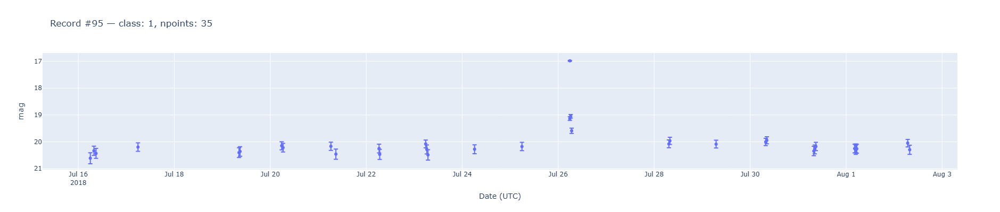

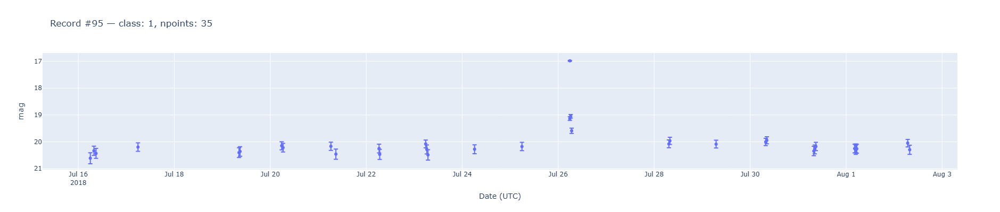

time: 63 ms (started: 2026-01-13 03:25:11 +03:00)


In [53]:
view_series(oos_df, index=95)

In [61]:
for index in freaky_held_out_indices:
    view_series(oos_df, index=index)
# npoints<25

time: 266 ms (started: 2025-12-26 16:57:08 +03:00)


In [56]:
for index in range(3):
    view_series(oos_df, index=index)

time: 47 ms (started: 2025-12-26 16:30:45 +03:00)


In [57]:
view_series(oos_df, index=43)

time: 47 ms (started: 2025-12-26 16:30:49 +03:00)


# Special events

In [ ]:
big_features 283206300181298

In [23]:
dataset["target"][index]

{'id': 'ZTFDR485206400064968_MJD58642.31972',
 'class': None,
 'mjd': [58642.31972,
  58642.32018,
  58642.32108,
  58642.32199,
  58642.32244,
  58642.3229,
  58642.32335,
  58642.32425,
  58642.32516,
  58642.32562,
  58642.32607,
  58642.32652,
  58642.32697,
  58642.32742,
  58642.32832,
  58642.32877,
  58642.32923,
  58642.32968,
  58642.33013,
  58642.33058,
  58642.33103,
  58642.33148,
  58642.33193,
  58642.33239,
  58642.33284,
  58642.33329,
  58642.33374,
  58642.33419,
  58642.33464,
  58642.33509,
  58642.33555,
  58642.336,
  58642.33645,
  58642.3369,
  58642.33735,
  58642.3378,
  58642.33825,
  58642.33871,
  58642.33961,
  58642.34006,
  58642.34051,
  58642.34141,
  58642.34187,
  58642.34232,
  58642.34277,
  58642.34368,
  58642.34413,
  58642.34459,
  58642.34594,
  58642.34639,
  58642.34684,
  58642.34728,
  58642.34775,
  58642.3482,
  58642.34865,
  58642.3491,
  58642.34955,
  58642.35,
  58642.35044,
  58642.35089,
  58642.35134,
  58642.3518,
  58642.3522

time: 15 ms (started: 2025-12-22 12:42:39 +03:00)


In [22]:
mjd = dataset["target"][index]["mjd"]
(mjd == sorted(mjd))

True

time: 16 ms (started: 2025-12-22 12:41:22 +03:00)


In [17]:
index = 40122309
view_series(dataset["target"][index], index=index, advanced=True)

time: 63 ms (started: 2025-12-22 12:39:00 +03:00)


In [8]:
index = 5555427
view_series(dataset["target"][index], index=index, advanced=True)

time: 704 ms (started: 2025-12-22 07:35:47 +03:00)


In [75]:
index = 55554273
view_series(dataset["target"][index], index=index, advanced=True)

time: 78 ms (started: 2025-12-20 05:30:25 +03:00)


In [78]:
view_series(oos_df, index=1, advanced=True)

time: 78 ms (started: 2025-12-20 05:32:41 +03:00)


In [38]:
index = 89001830
view_series(dataset["target"][index], index=index, singlepoint_min_outlying_factor=10)

time: 78 ms (started: 2025-12-21 17:44:49 +03:00)


In [83]:
(big_features.lazy().filter(pl.col("norm_skewness") < -10).select(pl.len()).collect())

len
u32
23590


time: 31 ms (started: 2025-12-27 10:32:34 +03:00)


In [84]:
for index in (
    big_features.lazy()
    .with_row_index()
    .filter(pl.col("norm_skewness") > -10)
    .sort("norm_skewness")
    .head(5)
    .select("index")
    .collect()["index"]
):
    view_series(
        dataset["target"][index], index=index, singlepoint_min_outlying_factor=0
    )

time: 4.06 s (started: 2025-12-27 10:32:36 +03:00)


In [19]:
clean_ram()

time: 22.9 s (started: 2025-12-21 12:07:16 +03:00)


In [86]:
with pl.Config(tbl_rows=30):
    display(ranked_features.sort("median_log_ratio").head(20))

feature,mean_pop,mean_rare,mean_ratio,mean_log_ratio,median_pop,median_rare,median_ratio,median_log_ratio,std_pop,std_rare,std_ratio,std_log_ratio,cohens_d_mean,cohens_d_median,max_abs_log_ratio
str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""mjd_diff_kurtosis""",NaN,18.558035,NaN,NaN,-0.0303,11.72448,-386.946514,-8.59599,NaN,21.757736,NaN,NaN,NaN,NaN,NaN
"""norm_mean""",0.04773,-1.876297,-39.310323,-5.296836,0.024088,-1.571215,-65.227167,-6.027401,0.887163,2.153723,2.427654,1.279563,-2.168738,-1.798204,6.027401
"""norm_first""",-0.100936,2.363058,-23.411399,-4.549139,-0.051602,1.807318,-35.024231,-5.130281,3.990919,7.588773,1.90151,0.927146,0.617399,0.465787,5.130281
"""mag_skewness""",-0.008388,-0.923981,110.160379,6.783462,0.043938,-0.850493,-19.356703,-4.274761,0.938634,0.641567,0.683511,-0.548963,-0.975453,-0.952907,6.783462
"""norm_skewness""",-0.008388,-0.923981,110.160379,6.783462,0.043938,-0.850493,-19.356696,-4.274761,0.938634,0.641567,0.683511,-0.548963,-0.975453,-0.952907,6.783462
"""norm_last""",-0.139838,1.060816,-7.58604,-2.923347,-0.079021,1.031867,-13.058116,-3.706875,3.940786,4.144145,1.051604,0.072591,0.304674,0.281895,3.706875
"""mjd_diff_median""",0.00253,0.002392,0.945292,-0.081169,0.003906,0.000463,0.118531,-3.076669,0.002954,0.007067,2.392675,1.258625,-0.046864,-1.165763,3.076669
"""mjd_diff_q75""",0.004979,0.031516,6.330305,2.662275,0.003906,0.000937,0.239997,-2.058909,0.004191,0.165195,39.416425,5.300725,6.326891,-0.707789,5.300725
"""magerr_skewness""",0.207738,-0.481421,-2.317443,-1.212534,0.21778,-0.500746,-2.299321,-1.201208,0.944219,0.654709,0.693387,-0.528268,-0.729872,-0.760974,1.212534


time: 63 ms (started: 2025-12-20 06:06:56 +03:00)


# Random events

In [37]:
for i in range(10):
    index = np.random.randint(len(big_features))
    view_series(dataset["target"][index], index=index)

time: 391 ms (started: 2025-12-19 13:34:13 +03:00)


# Big features

In [15]:
big_features = pl.read_parquet(
    r"R:\Data\Astronomy\all_features_chunks_haar_db4_db6_coif3_sym4\all_features_chunk*.parquet",
    columns=COLS_TO_USE,
)

_init_credential_provider_builder(): credential_provider_init = None


time: 3min 18s (started: 2026-01-15 01:03:13 +03:00)


In [16]:
big_features["had_od"].sum()

42402

time: 1.53 s (started: 2026-01-14 22:52:51 +03:00)


In [16]:
big_features.estimated_size() / 1024**3

74.85303337220103

time: 953 ms (started: 2026-01-15 01:06:38 +03:00)


In [14]:
# big_features.to_parquet((r"R:\Data\Astronomy\all_features.parquet",compression='zstd')

time: 0 ns (started: 2026-01-15 01:02:18 +03:00)


In [17]:
clean_ram()

time: 20.1 s (started: 2026-01-15 01:07:17 +03:00)


## Old

In [13]:
big_features = pl.read_parquet(
    r"R:\Data\Astronomy\big_features.parquet", parallel="columns"
)

_init_credential_provider_builder(): credential_provider_init = None


time: 34.6 s (started: 2026-01-12 23:44:43 +03:00)


In [14]:
additional_features = pl.read_parquet(
    r"R:\Data\Astronomy\features_additional.parquet", parallel="columns"
)

_init_credential_provider_builder(): credential_provider_init = None


time: 2.5 s (started: 2026-01-12 23:45:19 +03:00)


In [15]:
big_features = enrich_features(big_features, additional_features)
clean_ram()

time: 32.7 s (started: 2026-01-12 23:45:22 +03:00)


In [16]:
wave_features = (
    pl.scan_parquet(
        r"R:\Data\Astronomy\\wavelet_chunks_haar_db4_sym4\wavelet_chunk_*.parquet"
    )
    .sort("row_index")
    .collect()
).drop("row_index")

_init_credential_provider_builder(): credential_provider_init = None


time: 23.9 s (started: 2026-01-12 23:45:57 +03:00)


In [17]:
wave_features

wv_haar_total_energy,wv_haar_detail_ratio,wv_haar_max_detail,wv_haar_d1_energy,wv_haar_d2_energy,wv_haar_d3_energy,wv_haar_d4_energy,wv_db4_total_energy,wv_db4_detail_ratio,wv_db4_max_detail,wv_db4_d1_energy,wv_db4_d2_energy,wv_db4_d3_energy,wv_db4_d4_energy,wv_sym4_total_energy,wv_sym4_detail_ratio,wv_sym4_max_detail,wv_sym4_d1_energy,wv_sym4_d2_energy,wv_sym4_d3_energy,wv_sym4_d4_energy
f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32
572.757019,0.736857,5.537032,54.870945,38.500065,134.111008,194.558075,932.216431,0.46287,4.83052,52.687946,55.213425,111.896889,211.697098,1112.22644,0.36383,6.063162,34.442116,55.259659,100.416679,214.543198
1203.162842,0.546378,7.45773,96.992722,86.748764,194.110001,279.53064,1731.461548,0.371283,6.504838,80.010864,90.393127,177.295868,295.163208,1772.80896,0.343813,7.605155,56.916775,83.120934,200.13475,269.34317
550.752625,0.583891,4.384292,39.158878,60.828053,69.856407,151.735962,489.563171,0.722925,3.850207,25.356268,92.933731,74.960457,160.666977,516.798157,0.724062,4.785738,36.337414,83.709175,96.503784,157.643738
150.692749,0.748046,7.717164,59.554619,0.645609,17.362947,35.16188,164.142197,0.359696,3.899971,59.041279,0.0,0.0,0.0,154.407349,0.258836,4.242571,39.966137,0.0,0.0,0.0
128.596466,0.869457,4.159596,24.811663,17.522402,32.21439,37.260605,141.757614,0.422672,3.110437,19.152296,40.764713,0.0,0.0,142.675217,0.444459,2.520229,25.378376,38.034863,0.0,0.0
…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…
258.655426,0.885782,6.586214,21.52788,62.095612,54.001156,91.487755,299.391907,0.298447,4.502221,89.352547,0.0,0.0,0.0,303.714111,0.347323,6.913197,105.486938,0.0,0.0,0.0
277.974548,0.764947,6.616033,2.551845,22.980484,31.8559,155.247513,443.1633,0.471118,6.812099,65.298714,143.483292,0.0,0.0,426.535645,0.641032,7.004133,43.833157,229.589752,0.0,0.0
138.872711,0.732256,4.913523,10.800043,27.820265,21.851599,41.218452,137.335358,0.466337,4.777255,64.04451,0.0,0.0,0.0,137.003998,0.430348,4.790569,58.959393,0.0,0.0,0.0


time: 47 ms (started: 2026-01-12 23:46:22 +03:00)


In [18]:
big_features = pl.concat(
    [big_features, wave_features],
    how="horizontal",
)
clean_ram()

time: 7.22 s (started: 2026-01-12 23:46:23 +03:00)


In [19]:
big_features

id,class,npoints,mag_mean,mag_std,mag_min,mag_max,mag_median,mag_q25,mag_q75,mag_skewness,mag_kurtosis,mag_entropy,mag_first,mag_last,mag_arg_min,mag_arg_max,mag_n_unique,mag_trend_changes,magerr_mean,magerr_std,magerr_min,magerr_max,magerr_median,magerr_q25,magerr_q75,magerr_skewness,magerr_kurtosis,magerr_entropy,magerr_first,magerr_last,magerr_arg_min,magerr_arg_max,magerr_n_unique,magerr_trend_changes,norm_mean,norm_std,…,mjd_diff_arg_min,mjd_diff_arg_max,mjd_diff_n_unique,mjd_diff_trend_changes,ts,norm_n_below_3sigma,norm_max_consecutive_below_2sigma,norm_rise_decay_idx_ratio,norm_n_local_minima,norm_n_zero_crossings,norm_rise_decay_time_ratio,mjd_span,norm_frac_below_3sigma,norm_max_consecutive_frac_below_2sigma,norm_frac_local_minima,norm_frac_zero_crossings,wv_haar_total_energy,wv_haar_detail_ratio,wv_haar_max_detail,wv_haar_d1_energy,wv_haar_d2_energy,wv_haar_d3_energy,wv_haar_d4_energy,wv_db4_total_energy,wv_db4_detail_ratio,wv_db4_max_detail,wv_db4_d1_energy,wv_db4_d2_energy,wv_db4_d3_energy,wv_db4_d4_energy,wv_sym4_total_energy,wv_sym4_detail_ratio,wv_sym4_max_detail,wv_sym4_d1_energy,wv_sym4_d2_energy,wv_sym4_d3_energy,wv_sym4_d4_energy
str,i32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,…,u32,u32,u32,u32,"datetime[μs, UTC]",i32,i32,f32,i32,i32,f32,f32,f64,f64,f64,f64,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32
"""ZTFDR257201100001119_MJD58471.…",null,174,18.913832,0.135884,18.501698,19.387657,18.921986,18.840481,18.985106,-0.112987,1.3233,5.15903,18.605858,19.062325,76,31,174,116,0.075098,0.007802,0.054352,0.106575,0.075198,0.07063,0.07892,0.364245,1.68334,5.153715,0.058914,0.083698,76,31,174,116,-0.1084,1.807023,…,0,4,2,66,2018-12-19 00:00:00 UTC,9,3,0.785714,58,75,0.825431,0.08585,0.051724,0.017241,0.333333,0.431034,572.757019,0.736857,5.537032,54.870945,38.500065,134.111008,194.558075,932.216431,0.46287,4.83052,52.687946,55.213425,111.896889,211.697098,1112.22644,0.36383,6.063162,34.442116,55.259659,100.416679,214.543198
"""ZTFDR257201100031205_MJD58471.…",null,188,18.212538,0.109453,17.842152,18.584852,18.216366,18.15344,18.284317,-0.24003,0.994606,5.236424,18.096306,18.348726,77,138,188,114,0.043691,0.003615,0.033012,0.057963,0.043653,0.041616,0.045977,0.176193,1.273714,5.233038,0.039858,0.048305,77,138,188,114,-0.08771,2.507348,…,0,5,2,66,2018-12-19 00:00:00 UTC,25,8,0.702703,57,51,0.693628,0.08585,0.132979,0.042553,0.303191,0.271277,1203.162842,0.546378,7.45773,96.992722,86.748764,194.110001,279.53064,1731.461548,0.371283,6.504838,80.010864,90.393127,177.295868,295.163208,1772.80896,0.343813,7.605155,56.916775,83.120934,200.13475,269.34317
"""ZTFDR257201100048647_MJD58472.…",null,129,19.074141,0.154115,18.715588,19.509781,19.063267,18.969311,19.167679,0.39769,0.219762,4.85978,19.011953,19.295404,26,6,129,86,0.084942,0.010087,0.064136,0.116274,0.083758,0.077974,0.09062,0.702977,0.6787,4.852957,0.080553,0.099639,26,6,129,86,0.129762,1.840007,…,0,1,2,65,2018-12-20 00:00:00 UTC,3,4,0.262136,43,53,0.293119,0.08457,0.023256,0.031008,0.333333,0.410853,550.752625,0.583891,4.384292,39.158878,60.828053,69.856407,151.735962,489.563171,0.722925,3.850207,25.356268,92.933731,74.960457,160.666977,516.798157,0.724062,4.785738,36.337414,83.709175,96.503784,157.643738
"""ZTFDR257201100051826_MJD58472.…",null,19,19.37347,0.272342,18.896191,19.884975,19.37619,19.112148,19.570467,0.124072,-0.824714,2.944345,19.077137,19.579378,6,13,19,10,0.106831,0.020874,0.073723,0.148942,0.105694,0.086914,0.121298,0.346468,-0.714802,2.926517,0.084643,0.122046,6,13,19,10,-0.025736,2.5767,…,1,2,4,16,2018-12-20 00:00:00 UTC,1,3,0.538462,5,7,0.94341,0.07727,0.052632,0.157895,0.263158,0.368421,150.692749,0.748046,7.717164,59.554619,0.645609,17.362947,35.16188,164.142197,0.359696,3.899971,59.041279,0.0,0.0,0.0,154.407349,0.258836,4.242571,39.966137,0.0,0.0,0.0
"""ZTFDR257201100011565_MJD58471.…",null,48,19.7246,0.

time: 78 ms (started: 2026-01-12 23:46:32 +03:00)


In [20]:
del additional_features, wave_features
clean_ram()

time: 1.28 s (started: 2026-01-12 23:46:33 +03:00)


## Computing additional features

In [7]:
additional_features = extract_additional_features_sparingly(
    dataset["target"].select(range(5000000))
)
additional_features

_init_credential_provider_builder(): credential_provider_init = None
2025-12-20 10:04:59,760 - INFO - extract_additional_features_sparingly-line:910 - [additional] Cache invalid (500000 vs 5000000), recomputing...
2025-12-20 10:04:59,766 - INFO - extract_additional_features_sparingly-line:912 - [additional] Computing flare-specific features...
_init_credential_provider_builder(): credential_provider_init = None
2025-12-20 10:06:54,696 - INFO - extract_additional_features_sparingly-line:1047 -     Saved to data\features_additional.parquet


norm_n_below_3sigma,norm_max_consecutive_below_2sigma,norm_rise_decay_idx_ratio,norm_rise_decay_time_ratio,mjd_span,norm_n_local_minima,norm_n_zero_crossings
i32,i32,f32,f32,f32,i32,i32
9,3,0.785714,0.825431,0.08585,58,75
25,8,0.702703,0.693628,0.08585,57,51
3,4,0.262136,0.293119,0.08457,43,53
1,3,0.538462,0.94341,0.07727,5,7
3,5,0.53125,0.74533,0.08128,16,21
…,…,…,…,…,…,…
3,1,6.0,4.996633,0.03562,12,20
5,2,5.666667,12.53398,0.05576,5,9
9,3,1.875,1.953378,0.03104,6,9


time: 2min 2s (started: 2025-12-20 10:04:59 +03:00)


In [ ]:
additional_features = extract_additional_features_sparingly(dataset["target"])
additional_features

## Computing big features

In [8]:
test_features = extract_features_sparingly(
    dataset["target"].select(range(5000)), engine="streaming"
)
test_features

2025-12-18 13:38:00,368 - INFO - load_or_compute-line:441 - [1/6] Computing mag features...
_init_credential_provider_builder(): credential_provider_init = None
2025-12-18 13:38:01,260 - INFO - load_or_compute-line:446 -     Saved to data\features_mag.parquet
2025-12-18 13:38:01,931 - INFO - load_or_compute-line:441 - [2/6] Computing magerr features...
_init_credential_provider_builder(): credential_provider_init = None
2025-12-18 13:38:02,815 - INFO - load_or_compute-line:446 -     Saved to data\features_magerr.parquet
2025-12-18 13:38:03,467 - INFO - load_or_compute-line:441 - [3/6] Computing norm features...
_init_credential_provider_builder(): credential_provider_init = None
2025-12-18 13:38:04,328 - INFO - load_or_compute-line:446 -     Saved to data\features_norm.parquet
2025-12-18 13:38:05,034 - INFO - load_or_compute-line:441 - [4/6] Computing mjd_diff features...
_init_credential_provider_builder(): credential_provider_init = None
2025-12-18 13:38:06,018 - INFO - load_or_compu

id,class,npoints,mag_mean,mag_std,mag_min,mag_max,mag_median,mag_q25,mag_q75,mag_skewness,mag_kurtosis,mag_entropy,mag_first,mag_last,mag_arg_min,mag_arg_max,mag_n_unique,mag_trend_changes,magerr_mean,magerr_std,magerr_min,magerr_max,magerr_median,magerr_q25,magerr_q75,magerr_skewness,magerr_kurtosis,magerr_entropy,magerr_first,magerr_last,magerr_arg_min,magerr_arg_max,magerr_n_unique,magerr_trend_changes,norm_mean,norm_std,norm_min,norm_max,norm_median,norm_q25,norm_q75,norm_skewness,norm_kurtosis,norm_first,norm_last,norm_arg_min,norm_arg_max,norm_n_unique,norm_trend_changes,mjd_diff_mean,mjd_diff_std,mjd_diff_min,mjd_diff_max,mjd_diff_median,mjd_diff_q25,mjd_diff_q75,mjd_diff_skewness,mjd_diff_kurtosis,mjd_diff_entropy,mjd_diff_first,mjd_diff_last,mjd_diff_arg_min,mjd_diff_arg_max,mjd_diff_n_unique,mjd_diff_trend_changes,ts
str,i32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,"datetime[μs, UTC]"
"""ZTFDR257201100001119_MJD58471.…",null,174,18.913832,0.135884,18.501698,19.387657,18.921986,18.840481,18.985106,-0.112987,1.3233,5.15903,18.605858,19.062325,76,31,174,116,0.075098,0.007802,0.054352,0.106575,0.075198,0.07063,0.07892,0.364245,1.68334,5.153715,0.058914,0.083698,76,31,174,116,-0.1084,1.807023,-5.589094,6.192615,0.0,-1.083871,0.839384,-0.112987,1.3233,-4.203945,1.866261,76,31,174,116,0.000496,0.000139,0.00045,0.00138,0.00046,0.00045,0.00046,3.5539,12.874785,5.122674,0.00045,0.00045,0,70,13,152,2018-12-19 00:00:00 UTC
"""ZTFDR257201100031205_MJD58471.…",null,188,18.212538,0.109453,17.842152,18.584852,18.216366,18.15344,18.284317,-0.24003,0.994606,5.236424,18.096306,18.348726,77,138,188,114,0.043691,0.003615,0.033012,0.057963,0.043653,0.041616,0.045977,0.176193,1.273714,5.233038,0.039858,0.048305,77,138,188,114,-0.08771,2.507348,-8.572489,8.441278,0.0,-1.441492,1.556625,-0.24003,0.994606,-2.750331,3.03211,77,138,188,114,0.000459,0.000033,0.00045,0.0009,0.00046,0.00045,0.00046,12.628547,165.25676,5.229053,0.00045,0.00046,0,176,7,166,2018-12-19 00:00:00 UTC
"""ZTFDR257201100048647_MJD58472.…",null,129,19.074141,0.154115,18.715588,19.509781,19.063267,18.969311,19.167679,0.39769,0.219762,4.85978,19.011953,19.295404,26,6,129,86,0.084942,0.010087,0.064136,0.116274,0.083758,0.077974,0.09062,0.702977,0.6787,4.852957,0.080553,0.099639,26,6,129,86,0.129762,1.840007,-4.150992,5.330997,0.0,-1.121754,1.246591,0.39769,0.219762,-0.612638,2.771526,26,6,129,86,0.000661,0.000383,0.00045,0.00228,0.00046,0.00045,0.00091,2.125184,4.139797,4.720881,0.00091,0.00045,5,52,19,95,2018-12-20 00:00:00 UTC
"""ZTFDR257201100051826_MJD58472.…",null,19,19.37347,0.272342,18.896191,19.884975,19.37619,19.112148,19.570467,0.124072,-0.824714,2.944345,19.077137,19.579378,6,13,19,10,0.106831,0.020874,0.073723,0.148942,0.105694,0.086914,0.121298,0.346468,-0.714802,2.926517,0.084643,0.122046,6,13,19,10,-0.025736,2.5767,-4.541409,4.813759,0.0,-2.498174,1.838107,0.124072,-0.824714,-2.829426,1.922418,6,13,19,10,0.004293,0.004313,0.00046,0.01508,0.002745,0.00137,0.00502,1.540015,1.349784,2.488526,0.00274,0.00046,17,8,18,10,2018-12-20 00:00:00 UTC
"""ZTFDR257201100011565_MJD58471.…",null,48,19.7246,0.22452,19.075207,20.159521,19.771763,19.631021,19.851671,-0.834665,0.633071,3.871137,19.602474,19.935028,16,24,48,32,0.135178,0.018889,0.08452,0.173324,0.138759,0.126432,0.145932,-0.649473,0.241762,3.861241,0.123997,0.153471,16,24,48,32,-0.339897,1.618055,-5.019882,2.794463,0.000007,-1.014283,0.575877,-0.834665,0.633071,-1.220015,1.176606,16,24,48,32,0.001729,0.001576,0.00045,0.00731,0.00136,0.00046,0.00229,1.621449,2.446616,3.508264,0.00548,0.00046,5,13,23,28,2018-12-19 00:00:00 UTC
…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…
"""ZTFDR257201400028131_MJD58472.…",null,115,17.72

time: 7.94 s (started: 2025-12-18 13:38:00 +03:00)


In [7]:
clean_ram()

time: 1.03 s (started: 2025-12-18 22:16:11 +03:00)


In [ ]:
big_features = extract_features_sparingly(dataset["target"], engine="cpu")
big_features

2025-12-18 13:43:48,284 - INFO - load_or_compute-line:441 - [1/6] Computing mag features...
_init_credential_provider_builder(): credential_provider_init = None
2025-12-18 14:57:29,283 - INFO - load_or_compute-line:446 -     Saved to data\features_mag.parquet
2025-12-18 14:57:50,734 - INFO - load_or_compute-line:441 - [2/6] Computing magerr features...


In [6]:
big_features = extract_features_sparingly(dataset["target"], engine="cpu")
big_features

2025-12-18 23:11:45,377 - INFO - extract_features_sparingly-line:584 - Low RAM mode: 127.9GB < 512GB threshold
2025-12-18 23:11:45,381 - INFO - extract_features_sparingly-line:723 - Pass 1: Computing and caching all features...
_init_credential_provider_builder(): credential_provider_init = None
2025-12-18 23:11:45,778 - INFO - compute_and_save-line:604 - [mag] mag features already cached, skipping...
_init_credential_provider_builder(): credential_provider_init = None
2025-12-18 23:11:46,103 - INFO - compute_and_save-line:604 - [magerr] magerr features already cached, skipping...
2025-12-18 23:11:46,111 - INFO - compute_and_save-line:607 - [norm] Computing norm features...
_init_credential_provider_builder(): credential_provider_init = None
2025-12-19 00:00:04,627 - INFO - compute_and_save-line:610 -     Saved to data\features_norm.parquet
2025-12-19 00:00:06,888 - INFO - compute_and_save-line:607 - [mjd_diff] Computing mjd_diff features...
_init_credential_provider_builder(): credent

id,class,npoints,mag_mean,mag_std,mag_min,mag_max,mag_median,mag_q25,mag_q75,mag_skewness,mag_kurtosis,mag_entropy,mag_first,mag_last,mag_arg_min,mag_arg_max,mag_n_unique,mag_trend_changes,magerr_mean,magerr_std,magerr_min,magerr_max,magerr_median,magerr_q25,magerr_q75,magerr_skewness,magerr_kurtosis,magerr_entropy,magerr_first,magerr_last,magerr_arg_min,magerr_arg_max,magerr_n_unique,magerr_trend_changes,norm_mean,norm_std,norm_min,norm_max,norm_median,norm_q25,norm_q75,norm_skewness,norm_kurtosis,norm_first,norm_last,norm_arg_min,norm_arg_max,norm_n_unique,norm_trend_changes,mjd_diff_mean,mjd_diff_std,mjd_diff_min,mjd_diff_max,mjd_diff_median,mjd_diff_q25,mjd_diff_q75,mjd_diff_skewness,mjd_diff_kurtosis,mjd_diff_entropy,mjd_diff_first,mjd_diff_last,mjd_diff_arg_min,mjd_diff_arg_max,mjd_diff_n_unique,mjd_diff_trend_changes,ts
str,i32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,"datetime[μs, UTC]"
"""ZTFDR257201100001119_MJD58471.…",null,174,18.913832,0.135884,18.501698,19.387657,18.921986,18.840481,18.985106,-0.112987,1.3233,5.15903,18.605858,19.062325,76,31,174,116,0.075098,0.007802,0.054352,0.106575,0.075198,0.07063,0.07892,0.364245,1.68334,5.153715,0.058914,0.083698,76,31,174,116,-0.1084,1.807023,-5.589094,6.192615,0.0,-1.083871,0.839384,-0.112987,1.3233,-4.203945,1.866261,76,31,174,116,0.000497,0.001305,0.0,0.003906,0.0,0.0,0.0,2.238154,3.009332,NaN,0.0,0.0,0,4,2,66,2018-12-19 00:00:00 UTC
"""ZTFDR257201100031205_MJD58471.…",null,188,18.212538,0.109453,17.842152,18.584852,18.216366,18.15344,18.284317,-0.24003,0.994606,5.236424,18.096306,18.348726,77,138,188,114,0.043691,0.003615,0.033012,0.057963,0.043653,0.041616,0.045977,0.176193,1.273714,5.233038,0.039858,0.048305,77,138,188,114,-0.08771,2.507348,-8.572489,8.441278,0.0,-1.441492,1.556625,-0.24003,0.994606,-2.750331,3.03211,77,138,188,114,0.00046,0.001262,0.0,0.003906,0.0,0.0,0.0,2.373464,3.633333,NaN,0.0,0.0,0,5,2,66,2018-12-19 00:00:00 UTC
"""ZTFDR257201100048647_MJD58472.…",null,129,19.074141,0.154115,18.715588,19.509781,19.063267,18.969311,19.167679,0.39769,0.219762,4.85978,19.011953,19.295404,26,6,129,86,0.084942,0.010087,0.064136,0.116274,0.083758,0.077974,0.09062,0.702977,0.6787,4.852957,0.080553,0.099639,26,6,129,86,0.129762,1.840007,-4.150992,5.330997,0.0,-1.121754,1.246591,0.39769,0.219762,-0.612638,2.771526,26,6,129,86,0.000671,0.00148,0.0,0.003906,0.0,0.0,0.0,1.739462,1.025729,NaN,0.0,0.0,0,1,2,65,2018-12-20 00:00:00 UTC
"""ZTFDR257201100051826_MJD58472.…",null,19,19.37347,0.272342,18.896191,19.884975,19.37619,19.112148,19.570467,0.124072,-0.824714,2.944345,19.077137,19.579378,6,13,19,10,0.106831,0.020874,0.073723,0.148942,0.105694,0.086914,0.121298,0.346468,-0.714802,2.926517,0.084643,0.122046,6,13,19,10,-0.025736,2.5767,-4.541409,4.813759,0.0,-2.498174,1.838107,0.124072,-0.824714,-2.829426,1.922418,6,13,19,10,0.00434,0.004993,0.0,0.015625,0.003906,0.0,0.003906,1.353805,0.759936,NaN,0.003906,0.0,1,2,4,16,2018-12-20 00:00:00 UTC
"""ZTFDR257201100011565_MJD58471.…",null,48,19.7246,0.22452,19.075207,20.159521,19.771763,19.631021,19.851671,-0.834665,0.633071,3.871137,19.602474,19.935028,16,24,48,32,0.135178,0.018889,0.08452,0.173324,0.138759,0.126432,0.145932,-0.649473,0.241762,3.861241,0.123997,0.153471,16,24,48,32,-0.339897,1.618055,-5.019882,2.794463,0.000007,-1.014283,0.575877,-0.834665,0.633071,-1.220015,1.176606,16,24,48,32,0.001745,0.002276,0.0,0.0078125,0.0,0.0,0.003906,0.874692,-0.235138,NaN,0.003906,0.0,3,13,3,38,2018-12-19 00:00:00 UTC
…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…
"""ZTFDR1824216400046147_MJD58229…",null,26,19.558136,0.315779,18.933319,20.113304,19.600155,19.377138,19.767147,-0.305537,-0.725756,3.257971,19.4076,19.159927,5,22,26,16,0.10060

time: 2h 44min 56s (started: 2025-12-18 23:11:45 +03:00)


In [ ]:
big_features.write_parquet("big_features.parquet", compression="zstd")

# Ranking individual features

In [29]:
ranked_features = rank_discriminative_features(big_features, oos_features)
ranked_features

feature,mean_pop,mean_rare,mean_ratio,mean_log_ratio,median_pop,median_rare,median_ratio,median_log_ratio,std_pop,std_rare,std_ratio,std_log_ratio,cohens_d_mean,cohens_d_median,max_abs_log_ratio
str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""mjd_diff_kurtosis""",NaN,6.737611,NaN,NaN,-0.08284,2.653846,-32.035717,-5.001609,NaN,11.620858,NaN,NaN,NaN,NaN,NaN
"""mjd_diff_entropy""",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
"""mjd_diff_skewness""",NaN,2.234664,NaN,NaN,1.058266,1.98089,1.871827,0.904447,NaN,1.377353,NaN,NaN,NaN,NaN,NaN
"""wv_haar_d4_energy""",172.692307,85.012329,0.492276,-1.02246,0.0,60.260479,6.0260e11,39.132421,806.907227,116.067894,0.143843,-2.797434,-0.108662,0.074681,39.132421
"""wv_sym4_d2_energy""",98.568832,117.247536,1.189499,0.250354,0.0,42.454033,4.2454e11,38.627111,535.977295,299.184723,0.558204,-0.841135,0.03485,0.079209,38.627111
…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…
"""mag_min""",17.992857,18.217197,1.012468,0.017877,18.233477,18.424438,1.010473,0.015031,1.231929,1.024751,0.831826,-0.265646,0.182105,0.155011,0.265646
"""mag_last""",18.286016,20.246765,1.107227,0.146951,18.513449,20.375034,1.100553,0.138229,1.355093,1.135964,0.838292,-0.254475,1.446948,1.37377,0.254475
"""norm_frac_local_minima""",0.29013,0.259264,0.893615,-0.162274,0.3,0.268293,0.894309,-0.161155,0.059483,0.050514,0.849211,-0.235806,-0.51889,-0.533045,0.235806


time: 20.5 s (started: 2025-12-24 05:53:28 +03:00)


In [30]:
ranked_features.sort("median_log_ratio").head(10)

feature,mean_pop,mean_rare,mean_ratio,mean_log_ratio,median_pop,median_rare,median_ratio,median_log_ratio,std_pop,std_rare,std_ratio,std_log_ratio,cohens_d_mean,cohens_d_median,max_abs_log_ratio
str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""row_index""",2.4000e7,49.0,0.000002,-18.901751,2.4000e7,49.0,0.000002,-18.901751,1.3856e7,28.722813,0.000002,-18.879855,-1.732049,-1.732049,18.901751
"""mjd_diff_kurtosis""",NaN,6.737611,NaN,NaN,-0.08284,2.653846,-32.035717,-5.001609,NaN,11.620858,NaN,NaN,NaN,NaN,NaN
"""norm_mean""",0.076819,-1.876297,-24.424901,-4.610281,0.052166,-1.571215,-30.119516,-4.912627,0.870555,2.153723,2.473965,1.306825,-2.243518,-1.864755,4.912627
"""norm_first""",-0.124815,2.363058,-18.932533,-4.242796,-0.079276,1.807318,-22.797852,-4.510826,3.923413,7.588773,1.934228,0.951758,0.634108,0.480854,4.510826
"""mag_skewness""",0.034788,-0.923981,-26.560308,-4.7312,0.091479,-0.850493,-9.297097,-3.21678,0.958915,0.641567,0.669055,-0.579803,-0.999848,-0.982332,4.7312
"""norm_skewness""",0.034788,-0.923981,-26.560308,-4.7312,0.091479,-0.850493,-9.297096,-3.21678,0.958915,0.641567,0.669055,-0.579803,-0.999848,-0.982332,4.7312
"""wv_db4_detail_ratio""",0.474865,0.107452,0.226279,-2.143828,0.476999,0.085013,0.178224,-2.488238,0.233642,0.09642,0.412683,-1.276893,-1.572551,-1.677725,2.488238
"""wv_sym4_detail_ratio""",0.494039,0.124945,0.252905,-1.983333,0.500602,0.103728,0.207206,-2.270862,0.215473,0.109554,0.508435,-0.975865,-1.712948,-1.841875,2.270862
"""norm_frac_zero_crossings""",0.431579,0.139878,0.324108,-1.625455,0.44,0.121951,0.277162,-1.851199,0.129418,0.094094,0.727052,-0.459869,-2.253941,-2.457529,1.851199


time: 16 ms (started: 2025-12-24 05:53:49 +03:00)


In [31]:
ranked_features.sort("cohens_d_mean").head(10)

feature,mean_pop,mean_rare,mean_ratio,mean_log_ratio,median_pop,median_rare,median_ratio,median_log_ratio,std_pop,std_rare,std_ratio,std_log_ratio,cohens_d_mean,cohens_d_median,max_abs_log_ratio
str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""norm_min""",-5.378806,-17.275366,3.211747,1.683358,-4.34484,-13.972876,3.21597,1.685254,4.150403,11.15953,2.688782,1.426953,-2.866345,-2.319769,1.685254
"""norm_q25""",-1.642307,-5.187131,3.158442,1.659213,-1.30176,-4.253629,3.267598,1.70823,1.490383,4.29655,2.882849,1.527495,-2.378447,-1.980596,1.70823
"""norm_frac_zero_crossings""",0.431579,0.139878,0.324108,-1.625455,0.44,0.121951,0.277162,-1.851199,0.129418,0.094094,0.727052,-0.459869,-2.253941,-2.457529,1.851199
"""norm_mean""",0.076819,-1.876297,-24.424901,-4.610281,0.052166,-1.571215,-30.119516,-4.912627,0.870555,2.153723,2.473965,1.306825,-2.243518,-1.864755,4.912627
"""row_index""",2.4000e7,49.0,0.000002,-18.901751,2.4000e7,49.0,0.000002,-18.901751,1.3856e7,28.722813,0.000002,-18.879855,-1.732049,-1.732049,18.901751
"""wv_sym4_detail_ratio""",0.494039,0.124945,0.252905,-1.983333,0.500602,0.103728,0.207206,-2.270862,0.215473,0.109554,0.508435,-0.975865,-1.712948,-1.841875,2.270862
"""wv_haar_detail_ratio""",0.767412,0.433941,0.56546,-0.822502,0.831849,0.396227,0.476321,-1.069994,0.203545,0.237589,1.167253,0.223117,-1.638314,-2.140171,1.069994
"""wv_db4_detail_ratio""",0.474865,0.107452,0.226279,-2.143828,0.476999,0.085013,0.178224,-2.488238,0.233642,0.09642,0.412683,-1.276893,-1.572551,-1.677725,2.488238
"""norm_skewness""",0.034788,-0.923981,-26.560308,-4.7312,0.091479,-0.850493,-9.297096,-3.21678,0.958915,0.641567,0.669055,-0.579803,-0.999848,-0.982332,4.7312


time: 31 ms (started: 2025-12-24 05:56:08 +03:00)


In [32]:
ranked_features.sort("cohens_d_median").head(10)

feature,mean_pop,mean_rare,mean_ratio,mean_log_ratio,median_pop,median_rare,median_ratio,median_log_ratio,std_pop,std_rare,std_ratio,std_log_ratio,cohens_d_mean,cohens_d_median,max_abs_log_ratio
str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""norm_frac_zero_crossings""",0.431579,0.139878,0.324108,-1.625455,0.44,0.121951,0.277162,-1.851199,0.129418,0.094094,0.727052,-0.459869,-2.253941,-2.457529,1.851199
"""norm_min""",-5.378806,-17.275366,3.211747,1.683358,-4.34484,-13.972876,3.21597,1.685254,4.150403,11.15953,2.688782,1.426953,-2.866345,-2.319769,1.685254
"""wv_haar_detail_ratio""",0.767412,0.433941,0.56546,-0.822502,0.831849,0.396227,0.476321,-1.069994,0.203545,0.237589,1.167253,0.223117,-1.638314,-2.140171,1.069994
"""norm_q25""",-1.642307,-5.187131,3.158442,1.659213,-1.30176,-4.253629,3.267598,1.70823,1.490383,4.29655,2.882849,1.527495,-2.378447,-1.980596,1.70823
"""norm_mean""",0.076819,-1.876297,-24.424901,-4.610281,0.052166,-1.571215,-30.119516,-4.912627,0.870555,2.153723,2.473965,1.306825,-2.243518,-1.864755,4.912627
"""wv_sym4_detail_ratio""",0.494039,0.124945,0.252905,-1.983333,0.500602,0.103728,0.207206,-2.270862,0.215473,0.109554,0.508435,-0.975865,-1.712948,-1.841875,2.270862
"""row_index""",2.4000e7,49.0,0.000002,-18.901751,2.4000e7,49.0,0.000002,-18.901751,1.3856e7,28.722813,0.000002,-18.879855,-1.732049,-1.732049,18.901751
"""wv_db4_detail_ratio""",0.474865,0.107452,0.226279,-2.143828,0.476999,0.085013,0.178224,-2.488238,0.233642,0.09642,0.412683,-1.276893,-1.572551,-1.677725,2.488238
"""mjd_diff_median""",0.002504,0.001993,0.79589,-0.329359,0.003906,0.0,0.0,33.219281,0.002513,0.007329,2.916995,1.544483,-0.20338,-1.554684,33.219281


time: 31 ms (started: 2025-12-24 05:56:29 +03:00)


In [33]:
ranked_features.sort("max_abs_log_ratio", descending=True).filter(
    ~pl.col("max_abs_log_ratio").is_nan()
).head(10)

feature,mean_pop,mean_rare,mean_ratio,mean_log_ratio,median_pop,median_rare,median_ratio,median_log_ratio,std_pop,std_rare,std_ratio,std_log_ratio,cohens_d_mean,cohens_d_median,max_abs_log_ratio
str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""wv_haar_d4_energy""",172.692307,85.012329,0.492276,-1.02246,0.0,60.260479,6.0260e11,39.132421,806.907227,116.067894,0.143843,-2.797434,-0.108662,0.074681,39.132421
"""wv_sym4_d2_energy""",98.568832,117.247536,1.189499,0.250354,0.0,42.454033,4.2454e11,38.627111,535.977295,299.184723,0.558204,-0.841135,0.03485,0.079209,38.627111
"""wv_db4_d2_energy""",100.771194,89.912125,0.89224,-0.164496,0.0,38.912598,3.8913e11,38.501446,550.231445,220.839539,0.401358,-1.31704,-0.019735,0.07072,38.501446
"""wv_db4_d3_energy""",113.770164,63.598812,0.559011,-0.839051,0.0,22.149937,2.2150e11,37.688512,646.183044,233.494659,0.361344,-1.468553,-0.077643,0.034278,37.688512
"""wv_sym4_d3_energy""",114.612473,48.195351,0.420507,-1.249798,0.0,21.429049,2.1429e11,37.640777,652.317444,114.361511,0.175316,-2.511973,-0.101817,0.032851,37.640777
"""norm_last""",0.04632,1.060816,22.901664,4.517381,0.0,1.031867,1.0319e10,33.264539,3.770553,4.144145,1.099081,0.136298,0.269057,0.273665,33.264539
"""wv_db4_d4_energy""",61.007244,7.463868,0.122344,-3.030985,0.0,0.0,0.0,33.219281,480.236481,27.985203,0.058274,-4.101009,-0.111494,0.0,33.219281
"""wv_sym4_d4_energy""",61.640446,9.418665,0.1528,-2.710283,0.0,0.0,0.0,33.219281,485.558716,36.637379,0.075454,-3.728258,-0.10755,0.0,33.219281
"""mjd_diff_min""",0.000096,0.000039,0.411264,-1.281864,0.0,0.0,0.0,33.219281,0.001063,0.000393,0.369265,-1.437272,-0.053128,0.0,33.219281


time: 125 ms (started: 2025-12-24 05:56:52 +03:00)


In [34]:
ranked_features.sort("std_log_ratio", descending=True).filter(
    ~pl.col("std_log_ratio").is_nan()
).head(10)

feature,mean_pop,mean_rare,mean_ratio,mean_log_ratio,median_pop,median_rare,median_ratio,median_log_ratio,std_pop,std_rare,std_ratio,std_log_ratio,cohens_d_mean,cohens_d_median,max_abs_log_ratio
str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""mjd_span""",0.059222,0.722067,12.192575,3.607931,0.05849,0.0727,1.242944,0.313761,0.022076,3.198555,144.888808,7.178802,29.402239,0.630313,7.178802
"""mjd_diff_max""",0.011173,0.132181,11.830542,3.564444,0.011719,0.011719,1.0,-1.2167e-8,0.005728,0.628816,109.772492,6.778373,20.869309,0.0,6.778373
"""mjd_diff_std""",0.00368,0.033404,9.078385,3.182436,0.003771,0.002442,0.647533,-0.626974,0.001935,0.158372,81.862802,6.355136,15.260716,-0.682344,6.355136
"""mjd_diff_last""",0.002076,0.033775,16.271421,4.024268,0.0,0.003906,3.90625e7,25.219281,0.003915,0.218395,55.781346,5.801711,8.070924,0.994559,25.219281
"""mjd_diff_q75""",0.00514,0.032118,6.248688,2.643553,0.003906,0.003906,1.0,-3.6789e-8,0.004196,0.165113,39.351231,5.298337,6.419527,0.0,5.298337
"""mjd_diff_mean""",0.003411,0.020395,5.978416,2.579763,0.003646,0.001411,0.386905,-1.36995,0.002435,0.094342,38.745009,5.275939,6.964225,-0.916583,5.275939
"""mjd_diff_first""",0.002079,0.015033,7.230158,2.854027,0.0,0.003906,3.90625e7,25.219281,0.003996,0.08731,21.850998,4.449627,3.240404,0.977143,25.219281
"""norm_max_consecutive_below_2si…",2.219648,20.494949,9.233423,3.206866,2.0,18.0,9.0,3.169925,2.738363,12.378696,4.520474,2.176474,6.673674,5.842792,3.206866
"""mjd_diff_median""",0.002504,0.001993,0.79589,-0.329359,0.003906,0.0,0.0,33.219281,0.002513,0.007329,2.916995,1.544483,-0.20338,-1.554684,33.219281


time: 31 ms (started: 2025-12-24 05:56:54 +03:00)


# Active learning

In [33]:
clean_ram()

time: 15.7 s (started: 2026-01-15 03:08:31 +03:00)


In [25]:
# setup_logging(level=logging.INFO)

# Run pipeline
results = run_active_learning_pipeline(
    unlabeled_samples=big_features,
    known_flares=oos_features,
    output_dir=join(r"R:\Data\Astronomy", "active_learning_output"),
    unlabeled_dataset=dataset["target"],
    known_flares_dataset=dataset["test"],
    freaky_held_out_indices=freaky_held_out_indices,
    forced_positive_indices=[55554273] + surely_pos,  # tracked_pos+surely_pos
    forced_negative_indices=[83251304]
    + surely_neg
    + maybe_neg,  # tracked_neg+surely_neg+maybe_neg
    expert_labels_file=r"expert_labels.txt",
)

2025-12-28 18:23:36,317 - INFO - _load_expert_labels_file-line:5416 - Loading prior expert labels from expert_labels.txt
2025-12-28 18:23:36,349 - INFO - _load_expert_labels_file-line:5443 - Expert labels file: 39 lines, 1383 pos entries, 2521 neg entries (raw)
2025-12-28 18:23:36,354 - WARNING - _load_expert_labels_file-line:5457 - Found 45 duplicate positive entries in expert labels (deduplicated)
2025-12-28 18:23:36,359 - WARNING - _load_expert_labels_file-line:5459 - Found 47 duplicate negative entries in expert labels (deduplicated)
2025-12-28 18:23:36,363 - WARNING - _load_expert_labels_file-line:5482 - COLLISION: 23 samples labeled as BOTH positive AND negative. Resolved by mode: 0 → pos, 1 → neg. Skipped (even count, no majority): 22
2025-12-28 18:23:36,368 - WARNING - _load_expert_labels_file-line:5488 - Skipped IDs (even count): [5813815, 12331435, 16326767, 22653321, 24570995, 34965301, 36021881, 41422612, 48365089, 49236971]...
2025-12-28 18:23:36,370 - INFO - _load_expert_

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

2025-12-28 18:28:01,575 - INFO - initialize-line:3105 - ITERATION 0 COMPLETE
2025-12-28 18:28:01,583 - INFO - initialize-line:3106 -   Train: 44048 samples
2025-12-28 18:28:01,583 - INFO - initialize-line:3107 -   Validation: RE=0.870, PR=0.947, ROC-AUC=0.998, PR-AUC=0.965, ICE=-0.5375, LL=0.0261, Brier=0.0070
2025-12-28 18:28:04,283 - INFO - _get_unlabeled_features_for_prediction-line:2651 - Creating zero-copy view of unlabeled_samples for prediction... (RAM: 32.60 GB)
2025-12-28 18:28:23,101 - INFO - _get_unlabeled_features_for_prediction-line:2658 - Zero-copy view created: shape=(94028217, 96), RAM: 32.60 -> 67.43 GB (delta: +34.83 GB)


Predicting models: 0it [00:00, ?it/s]

2025-12-28 18:30:03,635 - INFO - _expert_label_samples-line:3960 - Expert mode: Excluding 100 samples from last expert session (within 10 iters)
2025-12-28 18:30:24,354 - INFO - _expert_label_samples-line:3982 - Expert mode: Selected 100 uncertain samples for labeling
2025-12-28 18:30:24,354 - INFO - _expert_label_samples-line:3984 -   22 samples have previous labels (may conflict)
2025-12-28 18:30:24,362 - INFO - _expert_label_samples-line:3990 -   idx=21017964, P(flare)=0.5000, uncertainty=0.0000
2025-12-28 18:30:24,362 - INFO - _expert_label_samples-line:3990 -   idx=31871140, P(flare)=0.5000, uncertainty=0.0000
2025-12-28 18:30:24,365 - INFO - _expert_label_samples-line:3990 -   idx=38069105, P(flare)=0.5000, uncertainty=0.0000
2025-12-28 18:30:24,369 - INFO - _expert_label_samples-line:3990 -   idx=12379534, P(flare)=0.5000, uncertainty=0.0000, prev_label=1, prev_source=forced_pos
2025-12-28 18:30:24,372 - INFO - _expert_label_samples-line:3990 -   idx=34841035, P(flare)=0.5002, u

KeyboardInterrupt: 

time: 10min 45s (started: 2025-12-28 18:23:36 +03:00)


In [32]:
# setup_logging(level=logging.INFO)

# Run pipeline
results = run_active_learning_pipeline(
    unlabeled_samples=big_features,
    known_flares=oos_features,
    output_dir=join(r"R:\Data\Astronomy", "active_learning_output"),
    unlabeled_dataset=dataset["target"],
    known_flares_dataset=dataset["test"],
    freaky_held_out_indices=freaky_held_out_indices,
    forced_positive_indices=[55554273] + surely_pos,  # tracked_pos+surely_pos
    forced_negative_indices=[83251304]
    + surely_neg
    + maybe_neg,  # tracked_neg+surely_neg+maybe_neg
    expert_labels_file=r"expert_labels.txt",
)

2026-01-15 02:14:36,807 - INFO - _load_expert_labels_file-line:5435 - Loading prior expert labels from expert_labels.txt
2026-01-15 02:14:36,814 - INFO - _load_expert_labels_file-line:5462 - Expert labels file: 40 lines, 1383 pos entries, 2521 neg entries (raw)
2026-01-15 02:14:36,819 - WARNING - _load_expert_labels_file-line:5477 - Found 45 duplicate positive entries in expert labels (deduplicated)
2026-01-15 02:14:36,823 - WARNING - _load_expert_labels_file-line:5479 - Found 47 duplicate negative entries in expert labels (deduplicated)
2026-01-15 02:14:36,826 - WARNING - _load_expert_labels_file-line:5502 - COLLISION: 23 samples labeled as BOTH positive AND negative. Resolved by mode: 0 → pos, 1 → neg. Skipped (even count, no majority): 22
2026-01-15 02:14:36,829 - WARNING - _load_expert_labels_file-line:5508 - Skipped IDs (even count): [5813815, 12331435, 16326767, 22653321, 24570995, 34965301, 36021881, 41422612, 48365089, 49236971]...
2026-01-15 02:14:36,832 - INFO - _load_expert_

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

2026-01-15 02:18:11,345 - INFO - initialize-line:3107 - ITERATION 0 COMPLETE
2026-01-15 02:18:11,350 - INFO - initialize-line:3108 -   Train: 44048 samples
2026-01-15 02:18:11,354 - INFO - initialize-line:3109 -   Validation: RE=0.892, PR=0.963, ROC-AUC=0.998, PR-AUC=0.977, ICE=-0.5830, LL=0.0193, Brier=0.0050
2026-01-15 02:18:15,368 - INFO - _get_unlabeled_features_for_prediction-line:2651 - Creating zero-copy view of unlabeled_samples for prediction... (RAM: 56.78 GB)
2026-01-15 02:20:42,190 - INFO - _get_unlabeled_features_for_prediction-line:2658 - Zero-copy view created: shape=(94028217, 199), RAM: 56.78 -> 66.38 GB (delta: +9.60 GB)


Prediction:   0%|          | 0/10 [00:00<?, ?it/s]

Prediction:   0%|          | 0/10 [00:00<?, ?it/s]

Predicting models: 0it [00:00, ?it/s]

2026-01-15 02:35:01,141 - INFO - _expert_label_samples-line:4001 - Expert mode: Selected 100 uncertain samples for labeling
2026-01-15 02:35:01,151 - INFO - _expert_label_samples-line:4003 -   9 samples have previous labels (may conflict)
2026-01-15 02:35:01,161 - INFO - _expert_label_samples-line:4009 -   idx=25073660, P(flare)=0.4999, uncertainty=0.0001
2026-01-15 02:35:01,170 - INFO - _expert_label_samples-line:4009 -   idx=73454926, P(flare)=0.5001, uncertainty=0.0001
2026-01-15 02:35:01,179 - INFO - _expert_label_samples-line:4009 -   idx=36789220, P(flare)=0.5001, uncertainty=0.0001, prev_label=1, prev_source=forced_pos
2026-01-15 02:35:01,188 - INFO - _expert_label_samples-line:4009 -   idx=24885920, P(flare)=0.4999, uncertainty=0.0001
2026-01-15 02:35:01,197 - INFO - _expert_label_samples-line:4009 -   idx=44362264, P(flare)=0.5001, uncertainty=0.0001
2026-01-15 02:35:39,496 - INFO - _expert_label_samples-line:4053 - Launching expert labeller UI...
2026-01-15 02:43:31,843 - INF

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

2026-01-15 02:47:55,847 - INFO - _get_tracked_probabilities-line:2794 - Tracked: negative [row 83251304] P(flare)=2.31%, positive [row 55554273] P(flare)=90.71%
2026-01-15 02:47:55,994 - INFO - run-line:5092 - ITERATION 1 COMPLETE
2026-01-15 02:47:56,000 - INFO - run-line:5098 -   Train: 44138 (seed:35055, pseudo_pos:0, pseudo_neg:0, forced_pos:3430, forced_neg:5562, expert_pos:37, expert_neg:59)
2026-01-15 02:47:56,011 - INFO - run-line:5099 -   Validation: RE=0.892, PR=0.963, ROC-AUC=0.998, PR-AUC=0.977, ICE=-0.5830, LL=0.0193, Brier=0.0050
2026-01-15 02:47:56,022 - INFO - run-line:5101 -   Freaky: RE=0.000, PR=0.000, ROC-AUC=0.996, PR-AUC=0.117, ICE=-0.5444, LL=0.0027, Brier=0.0006
2026-01-15 02:47:56,031 - INFO - run-line:5102 -   Enrichment: 794.3x,  Elapsed: 0.56 hours
2026-01-15 02:48:00,092 - INFO - _validate_and_check_stopping-line:3273 - New best model saved (ICE=-0.5835, RE=0.907, combined_score=-0.5771, tracked_pos=0.907, tracked_neg=0.023)


Prediction:   0%|          | 0/10 [00:00<?, ?it/s]

Prediction:   0%|          | 0/10 [00:00<?, ?it/s]

Predicting models: 0it [00:00, ?it/s]

2026-01-15 03:00:25,667 - INFO - _expert_label_samples-line:4001 - Expert mode: Selected 100 uncertain samples for labeling
2026-01-15 03:00:25,676 - INFO - _expert_label_samples-line:4003 -   5 samples have previous labels (may conflict)
2026-01-15 03:00:25,683 - INFO - _expert_label_samples-line:4009 -   idx=4965609, P(flare)=0.4999, uncertainty=0.0001
2026-01-15 03:00:25,697 - INFO - _expert_label_samples-line:4009 -   idx=93526003, P(flare)=0.4999, uncertainty=0.0001, prev_label=0, prev_source=forced_neg
2026-01-15 03:00:25,704 - INFO - _expert_label_samples-line:4009 -   idx=61237328, P(flare)=0.4999, uncertainty=0.0001
2026-01-15 03:00:25,710 - INFO - _expert_label_samples-line:4009 -   idx=55728843, P(flare)=0.5001, uncertainty=0.0001
2026-01-15 03:00:25,717 - INFO - _expert_label_samples-line:4009 -   idx=20328854, P(flare)=0.4999, uncertainty=0.0001
2026-01-15 03:00:55,466 - INFO - _expert_label_samples-line:4053 - Launching expert labeller UI...
2026-01-15 03:06:26,650 - INFO

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

KeyboardInterrupt: 

time: 52min 31s (started: 2026-01-15 02:14:36 +03:00)


In [34]:
# setup_logging(level=logging.INFO)

# Run pipeline
results = run_active_learning_pipeline(
    unlabeled_samples=big_features,
    known_flares=oos_features,
    output_dir=join(r"R:\Data\Astronomy", "active_learning_output"),
    unlabeled_dataset=dataset["target"],
    known_flares_dataset=dataset["test"],
    freaky_held_out_indices=freaky_held_out_indices,
    forced_positive_indices=[55554273] + surely_pos,  # tracked_pos+surely_pos
    forced_negative_indices=[83251304]
    + surely_neg
    + maybe_neg,  # tracked_neg+surely_neg+maybe_neg
    expert_labels_file=r"expert_labels.txt",
)

2026-01-15 03:08:48,441 - INFO - _load_expert_labels_file-line:5435 - Loading prior expert labels from expert_labels.txt
2026-01-15 03:08:48,479 - INFO - _load_expert_labels_file-line:5462 - Expert labels file: 42 lines, 1460 pos entries, 2644 neg entries (raw)
2026-01-15 03:08:48,487 - WARNING - _load_expert_labels_file-line:5477 - Found 48 duplicate positive entries in expert labels (deduplicated)
2026-01-15 03:08:48,498 - WARNING - _load_expert_labels_file-line:5479 - Found 50 duplicate negative entries in expert labels (deduplicated)
2026-01-15 03:08:48,507 - WARNING - _load_expert_labels_file-line:5502 - COLLISION: 29 samples labeled as BOTH positive AND negative. Resolved by mode: 1 → pos, 1 → neg. Skipped (even count, no majority): 27
2026-01-15 03:08:48,517 - WARNING - _load_expert_labels_file-line:5508 - Skipped IDs (even count): [5813815, 12331435, 16326767, 22653321, 24570995, 31716390, 33215196, 34965301, 36021881, 39025668]...
2026-01-15 03:08:48,527 - INFO - _load_expert_

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

2026-01-15 03:12:52,652 - INFO - initialize-line:3107 - ITERATION 0 COMPLETE
2026-01-15 03:12:52,660 - INFO - initialize-line:3108 -   Train: 44229 samples
2026-01-15 03:12:52,670 - INFO - initialize-line:3109 -   Validation: RE=0.897, PR=0.964, ROC-AUC=0.999, PR-AUC=0.979, ICE=-0.5811, LL=0.0187, Brier=0.0049
2026-01-15 03:12:57,137 - INFO - _get_unlabeled_features_for_prediction-line:2651 - Creating zero-copy view of unlabeled_samples for prediction... (RAM: 57.62 GB)
2026-01-15 03:15:30,410 - INFO - _get_unlabeled_features_for_prediction-line:2658 - Zero-copy view created: shape=(94028217, 199), RAM: 57.62 -> 68.16 GB (delta: +10.54 GB)


Prediction:   0%|          | 0/10 [00:00<?, ?it/s]

Predicting models: 0it [00:00, ?it/s]

2026-01-15 03:22:42,932 - INFO - _expert_label_samples-line:4001 - Expert mode: Selected 100 uncertain samples for labeling
2026-01-15 03:22:42,943 - INFO - _expert_label_samples-line:4003 -   3 samples have previous labels (may conflict)
2026-01-15 03:22:42,955 - INFO - _expert_label_samples-line:4009 -   idx=16436167, P(flare)=0.5000, uncertainty=0.0000
2026-01-15 03:22:42,967 - INFO - _expert_label_samples-line:4009 -   idx=76768832, P(flare)=0.5000, uncertainty=0.0000
2026-01-15 03:22:42,979 - INFO - _expert_label_samples-line:4009 -   idx=82424085, P(flare)=0.5000, uncertainty=0.0000
2026-01-15 03:22:42,992 - INFO - _expert_label_samples-line:4009 -   idx=25323796, P(flare)=0.5000, uncertainty=0.0000
2026-01-15 03:22:43,004 - INFO - _expert_label_samples-line:4009 -   idx=13508210, P(flare)=0.4999, uncertainty=0.0001
2026-01-15 03:23:14,881 - INFO - _expert_label_samples-line:4053 - Launching expert labeller UI...
2026-01-15 03:29:26,132 - INFO - _save_expert_labels-line:4105 - Ex

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

2026-01-15 03:34:08,685 - INFO - _get_tracked_probabilities-line:2794 - Tracked: negative [row 83251304] P(flare)=2.26%, positive [row 55554273] P(flare)=94.25%
2026-01-15 03:34:08,844 - INFO - run-line:5092 - ITERATION 1 COMPLETE
2026-01-15 03:34:08,853 - INFO - run-line:5098 -   Train: 44325 (seed:35055, pseudo_pos:0, pseudo_neg:0, forced_pos:3498, forced_neg:5675, expert_pos:27, expert_neg:70)
2026-01-15 03:34:08,868 - INFO - run-line:5099 -   Validation: RE=0.897, PR=0.964, ROC-AUC=0.999, PR-AUC=0.979, ICE=-0.5811, LL=0.0187, Brier=0.0049
2026-01-15 03:34:08,883 - INFO - run-line:5101 -   Freaky: RE=0.000, PR=0.000, ROC-AUC=0.997, PR-AUC=0.110, ICE=-0.5442, LL=0.0028, Brier=0.0006
2026-01-15 03:34:08,895 - INFO - run-line:5102 -   Enrichment: 800.3x,  Elapsed: 0.42 hours


Prediction:   0%|          | 0/10 [00:00<?, ?it/s]

Predicting models: 0it [00:00, ?it/s]

2026-01-15 03:41:48,605 - INFO - _expert_label_samples-line:4001 - Expert mode: Selected 100 uncertain samples for labeling
2026-01-15 03:41:48,613 - INFO - _expert_label_samples-line:4009 -   idx=12684481, P(flare)=0.5000, uncertainty=0.0000
2026-01-15 03:41:48,621 - INFO - _expert_label_samples-line:4009 -   idx=89058254, P(flare)=0.4999, uncertainty=0.0001
2026-01-15 03:41:48,626 - INFO - _expert_label_samples-line:4009 -   idx=76765441, P(flare)=0.5001, uncertainty=0.0001
2026-01-15 03:41:48,632 - INFO - _expert_label_samples-line:4009 -   idx=25000472, P(flare)=0.4999, uncertainty=0.0001
2026-01-15 03:41:48,638 - INFO - _expert_label_samples-line:4009 -   idx=74418022, P(flare)=0.5001, uncertainty=0.0001
2026-01-15 03:42:21,939 - INFO - _expert_label_samples-line:4053 - Launching expert labeller UI...
2026-01-15 03:47:36,354 - INFO - _save_expert_labels-line:4105 - Expert labels saved to expert_labels.txt
2026-01-15 03:47:36,365 - INFO - _expert_label_samples-line:4091 - Expert mo

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

2026-01-15 03:51:54,393 - INFO - _get_tracked_probabilities-line:2794 - Tracked: negative [row 83251304] P(flare)=1.55%, positive [row 55554273] P(flare)=89.66%
2026-01-15 03:51:54,604 - INFO - run-line:5092 - ITERATION 2 COMPLETE
2026-01-15 03:51:54,612 - INFO - run-line:5098 -   Train: 44425 (seed:35055, pseudo_pos:0, pseudo_neg:0, forced_pos:3498, forced_neg:5675, expert_pos:77, expert_neg:120)
2026-01-15 03:51:54,624 - INFO - run-line:5099 -   Validation: RE=0.916, PR=0.972, ROC-AUC=0.999, PR-AUC=0.986, ICE=-0.5739, LL=0.0161, Brier=0.0040
2026-01-15 03:51:54,637 - INFO - run-line:5101 -   Freaky: RE=0.000, PR=0.000, ROC-AUC=0.997, PR-AUC=0.209, ICE=-0.5511, LL=0.0024, Brier=0.0006
2026-01-15 03:51:54,650 - INFO - run-line:5102 -   Enrichment: 800.3x,  Elapsed: 0.72 hours


Prediction:   0%|          | 0/10 [00:00<?, ?it/s]

Predicting models: 0it [00:00, ?it/s]

2026-01-15 03:59:22,322 - INFO - _expert_label_samples-line:4001 - Expert mode: Selected 100 uncertain samples for labeling
2026-01-15 03:59:22,334 - INFO - _expert_label_samples-line:4003 -   4 samples have previous labels (may conflict)
2026-01-15 03:59:22,346 - INFO - _expert_label_samples-line:4009 -   idx=31947092, P(flare)=0.5000, uncertainty=0.0000
2026-01-15 03:59:22,358 - INFO - _expert_label_samples-line:4009 -   idx=44360782, P(flare)=0.5000, uncertainty=0.0000
2026-01-15 03:59:22,370 - INFO - _expert_label_samples-line:4009 -   idx=54604379, P(flare)=0.5000, uncertainty=0.0000
2026-01-15 03:59:22,382 - INFO - _expert_label_samples-line:4009 -   idx=84908844, P(flare)=0.5001, uncertainty=0.0001
2026-01-15 03:59:22,394 - INFO - _expert_label_samples-line:4009 -   idx=72722869, P(flare)=0.5001, uncertainty=0.0001
2026-01-15 03:59:53,733 - INFO - _expert_label_samples-line:4053 - Launching expert labeller UI...
2026-01-15 04:20:19,286 - INFO - _save_expert_labels-line:4105 - Ex

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

2026-01-15 04:24:09,635 - INFO - _get_tracked_probabilities-line:2794 - Tracked: negative [row 83251304] P(flare)=1.94%, positive [row 55554273] P(flare)=91.04%
2026-01-15 04:24:09,828 - INFO - run-line:5092 - ITERATION 3 COMPLETE
2026-01-15 04:24:09,837 - INFO - run-line:5098 -   Train: 44521 (seed:35055, pseudo_pos:0, pseudo_neg:0, forced_pos:3498, forced_neg:5675, expert_pos:127, expert_neg:167)
2026-01-15 04:24:09,855 - INFO - run-line:5099 -   Validation: RE=0.905, PR=0.971, ROC-AUC=0.999, PR-AUC=0.983, ICE=-0.5751, LL=0.0175, Brier=0.0045
2026-01-15 04:24:09,865 - INFO - run-line:5101 -   Freaky: RE=0.000, PR=0.000, ROC-AUC=0.996, PR-AUC=0.117, ICE=-0.5450, LL=0.0027, Brier=0.0006
2026-01-15 04:24:09,877 - INFO - run-line:5102 -   Enrichment: 800.3x,  Elapsed: 1.26 hours


Prediction:   0%|          | 0/10 [00:00<?, ?it/s]

Predicting models: 0it [00:00, ?it/s]

2026-01-15 04:31:47,732 - INFO - _expert_label_samples-line:4001 - Expert mode: Selected 100 uncertain samples for labeling
2026-01-15 04:31:47,740 - INFO - _expert_label_samples-line:4003 -   7 samples have previous labels (may conflict)
2026-01-15 04:31:47,748 - INFO - _expert_label_samples-line:4009 -   idx=32040575, P(flare)=0.5000, uncertainty=0.0000
2026-01-15 04:31:47,764 - INFO - _expert_label_samples-line:4009 -   idx=54507469, P(flare)=0.5000, uncertainty=0.0000
2026-01-15 04:31:47,776 - INFO - _expert_label_samples-line:4009 -   idx=30397907, P(flare)=0.4999, uncertainty=0.0001
2026-01-15 04:31:47,786 - INFO - _expert_label_samples-line:4009 -   idx=10539734, P(flare)=0.5001, uncertainty=0.0001
2026-01-15 04:31:47,798 - INFO - _expert_label_samples-line:4009 -   idx=83907211, P(flare)=0.5001, uncertainty=0.0001
2026-01-15 04:32:18,414 - INFO - _expert_label_samples-line:4053 - Launching expert labeller UI...
2026-01-15 04:39:28,118 - INFO - _save_expert_labels-line:4105 - Ex

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

2026-01-15 04:43:45,610 - INFO - _get_tracked_probabilities-line:2794 - Tracked: negative [row 83251304] P(flare)=1.89%, positive [row 55554273] P(flare)=86.03%
2026-01-15 04:43:45,819 - INFO - run-line:5092 - ITERATION 4 COMPLETE
2026-01-15 04:43:45,827 - INFO - run-line:5098 -   Train: 44613 (seed:35054, pseudo_pos:0, pseudo_neg:0, forced_pos:3498, forced_neg:5675, expert_pos:173, expert_neg:214)
2026-01-15 04:43:45,838 - INFO - run-line:5099 -   Validation: RE=0.888, PR=0.966, ROC-AUC=0.999, PR-AUC=0.979, ICE=-0.5779, LL=0.0192, Brier=0.0050
2026-01-15 04:43:45,852 - INFO - run-line:5101 -   Freaky: RE=0.000, PR=0.000, ROC-AUC=0.998, PR-AUC=0.186, ICE=-0.5470, LL=0.0024, Brier=0.0006
2026-01-15 04:43:45,863 - INFO - run-line:5102 -   Enrichment: 800.3x,  Elapsed: 1.58 hours


Prediction:   0%|          | 0/10 [00:00<?, ?it/s]

Predicting models: 0it [00:00, ?it/s]

2026-01-15 04:51:23,419 - INFO - _expert_label_samples-line:4001 - Expert mode: Selected 100 uncertain samples for labeling
2026-01-15 04:51:23,430 - INFO - _expert_label_samples-line:4003 -   4 samples have previous labels (may conflict)
2026-01-15 04:51:23,439 - INFO - _expert_label_samples-line:4009 -   idx=19636584, P(flare)=0.5000, uncertainty=0.0000
2026-01-15 04:51:23,443 - INFO - _expert_label_samples-line:4009 -   idx=85075998, P(flare)=0.5000, uncertainty=0.0000
2026-01-15 04:51:23,452 - INFO - _expert_label_samples-line:4009 -   idx=62188111, P(flare)=0.5000, uncertainty=0.0000, prev_label=1, prev_source=forced_pos
2026-01-15 04:51:23,458 - INFO - _expert_label_samples-line:4009 -   idx=73759065, P(flare)=0.4999, uncertainty=0.0001
2026-01-15 04:51:23,464 - INFO - _expert_label_samples-line:4009 -   idx=89933265, P(flare)=0.5001, uncertainty=0.0001
2026-01-15 04:51:53,157 - INFO - _expert_label_samples-line:4053 - Launching expert labeller UI...
2026-01-15 04:59:25,954 - INF

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

2026-01-15 05:03:04,297 - INFO - _get_tracked_probabilities-line:2794 - Tracked: negative [row 83251304] P(flare)=2.88%, positive [row 55554273] P(flare)=91.68%
2026-01-15 05:03:04,438 - INFO - run-line:5092 - ITERATION 5 COMPLETE
2026-01-15 05:03:04,445 - INFO - run-line:5098 -   Train: 44709 (seed:35054, pseudo_pos:0, pseudo_neg:0, forced_pos:3498, forced_neg:5675, expert_pos:221, expert_neg:263)
2026-01-15 05:03:04,457 - INFO - run-line:5099 -   Validation: RE=0.911, PR=0.970, ROC-AUC=0.999, PR-AUC=0.983, ICE=-0.5748, LL=0.0172, Brier=0.0044
2026-01-15 05:03:04,468 - INFO - run-line:5101 -   Freaky: RE=0.000, PR=0.000, ROC-AUC=0.996, PR-AUC=0.143, ICE=-0.5383, LL=0.0027, Brier=0.0006
2026-01-15 05:03:04,479 - INFO - run-line:5102 -   Enrichment: 822.8x,  Elapsed: 1.90 hours


Prediction:   0%|          | 0/10 [00:00<?, ?it/s]

Predicting models: 0it [00:00, ?it/s]

2026-01-15 05:10:42,112 - INFO - _expert_label_samples-line:4001 - Expert mode: Selected 100 uncertain samples for labeling
2026-01-15 05:10:42,120 - INFO - _expert_label_samples-line:4003 -   9 samples have previous labels (may conflict)
2026-01-15 05:10:42,128 - INFO - _expert_label_samples-line:4009 -   idx=64001347, P(flare)=0.5000, uncertainty=0.0000
2026-01-15 05:10:42,139 - INFO - _expert_label_samples-line:4009 -   idx=29370855, P(flare)=0.5000, uncertainty=0.0000
2026-01-15 05:10:42,147 - INFO - _expert_label_samples-line:4009 -   idx=40441434, P(flare)=0.5000, uncertainty=0.0000
2026-01-15 05:10:42,153 - INFO - _expert_label_samples-line:4009 -   idx=14309497, P(flare)=0.5000, uncertainty=0.0000
2026-01-15 05:10:42,159 - INFO - _expert_label_samples-line:4009 -   idx=11284261, P(flare)=0.4999, uncertainty=0.0001
2026-01-15 05:11:12,486 - INFO - _expert_label_samples-line:4053 - Launching expert labeller UI...
2026-01-15 05:29:39,055 - INFO - _save_expert_labels-line:4105 - Ex

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

time: 2h 21min 28s (started: 2026-01-15 03:08:48 +03:00)



KeyboardInterrupt



In [ ]:
Validation: RE=0.870, PR=0.947, ROC-AUC=0.998, PR-AUC=0.965, ICE=-0.5375, LL=0.0261, Brier=0.0070
Validation: RE=0.892, PR=0.963, ROC-AUC=0.998, PR-AUC=0.977, ICE=-0.5830, LL=0.0193, Brier=0.0050

Validation: RE=0.911, PR=0.970, ROC-AUC=0.999, PR-AUC=0.983, ICE=-0.5748, LL=0.0172, Brier=0.0044

# MLFRAME

In [23]:
labeled_df = build_labeled_dataset(
    unlabeled_samples=big_features,
    known_flares=oos_features,
    unlabeled_dataset=dataset["target"],
    known_flares_dataset=dataset["test"],
    freaky_held_out_indices=freaky_held_out_indices,
    forced_positive_indices=[55554273] + surely_pos,  # tracked_pos+surely_pos
    forced_negative_indices=[83251304]
    + surely_neg
    + maybe_neg,  # tracked_neg+surely_neg+maybe_neg
    expert_labels_file=r"expert_labels.txt",
)

labeled_df

2026-01-14 22:58:57,127 - INFO - build_labeled_dataset-line:90 - Added 99 known flares (positive)
2026-01-14 22:58:57,130 - INFO - build_labeled_dataset-line:99 - Added 8 freaky held-out indices (positive)
2026-01-14 22:58:57,134 - INFO - build_labeled_dataset-line:104 - Added 2215 forced positive indices
2026-01-14 22:58:57,139 - INFO - build_labeled_dataset-line:109 - Added 3173 forced negative indices
2026-01-14 22:58:57,144 - INFO - _load_expert_labels_file-line:5433 - Loading prior expert labels from expert_labels.txt
2026-01-14 22:58:57,264 - INFO - _load_expert_labels_file-line:5460 - Expert labels file: 40 lines, 1383 pos entries, 2521 neg entries (raw)
2026-01-14 22:58:57,270 - WARNING - _load_expert_labels_file-line:5474 - Found 45 duplicate positive entries in expert labels (deduplicated)
2026-01-14 22:58:57,274 - WARNING - _load_expert_labels_file-line:5476 - Found 47 duplicate negative entries in expert labels (deduplicated)
2026-01-14 22:58:57,278 - WARNING - _load_expert

_orig_idx,id,class,had_od,npoints,mag_mean,mag_std,mag_min,mag_max,mag_median,mag_q25,mag_q75,mag_skewness,mag_kurtosis,mag_entropy,mag_first,mag_last,mag_arg_min,mag_arg_max,mag_n_unique,mag_trend_changes,magerr_mean,magerr_std,magerr_min,magerr_max,magerr_median,magerr_q25,magerr_q75,magerr_skewness,magerr_kurtosis,magerr_entropy,magerr_first,magerr_last,magerr_arg_min,magerr_arg_max,magerr_n_unique,magerr_trend_changes,…,norm_wv_sym4_d1_mad,norm_wv_sym4_d1_frac_above_2std,norm_wv_sym4_d2_energy,norm_wv_sym4_d2_rel_energy,norm_wv_sym4_d2_mean,norm_wv_sym4_d2_std,norm_wv_sym4_d2_skewness,norm_wv_sym4_d2_kurtosis,norm_wv_sym4_d2_mad,norm_wv_sym4_d2_frac_above_2std,norm_wv_sym4_d3_energy,norm_wv_sym4_d3_rel_energy,norm_wv_sym4_d3_mean,norm_wv_sym4_d3_std,norm_wv_sym4_d3_skewness,norm_wv_sym4_d3_kurtosis,norm_wv_sym4_d3_mad,norm_wv_sym4_d3_frac_above_2std,norm_wv_sym4_d4_energy,norm_wv_sym4_d4_rel_energy,norm_wv_sym4_d4_mean,norm_wv_sym4_d4_std,norm_wv_sym4_d4_skewness,norm_wv_sym4_d4_kurtosis,norm_wv_sym4_d4_mad,norm_wv_sym4_d4_frac_above_2std,norm_wv_sym4_d5_energy,norm_wv_sym4_d5_rel_energy,norm_wv_sym4_d5_mean,norm_wv_sym4_d5_std,norm_wv_sym4_d5_skewness,norm_wv_sym4_d5_kurtosis,norm_wv_sym4_d5_mad,norm_wv_sym4_d5_frac_above_2std,source,_dataset,_start_idx
u32,str,i32,bool,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,…,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,str,i32,i32
0,"""ZTFDR257209100009778""",1,false,81,18.277956,0.750536,17.015057,20.387354,18.423584,17.687233,18.766064,0.2315,0.250924,4.393619,20.387354,18.864996,21,0,81,26,0.048074,0.031054,0.017062,0.183053,0.045382,0.026185,0.059344,2.5264,8.290339,4.231629,0.183053,0.064138,21,0,81,26,…,5.934752,0.142857,18.38929,0.000186,0.157205,0.922479,-0.06512,0.05191,0.644375,0.095238,57.819233,0.000584,-0.053654,1.284173,-1.784275,6.426661,0.674757,0.028571,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,"""known_flare""",1,null
1,"""ZTFDR260208100017563""",1,false,80,19.993542,0.696953,17.942547,20.743458,20.307732,19.590908,20.544415,-1.082484,0.312565,4.381419,20.544455,19.909906,49,38,80,47,0.167013,0.05541,0.03964,0.230914,0.19325,0.125968,0.212915,-0.744423,-0.753964,4.319683,0.212918,0.155199,49,38,80,47,…,1.057054,0.071429,11.47657,0.015626,-0.107822,0.731353,-0.610373,-0.514493,0.584645,0.047619,8.878702,0.012089,-0.025467,0.50302,-0.47241,1.445506,0.358047,0.028571,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,"""known_flare""",1,null
2,"""ZTFDR280214400089687""",1,false,96,20.389761,0.501157,18.74905,21.139164,20.576591,20.130533,20.747143,-1.102585,0.645175,4.564046,20.861336,20.375034,58,5,96,65,0.155814,0.036119,0.05539,0.211005,0.16967,0.13486,0.182202,-0.915431,-0.110681,4.534921,0.190592,0.154399,58,5,96,65,…,1.0137,0.071429,46.819347,0.088628,0.330982,1.456003,2.783958,8.714713,0.798633,0.047619,26.600685,0.050355,-0.068138,0.869124,-1.588077,4.30893,0.645764,0.028571,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,"""known_flare""",1,null
3,"""ZTFDR281201100016537""",1,false,83,19.894434,0.774005,18.632027,21.014927,19.637901,19.265348,20.693279,-0.011298,-1.517447,4.418093,20.624474,19.675564,47,24,83,48,0.120904,0.050061,0.050351,0.195758,0.099438,0.077366,0.173587,0.122181,-1.639616,4.332079,0.168845,0.101924,47,24,83,48,…,2.404449,0.142857,69.541054,0.009402,-0.040802,1.819289,-1.712354,4.792299,1.151616,0.047619,23.963301,0.00324,-0.089657,0.822574,-0.265613,4.375369,0.488987,0.085714,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,"""known_flare""",1,null
4,"""ZTFDR283211100006940""",1,false,23,19.21933,0.60785,17.624674,19.872463,19.485464,19.005825,19.649889,-1.313293,0.810117,3.135009,19.649891,19.872463,2,22,23,8,0.091238,0.024443,0.037896,0.121601,0.101429,0.077644,0.110213,-0.863388,-0.494011,3.097

time: 26.7 s (started: 2026-01-14 22:58:57 +03:00)


In [24]:
labeled_df["id"].n_unique()

9036

time: 2.34 s (started: 2026-01-14 22:59:50 +03:00)


In [22]:
# labeled_df = labeled_df.drop(["id", "ts", "source"])

time: 0 ns (started: 2026-01-02 15:13:08 +03:00)


In [25]:
labeled_df = labeled_df.drop(
    [
        "id",
    ]
)

time: 22.1 s (started: 2026-01-14 22:59:59 +03:00)


In [26]:
from sklearn.model_selection import train_test_split

labeled_df_train, labeled_df_test = train_test_split(
    labeled_df, test_size=0.1, shuffle=True, random_state=42
)

time: 657 ms (started: 2026-01-14 23:00:24 +03:00)


In [27]:
labeled_df_test

_orig_idx,class,had_od,npoints,mag_mean,mag_std,mag_min,mag_max,mag_median,mag_q25,mag_q75,mag_skewness,mag_kurtosis,mag_entropy,mag_first,mag_last,mag_arg_min,mag_arg_max,mag_n_unique,mag_trend_changes,magerr_mean,magerr_std,magerr_min,magerr_max,magerr_median,magerr_q25,magerr_q75,magerr_skewness,magerr_kurtosis,magerr_entropy,magerr_first,magerr_last,magerr_arg_min,magerr_arg_max,magerr_n_unique,magerr_trend_changes,norm_mean,…,norm_wv_sym4_d1_mad,norm_wv_sym4_d1_frac_above_2std,norm_wv_sym4_d2_energy,norm_wv_sym4_d2_rel_energy,norm_wv_sym4_d2_mean,norm_wv_sym4_d2_std,norm_wv_sym4_d2_skewness,norm_wv_sym4_d2_kurtosis,norm_wv_sym4_d2_mad,norm_wv_sym4_d2_frac_above_2std,norm_wv_sym4_d3_energy,norm_wv_sym4_d3_rel_energy,norm_wv_sym4_d3_mean,norm_wv_sym4_d3_std,norm_wv_sym4_d3_skewness,norm_wv_sym4_d3_kurtosis,norm_wv_sym4_d3_mad,norm_wv_sym4_d3_frac_above_2std,norm_wv_sym4_d4_energy,norm_wv_sym4_d4_rel_energy,norm_wv_sym4_d4_mean,norm_wv_sym4_d4_std,norm_wv_sym4_d4_skewness,norm_wv_sym4_d4_kurtosis,norm_wv_sym4_d4_mad,norm_wv_sym4_d4_frac_above_2std,norm_wv_sym4_d5_energy,norm_wv_sym4_d5_rel_energy,norm_wv_sym4_d5_mean,norm_wv_sym4_d5_std,norm_wv_sym4_d5_skewness,norm_wv_sym4_d5_kurtosis,norm_wv_sym4_d5_mad,norm_wv_sym4_d5_frac_above_2std,source,_dataset,_start_idx
u32,i32,bool,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,…,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,str,i32,i32
90286358,0,false,39,18.112099,0.274641,16.860619,18.343845,18.211615,18.034142,18.270384,-2.753617,9.254406,3.663448,16.860619,17.779713,0,22,39,23,0.029514,0.003551,0.016442,0.03332,0.030797,0.02783,0.031884,-1.702977,3.068288,3.655898,0.016442,0.024294,0,22,39,23,-3.23134,…,6.030218,0.0,808.315125,0.033503,0.062109,6.203816,1.392436,3.543199,3.967957,0.047619,218.269424,0.009047,-0.110485,2.494807,0.54338,3.017817,1.498343,0.114286,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,"""unlabeled_neg""",0,90250000
46374412,1,false,30,19.952522,0.7053,17.988562,20.785677,20.262703,19.578686,20.436666,-1.340014,1.234003,3.400584,20.417217,19.893581,15,9,30,16,0.10685,0.037768,0.026806,0.160627,0.122187,0.076635,0.135935,-0.617987,-0.759273,3.33204,0.134376,0.095559,15,9,30,16,-2.538582,…,1.61029,0.071429,147.225327,0.118171,0.320338,2.628329,2.460555,8.040774,1.406527,0.047619,34.929462,0.028036,-0.109518,0.992971,0.727313,5.452455,0.498068,0.085714,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,"""unlabeled_pos""",0,46350000
17544388,0,false,111,17.515745,0.118358,17.114609,17.623308,17.546682,17.519295,17.581211,-2.301474,4.313745,4.709507,17.573978,17.598278,58,109,111,69,0.036197,0.001473,0.031426,0.037697,0.036554,0.036164,0.037059,-2.124545,3.690884,4.708685,0.036952,0.037315,58,109,111,69,-0.846325,…,1.700979,0.071429,48.427471,0.072574,-0.251564,1.497593,-0.786475,4.262055,0.877922,0.095238,33.69294,0.050493,0.153759,0.969027,-1.186642,2.706074,0.686328,0.028571,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,"""unlabeled_neg""",0,17500000
66443600,0,false,119,16.790028,0.045916,16.655739,16.848373,16.807259,16.775154,16.823444,-1.173267,0.292479,4.77912,16.789993,16.786995,65,9,119,77,0.018465,0.00021,0.017871,0.018742,0.018542,0.018391,0.018619,-1.11234,0.143315,4.779059,0.01846,0.018446,65,9,119,77,-0.929314,…,1.229854,0.142857,23.28764,0.049079,0.165902,1.039909,-0.53307,1.62947,0.748295,0.142857,25.860432,0.054501,0.054586,0.85784,-0.576442,0.767534,0.598714,0.085714,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,"""unlabeled_neg""",0,66400000
70190216,0,false,59,12.693031,0.030382,12.54346,12.718898,12.703753,12.680449,12.715211,-2.343901,8.129354,4.077535,12.718699,12.70188,16,41,59,36,0.010299,0.00002,0.010202,0.010316,0.010306,0.010291,0.010314,-2.307014,7.878907,4.077536,0.010316,0.010305,16,41,

time: 93 ms (started: 2026-01-14 23:00:26 +03:00)


In [26]:
ds_map = {0: dataset["target"], 1: dataset["test"]}
seq_cols = ("mjd", "mag", "magerr")

new_sequences = [
    _extract_sequence_from_hf_dataset(
        ds_map[row["_dataset"]], row["_orig_idx"], seq_cols
    )
    for row in labeled_df_test.iter_rows(named=True)
]

targets = labeled_df_test["class"].to_numpy().astype(np.int8)

time: 4.53 s (started: 2026-01-01 13:31:50 +03:00)


In [28]:
targets = labeled_df_test["class"].to_numpy().astype(np.int8)
derived_cols = (
    "flux",
    "flux_err",
    "snr",
    "t_since_peak",
    "local_std",
    "detrended",
)  # ("norm", "vel")

new_features, _, new_sequences = prepare_recurrent_training_data(
    labeled_df_test,
    unlabeled_dataset=dataset["target"],
    known_flares_dataset=dataset["test"],
    sequence_cols=("mjd", "mag", "magerr"),
    derived_cols=derived_cols,
)

2026-01-14 23:00:39,158 - INFO - prepare_recurrent_training_data-line:373 - Prepared features: (904, 477), labels: (904,)
2026-01-14 23:00:43,219 - INFO - prepare_recurrent_training_data-line:397 - Extracted 904 sequences


time: 4.36 s (started: 2026-01-14 23:00:38 +03:00)


In [31]:
params = dict(
    labeled_df=labeled_df_train,
    unlabeled_dataset=dataset["target"],
    known_flares_dataset=dataset["test"],
    sequence_cols=("mjd", "mag", "magerr"),
    derived_cols=derived_cols,
    # Bigger network
    hidden_size=256,  # default 128 - RNN hidden size
    num_layers=3,  # default 2 - RNN layers
    mlp_hidden_sizes=(512, 256, 128),  # default (256, 128) - MLP head
    # Training params
    learning_rate=1e-3,  # default 1e-3
    batch_size=64,  # default 256 - smaller batches can help
    max_epochs=200,  # default 100
    dropout=0.4,  # default 0.3
    #
    n_heads=4 * 2,
    dim_feedforward=256 * 2,
)

time: 0 ns (started: 2026-01-13 00:05:13 +03:00)


In [33]:
models = {}
metrics = {}
training_times = {}
predicting_times = {}

from timeit import default_timer as timer

time: 16 ms (started: 2026-01-14 23:32:12 +03:00)


In [41]:
def eval_models(
    models, metrics, training_times, predicting_times, input_modes=InputMode
):
    for input_mode in input_modes:
        for rnn_type in RNNType:
            key = f"{input_mode}_{rnn_type}"
            if key not in models:
                dur = timer()
                model = train_recurrent_classifier(
                    input_mode=input_mode, rnn_type=rnn_type, **params
                )
                dur = timer() - dur
                training_times[key] = dur
                models[key] = model
            else:
                model = models[key]

            dur = timer()
            probs = model.predict_proba(features=new_features, sequences=new_sequences)
            dur = timer() - dur
            predicting_times[key] = dur

            metrics[key] = {}

            _, _ = report_model_perf(
                targets=targets,
                columns=None,
                df=None,
                model_name=key,
                model=None,
                target_label_encoder=None,
                preds=None,
                probs=probs,
                plot_file=join(charts_dir, key) if charts_dir else None,
                metrics=metrics[key],
                group_ids=None,
                **report_params,
            )

time: 0 ns (started: 2026-01-03 08:45:16 +03:00)


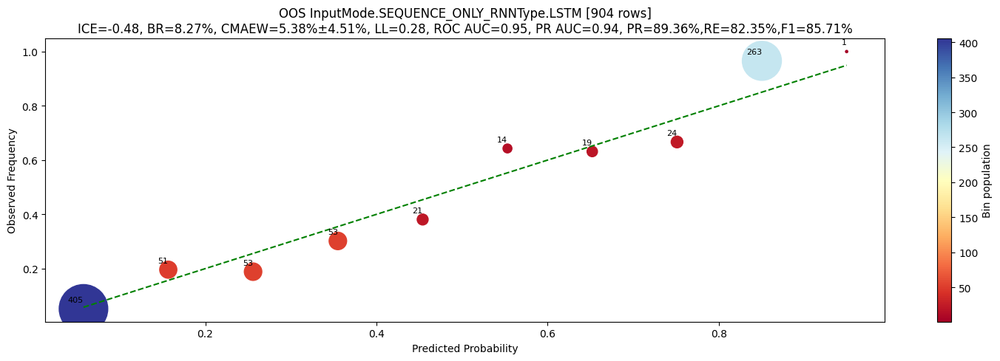

OOS InputMode.SEQUENCE_ONLY_RNNType.LSTM
              precision    recall  f1-score   support

           0       0.89      0.94      0.91       547
           1       0.89      0.82      0.86       357

    accuracy                           0.89       904
   macro avg       0.89      0.88      0.88       904
weighted avg       0.89      0.89      0.89       904

ROC AUCs: 1=0.95
PR AUCs: 1=0.94
CALIBRATIONs: 
	1: MAEW=5.38%, STD=4.51%, COV=90%
BRIER LOSSes: 
	1=8.27%
LOG_LOSSes: 
	1=0.28
ICEs: 
	1=-0.48
TOTAL INTEGRAL ERROR: 0.0000


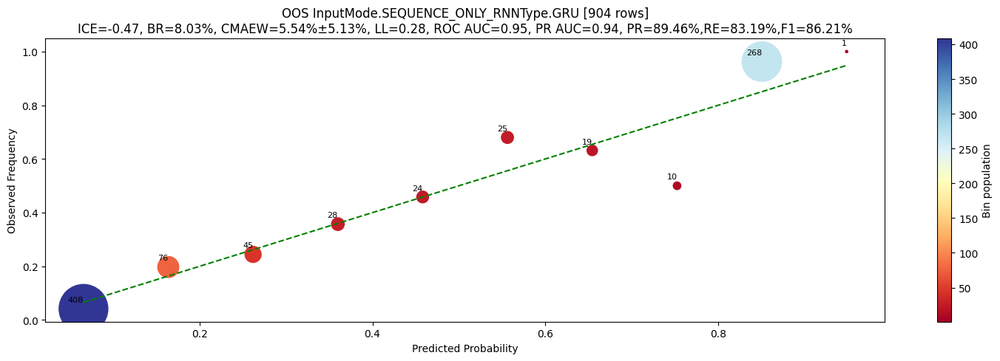

OOS InputMode.SEQUENCE_ONLY_RNNType.GRU
              precision    recall  f1-score   support

           0       0.90      0.94      0.92       547
           1       0.89      0.83      0.86       357

    accuracy                           0.89       904
   macro avg       0.89      0.88      0.89       904
weighted avg       0.89      0.89      0.89       904

ROC AUCs: 1=0.95
PR AUCs: 1=0.94
CALIBRATIONs: 
	1: MAEW=5.54%, STD=5.13%, COV=90%
BRIER LOSSes: 
	1=8.03%
LOG_LOSSes: 
	1=0.28
ICEs: 
	1=-0.47
TOTAL INTEGRAL ERROR: 0.0000


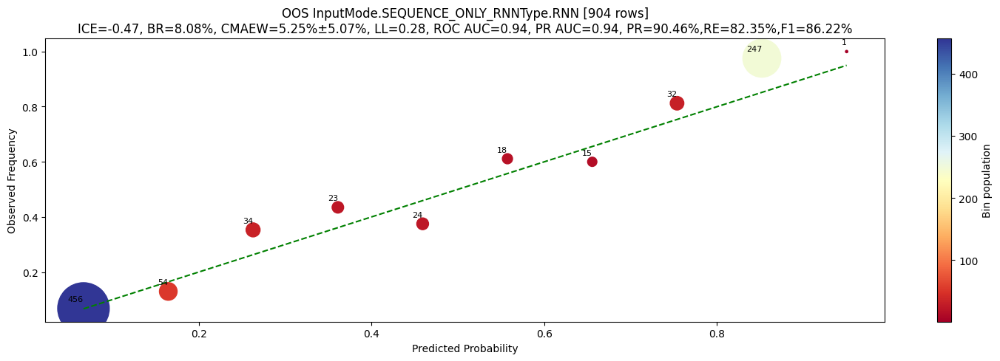

OOS InputMode.SEQUENCE_ONLY_RNNType.RNN
              precision    recall  f1-score   support

           0       0.89      0.94      0.92       547
           1       0.90      0.82      0.86       357

    accuracy                           0.90       904
   macro avg       0.90      0.88      0.89       904
weighted avg       0.90      0.90      0.90       904

ROC AUCs: 1=0.94
PR AUCs: 1=0.94
CALIBRATIONs: 
	1: MAEW=5.25%, STD=5.07%, COV=90%
BRIER LOSSes: 
	1=8.08%
LOG_LOSSes: 
	1=0.28
ICEs: 
	1=-0.47
TOTAL INTEGRAL ERROR: 0.0000


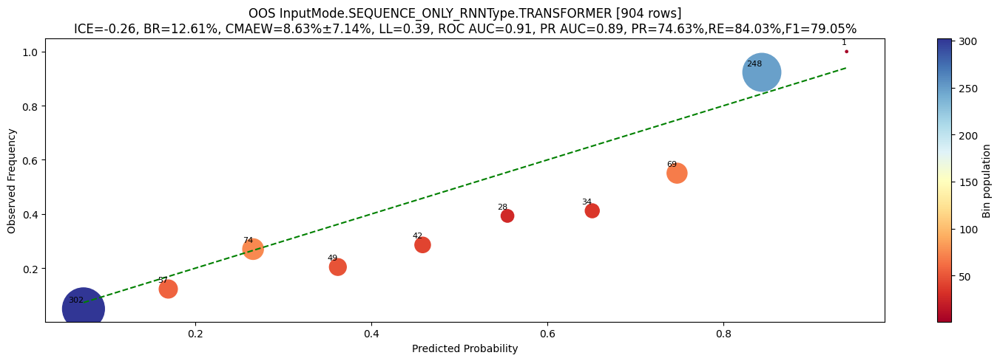

OOS InputMode.SEQUENCE_ONLY_RNNType.TRANSFORMER
              precision    recall  f1-score   support

           0       0.89      0.81      0.85       547
           1       0.75      0.84      0.79       357

    accuracy                           0.82       904
   macro avg       0.82      0.83      0.82       904
weighted avg       0.83      0.82      0.83       904

ROC AUCs: 1=0.91
PR AUCs: 1=0.89
CALIBRATIONs: 
	1: MAEW=8.63%, STD=7.14%, COV=90%
BRIER LOSSes: 
	1=12.61%
LOG_LOSSes: 
	1=0.39
ICEs: 
	1=-0.26
TOTAL INTEGRAL ERROR: 0.0000


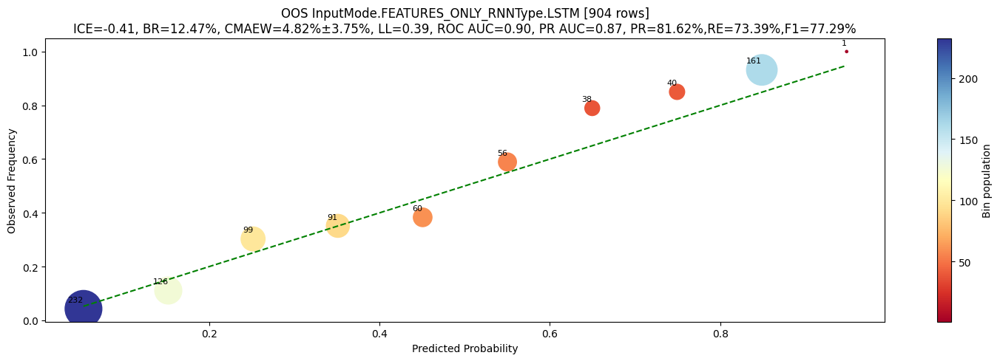

OOS InputMode.FEATURES_ONLY_RNNType.LSTM
              precision    recall  f1-score   support

           0       0.84      0.89      0.86       547
           1       0.82      0.73      0.77       357

    accuracy                           0.83       904
   macro avg       0.83      0.81      0.82       904
weighted avg       0.83      0.83      0.83       904

ROC AUCs: 1=0.90
PR AUCs: 1=0.87
CALIBRATIONs: 
	1: MAEW=4.82%, STD=3.75%, COV=90%
BRIER LOSSes: 
	1=12.47%
LOG_LOSSes: 
	1=0.39
ICEs: 
	1=-0.41
TOTAL INTEGRAL ERROR: 0.0000


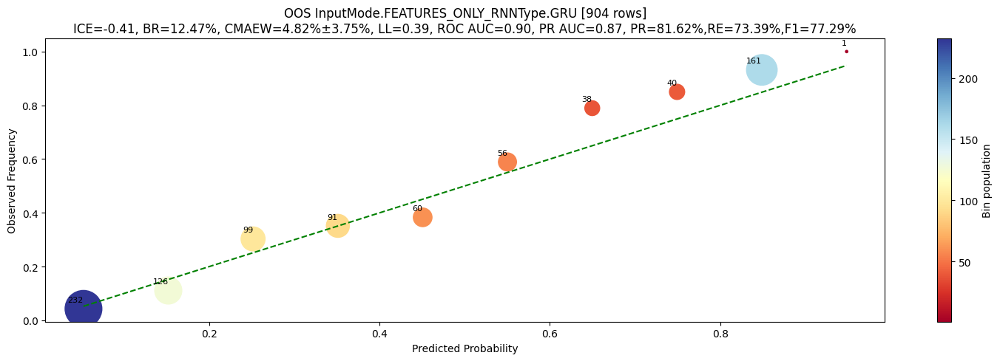

OOS InputMode.FEATURES_ONLY_RNNType.GRU
              precision    recall  f1-score   support

           0       0.84      0.89      0.86       547
           1       0.82      0.73      0.77       357

    accuracy                           0.83       904
   macro avg       0.83      0.81      0.82       904
weighted avg       0.83      0.83      0.83       904

ROC AUCs: 1=0.90
PR AUCs: 1=0.87
CALIBRATIONs: 
	1: MAEW=4.82%, STD=3.75%, COV=90%
BRIER LOSSes: 
	1=12.47%
LOG_LOSSes: 
	1=0.39
ICEs: 
	1=-0.41
TOTAL INTEGRAL ERROR: 0.0000


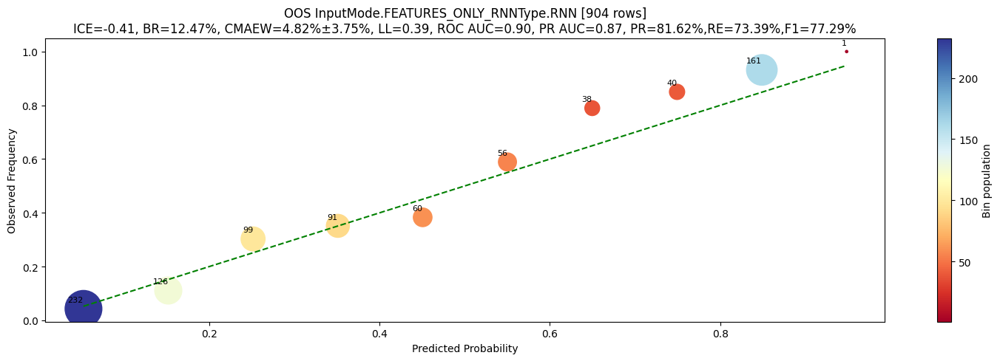

OOS InputMode.FEATURES_ONLY_RNNType.RNN
              precision    recall  f1-score   support

           0       0.84      0.89      0.86       547
           1       0.82      0.73      0.77       357

    accuracy                           0.83       904
   macro avg       0.83      0.81      0.82       904
weighted avg       0.83      0.83      0.83       904

ROC AUCs: 1=0.90
PR AUCs: 1=0.87
CALIBRATIONs: 
	1: MAEW=4.82%, STD=3.75%, COV=90%
BRIER LOSSes: 
	1=12.47%
LOG_LOSSes: 
	1=0.39
ICEs: 
	1=-0.41
TOTAL INTEGRAL ERROR: 0.0000


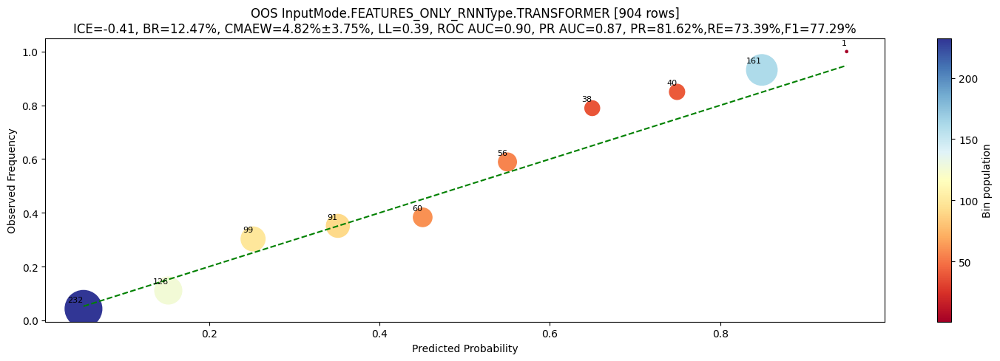

OOS InputMode.FEATURES_ONLY_RNNType.TRANSFORMER
              precision    recall  f1-score   support

           0       0.84      0.89      0.86       547
           1       0.82      0.73      0.77       357

    accuracy                           0.83       904
   macro avg       0.83      0.81      0.82       904
weighted avg       0.83      0.83      0.83       904

ROC AUCs: 1=0.90
PR AUCs: 1=0.87
CALIBRATIONs: 
	1: MAEW=4.82%, STD=3.75%, COV=90%
BRIER LOSSes: 
	1=12.47%
LOG_LOSSes: 
	1=0.39
ICEs: 
	1=-0.41
TOTAL INTEGRAL ERROR: 0.0000


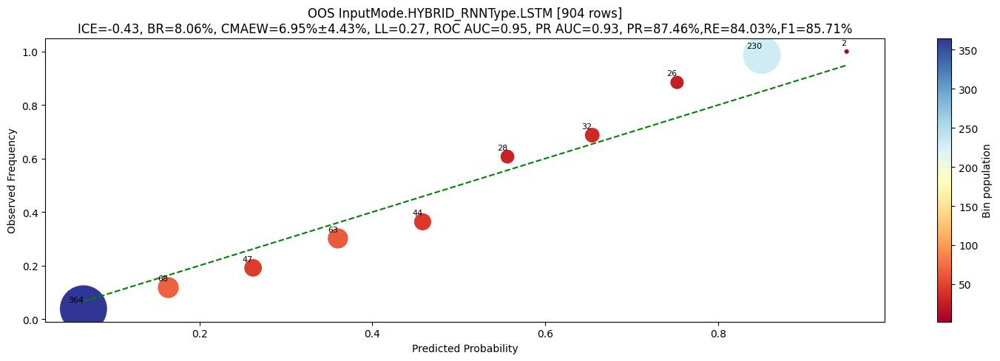

OOS InputMode.HYBRID_RNNType.LSTM
              precision    recall  f1-score   support

           0       0.90      0.92      0.91       547
           1       0.87      0.84      0.86       357

    accuracy                           0.89       904
   macro avg       0.89      0.88      0.88       904
weighted avg       0.89      0.89      0.89       904

ROC AUCs: 1=0.95
PR AUCs: 1=0.93
CALIBRATIONs: 
	1: MAEW=6.95%, STD=4.43%, COV=90%
BRIER LOSSes: 
	1=8.06%
LOG_LOSSes: 
	1=0.27
ICEs: 
	1=-0.43
TOTAL INTEGRAL ERROR: 0.0000


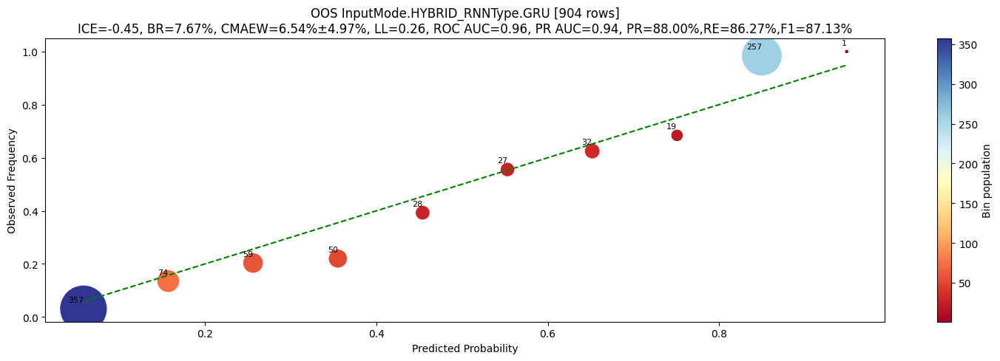

OOS InputMode.HYBRID_RNNType.GRU
              precision    recall  f1-score   support

           0       0.91      0.92      0.92       547
           1       0.88      0.86      0.87       357

    accuracy                           0.90       904
   macro avg       0.90      0.89      0.89       904
weighted avg       0.90      0.90      0.90       904

ROC AUCs: 1=0.96
PR AUCs: 1=0.94
CALIBRATIONs: 
	1: MAEW=6.54%, STD=4.97%, COV=90%
BRIER LOSSes: 
	1=7.67%
LOG_LOSSes: 
	1=0.26
ICEs: 
	1=-0.45
TOTAL INTEGRAL ERROR: 0.0000


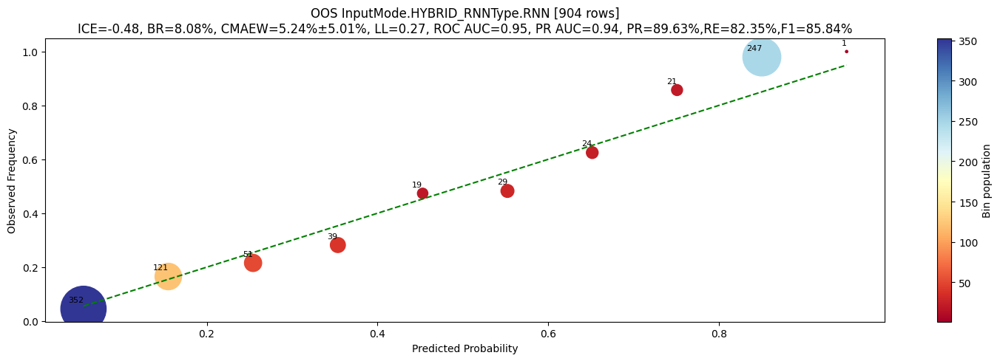

OOS InputMode.HYBRID_RNNType.RNN
              precision    recall  f1-score   support

           0       0.89      0.94      0.91       547
           1       0.90      0.82      0.86       357

    accuracy                           0.89       904
   macro avg       0.89      0.88      0.89       904
weighted avg       0.89      0.89      0.89       904

ROC AUCs: 1=0.95
PR AUCs: 1=0.94
CALIBRATIONs: 
	1: MAEW=5.24%, STD=5.01%, COV=90%
BRIER LOSSes: 
	1=8.08%
LOG_LOSSes: 
	1=0.27
ICEs: 
	1=-0.48
TOTAL INTEGRAL ERROR: 0.0000


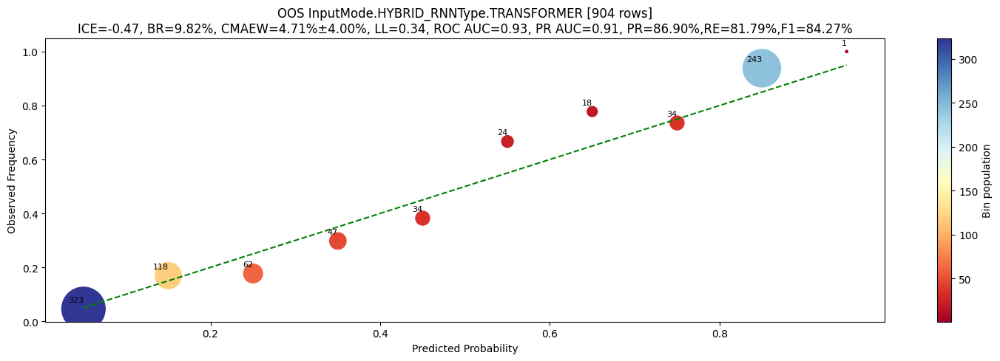

OOS InputMode.HYBRID_RNNType.TRANSFORMER
              precision    recall  f1-score   support

           0       0.89      0.92      0.90       547
           1       0.87      0.82      0.84       357

    accuracy                           0.88       904
   macro avg       0.88      0.87      0.87       904
weighted avg       0.88      0.88      0.88       904

ROC AUCs: 1=0.93
PR AUCs: 1=0.91
CALIBRATIONs: 
	1: MAEW=4.71%, STD=4.00%, COV=90%
BRIER LOSSes: 
	1=9.82%
LOG_LOSSes: 
	1=0.34
ICEs: 
	1=-0.47
TOTAL INTEGRAL ERROR: 0.0000
time: 11.5 s (started: 2026-01-03 15:11:04 +03:00)


In [44]:
eval_models(
    models, metrics, training_times, predicting_times
)  # "flux", "flux_err", "snr", "t_since_peak", "local_std", "detrended"

In [43]:
print(models, metrics, training_times, predicting_times)

{'InputMode.SEQUENCE_ONLY_RNNType.LSTM': <recurrent_classifier.RecurrentClassifierWrapper object at 0x000001D9741E4D10>, 'InputMode.SEQUENCE_ONLY_RNNType.GRU': <recurrent_classifier.RecurrentClassifierWrapper object at 0x000001D97EF0B3D0>, 'InputMode.SEQUENCE_ONLY_RNNType.RNN': <recurrent_classifier.RecurrentClassifierWrapper object at 0x000001D980AA3C50>, 'InputMode.SEQUENCE_ONLY_RNNType.TRANSFORMER': <recurrent_classifier.RecurrentClassifierWrapper object at 0x000001D991D24990>, 'InputMode.FEATURES_ONLY_RNNType.LSTM': <recurrent_classifier.RecurrentClassifierWrapper object at 0x000001D9989BC590>, 'InputMode.FEATURES_ONLY_RNNType.GRU': <recurrent_classifier.RecurrentClassifierWrapper object at 0x000001D998EB99D0>, 'InputMode.FEATURES_ONLY_RNNType.RNN': <recurrent_classifier.RecurrentClassifierWrapper object at 0x000001D99FD03D50>, 'InputMode.FEATURES_ONLY_RNNType.TRANSFORMER': <recurrent_classifier.RecurrentClassifierWrapper object at 0x000001D9ADE94DD0>, 'InputMode.HYBRID_RNNType.LST

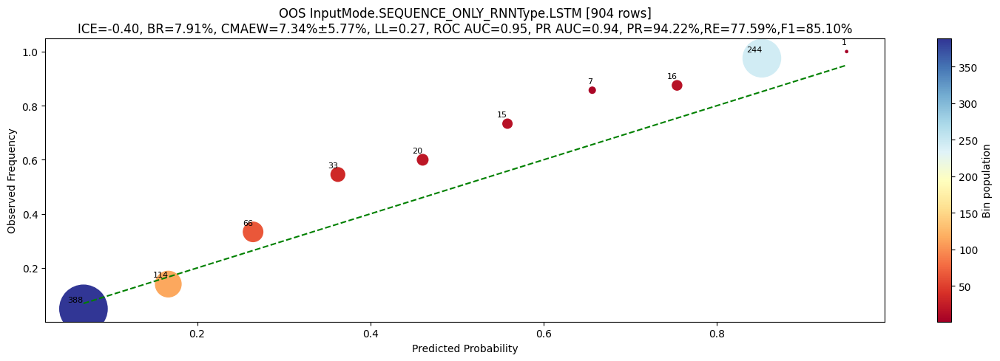

OOS InputMode.SEQUENCE_ONLY_RNNType.LSTM
              precision    recall  f1-score   support

           0       0.87      0.97      0.92       547
           1       0.94      0.78      0.85       357

    accuracy                           0.89       904
   macro avg       0.91      0.87      0.88       904
weighted avg       0.90      0.89      0.89       904

ROC AUCs: 1=0.95
PR AUCs: 1=0.94
CALIBRATIONs: 
	1: MAEW=7.34%, STD=5.77%, COV=90%
BRIER LOSSes: 
	1=7.91%
LOG_LOSSes: 
	1=0.27
ICEs: 
	1=-0.40
TOTAL INTEGRAL ERROR: 0.0000


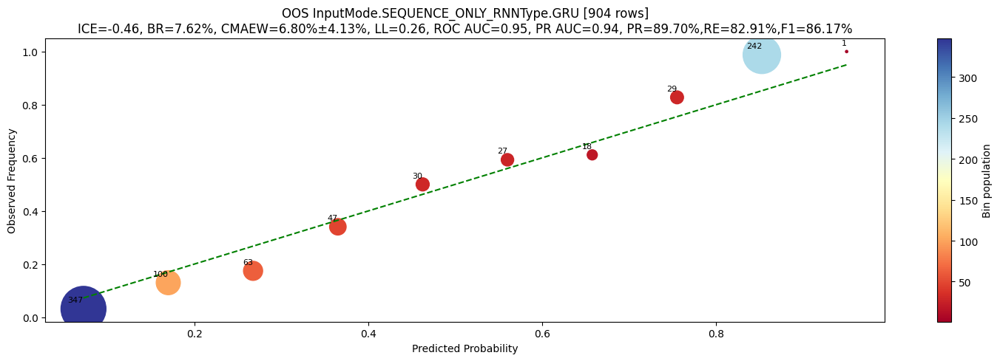

OOS InputMode.SEQUENCE_ONLY_RNNType.GRU
              precision    recall  f1-score   support

           0       0.89      0.94      0.92       547
           1       0.90      0.83      0.86       357

    accuracy                           0.89       904
   macro avg       0.90      0.88      0.89       904
weighted avg       0.90      0.89      0.89       904

ROC AUCs: 1=0.95
PR AUCs: 1=0.94
CALIBRATIONs: 
	1: MAEW=6.80%, STD=4.13%, COV=100%
BRIER LOSSes: 
	1=7.62%
LOG_LOSSes: 
	1=0.26
ICEs: 
	1=-0.46
TOTAL INTEGRAL ERROR: 0.0000


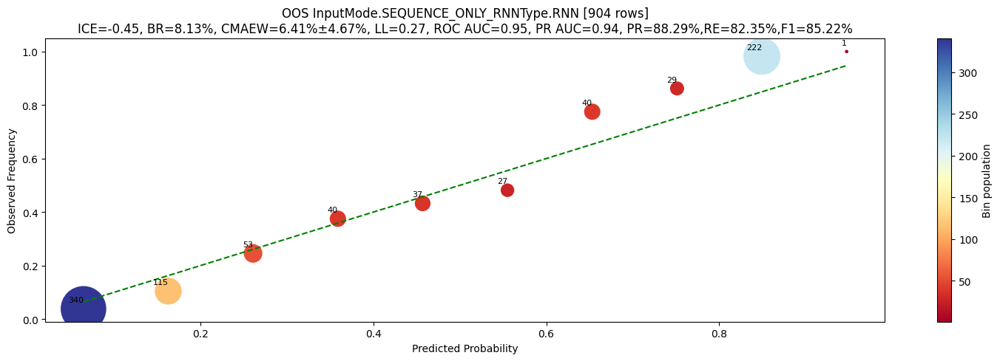

OOS InputMode.SEQUENCE_ONLY_RNNType.RNN
              precision    recall  f1-score   support

           0       0.89      0.93      0.91       547
           1       0.88      0.82      0.85       357

    accuracy                           0.89       904
   macro avg       0.89      0.88      0.88       904
weighted avg       0.89      0.89      0.89       904

ROC AUCs: 1=0.95
PR AUCs: 1=0.94
CALIBRATIONs: 
	1: MAEW=6.41%, STD=4.67%, COV=90%
BRIER LOSSes: 
	1=8.13%
LOG_LOSSes: 
	1=0.27
ICEs: 
	1=-0.45
TOTAL INTEGRAL ERROR: 0.0000


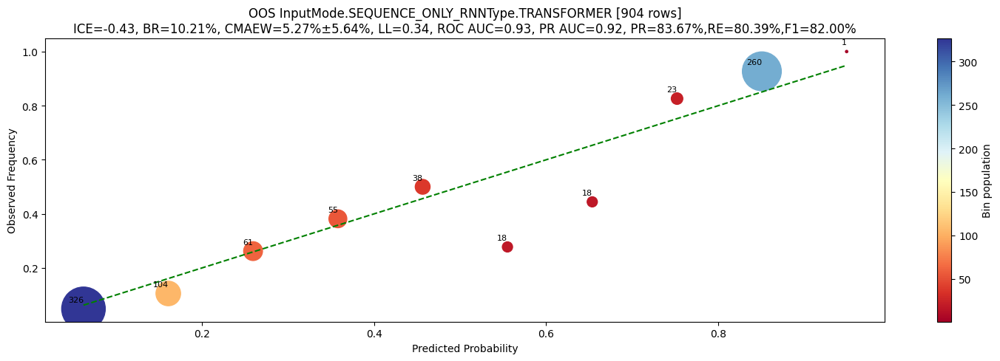

OOS InputMode.SEQUENCE_ONLY_RNNType.TRANSFORMER
              precision    recall  f1-score   support

           0       0.88      0.90      0.89       547
           1       0.84      0.80      0.82       357

    accuracy                           0.86       904
   macro avg       0.86      0.85      0.85       904
weighted avg       0.86      0.86      0.86       904

ROC AUCs: 1=0.93
PR AUCs: 1=0.92
CALIBRATIONs: 
	1: MAEW=5.27%, STD=5.64%, COV=90%
BRIER LOSSes: 
	1=10.21%
LOG_LOSSes: 
	1=0.34
ICEs: 
	1=-0.43
TOTAL INTEGRAL ERROR: 0.0000


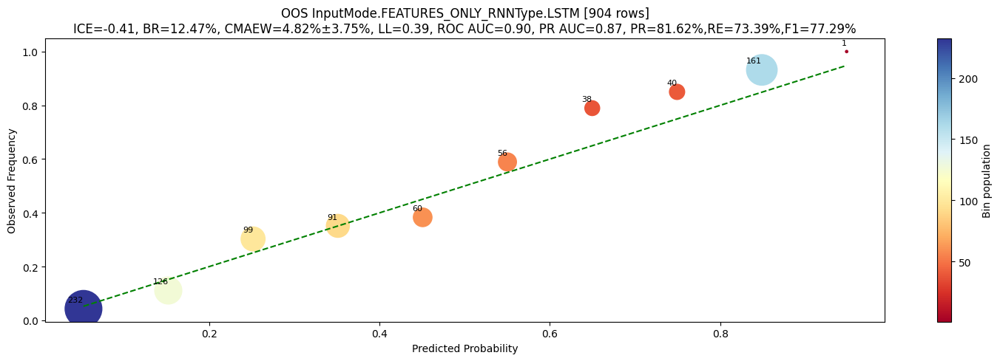

OOS InputMode.FEATURES_ONLY_RNNType.LSTM
              precision    recall  f1-score   support

           0       0.84      0.89      0.86       547
           1       0.82      0.73      0.77       357

    accuracy                           0.83       904
   macro avg       0.83      0.81      0.82       904
weighted avg       0.83      0.83      0.83       904

ROC AUCs: 1=0.90
PR AUCs: 1=0.87
CALIBRATIONs: 
	1: MAEW=4.82%, STD=3.75%, COV=90%
BRIER LOSSes: 
	1=12.47%
LOG_LOSSes: 
	1=0.39
ICEs: 
	1=-0.41
TOTAL INTEGRAL ERROR: 0.0000


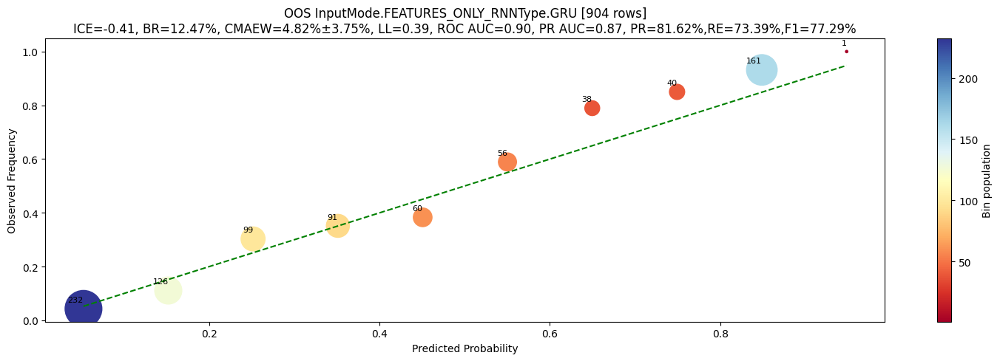

OOS InputMode.FEATURES_ONLY_RNNType.GRU
              precision    recall  f1-score   support

           0       0.84      0.89      0.86       547
           1       0.82      0.73      0.77       357

    accuracy                           0.83       904
   macro avg       0.83      0.81      0.82       904
weighted avg       0.83      0.83      0.83       904

ROC AUCs: 1=0.90
PR AUCs: 1=0.87
CALIBRATIONs: 
	1: MAEW=4.82%, STD=3.75%, COV=90%
BRIER LOSSes: 
	1=12.47%
LOG_LOSSes: 
	1=0.39
ICEs: 
	1=-0.41
TOTAL INTEGRAL ERROR: 0.0000


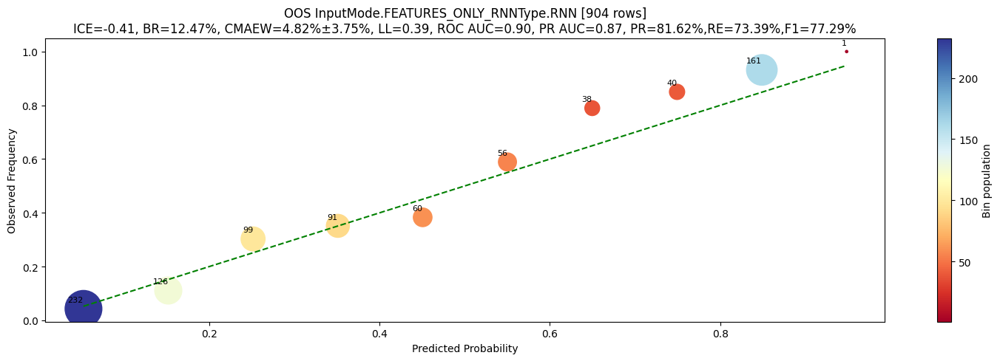

OOS InputMode.FEATURES_ONLY_RNNType.RNN
              precision    recall  f1-score   support

           0       0.84      0.89      0.86       547
           1       0.82      0.73      0.77       357

    accuracy                           0.83       904
   macro avg       0.83      0.81      0.82       904
weighted avg       0.83      0.83      0.83       904

ROC AUCs: 1=0.90
PR AUCs: 1=0.87
CALIBRATIONs: 
	1: MAEW=4.82%, STD=3.75%, COV=90%
BRIER LOSSes: 
	1=12.47%
LOG_LOSSes: 
	1=0.39
ICEs: 
	1=-0.41
TOTAL INTEGRAL ERROR: 0.0000


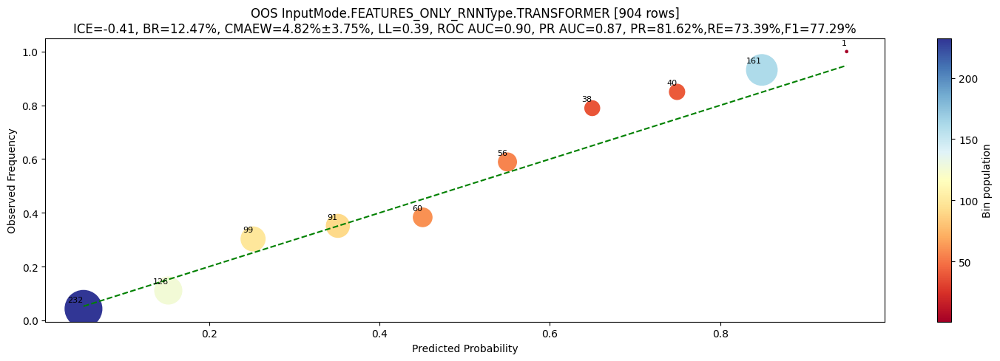

OOS InputMode.FEATURES_ONLY_RNNType.TRANSFORMER
              precision    recall  f1-score   support

           0       0.84      0.89      0.86       547
           1       0.82      0.73      0.77       357

    accuracy                           0.83       904
   macro avg       0.83      0.81      0.82       904
weighted avg       0.83      0.83      0.83       904

ROC AUCs: 1=0.90
PR AUCs: 1=0.87
CALIBRATIONs: 
	1: MAEW=4.82%, STD=3.75%, COV=90%
BRIER LOSSes: 
	1=12.47%
LOG_LOSSes: 
	1=0.39
ICEs: 
	1=-0.41
TOTAL INTEGRAL ERROR: 0.0000


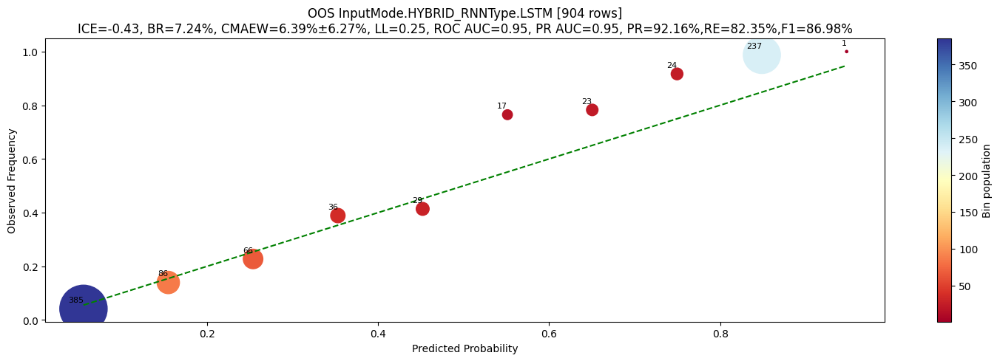

OOS InputMode.HYBRID_RNNType.LSTM
              precision    recall  f1-score   support

           0       0.89      0.95      0.92       547
           1       0.92      0.82      0.87       357

    accuracy                           0.90       904
   macro avg       0.91      0.89      0.90       904
weighted avg       0.90      0.90      0.90       904

ROC AUCs: 1=0.95
PR AUCs: 1=0.95
CALIBRATIONs: 
	1: MAEW=6.39%, STD=6.27%, COV=90%
BRIER LOSSes: 
	1=7.24%
LOG_LOSSes: 
	1=0.25
ICEs: 
	1=-0.43
TOTAL INTEGRAL ERROR: 0.0000


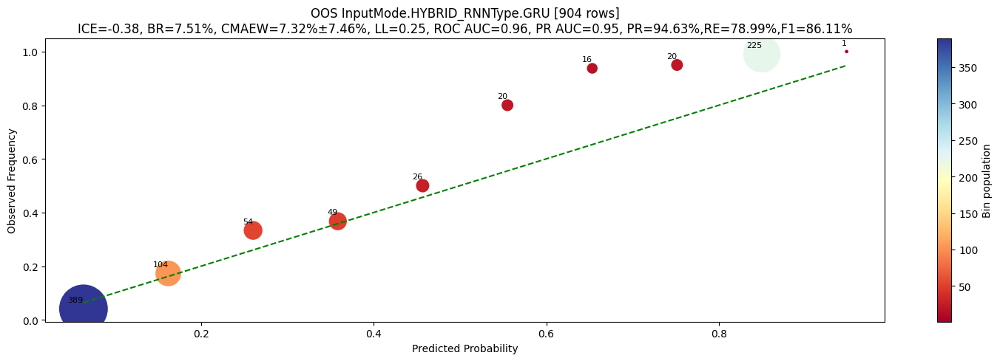

OOS InputMode.HYBRID_RNNType.GRU
              precision    recall  f1-score   support

           0       0.88      0.97      0.92       547
           1       0.95      0.79      0.86       357

    accuracy                           0.90       904
   macro avg       0.91      0.88      0.89       904
weighted avg       0.90      0.90      0.90       904

ROC AUCs: 1=0.96
PR AUCs: 1=0.95
CALIBRATIONs: 
	1: MAEW=7.32%, STD=7.46%, COV=90%
BRIER LOSSes: 
	1=7.51%
LOG_LOSSes: 
	1=0.25
ICEs: 
	1=-0.38
TOTAL INTEGRAL ERROR: 0.0000


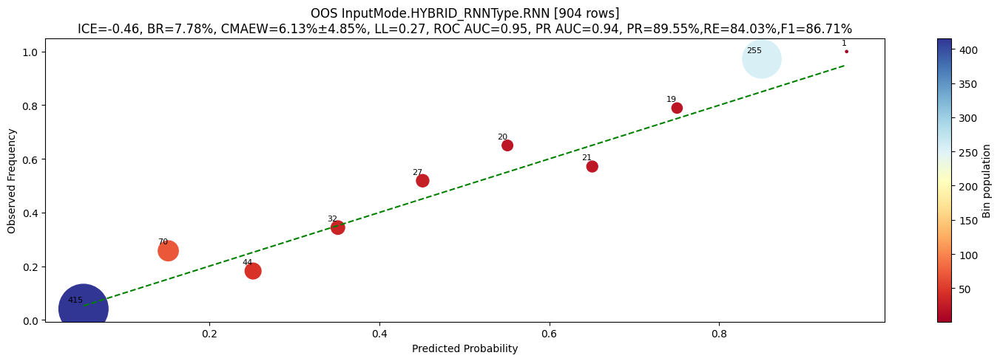

OOS InputMode.HYBRID_RNNType.RNN
              precision    recall  f1-score   support

           0       0.90      0.94      0.92       547
           1       0.90      0.84      0.87       357

    accuracy                           0.90       904
   macro avg       0.90      0.89      0.89       904
weighted avg       0.90      0.90      0.90       904

ROC AUCs: 1=0.95
PR AUCs: 1=0.94
CALIBRATIONs: 
	1: MAEW=6.13%, STD=4.85%, COV=90%
BRIER LOSSes: 
	1=7.78%
LOG_LOSSes: 
	1=0.27
ICEs: 
	1=-0.46
TOTAL INTEGRAL ERROR: 0.0000


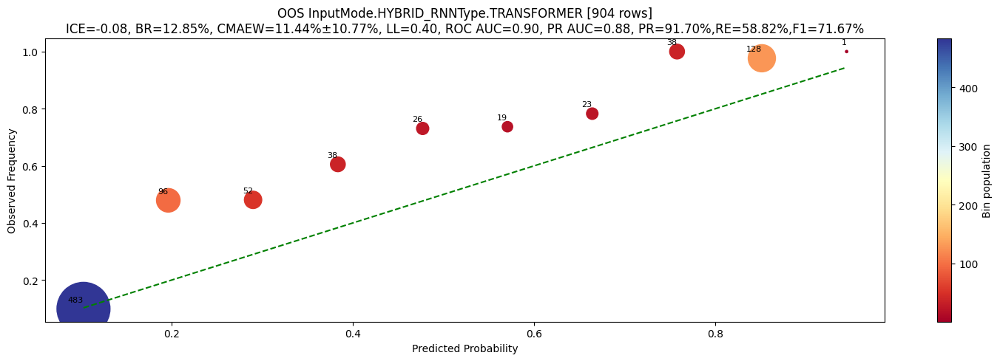

OOS InputMode.HYBRID_RNNType.TRANSFORMER
              precision    recall  f1-score   support

           0       0.78      0.97      0.86       547
           1       0.92      0.59      0.72       357

    accuracy                           0.82       904
   macro avg       0.85      0.78      0.79       904
weighted avg       0.84      0.82      0.81       904

ROC AUCs: 1=0.90
PR AUCs: 1=0.88
CALIBRATIONs: 
	1: MAEW=11.44%, STD=10.77%, COV=90%
BRIER LOSSes: 
	1=12.85%
LOG_LOSSes: 
	1=0.40
ICEs: 
	1=-0.08
TOTAL INTEGRAL ERROR: 0.0000
time: 9.73 s (started: 2026-01-03 07:26:09 +03:00)


In [42]:
eval_models(models, metrics, training_times, predicting_times)  # ("norm", "vel")

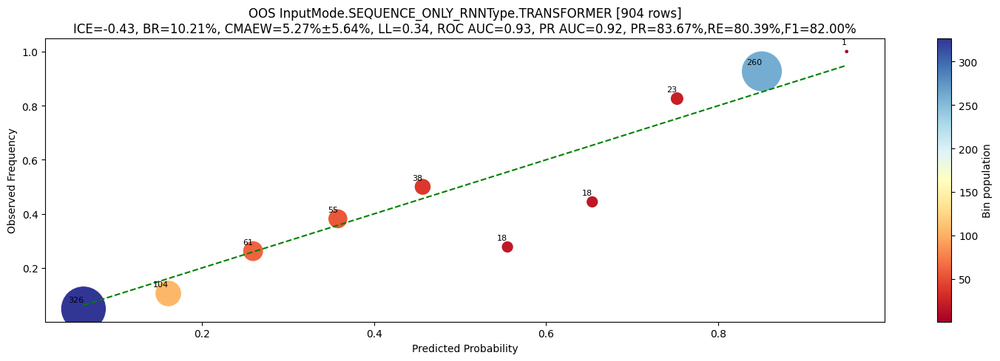 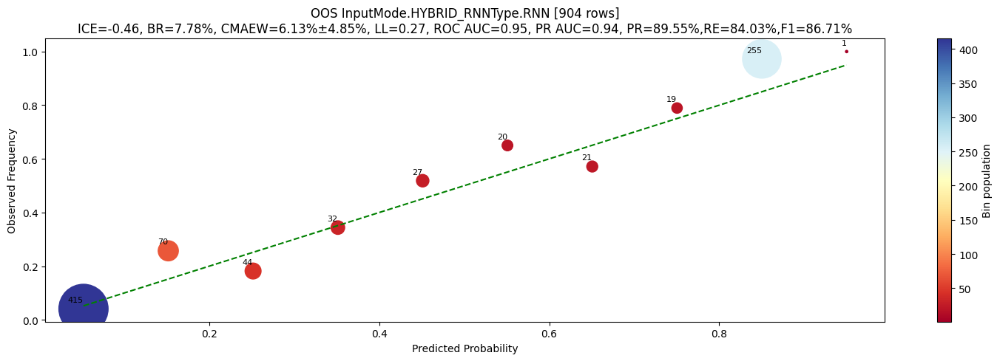

In [39]:
print(models, metrics, training_times, predicting_times)

{'InputMode.SEQUENCE_ONLY_RNNType.LSTM': <recurrent_classifier.RecurrentClassifierWrapper object at 0x0000023B9872B590>, 'InputMode.SEQUENCE_ONLY_RNNType.GRU': <recurrent_classifier.RecurrentClassifierWrapper object at 0x00000273F4B6CED0>, 'InputMode.SEQUENCE_ONLY_RNNType.RNN': <recurrent_classifier.RecurrentClassifierWrapper object at 0x00000273FB705F10>, 'InputMode.SEQUENCE_ONLY_RNNType.TRANSFORMER': <recurrent_classifier.RecurrentClassifierWrapper object at 0x00000273FBC006D0>, 'InputMode.FEATURES_ONLY_RNNType.LSTM': <recurrent_classifier.RecurrentClassifierWrapper object at 0x00000273FBC3DCD0>, 'InputMode.FEATURES_ONLY_RNNType.GRU': <recurrent_classifier.RecurrentClassifierWrapper object at 0x000002741341C490>, 'InputMode.FEATURES_ONLY_RNNType.RNN': <recurrent_classifier.RecurrentClassifierWrapper object at 0x000002740F3A0290>, 'InputMode.FEATURES_ONLY_RNNType.TRANSFORMER': <recurrent_classifier.RecurrentClassifierWrapper object at 0x0000027413CBC590>, 'InputMode.HYBRID_RNNType.LST

In [40]:
models, metrics, training_times, predicting_times

({'InputMode.SEQUENCE_ONLY_RNNType.LSTM': <recurrent_classifier.RecurrentClassifierWrapper at 0x23b9872b590>,
  'InputMode.SEQUENCE_ONLY_RNNType.GRU': <recurrent_classifier.RecurrentClassifierWrapper at 0x273f4b6ced0>,
  'InputMode.SEQUENCE_ONLY_RNNType.RNN': <recurrent_classifier.RecurrentClassifierWrapper at 0x273fb705f10>,
  'InputMode.SEQUENCE_ONLY_RNNType.TRANSFORMER': <recurrent_classifier.RecurrentClassifierWrapper at 0x273fbc006d0>,
  'InputMode.FEATURES_ONLY_RNNType.LSTM': <recurrent_classifier.RecurrentClassifierWrapper at 0x273fbc3dcd0>,
  'InputMode.FEATURES_ONLY_RNNType.GRU': <recurrent_classifier.RecurrentClassifierWrapper at 0x2741341c490>,
  'InputMode.FEATURES_ONLY_RNNType.RNN': <recurrent_classifier.RecurrentClassifierWrapper at 0x2740f3a0290>,
  'InputMode.FEATURES_ONLY_RNNType.TRANSFORMER': <recurrent_classifier.RecurrentClassifierWrapper at 0x27413cbc590>,
  'InputMode.HYBRID_RNNType.LSTM': <recurrent_classifier.RecurrentClassifierWrapper at 0x274135d9950>,
  'Inpu

time: 31 ms (started: 2026-01-03 07:23:56 +03:00)


2026-01-02 09:22:40,038 - INFO - prepare_recurrent_training_data-line:283 - Prepared features: (8132, 97), labels: (8132,)
2026-01-02 09:22:44,866 - INFO - prepare_recurrent_training_data-line:307 - Extracted 8132 sequences
2026-01-02 09:22:44,896 - INFO - seed_everything-line:54 - Seed set to 42
2026-01-02 09:22:47,688 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2026-01-02 09:22:47,691 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2026-01-02 09:22:47,692 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\callbacks\model_checkpoint.py:652: Checkpoint directory S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\checkpoints exists and is not empty.
2026-01-02 09:22:47,702 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2026-01-02 09:22:47,835 - INFO - _info-line:64 - Loading `train_dataloader` to estimate number of stepping batches.
R:

Sanity Checking: |                                                                               | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
R:\ProgramData\anaconda3\Lib\site-packages\torchmetrics\utilities\data.py:219: UserWarning:

cumsum_cuda_kernel does not have a deterministic implementation, but you set 'torch.use_deterministic_algorithms(True, warn_only=True)'. You can file an issue at https://github.com/pytorch/pytorch/issues to help us prioritize adding deterministic support for this operation. (Triggered internally at ..\aten\src\ATen\Context.cpp:87.)



Training: |                                                                                      | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

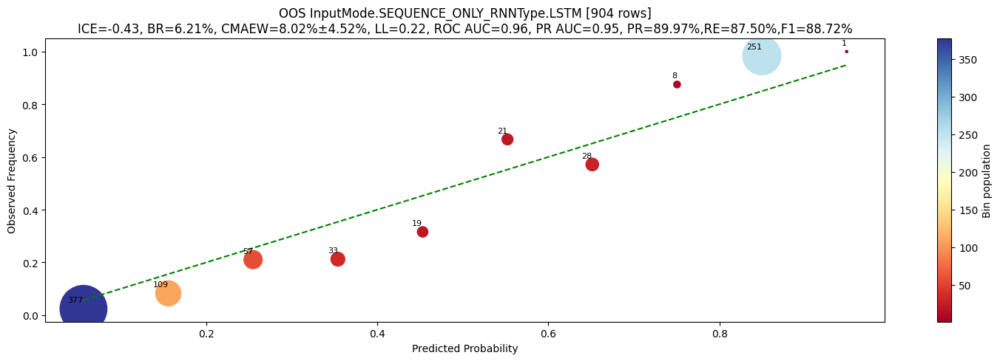

2026-01-02 09:53:59,963 - INFO - prepare_recurrent_training_data-line:283 - Prepared features: (8132, 97), labels: (8132,)


OOS InputMode.SEQUENCE_ONLY_RNNType.LSTM
              precision    recall  f1-score   support

           0       0.93      0.94      0.94       576
           1       0.90      0.88      0.89       328

    accuracy                           0.92       904
   macro avg       0.91      0.91      0.91       904
weighted avg       0.92      0.92      0.92       904

ROC AUCs: 1=0.96
PR AUCs: 1=0.95
CALIBRATIONs: 
	1: MAEW=8.02%, STD=4.52%, COV=90%
BRIER LOSSes: 
	1=6.21%
LOG_LOSSes: 
	1=0.22
ICEs: 
	1=-0.43
TOTAL INTEGRAL ERROR: 0.0000


2026-01-02 09:54:09,701 - INFO - prepare_recurrent_training_data-line:307 - Extracted 8132 sequences
2026-01-02 09:54:09,755 - INFO - seed_everything-line:54 - Seed set to 42
2026-01-02 09:54:15,038 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2026-01-02 09:54:15,042 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2026-01-02 09:54:15,046 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\callbacks\model_checkpoint.py:652: Checkpoint directory S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\checkpoints exists and is not empty.
2026-01-02 09:54:15,062 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2026-01-02 09:54:15,113 - INFO - _info-line:64 - Loading `train_dataloader` to estimate number of stepping batches.
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'train_dataloader'

Sanity Checking: |                                                                               | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
R:\ProgramData\anaconda3\Lib\site-packages\torchmetrics\utilities\data.py:219: UserWarning:

cumsum_cuda_kernel does not have a deterministic implementation, but you set 'torch.use_deterministic_algorithms(True, warn_only=True)'. You can file an issue at https://github.com/pytorch/pytorch/issues to help us prioritize adding deterministic support for this operation. (Triggered internally at ..\aten\src\ATen\Context.cpp:87.)



Training: |                                                                                      | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

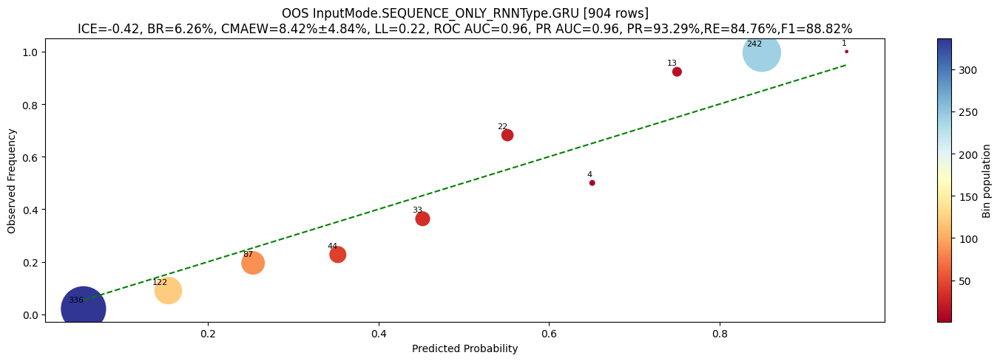

2026-01-02 10:24:18,944 - INFO - prepare_recurrent_training_data-line:283 - Prepared features: (8132, 97), labels: (8132,)


OOS InputMode.SEQUENCE_ONLY_RNNType.GRU
              precision    recall  f1-score   support

           0       0.92      0.97      0.94       576
           1       0.93      0.85      0.89       328

    accuracy                           0.92       904
   macro avg       0.93      0.91      0.91       904
weighted avg       0.92      0.92      0.92       904

ROC AUCs: 1=0.96
PR AUCs: 1=0.96
CALIBRATIONs: 
	1: MAEW=8.42%, STD=4.84%, COV=90%
BRIER LOSSes: 
	1=6.26%
LOG_LOSSes: 
	1=0.22
ICEs: 
	1=-0.42
TOTAL INTEGRAL ERROR: 0.0000


2026-01-02 10:24:29,111 - INFO - prepare_recurrent_training_data-line:307 - Extracted 8132 sequences
2026-01-02 10:24:29,168 - INFO - seed_everything-line:54 - Seed set to 42
2026-01-02 10:24:34,860 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2026-01-02 10:24:34,864 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2026-01-02 10:24:34,868 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\callbacks\model_checkpoint.py:652: Checkpoint directory S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\checkpoints exists and is not empty.
2026-01-02 10:24:34,885 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2026-01-02 10:24:34,956 - INFO - _info-line:64 - Loading `train_dataloader` to estimate number of stepping batches.
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'train_dataloader'

Sanity Checking: |                                                                               | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
R:\ProgramData\anaconda3\Lib\site-packages\torchmetrics\utilities\data.py:219: UserWarning:

cumsum_cuda_kernel does not have a deterministic implementation, but you set 'torch.use_deterministic_algorithms(True, warn_only=True)'. You can file an issue at https://github.com/pytorch/pytorch/issues to help us prioritize adding deterministic support for this operation. (Triggered internally at ..\aten\src\ATen\Context.cpp:87.)



Training: |                                                                                      | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

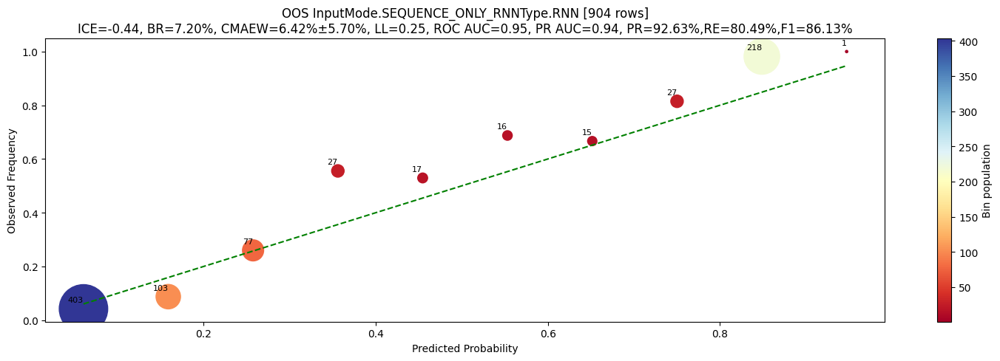

2026-01-02 10:54:13,851 - INFO - prepare_recurrent_training_data-line:283 - Prepared features: (8132, 97), labels: (8132,)


OOS InputMode.SEQUENCE_ONLY_RNNType.RNN
              precision    recall  f1-score   support

           0       0.90      0.96      0.93       576
           1       0.93      0.80      0.86       328

    accuracy                           0.91       904
   macro avg       0.91      0.88      0.90       904
weighted avg       0.91      0.91      0.90       904

ROC AUCs: 1=0.95
PR AUCs: 1=0.94
CALIBRATIONs: 
	1: MAEW=6.42%, STD=5.70%, COV=90%
BRIER LOSSes: 
	1=7.20%
LOG_LOSSes: 
	1=0.25
ICEs: 
	1=-0.44
TOTAL INTEGRAL ERROR: 0.0000


2026-01-02 10:54:20,009 - INFO - prepare_recurrent_training_data-line:307 - Extracted 8132 sequences
2026-01-02 10:54:20,058 - INFO - seed_everything-line:54 - Seed set to 42
2026-01-02 10:54:23,543 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2026-01-02 10:54:23,548 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2026-01-02 10:54:23,551 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\callbacks\model_checkpoint.py:652: Checkpoint directory S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\checkpoints exists and is not empty.
2026-01-02 10:54:23,568 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2026-01-02 10:54:23,668 - INFO - _info-line:64 - Loading `train_dataloader` to estimate number of stepping batches.
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'train_dataloader'

Sanity Checking: |                                                                               | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
R:\ProgramData\anaconda3\Lib\site-packages\torchmetrics\utilities\data.py:219: UserWarning:

cumsum_cuda_kernel does not have a deterministic implementation, but you set 'torch.use_deterministic_algorithms(True, warn_only=True)'. You can file an issue at https://github.com/pytorch/pytorch/issues to help us prioritize adding deterministic support for this operation. (Triggered internally at ..\aten\src\ATen\Context.cpp:87.)



Training: |                                                                                      | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

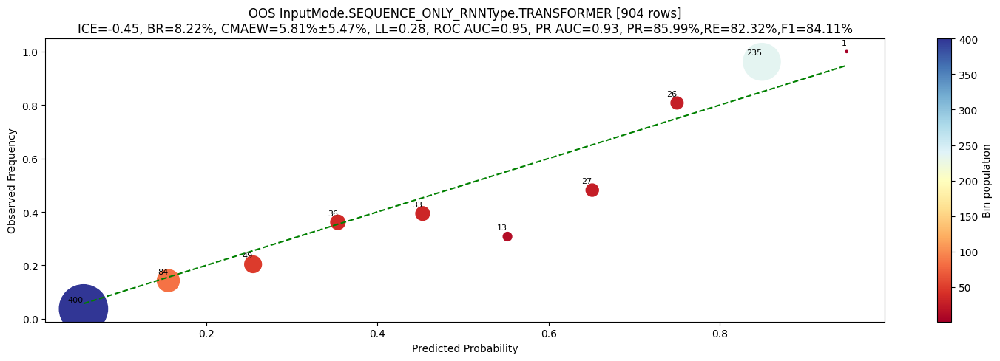

2026-01-02 11:22:56,073 - INFO - prepare_recurrent_training_data-line:283 - Prepared features: (8132, 97), labels: (8132,)
2026-01-02 11:22:56,100 - INFO - seed_everything-line:54 - Seed set to 42


OOS InputMode.SEQUENCE_ONLY_RNNType.TRANSFORMER
              precision    recall  f1-score   support

           0       0.90      0.92      0.91       576
           1       0.86      0.82      0.84       328

    accuracy                           0.89       904
   macro avg       0.88      0.87      0.88       904
weighted avg       0.89      0.89      0.89       904

ROC AUCs: 1=0.95
PR AUCs: 1=0.93
CALIBRATIONs: 
	1: MAEW=5.81%, STD=5.47%, COV=90%
BRIER LOSSes: 
	1=8.22%
LOG_LOSSes: 
	1=0.28
ICEs: 
	1=-0.45
TOTAL INTEGRAL ERROR: 0.0000


2026-01-02 11:22:56,580 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2026-01-02 11:22:56,584 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2026-01-02 11:22:56,587 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\callbacks\model_checkpoint.py:652: Checkpoint directory S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\checkpoints exists and is not empty.
2026-01-02 11:22:56,604 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2026-01-02 11:22:56,626 - INFO - _info-line:64 - Loading `train_dataloader` to estimate number of stepping batches.
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performa

Sanity Checking: |                                                                               | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
R:\ProgramData\anaconda3\Lib\site-packages\torchmetrics\utilities\data.py:219: UserWarning:

cumsum_cuda_kernel does not have a deterministic implementation, but you set 'torch.use_deterministic_algorithms(True, warn_only=True)'. You can file an issue at https://github.com/pytorch/pytorch/issues to help us prioritize adding deterministic support for this operation. (Triggered internally at ..\aten\src\ATen\Context.cpp:87.)



Training: |                                                                                      | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

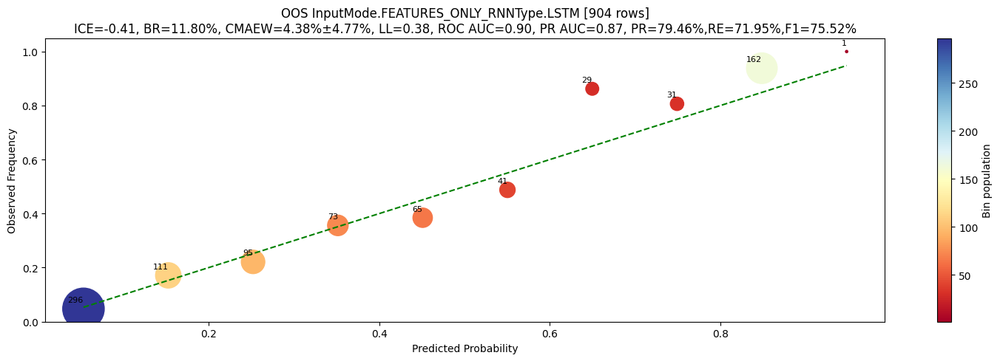

2026-01-02 11:27:15,862 - INFO - prepare_recurrent_training_data-line:283 - Prepared features: (8132, 97), labels: (8132,)
2026-01-02 11:27:15,910 - INFO - seed_everything-line:54 - Seed set to 42


OOS InputMode.FEATURES_ONLY_RNNType.LSTM
              precision    recall  f1-score   support

           0       0.85      0.89      0.87       576
           1       0.79      0.72      0.76       328

    accuracy                           0.83       904
   macro avg       0.82      0.81      0.81       904
weighted avg       0.83      0.83      0.83       904

ROC AUCs: 1=0.90
PR AUCs: 1=0.87
CALIBRATIONs: 
	1: MAEW=4.38%, STD=4.77%, COV=90%
BRIER LOSSes: 
	1=11.80%
LOG_LOSSes: 
	1=0.38
ICEs: 
	1=-0.41
TOTAL INTEGRAL ERROR: 0.0000


2026-01-02 11:27:16,518 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2026-01-02 11:27:16,715 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2026-01-02 11:27:16,718 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\callbacks\model_checkpoint.py:652: Checkpoint directory S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\checkpoints exists and is not empty.
2026-01-02 11:27:16,737 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2026-01-02 11:27:16,774 - INFO - _info-line:64 - Loading `train_dataloader` to estimate number of stepping batches.
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performa

Sanity Checking: |                                                                               | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
R:\ProgramData\anaconda3\Lib\site-packages\torchmetrics\utilities\data.py:219: UserWarning:

cumsum_cuda_kernel does not have a deterministic implementation, but you set 'torch.use_deterministic_algorithms(True, warn_only=True)'. You can file an issue at https://github.com/pytorch/pytorch/issues to help us prioritize adding deterministic support for this operation. (Triggered internally at ..\aten\src\ATen\Context.cpp:87.)



Training: |                                                                                      | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

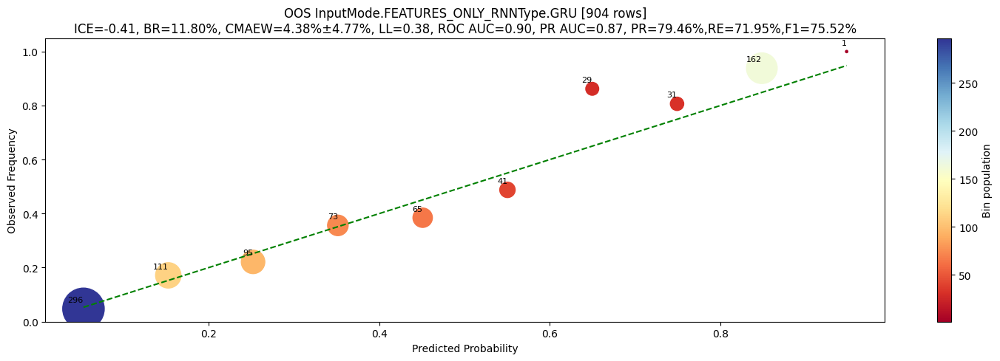

2026-01-02 11:31:37,426 - INFO - prepare_recurrent_training_data-line:283 - Prepared features: (8132, 97), labels: (8132,)
2026-01-02 11:31:37,470 - INFO - seed_everything-line:54 - Seed set to 42


OOS InputMode.FEATURES_ONLY_RNNType.GRU
              precision    recall  f1-score   support

           0       0.85      0.89      0.87       576
           1       0.79      0.72      0.76       328

    accuracy                           0.83       904
   macro avg       0.82      0.81      0.81       904
weighted avg       0.83      0.83      0.83       904

ROC AUCs: 1=0.90
PR AUCs: 1=0.87
CALIBRATIONs: 
	1: MAEW=4.38%, STD=4.77%, COV=90%
BRIER LOSSes: 
	1=11.80%
LOG_LOSSes: 
	1=0.38
ICEs: 
	1=-0.41
TOTAL INTEGRAL ERROR: 0.0000


2026-01-02 11:31:38,100 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2026-01-02 11:31:38,104 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2026-01-02 11:31:38,108 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\callbacks\model_checkpoint.py:652: Checkpoint directory S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\checkpoints exists and is not empty.
2026-01-02 11:31:38,124 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2026-01-02 11:31:38,156 - INFO - _info-line:64 - Loading `train_dataloader` to estimate number of stepping batches.
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performa

Sanity Checking: |                                                                               | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
R:\ProgramData\anaconda3\Lib\site-packages\torchmetrics\utilities\data.py:219: UserWarning:

cumsum_cuda_kernel does not have a deterministic implementation, but you set 'torch.use_deterministic_algorithms(True, warn_only=True)'. You can file an issue at https://github.com/pytorch/pytorch/issues to help us prioritize adding deterministic support for this operation. (Triggered internally at ..\aten\src\ATen\Context.cpp:87.)



Training: |                                                                                      | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

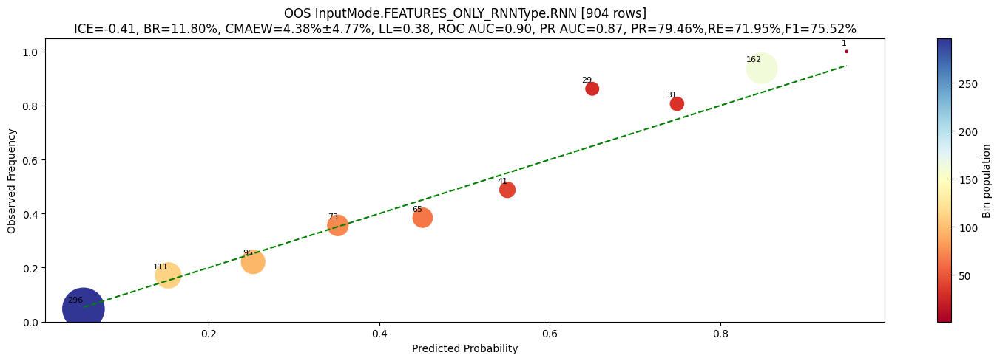

2026-01-02 11:35:48,682 - INFO - prepare_recurrent_training_data-line:283 - Prepared features: (8132, 97), labels: (8132,)
2026-01-02 11:35:48,711 - INFO - seed_everything-line:54 - Seed set to 42


OOS InputMode.FEATURES_ONLY_RNNType.RNN
              precision    recall  f1-score   support

           0       0.85      0.89      0.87       576
           1       0.79      0.72      0.76       328

    accuracy                           0.83       904
   macro avg       0.82      0.81      0.81       904
weighted avg       0.83      0.83      0.83       904

ROC AUCs: 1=0.90
PR AUCs: 1=0.87
CALIBRATIONs: 
	1: MAEW=4.38%, STD=4.77%, COV=90%
BRIER LOSSes: 
	1=11.80%
LOG_LOSSes: 
	1=0.38
ICEs: 
	1=-0.41
TOTAL INTEGRAL ERROR: 0.0000


2026-01-02 11:35:49,271 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2026-01-02 11:35:49,276 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2026-01-02 11:35:49,279 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\callbacks\model_checkpoint.py:652: Checkpoint directory S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\checkpoints exists and is not empty.
2026-01-02 11:35:49,297 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2026-01-02 11:35:49,333 - INFO - _info-line:64 - Loading `train_dataloader` to estimate number of stepping batches.
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performa

Sanity Checking: |                                                                               | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
R:\ProgramData\anaconda3\Lib\site-packages\torchmetrics\utilities\data.py:219: UserWarning:

cumsum_cuda_kernel does not have a deterministic implementation, but you set 'torch.use_deterministic_algorithms(True, warn_only=True)'. You can file an issue at https://github.com/pytorch/pytorch/issues to help us prioritize adding deterministic support for this operation. (Triggered internally at ..\aten\src\ATen\Context.cpp:87.)



Training: |                                                                                      | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

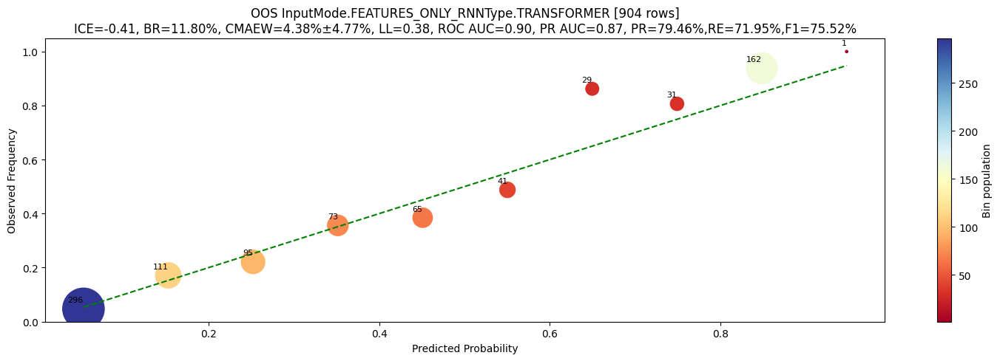

2026-01-02 11:40:06,843 - INFO - prepare_recurrent_training_data-line:283 - Prepared features: (8132, 97), labels: (8132,)


OOS InputMode.FEATURES_ONLY_RNNType.TRANSFORMER
              precision    recall  f1-score   support

           0       0.85      0.89      0.87       576
           1       0.79      0.72      0.76       328

    accuracy                           0.83       904
   macro avg       0.82      0.81      0.81       904
weighted avg       0.83      0.83      0.83       904

ROC AUCs: 1=0.90
PR AUCs: 1=0.87
CALIBRATIONs: 
	1: MAEW=4.38%, STD=4.77%, COV=90%
BRIER LOSSes: 
	1=11.80%
LOG_LOSSes: 
	1=0.38
ICEs: 
	1=-0.41
TOTAL INTEGRAL ERROR: 0.0000


2026-01-02 11:40:12,714 - INFO - prepare_recurrent_training_data-line:307 - Extracted 8132 sequences
2026-01-02 11:40:12,742 - INFO - seed_everything-line:54 - Seed set to 42
2026-01-02 11:40:15,652 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2026-01-02 11:40:15,656 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2026-01-02 11:40:15,660 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\callbacks\model_checkpoint.py:652: Checkpoint directory S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\checkpoints exists and is not empty.
2026-01-02 11:40:15,680 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2026-01-02 11:40:15,769 - INFO - _info-line:64 - Loading `train_dataloader` to estimate number of stepping batches.
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'train_dataloader'

Sanity Checking: |                                                                               | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
R:\ProgramData\anaconda3\Lib\site-packages\torchmetrics\utilities\data.py:219: UserWarning:

cumsum_cuda_kernel does not have a deterministic implementation, but you set 'torch.use_deterministic_algorithms(True, warn_only=True)'. You can file an issue at https://github.com/pytorch/pytorch/issues to help us prioritize adding deterministic support for this operation. (Triggered internally at ..\aten\src\ATen\Context.cpp:87.)



Training: |                                                                                      | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

RuntimeError: CUDA error: unspecified launch failure
CUDA kernel errors might be asynchronously reported at some other API call, so the stacktrace below might be incorrect.
For debugging consider passing CUDA_LAUNCH_BLOCKING=1.
Compile with `TORCH_USE_CUDA_DSA` to enable device-side assertions.


time: 2h 52min 23s (started: 2026-01-02 09:22:40 +03:00)


In [110]:
eval_models()

2026-01-02 15:15:32,294 - INFO - prepare_recurrent_training_data-line:283 - Prepared features: (8132, 97), labels: (8132,)
2026-01-02 15:16:11,883 - INFO - prepare_recurrent_training_data-line:307 - Extracted 8132 sequences
2026-01-02 15:16:11,961 - INFO - seed_everything-line:54 - Seed set to 42
2026-01-02 15:16:18,651 - INFO - _info-line:64 - Using 16bit Automatic Mixed Precision (AMP)
2026-01-02 15:16:19,555 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2026-01-02 15:16:19,557 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2026-01-02 15:16:19,557 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\callbacks\model_checkpoint.py:652: Checkpoint directory S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\checkpoints exists and is not empty.
2026-01-02 15:16:22,665 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2026-01-02 15:16:43,601 -

Sanity Checking: |                                                                               | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
R:\ProgramData\anaconda3\Lib\site-packages\torchmetrics\utilities\data.py:219: UserWarning:

cumsum_cuda_kernel does not have a deterministic implementation, but you set 'torch.use_deterministic_algorithms(True, warn_only=True)'. You can file an issue at https://github.com/pytorch/pytorch/issues to help us prioritize adding deterministic support for this operation. (Triggered internally at ..\aten\src\ATen\Context.cpp:87.)



Training: |                                                                                      | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-02 16:34:08,099 - INFO - _info-line:64 - Using 16bit Automatic Mixed Precision (AMP)
2026-01-02 16:34:08,629 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2026-01-02 16:34:08,637 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2026-01-02 16:34:08,637 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
2026-01-02 16:34:08,648 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'predict_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.


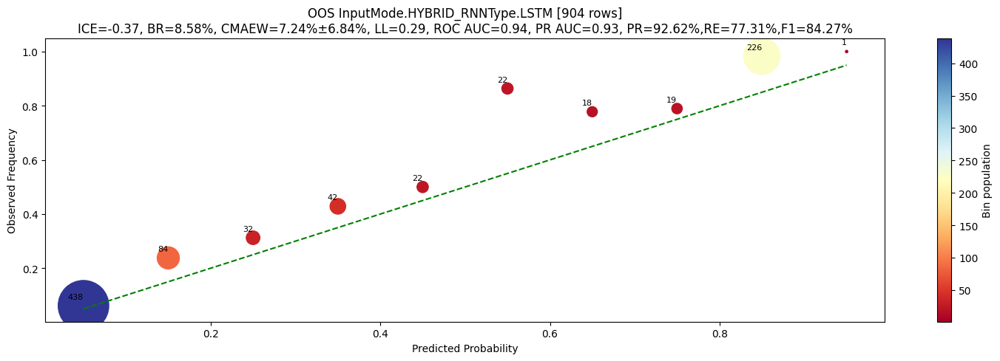

2026-01-02 16:34:27,197 - INFO - prepare_recurrent_training_data-line:283 - Prepared features: (8132, 97), labels: (8132,)


OOS InputMode.HYBRID_RNNType.LSTM
              precision    recall  f1-score   support

           0       0.87      0.96      0.91       547
           1       0.93      0.77      0.84       357

    accuracy                           0.89       904
   macro avg       0.90      0.87      0.88       904
weighted avg       0.89      0.89      0.88       904

ROC AUCs: 1=0.94
PR AUCs: 1=0.93
CALIBRATIONs: 
	1: MAEW=7.24%, STD=6.84%, COV=90%
BRIER LOSSes: 
	1=8.58%
LOG_LOSSes: 
	1=0.29
ICEs: 
	1=-0.37
TOTAL INTEGRAL ERROR: 0.0000


2026-01-02 16:34:32,069 - INFO - prepare_recurrent_training_data-line:307 - Extracted 8132 sequences
2026-01-02 16:34:32,099 - INFO - seed_everything-line:54 - Seed set to 42
2026-01-02 16:34:34,550 - INFO - _info-line:64 - Using 16bit Automatic Mixed Precision (AMP)
2026-01-02 16:34:34,885 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2026-01-02 16:34:34,885 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2026-01-02 16:34:34,893 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\callbacks\model_checkpoint.py:652: Checkpoint directory S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\checkpoints exists and is not empty.
2026-01-02 16:34:34,904 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2026-01-02 16:34:34,982 - INFO - _info-line:64 - Loading `train_dataloader` to estimate number of stepping batches.
R:\ProgramData\anaconda3\Lib\sit

Sanity Checking: |                                                                               | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
R:\ProgramData\anaconda3\Lib\site-packages\torchmetrics\utilities\data.py:219: UserWarning:

cumsum_cuda_kernel does not have a deterministic implementation, but you set 'torch.use_deterministic_algorithms(True, warn_only=True)'. You can file an issue at https://github.com/pytorch/pytorch/issues to help us prioritize adding deterministic support for this operation. (Triggered internally at ..\aten\src\ATen\Context.cpp:87.)



Training: |                                                                                      | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-02 17:17:04,158 - INFO - _info-line:64 - Using 16bit Automatic Mixed Precision (AMP)
2026-01-02 17:17:04,680 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2026-01-02 17:17:04,684 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2026-01-02 17:17:04,688 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
2026-01-02 17:17:04,695 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'predict_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.


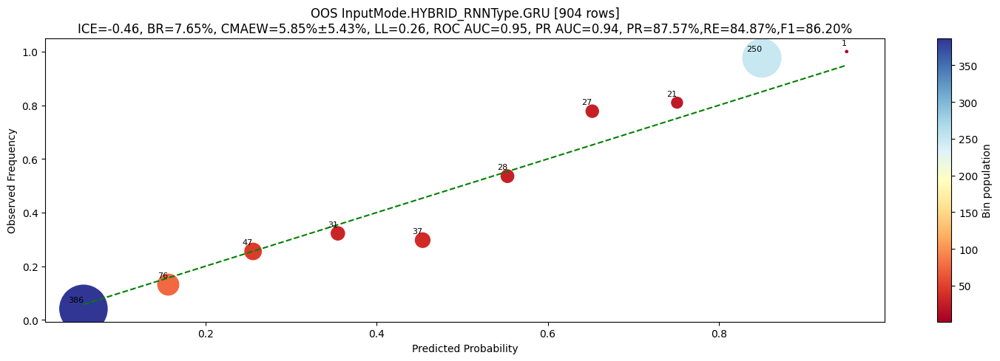

2026-01-02 17:17:06,976 - INFO - prepare_recurrent_training_data-line:283 - Prepared features: (8132, 97), labels: (8132,)


OOS InputMode.HYBRID_RNNType.GRU
              precision    recall  f1-score   support

           0       0.90      0.92      0.91       547
           1       0.88      0.85      0.86       357

    accuracy                           0.89       904
   macro avg       0.89      0.89      0.89       904
weighted avg       0.89      0.89      0.89       904

ROC AUCs: 1=0.95
PR AUCs: 1=0.94
CALIBRATIONs: 
	1: MAEW=5.85%, STD=5.43%, COV=90%
BRIER LOSSes: 
	1=7.65%
LOG_LOSSes: 
	1=0.26
ICEs: 
	1=-0.46
TOTAL INTEGRAL ERROR: 0.0000


2026-01-02 17:17:11,808 - INFO - prepare_recurrent_training_data-line:307 - Extracted 8132 sequences
2026-01-02 17:17:11,836 - INFO - seed_everything-line:54 - Seed set to 42
2026-01-02 17:17:14,249 - INFO - _info-line:64 - Using 16bit Automatic Mixed Precision (AMP)
2026-01-02 17:17:14,642 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2026-01-02 17:17:14,646 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2026-01-02 17:17:14,650 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\callbacks\model_checkpoint.py:652: Checkpoint directory S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\checkpoints exists and is not empty.
2026-01-02 17:17:14,667 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2026-01-02 17:17:14,742 - INFO - _info-line:64 - Loading `train_dataloader` to estimate number of stepping batches.
R:\ProgramData\anaconda3\Lib\sit

Sanity Checking: |                                                                               | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
R:\ProgramData\anaconda3\Lib\site-packages\torchmetrics\utilities\data.py:219: UserWarning:

cumsum_cuda_kernel does not have a deterministic implementation, but you set 'torch.use_deterministic_algorithms(True, warn_only=True)'. You can file an issue at https://github.com/pytorch/pytorch/issues to help us prioritize adding deterministic support for this operation. (Triggered internally at ..\aten\src\ATen\Context.cpp:87.)



Training: |                                                                                      | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-02 18:18:40,887 - INFO - _info-line:64 - Using 16bit Automatic Mixed Precision (AMP)
2026-01-02 18:18:41,422 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2026-01-02 18:18:41,426 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2026-01-02 18:18:41,430 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
2026-01-02 18:18:41,436 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'predict_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.


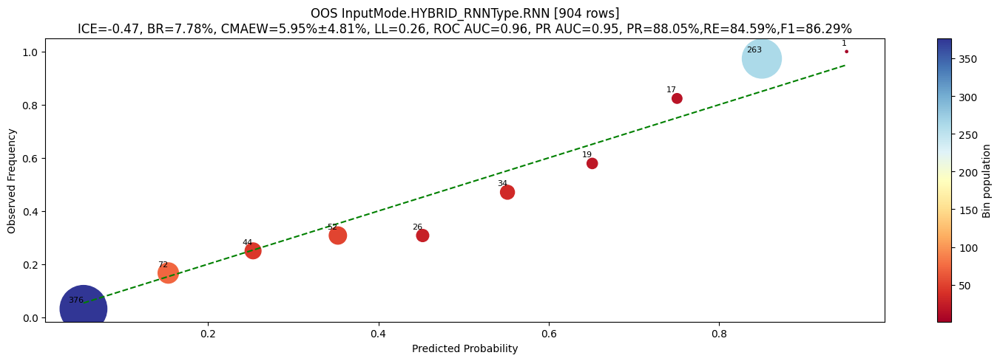

2026-01-02 18:18:43,810 - INFO - prepare_recurrent_training_data-line:283 - Prepared features: (8132, 97), labels: (8132,)


OOS InputMode.HYBRID_RNNType.RNN
              precision    recall  f1-score   support

           0       0.90      0.93      0.91       547
           1       0.88      0.85      0.86       357

    accuracy                           0.89       904
   macro avg       0.89      0.89      0.89       904
weighted avg       0.89      0.89      0.89       904

ROC AUCs: 1=0.96
PR AUCs: 1=0.95
CALIBRATIONs: 
	1: MAEW=5.95%, STD=4.81%, COV=90%
BRIER LOSSes: 
	1=7.78%
LOG_LOSSes: 
	1=0.26
ICEs: 
	1=-0.47
TOTAL INTEGRAL ERROR: 0.0000


2026-01-02 18:18:48,805 - INFO - prepare_recurrent_training_data-line:307 - Extracted 8132 sequences
2026-01-02 18:18:48,840 - INFO - seed_everything-line:54 - Seed set to 42
2026-01-02 18:18:51,885 - INFO - _info-line:64 - Using 16bit Automatic Mixed Precision (AMP)
2026-01-02 18:18:52,401 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2026-01-02 18:18:52,406 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2026-01-02 18:18:52,409 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\callbacks\model_checkpoint.py:652: Checkpoint directory S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\checkpoints exists and is not empty.
2026-01-02 18:18:52,424 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2026-01-02 18:18:52,543 - INFO - _info-line:64 - Loading `train_dataloader` to estimate number of stepping batches.
R:\ProgramData\anaconda3\Lib\sit

Sanity Checking: |                                                                               | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
R:\ProgramData\anaconda3\Lib\site-packages\torch\nn\functional.py:5504: UserWarning:

1Torch was not compiled with flash attention. (Triggered internally at ..\aten\src\ATen\native\transformers\cuda\sdp_utils.cpp:455.)

R:\ProgramData\anaconda3\Lib\site-packages\torchmetrics\utilities\data.py:219: UserWarning:

cumsum_cuda_kernel does not have a deterministic implementation, but you set 'torch.use_deterministic_algorithms(True, warn_only=True)'. You can file an issue at https://github.com/pytorch/pytorch/issues to help us prioritize adding deterministic support for this operation. (Triggered internally at ..\aten\src\ATen\Context.cpp:87.)



Training: |                                                                                      | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\torch\autograd\graph.py:744: UserWarning:

Memory Efficient attention defaults to a non-deterministic algorithm. To explicitly enable determinism call torch.use_deterministic_algorithms(True, warn_only=False). (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\builder\windows\pytorch\aten\src\ATen\native\transformers\cuda\attention_backward.cu:470.)



Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-02 18:30:52,465 - INFO - _info-line:64 - Using 16bit Automatic Mixed Precision (AMP)
2026-01-02 18:30:52,973 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2026-01-02 18:30:52,981 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2026-01-02 18:30:52,984 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
2026-01-02 18:30:52,992 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'predict_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.


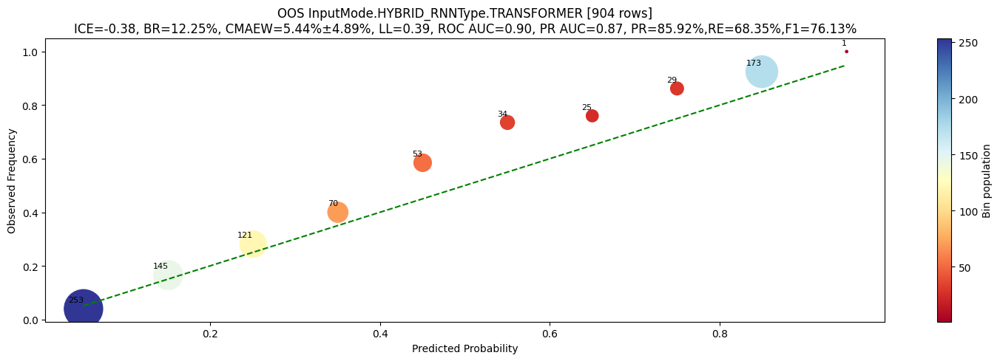

OOS InputMode.HYBRID_RNNType.TRANSFORMER
              precision    recall  f1-score   support

           0       0.82      0.93      0.87       547
           1       0.86      0.68      0.76       357

    accuracy                           0.83       904
   macro avg       0.84      0.81      0.82       904
weighted avg       0.83      0.83      0.83       904

ROC AUCs: 1=0.90
PR AUCs: 1=0.87
CALIBRATIONs: 
	1: MAEW=5.44%, STD=4.89%, COV=90%
BRIER LOSSes: 
	1=12.25%
LOG_LOSSes: 
	1=0.39
ICEs: 
	1=-0.38
TOTAL INTEGRAL ERROR: 0.0000
time: 3h 15min 21s (started: 2026-01-02 15:15:32 +03:00)


In [32]:
eval_models(
    models, metrics, training_times, predicting_times, input_modes=[InputMode.HYBRID]
)

In [112]:
print(models, metrics, training_times, predicting_times)

{'InputMode.SEQUENCE_ONLY_RNNType.LSTM': <recurrent_classifier.RecurrentClassifierWrapper object at 0x000001C42DACA4D0>, 'InputMode.SEQUENCE_ONLY_RNNType.GRU': <recurrent_classifier.RecurrentClassifierWrapper object at 0x000001C434A03710>, 'InputMode.SEQUENCE_ONLY_RNNType.RNN': <recurrent_classifier.RecurrentClassifierWrapper object at 0x000001C4346DFF50>, 'InputMode.SEQUENCE_ONLY_RNNType.TRANSFORMER': <recurrent_classifier.RecurrentClassifierWrapper object at 0x00000197CFB1D190>, 'InputMode.FEATURES_ONLY_RNNType.LSTM': <recurrent_classifier.RecurrentClassifierWrapper object at 0x000001C443468FD0>, 'InputMode.FEATURES_ONLY_RNNType.GRU': <recurrent_classifier.RecurrentClassifierWrapper object at 0x000001C43EC25E90>, 'InputMode.FEATURES_ONLY_RNNType.RNN': <recurrent_classifier.RecurrentClassifierWrapper object at 0x000001C43EDF1AD0>, 'InputMode.FEATURES_ONLY_RNNType.TRANSFORMER': <recurrent_classifier.RecurrentClassifierWrapper object at 0x0000018E60CD9B50>} {'InputMode.SEQUENCE_ONLY_RNN

In [ ]:
target_name = "lumcurves"

ft_extractor = SimpleFeaturesAndTargetsExtractor(
    classification_targets=["class"],
    columns_to_drop=set(["id", "ts", "source", "dataset", "_orig_idx"]),
    verbose=1,
)

mlframe_models, metadata = train_mlframe_models_suite(
    df=labeled_df_train.to_pandas(),
    target_name=target_name,
    model_name=f"flares",
    features_and_targets_extractor=ft_extractor,
    mlframe_models="cb xgb lgb ngb hgb linear mlp".split(),
    init_common_params={"show_perf_chart": True, "show_fi": True},
    use_ordinary_models=True,
    pipeline_config=PolarsPipelineConfig(use_polarsds_pipeline=False),
    split_config=TrainingSplitConfig(
        shuffle_val=True, shuffle_test=True, test_size=0.0, val_size=0.1
    ),
    config_params_override={
        "iterations": 5000,
        "early_stopping_rounds": 500,
    },
    use_mlframe_ensembles=True,
    data_dir="data",
    # models_dir=None,
    verbose=True,
)

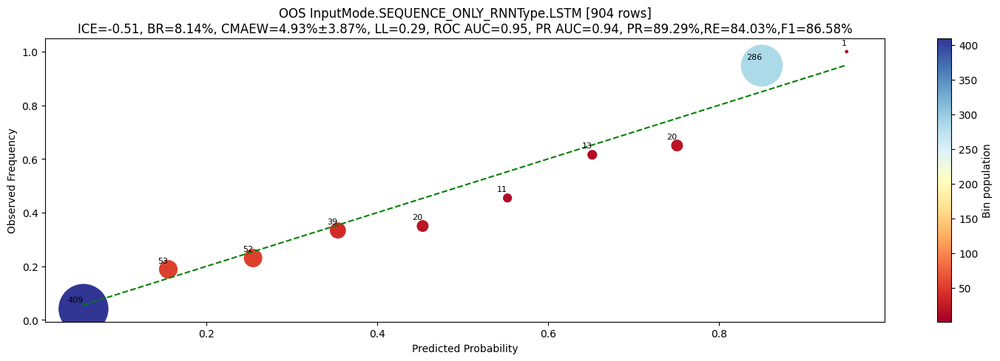

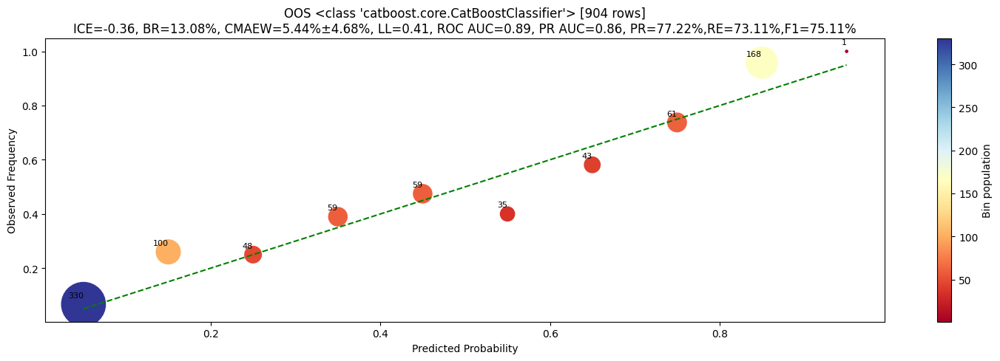

OOS <class 'catboost.core.CatBoostClassifier'>
              precision    recall  f1-score   support

           0       0.83      0.86      0.84       547
           1       0.77      0.73      0.75       357

    accuracy                           0.81       904
   macro avg       0.80      0.80      0.80       904
weighted avg       0.81      0.81      0.81       904

ROC AUCs: 1=0.89
PR AUCs: 1=0.86
CALIBRATIONs: 
	1: MAEW=5.44%, STD=4.68%, COV=100%
BRIER LOSSes: 
	1=13.08%
LOG_LOSSes: 
	1=0.41
ICEs: 
	1=-0.36
TOTAL INTEGRAL ERROR: 0.0000


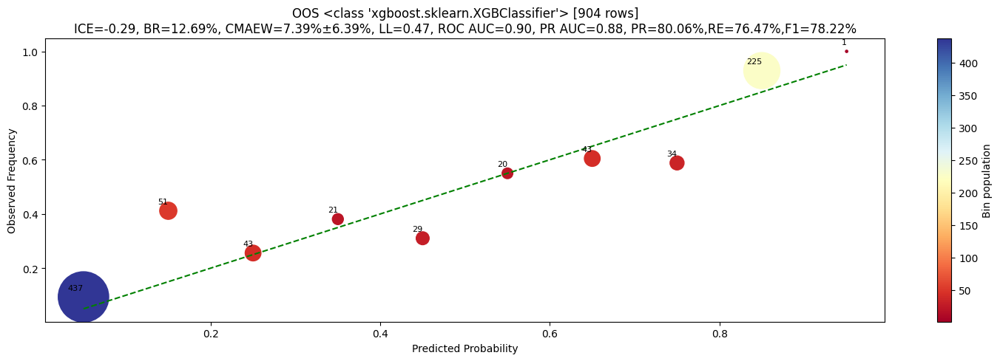

OOS <class 'xgboost.sklearn.XGBClassifier'>
              precision    recall  f1-score   support

           0       0.85      0.88      0.86       547
           1       0.80      0.76      0.78       357

    accuracy                           0.83       904
   macro avg       0.83      0.82      0.82       904
weighted avg       0.83      0.83      0.83       904

ROC AUCs: 1=0.90
PR AUCs: 1=0.88
CALIBRATIONs: 
	1: MAEW=7.39%, STD=6.39%, COV=100%
BRIER LOSSes: 
	1=12.69%
LOG_LOSSes: 
	1=0.47
ICEs: 
	1=-0.29
TOTAL INTEGRAL ERROR: 0.0000


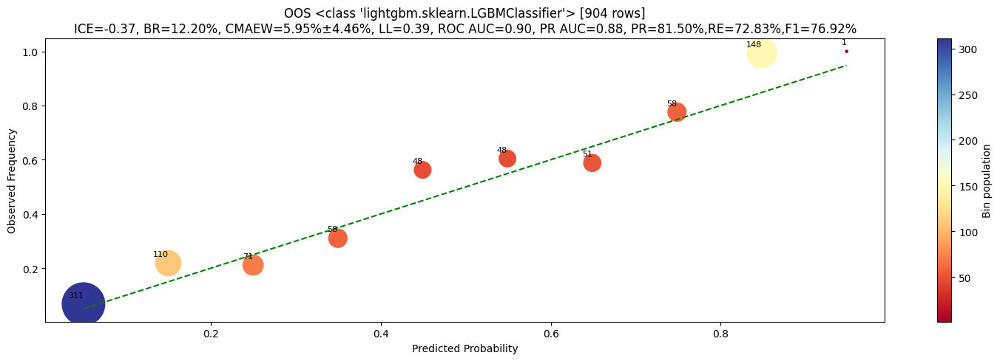

OOS <class 'lightgbm.sklearn.LGBMClassifier'>
              precision    recall  f1-score   support

           0       0.83      0.89      0.86       547
           1       0.82      0.73      0.77       357

    accuracy                           0.83       904
   macro avg       0.82      0.81      0.82       904
weighted avg       0.83      0.83      0.83       904

ROC AUCs: 1=0.90
PR AUCs: 1=0.88
CALIBRATIONs: 
	1: MAEW=5.95%, STD=4.46%, COV=100%
BRIER LOSSes: 
	1=12.20%
LOG_LOSSes: 
	1=0.39
ICEs: 
	1=-0.37
TOTAL INTEGRAL ERROR: 0.0000


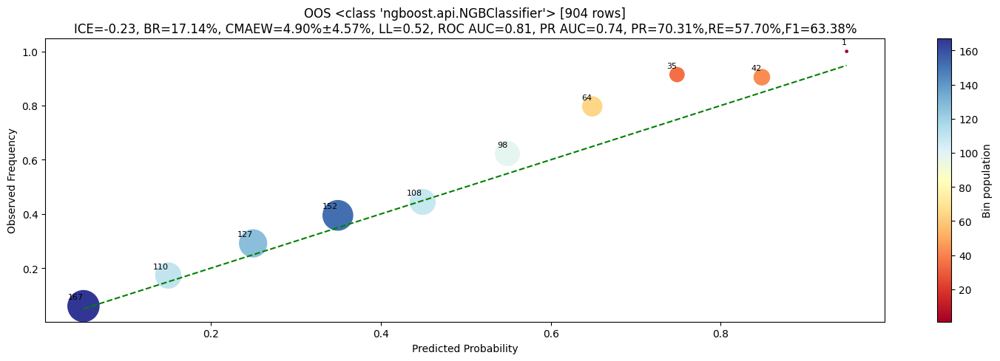

OOS <class 'ngboost.api.NGBClassifier'>
              precision    recall  f1-score   support

           0       0.75      0.84      0.79       547
           1       0.70      0.58      0.63       357

    accuracy                           0.74       904
   macro avg       0.73      0.71      0.71       904
weighted avg       0.73      0.74      0.73       904

ROC AUCs: 1=0.81
PR AUCs: 1=0.74
CALIBRATIONs: 
	1: MAEW=4.90%, STD=4.57%, COV=100%
BRIER LOSSes: 
	1=17.14%
LOG_LOSSes: 
	1=0.52
ICEs: 
	1=-0.23
TOTAL INTEGRAL ERROR: 0.0000


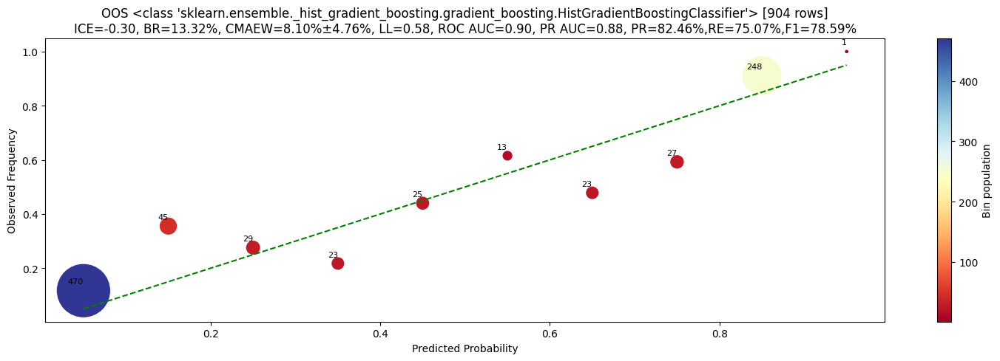

OOS <class 'sklearn.ensemble._hist_gradient_boosting.gradient_boosting.HistGradientBoostingClassifier'>
              precision    recall  f1-score   support

           0       0.85      0.90      0.87       547
           1       0.82      0.75      0.79       357

    accuracy                           0.84       904
   macro avg       0.84      0.82      0.83       904
weighted avg       0.84      0.84      0.84       904

ROC AUCs: 1=0.90
PR AUCs: 1=0.88
CALIBRATIONs: 
	1: MAEW=8.10%, STD=4.76%, COV=100%
BRIER LOSSes: 
	1=13.32%
LOG_LOSSes: 
	1=0.58
ICEs: 
	1=-0.30
TOTAL INTEGRAL ERROR: 0.0000


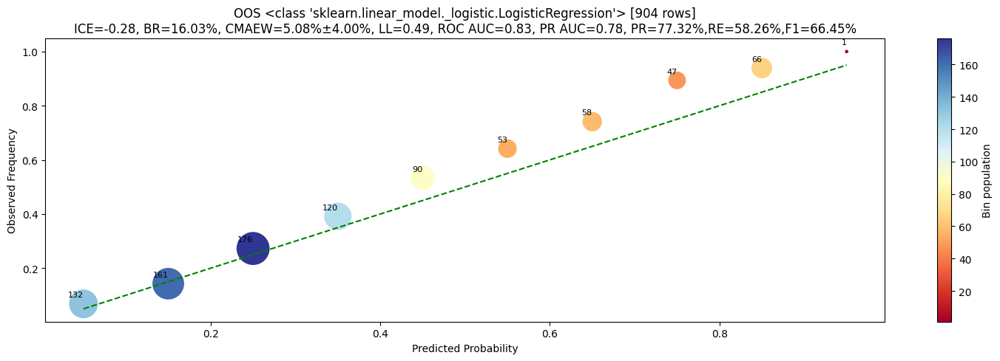

2026-01-03 08:42:22,068 - WARNING - _predict_raw-line:419 - No datamodule found from training. Creating temporary datamodule for prediction.
2026-01-03 08:42:22,070 - INFO - _predict_raw-line:424 - Using batch_size=64 for prediction


OOS <class 'sklearn.linear_model._logistic.LogisticRegression'>
              precision    recall  f1-score   support

           0       0.77      0.89      0.82       547
           1       0.77      0.58      0.66       357

    accuracy                           0.77       904
   macro avg       0.77      0.74      0.74       904
weighted avg       0.77      0.77      0.76       904

ROC AUCs: 1=0.83
PR AUCs: 1=0.78
CALIBRATIONs: 
	1: MAEW=5.08%, STD=4.00%, COV=100%
BRIER LOSSes: 
	1=16.03%
LOG_LOSSes: 
	1=0.49
ICEs: 
	1=-0.28
TOTAL INTEGRAL ERROR: 0.0000


2026-01-03 08:42:22,523 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2026-01-03 08:42:22,531 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2026-01-03 08:42:22,531 - INFO - _info-line:64 - IPU available: False, using: 0 IPUs
2026-01-03 08:42:22,540 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2026-01-03 08:42:22,547 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
R:\ProgramData\anaconda3\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:441: The 'predict_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
2026-01-03 08:42:22,733 - INFO - _predict_raw-line:506 - Generated predictions with shape (904, 2)


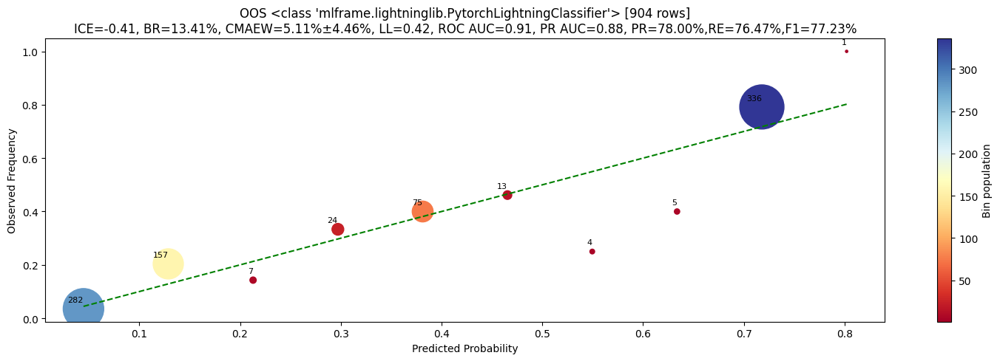

OOS <class 'mlframe.lightninglib.PytorchLightningClassifier'>
              precision    recall  f1-score   support

           0       0.85      0.86      0.85       547
           1       0.78      0.76      0.77       357

    accuracy                           0.82       904
   macro avg       0.81      0.81      0.81       904
weighted avg       0.82      0.82      0.82       904

ROC AUCs: 1=0.91
PR AUCs: 1=0.88
CALIBRATIONs: 
	1: MAEW=5.11%, STD=4.46%, COV=90%
BRIER LOSSes: 
	1=13.41%
LOG_LOSSes: 
	1=0.42
ICEs: 
	1=-0.41
TOTAL INTEGRAL ERROR: 0.0000
time: 7.45 s (started: 2026-01-03 08:42:16 +03:00)


In [37]:
temp_df = labeled_df_test.select(mlframe_model.columns).to_pandas()
for mlframe_model in mlframe_models["class"]["binary_classification"]:
    model = mlframe_model.model
    key = f"{type(model)}"

    models[key] = model
    if mlframe_model.pre_pipeline:
        tmp = mlframe_model.pre_pipeline.transform(temp_df)
    else:
        tmp = temp_df

    probs = model.predict_proba(tmp)

    metrics[key] = {}

    _, _ = report_model_perf(
        targets=targets,
        columns=None,
        df=None,
        model_name=key,
        model=None,
        target_label_encoder=None,
        preds=None,
        probs=probs,
        plot_file=join(charts_dir, key) if charts_dir else None,
        metrics=metrics[key],
        group_ids=None,
        **report_params,
    )

2026-01-14 23:17:19,480 - INFO - log_phase-line:44 - ----------------------------------------------------------------------------------------------------------------------------------------------------------------
2026-01-14 23:17:19,483 - INFO - log_phase-line:45 - Starting mlframe training suite: flares
2026-01-14 23:17:19,487 - INFO - log_phase-line:46 - ----------------------------------------------------------------------------------------------------------------------------------------------------------------
2026-01-14 23:17:19,491 - INFO - log_phase-line:44 - ----------------------------------------------------------------------------------------------------------------------------------------------------------------
2026-01-14 23:17:19,493 - INFO - log_phase-line:45 - PHASE 1: Data Loading & Preprocessing
2026-01-14 23:17:19,495 - INFO - log_phase-line:46 - -------------------------------------------------------------------------------------------------------------------------

Raw data:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8132 entries, 0 to 8131
Columns: 481 entries, _orig_idx to _start_idx
dtypes: bool(1), datetime64[us, UTC](1), float32(390), float64(5), int32(29), object(1), uint32(54)
memory usage: 15.1+ MB

Processed data:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8132 entries, 0 to 8131
Columns: 481 entries, _orig_idx to _start_idx
dtypes: bool(1), datetime64[us, UTC](1), float32(390), float64(5), int32(29), object(1), uint32(54)
memory usage: 15.1+ MB



,_orig_idx,class,had_od,npoints,mag_arg_min,mag_arg_max,mag_n_unique,mag_trend_changes,magerr_arg_min,magerr_arg_max,magerr_n_unique,magerr_trend_changes,norm_arg_min,norm_arg_max,norm_n_unique,norm_trend_changes,mjd_diff_arg_min,mjd_diff_arg_max,mjd_diff_n_unique,mjd_diff_trend_changes,ts,mag_n_below_3sigma,mag_max_consecutive_below_2sigma,mag_n_local_minima,mag_n_zero_crossings,mag_max_consecutive_above_1sigma,mag_longest_monotonic_increase,mag_longest_monotonic_decrease,mag_n_isolated_below_2sigma,mag_n_local_maxima,mag_n_runs_below_2sigma,mag_n_runs_above_1sigma,norm_n_below_3sigma,norm_max_consecutive_below_2sigma,norm_n_local_minima,norm_n_zero_crossings,norm_max_consecutive_above_1sigma,norm_longest_monotonic_increase,norm_longest_monotonic_decrease,norm_n_isolated_below_2sigma,norm_n_local_maxima,norm_n_runs_below_2sigma,norm_n_runs_above_1sigma,vel_n_below_3sigma,vel_max_consecutive_below_2sigma,vel_n_local_minima,vel_n_zero_crossings,vel_max_consecutive_above_1sigma,vel_longest_monotonic_increase,vel_longest_monotonic_decrease,vel_n_isolated_below_2sigma,vel_n_local_maxima,vel_n_runs_below_2sigma,vel_n_runs_above_1sigma,mag_to_argmin_len,mag_to_argmin_n_above_2sigma,mag_to_argmin_n_below_2sigma,mag_to_argmin_n_above_3sigma,mag_to_argmin_n_below_3sigma,mag_from_argmin_len,mag_from_argmin_n_above_2sigma,mag_from_argmin_n_below_2sigma,mag_from_argmin_n_above_3sigma,mag_from_argmin_n_below_3sigma,norm_to_argmin_len,norm_to_argmin_n_above_2sigma,norm_to_argmin_n_below_2sigma,norm_to_argmin_n_above_3sigma,norm_to_argmin_n_below_3sigma,norm_from_argmin_len,norm_from_argmin_n_above_2sigma,norm_from_argmin_n_below_2sigma,norm_from_argmin_n_above_3sigma,norm_from_argmin_n_below_3sigma,velocity_to_argmin_len,velocity_to_argmin_n_above_2sigma,velocity_to_argmin_n_below_2sigma,velocity_to_argmin_n_above_3sigma,velocity_to_argmin_n_below_3sigma,velocity_from_argmin_len,velocity_from_argmin_n_above_2sigma,velocity_from_argmin_n_below_2sigma,velocity_from_argmin_n_above_3sigma,velocity_from_argmin_n_below_3sigma,norm_frac_below_3sigma,norm_max_consecutive_frac_below_2sigma,norm_frac_local_minima,norm_frac_zero_crossings,source,_dataset,_start_idx
0,68438092,1,False,14,4,10,14,4,4,10,14,4,4,10,14,4,1,2,3,9,2020-06-04 00:00:00+00:00,0,0,2,0,14,6,3,0,2,0,1,4,4,2,2,3,6,3,0,2,1,3,4,3,3,4,6,2,4,1,2,2,3,4,0,0,0,0,10,0,1,0,0,4,0,0,0,0,10,0,1,0,0,4,0,0,0,0,10,0,0,0,0,0.285714,0.285714,0.142857,0.142857,unlabeled_pos,0,68400000.000000
1,85467169,1,False,93,41,12,93,50,41,12,93,50,41,12,93,50,0,1,2,74,2018-12-09 00:00:00+00:00,0,0,25,0,93,9,5,0,25,0,1,21,20,25,13,8,9,5,0,25,2,8,42,5,30,50,9,4,4,14,29,25,26,41,0,1,0,1,52,0,3,0,1,41,0,1,0,1,52,0,3,0,1,41,0,2,0,1,52,0,1,0,1,0.225806,0.215054,0.268817,0.139785,unlabeled_pos,0,85450000.000000
2,31958826,0,False,146,81,9,145,91,81,9,145,91,81,9,145,91,0,80,4,103,2018-12-04 00:00:00+00:00,0,0,46,0,146,6,6,0,45,0,1,17,10,46,44,3,6,6,3,45,6,17,64,6,52,91,6,4,5,32,52,45,47,81,0,6,0,1,65,0,3,0,3,81,0,6,0,1,65,0,3,0,3,81,2,2,1,1,65,3,1,0,0,0.116438,0.068493,0.315068,0.301370,unlabeled_neg,0,31950000.000000
3,555756,0,False,137,35,4,137,86,35,4,137,86,35,4,137,86,0,2,2,54,2019-01-10 00:00:00+00:00,0,0,43,0,137,4,4,0,43,0,1,29,29,43,23,16,4,4,3,43,5,8,64,4,51,86,4,4,3,26,50,43,44,35,0,0,0,0,102,0,5,0,0,35,0,0,0,0,102,0,5,0,0,35,1,1,0,1,102,5,2,0,1,0.211679,0.211679,0.313869,0.167883,unlabeled_neg,0,550000.000000
4,18408949,0,False,116,29,100,116,71,29,100,116,71,29,100,116,71,0,3,2,45,2018-07-14 00:00:00+00:00,0,0,35,0,116,4,5,0,36,0,1,21,18,35,32,6,4,5,2,36,5,18,58,5,39,71,4,3,3,22,40,36,36,29,0,1,0,1,87,0,6,0,3,29,0,1,0,1,87,0,6,0,3,29,0,2,0,1,87,2,1,1,1,0.181034,0.155172,0.301724,0.275862,unlabeled_neg,0,18400000.000000


'binary_classification class'

,proportion
i8,f64
0,0.608952
1,0.391048


,_orig_idx,class,had_od,npoints,mag_mean,mag_std,mag_min,mag_max,mag_median,mag_q25,...,norm_wv_sym4_d5_rel_energy,norm_wv_sym4_d5_mean,norm_wv_sym4_d5_std,norm_wv_sym4_d5_skewness,norm_wv_sym4_d5_kurtosis,norm_wv_sym4_d5_mad,norm_wv_sym4_d5_frac_above_2std,source,_dataset,_start_idx
0,68438092,1,False,14,19.382620,1.247290,15.603927,20.140318,19.870747,19.505224,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,unlabeled_pos,0,68400000.0
1,85467169,1,False,93,20.003412,0.605923,17.522943,20.709644,20.165825,19.804024,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,unlabeled_pos,0,85450000.0
2,31958826,0,False,146,17.144100,0.043997,16.940228,17.196243,17.157063,17.134705,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,unlabeled_neg,0,31950000.0
3,555756,0,False,137,19.258017,0.377196,18.520161,20.283604,19.265240,19.071157,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,unlabeled_neg,0,550000.0
4,18408949,0,False,116,17.913944,0.156240,17.367428,18.118834,17.960985,17.893955,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,unlabeled_neg,0,18400000.0


,_orig_idx,class,had_od,npoints,mag_mean,mag_std,mag_min,mag_max,mag_median,mag_q25,...,norm_wv_sym4_d5_rel_energy,norm_wv_sym4_d5_mean,norm_wv_sym4_d5_std,norm_wv_sym4_d5_skewness,norm_wv_sym4_d5_kurtosis,norm_wv_sym4_d5_mad,norm_wv_sym4_d5_frac_above_2std,source,_dataset,_start_idx
8127,31917110,0,False,253,17.867325,0.088471,17.424870,17.989788,17.893425,17.850414,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,unlabeled_neg,0,31900000.0
8128,23741056,0,False,113,20.111532,0.480988,18.872105,20.769564,20.282406,19.910677,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,unlabeled_neg,0,23700000.0
8129,26645396,0,False,116,20.061602,0.494982,18.537119,20.656548,20.200148,20.100838,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,unlabeled_neg,0,26600000.0
8130,31847821,1,False,246,18.712730,0.083595,18.214706,18.823025,18.727682,18.702015,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,unlabeled_pos,0,31800000.0
8131,61411383,0,False,113,19.524651,0.130070,18.943758,19.770168,19.545801,19.487286,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,unlabeled_neg,0,61400000.0


2026-01-14 23:17:19,880 - INFO - log_ram_usage-line:39 - Done. RAM usage: 0.3GB.
2026-01-14 23:17:22,995 - INFO - log_ram_usage-line:39 - Done. RAM usage: 0.0GB.
2026-01-14 23:17:23,001 - INFO - drop_columns_from_dataframe-line:83 - Dropping 7 column(s): source,dataset,_start_idx,class,ts,_orig_idx,id...
2026-01-14 23:17:25,348 - INFO - log_ram_usage-line:39 - Done. RAM usage: 0.0GB.
2026-01-14 23:17:38,000 - INFO - remove_constant_columns-line:439 - Removing 100 constant columns: ['norm_median', 'mag_n_below_3sigma', 'mag_max_consecutive_below_2sigma', 'mag_n_zero_crossings', 'mag_n_isolated_below_2sigma', 'mag_frac_below_2sigma', 'mag_frac_below_1sigma', 'mag_n_runs_below_2sigma', 'mag_mean_run_below_2sigma', 'mag_n_runs_above_1sigma', 'norm_wv_haar_d1_kurtosis', 'norm_wv_db4_d4_energy', 'norm_wv_db4_d4_rel_energy', 'norm_wv_db4_d4_mean', 'norm_wv_db4_d4_std', 'norm_wv_db4_d4_skewness', 'norm_wv_db4_d4_kurtosis', 'norm_wv_db4_d4_mad', 'norm_wv_db4_d4_frac_above_2std', 'norm_wv_db4_d5

target type:   0%|          | 0/1 [00:00<?, ?it/s]

target:   0%|          | 0/1 [00:00<?, ?it/s]

2026-01-14 23:17:42,777 - INFO - train_mlframe_models_suite-line:1107 - select_target...
2026-01-14 23:17:43,376 - INFO - configure_training_params-line:1761 - data_fits_gpu_ram=True, data_fits_cb_gpu_ram=True, cb_devices=None
2026-01-14 23:17:43,384 - INFO - log_ram_usage-line:39 - Done. RAM usage: 0.0GB.


pre_pipeline:   0%|          | 0/1 [00:00<?, ?it/s]

2026-01-14 23:17:43,417 - INFO - train_mlframe_models_suite-line:1182 - No weighting schemas from extractor, defaulting to uniform weighting.


mlframe model:   0%|          | 0/6 [00:00<?, ?it/s]

weighting schema:   0%|          | 0/1 [00:00<?, ?it/s]

2026-01-14 23:17:43,479 - INFO - process_model-line:453 - Starting train_and_evaluate CatBoostClassifier on binary_classification lumcurves ext flares class BT=39%, RAM usage 0.0GBs...


inf checking:   0%|          | 0/375 [00:00<?, ?it/s]

2026-01-14 23:17:48,314 - INFO - train_and_evaluate_model-line:1311 - training dataset shape: (7318, 376)
2026-01-14 23:17:50,461 - INFO - train_and_evaluate_model-line:1327 - Training the model...
R:\ProgramData\anaconda3\Lib\site-packages\catboost\core.py:2321: UserWarning:

Can't optimze method "evaluate" because self argument is used



MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Default metric period is 5 because PythonUserDefinedPerObject is/are not implemented for GPU
2026-01-14 23:19:22,290 - INFO - _train_model_with_fallback-line:693 - es_best_iter: 281
2026-01-14 23:19:22,298 - INFO - train_and_evaluate_model-line:1377 - Computing model's performance...


es_best_iter: 281


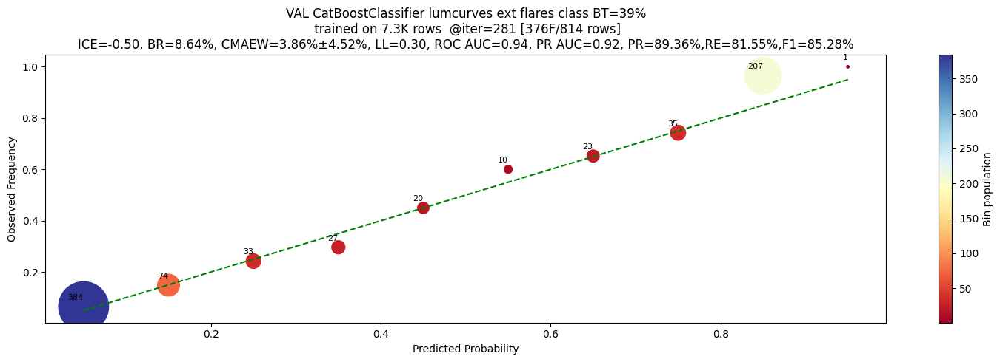

VAL CatBoostClassifier lumcurves ext flares class BT=39%
 trained on 7.3K rows  @iter=281
              precision    recall  f1-score   support

           0     0.8929    0.9406    0.9161       505
           1     0.8936    0.8155    0.8528       309

    accuracy                         0.8931       814
   macro avg     0.8932    0.8781    0.8844       814
weighted avg     0.8931    0.8931    0.8921       814

ROC AUCs: 1=0.9352
PR AUCs: 1=0.9244
CALIBRATIONs: 
	1: MAEW=3.86%, STD=4.52%, COV=90%
BRIER LOSSes: 
	1=8.6395%
LOG_LOSSes: 
	1=0.3026
ICEs: 
	1=-0.5046
TOTAL INTEGRAL ERROR: -0.5046


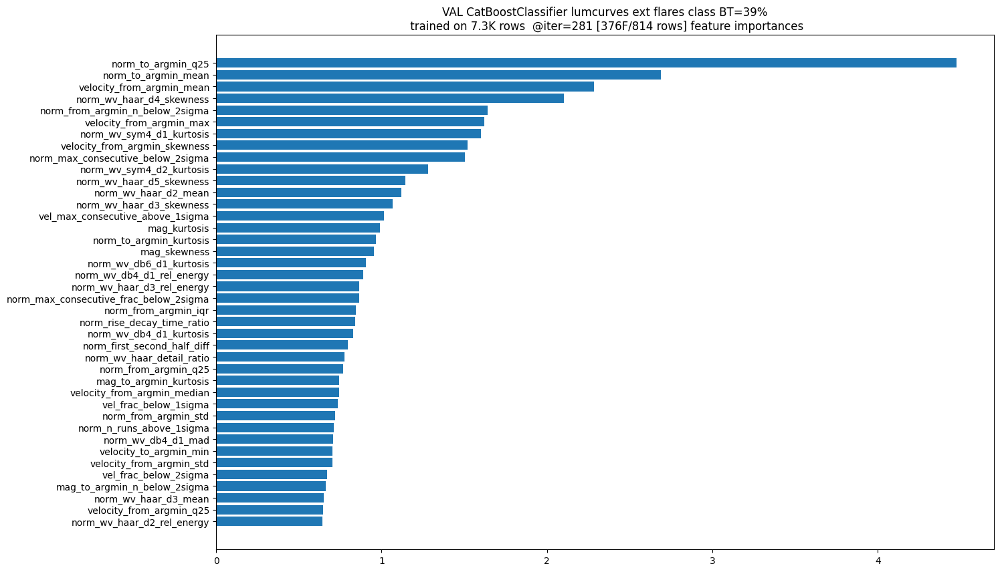

2026-01-14 23:19:28,446 - INFO - process_model-line:478 - Finished training, took 1.7 min. RAM usage 0.0GBs...
2026-01-14 23:19:28,545 - INFO - save_mlframe_model-line:55 - Model saved successfully to data\models\lumcurves-ext\flares\binary_classification\class\cb.dump. Size: 0.15 Mb


weighting schema:   0%|          | 0/1 [00:00<?, ?it/s]

2026-01-14 23:19:30,894 - INFO - process_model-line:453 - Starting train_and_evaluate XGBClassifier on binary_classification lumcurves ext flares class BT=39%, RAM usage 0.0GBs...


inf checking:   0%|          | 0/375 [00:00<?, ?it/s]

2026-01-14 23:19:35,933 - INFO - train_and_evaluate_model-line:1311 - training dataset shape: (7318, 376)
2026-01-14 23:19:38,172 - INFO - train_and_evaluate_model-line:1327 - Training the model...
2026-01-14 23:19:55,941 - INFO - _train_model_with_fallback-line:693 - es_best_iter: 41
2026-01-14 23:19:55,948 - INFO - train_and_evaluate_model-line:1377 - Computing model's performance...


es_best_iter: 41


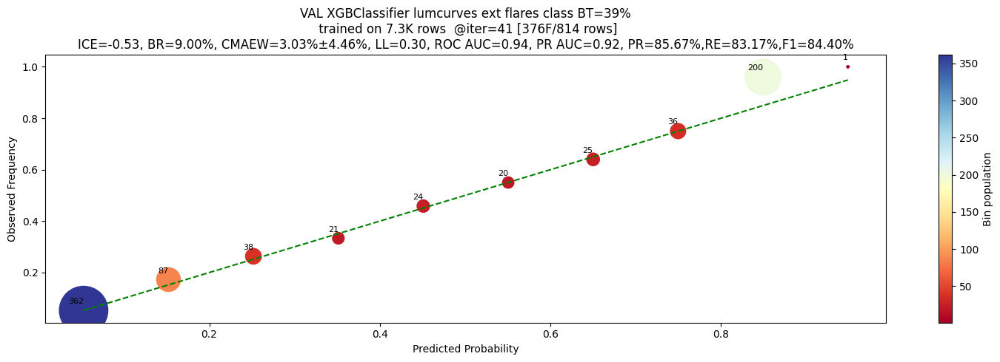

VAL XGBClassifier lumcurves ext flares class BT=39%
 trained on 7.3K rows  @iter=41
              precision    recall  f1-score   support

           0     0.8988    0.9149    0.9068       505
           1     0.8567    0.8317    0.8440       309

    accuracy                         0.8833       814
   macro avg     0.8777    0.8733    0.8754       814
weighted avg     0.8828    0.8833    0.8829       814

ROC AUCs: 1=0.9358
PR AUCs: 1=0.9244
CALIBRATIONs: 
	1: MAEW=3.03%, STD=4.46%, COV=90%
BRIER LOSSes: 
	1=8.9967%
LOG_LOSSes: 
	1=0.2993
ICEs: 
	1=-0.5300
TOTAL INTEGRAL ERROR: -0.5300


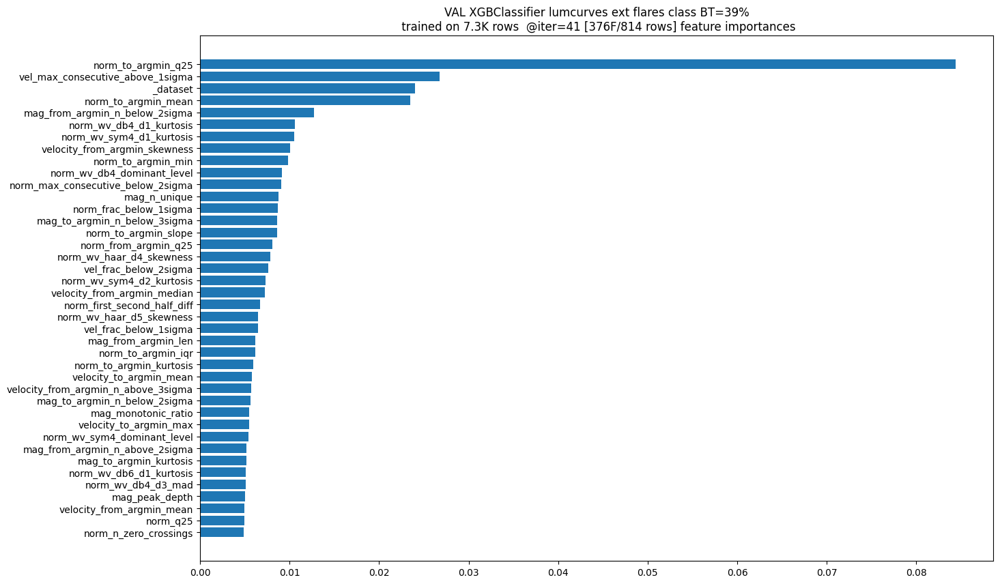

2026-01-14 23:20:00,380 - INFO - process_model-line:478 - Finished training, took 0.5 min. RAM usage 0.0GBs...
2026-01-14 23:20:00,483 - INFO - save_mlframe_model-line:55 - Model saved successfully to data\models\lumcurves-ext\flares\binary_classification\class\xgb.dump. Size: 0.37 Mb


weighting schema:   0%|          | 0/1 [00:00<?, ?it/s]

2026-01-14 23:20:03,378 - INFO - process_model-line:453 - Starting train_and_evaluate LGBMClassifier on binary_classification lumcurves ext flares class BT=39%, RAM usage 0.0GBs...


inf checking:   0%|          | 0/375 [00:00<?, ?it/s]

2026-01-14 23:20:07,682 - INFO - train_and_evaluate_model-line:1311 - training dataset shape: (7318, 376)
2026-01-14 23:20:10,208 - INFO - train_and_evaluate_model-line:1327 - Training the model...
2026-01-14 23:20:22,810 - INFO - _train_model_with_fallback-line:693 - es_best_iter: 74
2026-01-14 23:20:22,818 - INFO - train_and_evaluate_model-line:1377 - Computing model's performance...


es_best_iter: 74


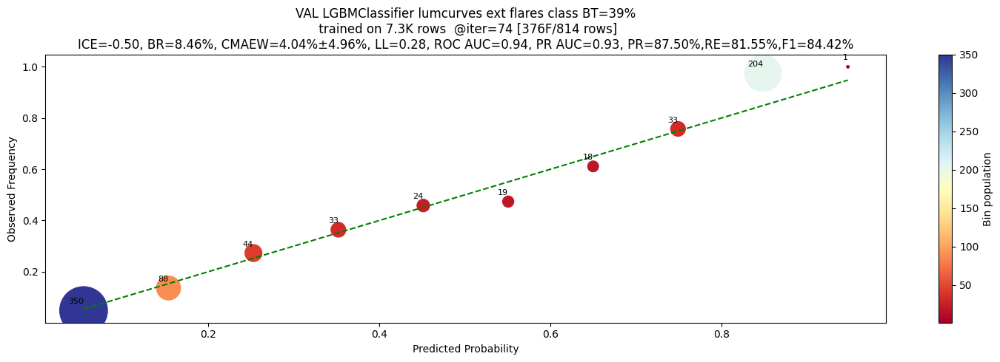

VAL LGBMClassifier lumcurves ext flares class BT=39%
 trained on 7.3K rows  @iter=74
              precision    recall  f1-score   support

           0     0.8916    0.9287    0.9098       505
           1     0.8750    0.8155    0.8442       309

    accuracy                         0.8857       814
   macro avg     0.8833    0.8721    0.8770       814
weighted avg     0.8853    0.8857    0.8849       814

ROC AUCs: 1=0.9408
PR AUCs: 1=0.9312
CALIBRATIONs: 
	1: MAEW=4.04%, STD=4.96%, COV=90%
BRIER LOSSes: 
	1=8.4594%
LOG_LOSSes: 
	1=0.2825
ICEs: 
	1=-0.5000
TOTAL INTEGRAL ERROR: -0.5000


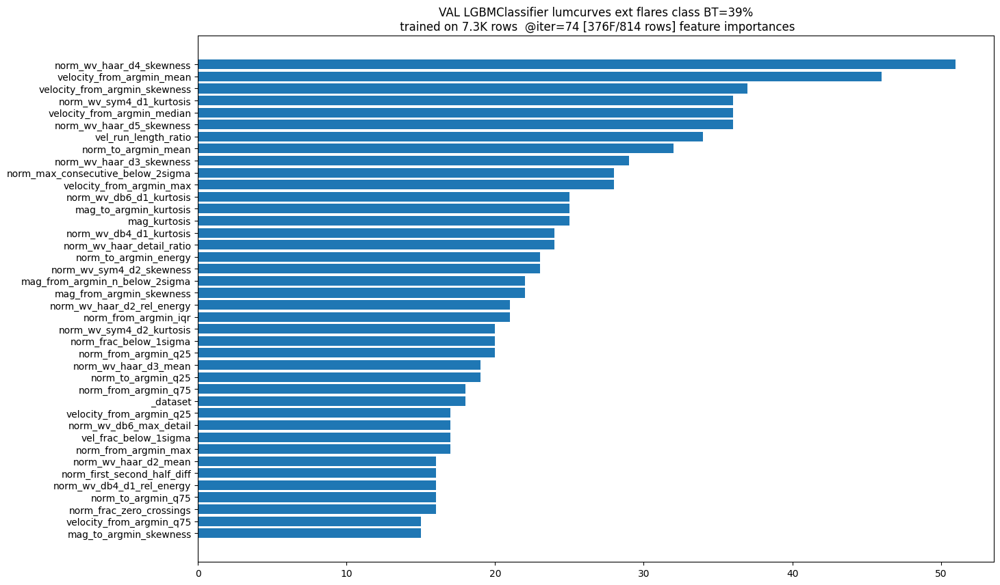

2026-01-14 23:20:27,366 - INFO - process_model-line:478 - Finished training, took 0.4 min. RAM usage 0.0GBs...
2026-01-14 23:20:27,496 - INFO - save_mlframe_model-line:55 - Model saved successfully to data\models\lumcurves-ext\flares\binary_classification\class\lgb.dump. Size: 0.15 Mb


weighting schema:   0%|          | 0/1 [00:00<?, ?it/s]

2026-01-14 23:20:29,671 - INFO - process_model-line:453 - Starting train_and_evaluate HistGradientBoostingClassifier on binary_classification lumcurves ext flares class BT=39%, RAM usage 0.0GBs...


inf checking:   0%|          | 0/375 [00:00<?, ?it/s]

2026-01-14 23:20:35,547 - INFO - train_and_evaluate_model-line:1311 - training dataset shape: (7318, 376)
2026-01-14 23:20:37,651 - INFO - train_and_evaluate_model-line:1327 - Training the model...
2026-01-14 23:21:05,022 - INFO - train_and_evaluate_model-line:1377 - Computing model's performance...


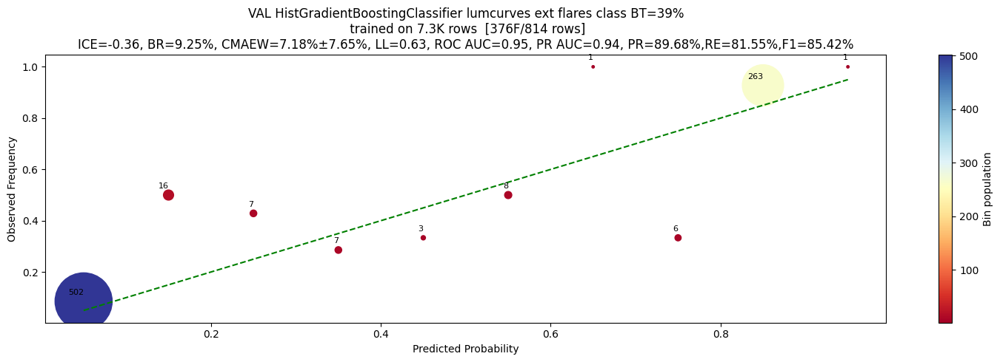

VAL HistGradientBoostingClassifier lumcurves ext flares class BT=39%
 trained on 7.3K rows 
              precision    recall  f1-score   support

           0     0.8931    0.9426    0.9171       505
           1     0.8968    0.8155    0.8542       309

    accuracy                         0.8943       814
   macro avg     0.8949    0.8791    0.8857       814
weighted avg     0.8945    0.8943    0.8933       814

ROC AUCs: 1=0.9470
PR AUCs: 1=0.9405
CALIBRATIONs: 
	1: MAEW=7.18%, STD=7.65%, COV=100%
BRIER LOSSes: 
	1=9.2507%
LOG_LOSSes: 
	1=0.6338
ICEs: 
	1=-0.3592
TOTAL INTEGRAL ERROR: -0.3592


2026-01-14 23:21:12,789 - INFO - process_model-line:478 - Finished training, took 0.7 min. RAM usage 0.0GBs...
2026-01-14 23:21:13,454 - INFO - save_mlframe_model-line:55 - Model saved successfully to data\models\lumcurves-ext\flares\binary_classification\class\hgb.dump. Size: 0.95 Mb


weighting schema:   0%|          | 0/1 [00:00<?, ?it/s]

2026-01-14 23:21:15,887 - INFO - process_model-line:453 - Starting train_and_evaluate LogisticRegression on binary_classification lumcurves ext flares class BT=39%, RAM usage 0.0GBs...


inf checking:   0%|          | 0/375 [00:00<?, ?it/s]

2026-01-14 23:21:18,858 - INFO - _apply_pre_pipeline_transforms-line:476 - Fitting & transforming train_df via pre_pipeline Pipeline(steps=[('imp', SimpleImputer()), ('scaler', StandardScaler())])...
2026-01-14 23:21:19,429 - INFO - log_ram_usage-line:39 - Done. RAM usage: 0.1GB.
2026-01-14 23:21:19,431 - INFO - _apply_pre_pipeline_transforms-line:482 - Transforming val_df via pre_pipeline Pipeline(steps=[('imp', SimpleImputer()), ('scaler', StandardScaler())])...
2026-01-14 23:21:19,474 - INFO - log_ram_usage-line:39 - Done. RAM usage: 0.1GB.
2026-01-14 23:21:23,672 - INFO - train_and_evaluate_model-line:1311 - training dataset shape: (7318, 376)
2026-01-14 23:21:26,192 - INFO - train_and_evaluate_model-line:1327 - Training the model...
2026-01-14 23:21:29,109 - INFO - train_and_evaluate_model-line:1377 - Computing model's performance...


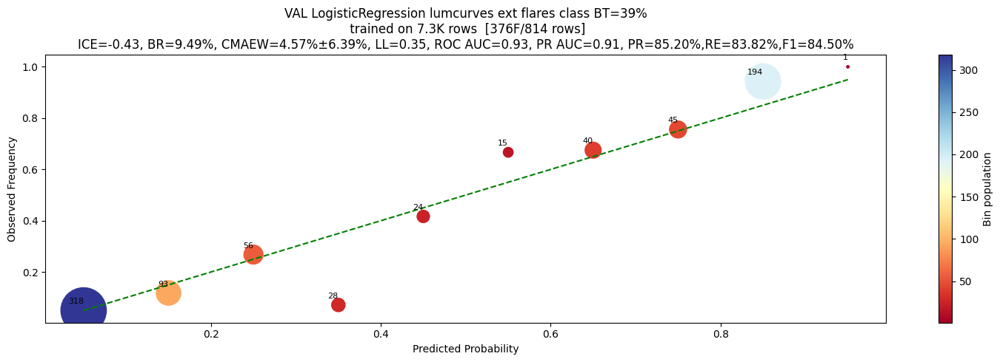

VAL LogisticRegression lumcurves ext flares class BT=39%
 trained on 7.3K rows 
              precision    recall  f1-score   support

           0     0.9020    0.9109    0.9064       505
           1     0.8520    0.8382    0.8450       309

    accuracy                         0.8833       814
   macro avg     0.8770    0.8745    0.8757       814
weighted avg     0.8830    0.8833    0.8831       814

ROC AUCs: 1=0.9281
PR AUCs: 1=0.9108
CALIBRATIONs: 
	1: MAEW=4.57%, STD=6.39%, COV=90%
BRIER LOSSes: 
	1=9.4894%
LOG_LOSSes: 
	1=0.3474
ICEs: 
	1=-0.4303
TOTAL INTEGRAL ERROR: -0.4303


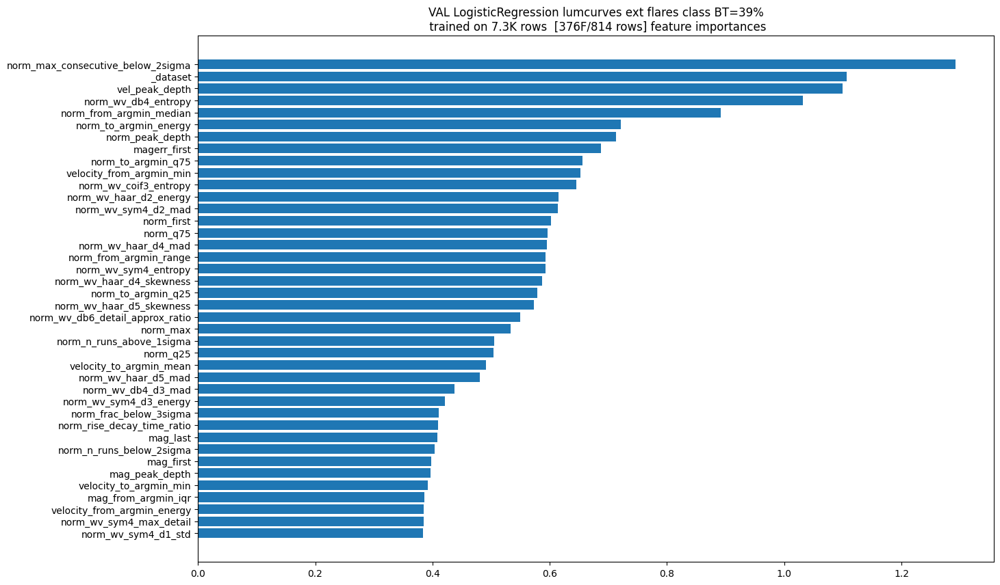

2026-01-14 23:21:33,968 - INFO - process_model-line:478 - Finished training, took 0.3 min. RAM usage 0.0GBs...
2026-01-14 23:21:34,023 - INFO - save_mlframe_model-line:55 - Model saved successfully to data\models\lumcurves-ext\flares\binary_classification\class\linear.dump. Size: 0.03 Mb


weighting schema:   0%|          | 0/1 [00:00<?, ?it/s]

2026-01-14 23:21:36,307 - INFO - process_model-line:453 - Starting train_and_evaluate PytorchLightningClassifier on binary_classification lumcurves ext flares class BT=39%, RAM usage 0.0GBs...


inf checking:   0%|          | 0/375 [00:00<?, ?it/s]

2026-01-14 23:21:38,521 - INFO - _apply_pre_pipeline_transforms-line:462 - Using pre-fitted pipeline (transform only): Pipeline(steps=[('imp', SimpleImputer()), ('scaler', StandardScaler())])
2026-01-14 23:21:38,810 - INFO - log_ram_usage-line:39 - Done. RAM usage: 0.1GB.
2026-01-14 23:21:38,812 - INFO - _apply_pre_pipeline_transforms-line:470 - Transforming val_df via pre_pipeline...
2026-01-14 23:21:38,854 - INFO - log_ram_usage-line:39 - Done. RAM usage: 0.1GB.
2026-01-14 23:21:43,061 - INFO - train_and_evaluate_model-line:1311 - training dataset shape: (7318, 376)
2026-01-14 23:21:45,167 - INFO - train_and_evaluate_model-line:1327 - Training the model...
2026-01-14 23:21:45,318 - INFO - generate_mlp-line:1355 - Network architecture: 376->100->66->44->29->19->13->8->5->3->2->2 [C, n=667, w=51.0k]
2026-01-14 23:21:45,337 - INFO - generate_mlp-line:1400 - Applied kaiming_normal_ initialization to Linear weights; normal_/constant_ for BatchNorm weights/biases and Linear biases
2026-01-

Sanity Checking: |                                                                               | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:441: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
2026-01-14 23:22:10,318 - INFO - on_validation_end-line:1115 - New best model at epoch 0 with val_ICE=0.5031
R:\ProgramData\anaconda3\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
R:\ProgramData\anaconda3\Lib\site-packages\lightning\pytorch\loops\fit_loop.py:298: The number of training batches (8) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |                                                                                      | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:22:11,054 - INFO - on_validation_end-line:1115 - New best model at epoch 0 with val_ICE=0.3562
INFO: Metric val_ICE improved. New best score: 0.356
2026-01-14 23:22:11,079 - INFO - _log_info-line:273 - Metric val_ICE improved. New best score: 0.356


Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:22:11,764 - INFO - on_validation_end-line:1115 - New best model at epoch 1 with val_ICE=0.2599
INFO: Metric val_ICE improved by 0.096 >= min_delta = 0.001. New best score: 0.260
2026-01-14 23:22:11,789 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.096 >= min_delta = 0.001. New best score: 0.260


Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:22:12,463 - INFO - on_validation_end-line:1115 - New best model at epoch 2 with val_ICE=0.1028
INFO: Metric val_ICE improved by 0.157 >= min_delta = 0.001. New best score: 0.103
2026-01-14 23:22:12,479 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.157 >= min_delta = 0.001. New best score: 0.103


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:22:13,477 - INFO - on_validation_end-line:1115 - New best model at epoch 4 with val_ICE=0.0792
INFO: Metric val_ICE improved by 0.024 >= min_delta = 0.001. New best score: 0.079
2026-01-14 23:22:13,486 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.024 >= min_delta = 0.001. New best score: 0.079


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:22:33,904 - INFO - on_validation_end-line:1115 - New best model at epoch 79 with val_ICE=0.0624
INFO: Metric val_ICE improved by 0.017 >= min_delta = 0.001. New best score: 0.062
2026-01-14 23:22:33,912 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.017 >= min_delta = 0.001. New best score: 0.062


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:22:35,053 - INFO - on_validation_end-line:1115 - New best model at epoch 83 with val_ICE=0.0575
INFO: Metric val_ICE improved by 0.005 >= min_delta = 0.001. New best score: 0.057
2026-01-14 23:22:35,061 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.005 >= min_delta = 0.001. New best score: 0.057


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:22:35,959 - INFO - on_validation_end-line:1115 - New best model at epoch 86 with val_ICE=0.0255
INFO: Metric val_ICE improved by 0.032 >= min_delta = 0.001. New best score: 0.026
2026-01-14 23:22:35,967 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.032 >= min_delta = 0.001. New best score: 0.026


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:22:36,856 - INFO - on_validation_end-line:1115 - New best model at epoch 89 with val_ICE=0.0077
INFO: Metric val_ICE improved by 0.018 >= min_delta = 0.001. New best score: 0.008
2026-01-14 23:22:36,863 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.018 >= min_delta = 0.001. New best score: 0.008


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:22:38,043 - INFO - on_validation_end-line:1115 - New best model at epoch 93 with val_ICE=0.0032
INFO: Metric val_ICE improved by 0.004 >= min_delta = 0.001. New best score: 0.003
2026-01-14 23:22:38,051 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.004 >= min_delta = 0.001. New best score: 0.003


Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:22:38,397 - INFO - on_validation_end-line:1115 - New best model at epoch 94 with val_ICE=-0.0053
INFO: Metric val_ICE improved by 0.009 >= min_delta = 0.001. New best score: -0.005
2026-01-14 23:22:38,405 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.009 >= min_delta = 0.001. New best score: -0.005


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:22:39,273 - INFO - on_validation_end-line:1115 - New best model at epoch 97 with val_ICE=-0.0199
INFO: Metric val_ICE improved by 0.015 >= min_delta = 0.001. New best score: -0.020
2026-01-14 23:22:39,281 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.015 >= min_delta = 0.001. New best score: -0.020


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:22:39,949 - INFO - on_validation_end-line:1115 - New best model at epoch 99 with val_ICE=-0.0372
INFO: Metric val_ICE improved by 0.017 >= min_delta = 0.001. New best score: -0.037
2026-01-14 23:22:39,957 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.017 >= min_delta = 0.001. New best score: -0.037


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:22:41,235 - INFO - on_validation_end-line:1115 - New best model at epoch 103 with val_ICE=-0.0535
INFO: Metric val_ICE improved by 0.016 >= min_delta = 0.001. New best score: -0.053
2026-01-14 23:22:41,243 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.016 >= min_delta = 0.001. New best score: -0.053


Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:22:41,601 - INFO - on_validation_end-line:1115 - New best model at epoch 104 with val_ICE=-0.0897
INFO: Metric val_ICE improved by 0.036 >= min_delta = 0.001. New best score: -0.090
2026-01-14 23:22:41,610 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.036 >= min_delta = 0.001. New best score: -0.090


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:22:43,948 - INFO - on_validation_end-line:1115 - New best model at epoch 112 with val_ICE=-0.0989
INFO: Metric val_ICE improved by 0.009 >= min_delta = 0.001. New best score: -0.099
2026-01-14 23:22:43,956 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.009 >= min_delta = 0.001. New best score: -0.099


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:22:45,430 - INFO - on_validation_end-line:1115 - New best model at epoch 117 with val_ICE=-0.1007
INFO: Metric val_ICE improved by 0.002 >= min_delta = 0.001. New best score: -0.101
2026-01-14 23:22:45,437 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.002 >= min_delta = 0.001. New best score: -0.101


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:22:48,812 - INFO - on_validation_end-line:1115 - New best model at epoch 129 with val_ICE=-0.1445
INFO: Metric val_ICE improved by 0.044 >= min_delta = 0.001. New best score: -0.144
2026-01-14 23:22:48,820 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.044 >= min_delta = 0.001. New best score: -0.144


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:22:49,447 - INFO - on_validation_end-line:1115 - New best model at epoch 131 with val_ICE=-0.1640
INFO: Metric val_ICE improved by 0.020 >= min_delta = 0.001. New best score: -0.164
2026-01-14 23:22:49,455 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.020 >= min_delta = 0.001. New best score: -0.164


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:22:50,561 - INFO - on_validation_end-line:1115 - New best model at epoch 134 with val_ICE=-0.1688
INFO: Metric val_ICE improved by 0.005 >= min_delta = 0.001. New best score: -0.169
2026-01-14 23:22:50,572 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.005 >= min_delta = 0.001. New best score: -0.169


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:22:54,369 - INFO - on_validation_end-line:1115 - New best model at epoch 147 with val_ICE=-0.1707
INFO: Metric val_ICE improved by 0.002 >= min_delta = 0.001. New best score: -0.171
2026-01-14 23:22:54,378 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.002 >= min_delta = 0.001. New best score: -0.171


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:22:55,014 - INFO - on_validation_end-line:1115 - New best model at epoch 149 with val_ICE=-0.1814
INFO: Metric val_ICE improved by 0.011 >= min_delta = 0.001. New best score: -0.181
2026-01-14 23:22:55,022 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.011 >= min_delta = 0.001. New best score: -0.181


Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:22:55,399 - INFO - on_validation_end-line:1115 - New best model at epoch 150 with val_ICE=-0.1933
INFO: Metric val_ICE improved by 0.012 >= min_delta = 0.001. New best score: -0.193
2026-01-14 23:22:55,407 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.012 >= min_delta = 0.001. New best score: -0.193


Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:22:55,795 - INFO - on_validation_end-line:1115 - New best model at epoch 151 with val_ICE=-0.2167
INFO: Metric val_ICE improved by 0.023 >= min_delta = 0.001. New best score: -0.217
2026-01-14 23:22:55,804 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.023 >= min_delta = 0.001. New best score: -0.217


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:23:02,626 - INFO - on_validation_end-line:1115 - New best model at epoch 176 with val_ICE=-0.2251
INFO: Metric val_ICE improved by 0.008 >= min_delta = 0.001. New best score: -0.225
2026-01-14 23:23:02,634 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.008 >= min_delta = 0.001. New best score: -0.225


Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:23:02,993 - INFO - on_validation_end-line:1115 - New best model at epoch 177 with val_ICE=-0.2252


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:23:03,892 - INFO - on_validation_end-line:1115 - New best model at epoch 180 with val_ICE=-0.2334
INFO: Metric val_ICE improved by 0.008 >= min_delta = 0.001. New best score: -0.233
2026-01-14 23:23:03,900 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.008 >= min_delta = 0.001. New best score: -0.233


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:23:09,162 - INFO - on_validation_end-line:1115 - New best model at epoch 199 with val_ICE=-0.2493
INFO: Metric val_ICE improved by 0.016 >= min_delta = 0.001. New best score: -0.249
2026-01-14 23:23:09,169 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.016 >= min_delta = 0.001. New best score: -0.249


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:23:10,109 - INFO - on_validation_end-line:1115 - New best model at epoch 202 with val_ICE=-0.2566
INFO: Metric val_ICE improved by 0.007 >= min_delta = 0.001. New best score: -0.257
2026-01-14 23:23:10,117 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.007 >= min_delta = 0.001. New best score: -0.257


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:23:12,339 - INFO - on_validation_end-line:1115 - New best model at epoch 210 with val_ICE=-0.2740
INFO: Metric val_ICE improved by 0.017 >= min_delta = 0.001. New best score: -0.274
2026-01-14 23:23:12,346 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.017 >= min_delta = 0.001. New best score: -0.274


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:23:12,982 - INFO - on_validation_end-line:1115 - New best model at epoch 212 with val_ICE=-0.2840
INFO: Metric val_ICE improved by 0.010 >= min_delta = 0.001. New best score: -0.284
2026-01-14 23:23:12,989 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.010 >= min_delta = 0.001. New best score: -0.284


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:23:15,524 - INFO - on_validation_end-line:1115 - New best model at epoch 221 with val_ICE=-0.2967
INFO: Metric val_ICE improved by 0.013 >= min_delta = 0.001. New best score: -0.297
2026-01-14 23:23:15,532 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.013 >= min_delta = 0.001. New best score: -0.297


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:23:17,565 - INFO - on_validation_end-line:1115 - New best model at epoch 228 with val_ICE=-0.2991
INFO: Metric val_ICE improved by 0.002 >= min_delta = 0.001. New best score: -0.299
2026-01-14 23:23:17,573 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.002 >= min_delta = 0.001. New best score: -0.299


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:23:19,845 - INFO - on_validation_end-line:1115 - New best model at epoch 236 with val_ICE=-0.3070
INFO: Metric val_ICE improved by 0.008 >= min_delta = 0.001. New best score: -0.307
2026-01-14 23:23:19,853 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.008 >= min_delta = 0.001. New best score: -0.307


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:23:23,204 - INFO - on_validation_end-line:1115 - New best model at epoch 248 with val_ICE=-0.3171
INFO: Metric val_ICE improved by 0.010 >= min_delta = 0.001. New best score: -0.317
2026-01-14 23:23:23,211 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.010 >= min_delta = 0.001. New best score: -0.317


Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:23:23,577 - INFO - on_validation_end-line:1115 - New best model at epoch 249 with val_ICE=-0.3242
INFO: Metric val_ICE improved by 0.007 >= min_delta = 0.001. New best score: -0.324
2026-01-14 23:23:23,584 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.007 >= min_delta = 0.001. New best score: -0.324


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:23:24,214 - INFO - on_validation_end-line:1115 - New best model at epoch 251 with val_ICE=-0.3383
INFO: Metric val_ICE improved by 0.014 >= min_delta = 0.001. New best score: -0.338
2026-01-14 23:23:24,222 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.014 >= min_delta = 0.001. New best score: -0.338


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:23:31,764 - INFO - on_validation_end-line:1115 - New best model at epoch 278 with val_ICE=-0.3500
INFO: Metric val_ICE improved by 0.012 >= min_delta = 0.001. New best score: -0.350
2026-01-14 23:23:31,773 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.012 >= min_delta = 0.001. New best score: -0.350


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:23:38,522 - INFO - on_validation_end-line:1115 - New best model at epoch 302 with val_ICE=-0.3933
INFO: Metric val_ICE improved by 0.043 >= min_delta = 0.001. New best score: -0.393
2026-01-14 23:23:38,530 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.043 >= min_delta = 0.001. New best score: -0.393


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:24:02,863 - INFO - on_validation_end-line:1115 - New best model at epoch 390 with val_ICE=-0.3972
INFO: Metric val_ICE improved by 0.004 >= min_delta = 0.001. New best score: -0.397
2026-01-14 23:24:02,870 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.004 >= min_delta = 0.001. New best score: -0.397


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:24:04,322 - INFO - on_validation_end-line:1115 - New best model at epoch 395 with val_ICE=-0.3978


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:24:11,525 - INFO - on_validation_end-line:1115 - New best model at epoch 421 with val_ICE=-0.4124
INFO: Metric val_ICE improved by 0.015 >= min_delta = 0.001. New best score: -0.412
2026-01-14 23:24:11,533 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.015 >= min_delta = 0.001. New best score: -0.412


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:24:33,938 - INFO - on_validation_end-line:1115 - New best model at epoch 502 with val_ICE=-0.4173
INFO: Metric val_ICE improved by 0.005 >= min_delta = 0.001. New best score: -0.417
2026-01-14 23:24:33,945 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.005 >= min_delta = 0.001. New best score: -0.417


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:24:40,085 - INFO - on_validation_end-line:1115 - New best model at epoch 524 with val_ICE=-0.4219
INFO: Metric val_ICE improved by 0.005 >= min_delta = 0.001. New best score: -0.422
2026-01-14 23:24:40,093 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.005 >= min_delta = 0.001. New best score: -0.422


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:24:44,288 - INFO - on_validation_end-line:1115 - New best model at epoch 539 with val_ICE=-0.4257
INFO: Metric val_ICE improved by 0.004 >= min_delta = 0.001. New best score: -0.426
2026-01-14 23:24:44,296 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.004 >= min_delta = 0.001. New best score: -0.426


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-14 23:24:49,397 - INFO - on_validation_end-line:1115 - New best model at epoch 557 with val_ICE=-0.4888
INFO: Metric val_ICE improved by 0.063 >= min_delta = 0.001. New best score: -0.489
2026-01-14 23:24:49,405 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.063 >= min_delta = 0.001. New best score: -0.489


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

INFO: Monitored metric val_ICE did not improve in the last 500 records. Best score: -0.489. Signaling Trainer to stop.
2026-01-14 23:27:06,186 - INFO - _log_info-line:273 - Monitored metric val_ICE did not improve in the last 500 records. Best score: -0.489. Signaling Trainer to stop.
2026-01-14 23:27:06,200 - INFO - on_train_end-line:1814 - Loading best model from S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\logs\model-val_ICE=-0.4888.ckpt (score: -0.4888)
2026-01-14 23:27:06,358 - INFO - on_train_end-line:1834 - Loaded weights from epoch 557
2026-01-14 23:27:06,410 - INFO - _fit_common-line:322 - Best epoch recorded: 557
2026-01-14 23:27:08,844 - INFO - _train_model_with_fallback-line:693 - es_best_iter: 557
2026-01-14 23:27:08,850 - INFO - train_and_evaluate_model-line:1377 - Computing model's performance...
2026-01-14 23:27:08,853 - WARNING - _predict_raw-line:419 - No datamodule found from training. Creating temporary datamodule for prediction.
2026-01-14 23:27

es_best_iter: 557


2026-01-14 23:27:09,303 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2026-01-14 23:27:09,306 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2026-01-14 23:27:09,310 - INFO - _info-line:64 - IPU available: False, using: 0 IPUs
2026-01-14 23:27:09,314 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
2026-01-14 23:27:09,318 - WARNING - _predict_raw-line:470 - Model was in training mode during prediction. Switching to eval mode.
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2026-01-14 23:27:09,330 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
R:\ProgramData\anaconda3\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:441: The 'predict_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
2026-01-14 23:27:09,495 - INFO - _predict_raw-line:506 - Generate

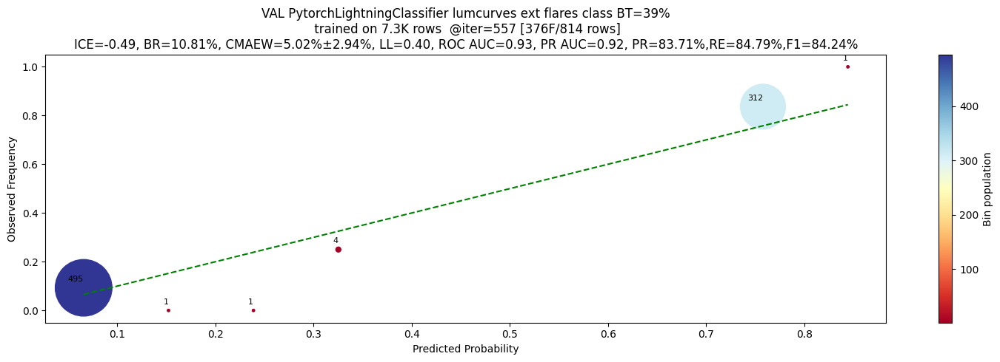

VAL PytorchLightningClassifier lumcurves ext flares class BT=39%
 trained on 7.3K rows  @iter=557
              precision    recall  f1-score   support

           0     0.9062    0.8990    0.9026       505
           1     0.8371    0.8479    0.8424       309

    accuracy                         0.8796       814
   macro avg     0.8716    0.8735    0.8725       814
weighted avg     0.8799    0.8796    0.8798       814

ROC AUCs: 1=0.9330
PR AUCs: 1=0.9176
CALIBRATIONs: 
	1: MAEW=5.02%, STD=2.94%, COV=40%
BRIER LOSSes: 
	1=10.8144%
LOG_LOSSes: 
	1=0.4020
ICEs: 
	1=-0.4888
TOTAL INTEGRAL ERROR: -0.4888


2026-01-14 23:27:15,908 - INFO - process_model-line:478 - Finished training, took 5.7 min. RAM usage 0.0GBs...
2026-01-14 23:27:16,456 - INFO - save_mlframe_model-line:55 - Model saved successfully to data\models\lumcurves-ext\flares\binary_classification\class\mlp.dump. Size: 7.45 Mb
2026-01-14 23:27:18,924 - INFO - train_mlframe_models_suite-line:1276 - evaluating simple ensembles...


ens member 0 excluded due to high distance from the median, mae=0.041987, std=0.075516
ens member 1 excluded due to high distance from the median, mae=0.046891, std=0.081818
ens member 2 excluded due to high distance from the median, mae=0.039930, std=0.062506
ens member 3 excluded due to high distance from the median, mae=0.072897, std=0.091265
ens member 4 excluded due to high distance from the median, mae=0.076103, std=0.117437
ens member 5 excluded due to high distance from the median, mae=0.102243, std=0.156757
ensemble_probabilistic_predictions filters too restrictive (6 vs 6), skipping them


inf checking:   0%|          | 0/375 [00:00<?, ?it/s]

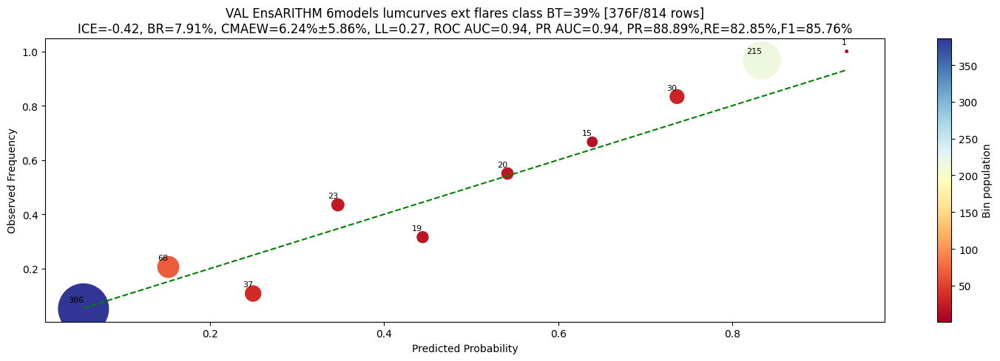

VAL EnsARITHM 6models lumcurves ext flares class BT=39%
              precision    recall  f1-score   support

           0     0.8992    0.9366    0.9176       505
           1     0.8889    0.8285    0.8576       309

    accuracy                         0.8956       814
   macro avg     0.8941    0.8826    0.8876       814
weighted avg     0.8953    0.8956    0.8948       814

ROC AUCs: 1=0.9446
PR AUCs: 1=0.9360
CALIBRATIONs: 
	1: MAEW=6.24%, STD=5.86%, COV=90%
BRIER LOSSes: 
	1=7.9099%
LOG_LOSSes: 
	1=0.2721
ICEs: 
	1=-0.4244
TOTAL INTEGRAL ERROR: -0.4244


inf checking:   0%|          | 0/375 [00:00<?, ?it/s]

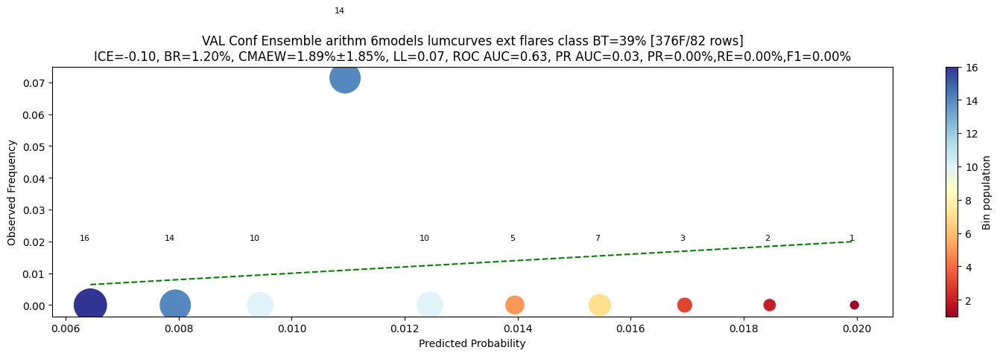

VAL Conf Ensemble arithm 6models lumcurves ext flares class BT=39%
              precision    recall  f1-score   support

           0     0.9878    1.0000    0.9939        81
           1     0.0000    0.0000    0.0000         1

    accuracy                         0.9878        82
   macro avg     0.4939    0.5000    0.4969        82
weighted avg     0.9758    0.9878    0.9817        82

ROC AUCs: 1=0.6296
PR AUCs: 1=0.0323
CALIBRATIONs: 
	1: MAEW=1.89%, STD=1.85%, COV=10%
BRIER LOSSes: 
	1=1.2043%
LOG_LOSSes: 
	1=0.0650
ICEs: 
	1=-0.0993
TOTAL INTEGRAL ERROR: -0.0993
ens member 0 excluded due to high distance from the median, mae=0.041987, std=0.075516
ens member 1 excluded due to high distance from the median, mae=0.046891, std=0.081818
ens member 2 excluded due to high distance from the median, mae=0.039930, std=0.062506
ens member 3 excluded due to high distance from the median, mae=0.072897, std=0.091265
ens member 4 excluded due to high distance from the median, mae=0.076103, 

inf checking:   0%|          | 0/375 [00:00<?, ?it/s]

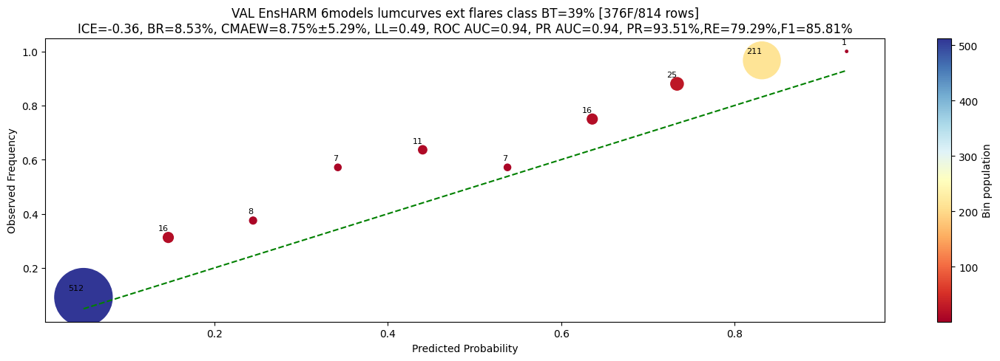

VAL EnsHARM 6models lumcurves ext flares class BT=39%
              precision    recall  f1-score   support

           0     0.8841    0.9663    0.9234       505
           1     0.9351    0.7929    0.8581       309

    accuracy                         0.9005       814
   macro avg     0.9096    0.8796    0.8908       814
weighted avg     0.9034    0.9005    0.8986       814

ROC AUCs: 1=0.9445
PR AUCs: 1=0.9364
CALIBRATIONs: 
	1: MAEW=8.75%, STD=5.29%, COV=100%
BRIER LOSSes: 
	1=8.5278%
LOG_LOSSes: 
	1=0.4946
ICEs: 
	1=-0.3579
TOTAL INTEGRAL ERROR: -0.3579


inf checking:   0%|          | 0/375 [00:00<?, ?it/s]

S:\recovered13\Programming\PythonCodeRepository\mlframe\metrics.py:348: UserWarning:

Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.



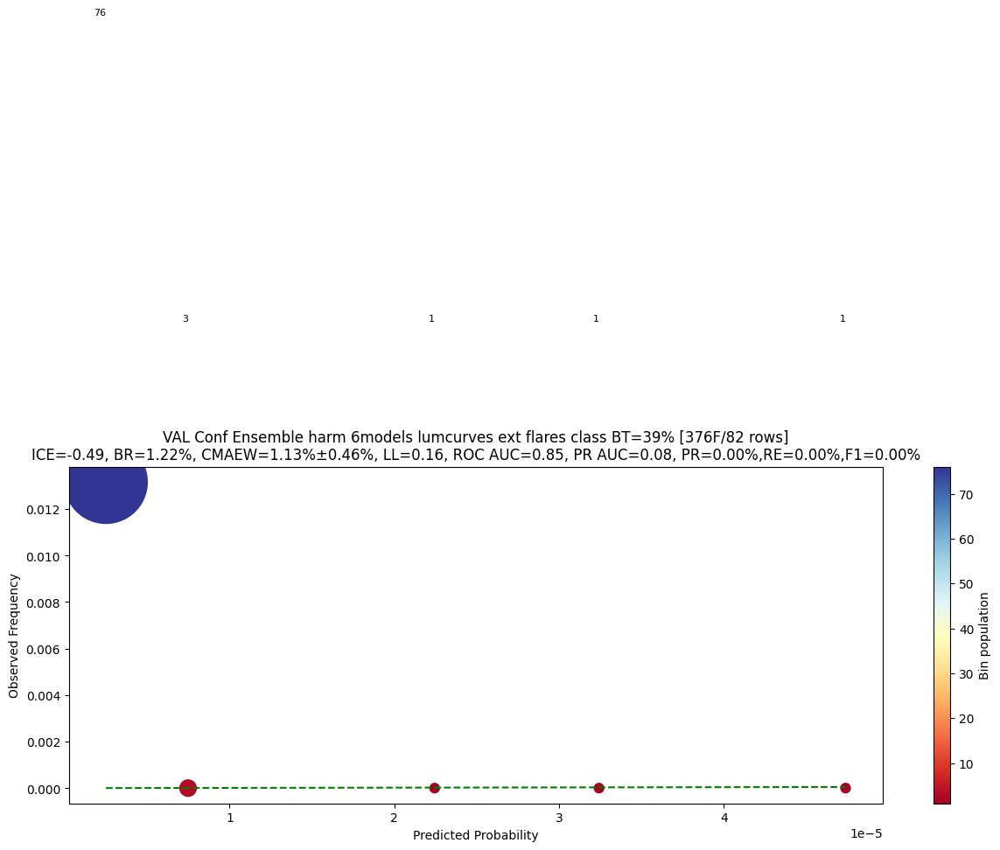

VAL Conf Ensemble harm 6models lumcurves ext flares class BT=39%
              precision    recall  f1-score   support

           0     0.9878    1.0000    0.9939        81
           1     0.0000    0.0000    0.0000         1

    accuracy                         0.9878        82
   macro avg     0.4939    0.5000    0.4969        82
weighted avg     0.9758    0.9878    0.9817        82

ROC AUCs: 1=0.8519
PR AUCs: 1=0.0769
CALIBRATIONs: 
	1: MAEW=1.13%, STD=0.46%, COV=10%
BRIER LOSSes: 
	1=1.2195%
LOG_LOSSes: 
	1=0.1619
ICEs: 
	1=-0.4876
TOTAL INTEGRAL ERROR: -0.4876
ens member 0 excluded due to high distance from the median, mae=0.041987, std=0.075516
ens member 1 excluded due to high distance from the median, mae=0.046891, std=0.081818
ens member 2 excluded due to high distance from the median, mae=0.039930, std=0.062506
ens member 3 excluded due to high distance from the median, mae=0.072897, std=0.091265
ens member 4 excluded due to high distance from the median, mae=0.076103, st

inf checking:   0%|          | 0/375 [00:00<?, ?it/s]

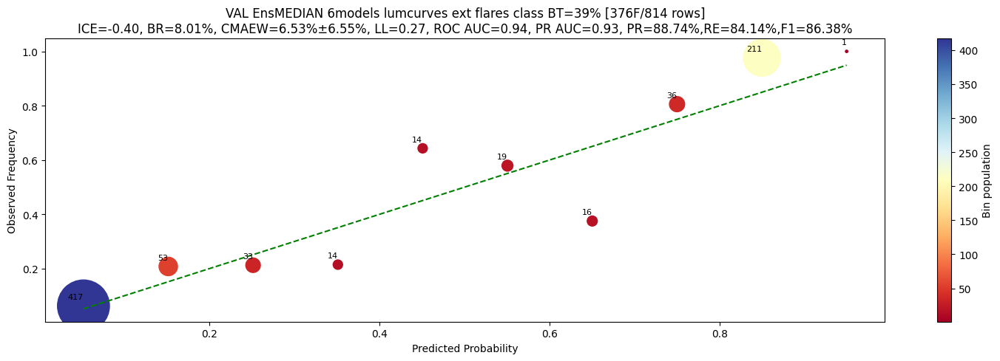

VAL EnsMEDIAN 6models lumcurves ext flares class BT=39%
              precision    recall  f1-score   support

           0     0.9060    0.9347    0.9201       505
           1     0.8874    0.8414    0.8638       309

    accuracy                         0.8993       814
   macro avg     0.8967    0.8880    0.8919       814
weighted avg     0.8989    0.8993    0.8987       814

ROC AUCs: 1=0.9431
PR AUCs: 1=0.9350
CALIBRATIONs: 
	1: MAEW=6.53%, STD=6.55%, COV=90%
BRIER LOSSes: 
	1=8.0121%
LOG_LOSSes: 
	1=0.2748
ICEs: 
	1=-0.3992
TOTAL INTEGRAL ERROR: -0.3992


inf checking:   0%|          | 0/375 [00:00<?, ?it/s]

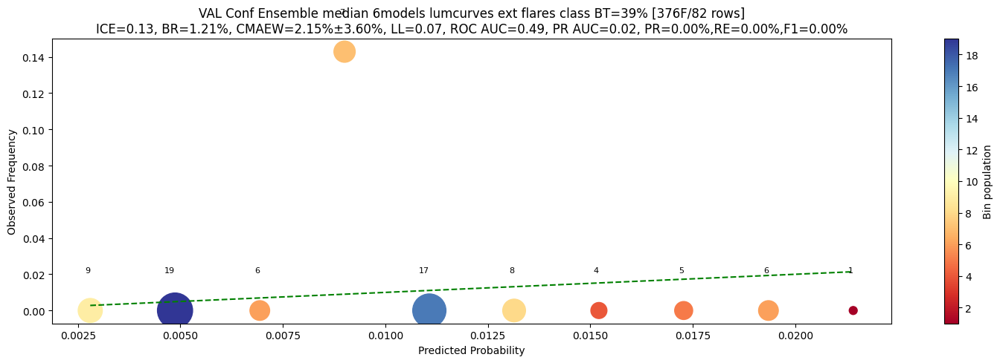

VAL Conf Ensemble median 6models lumcurves ext flares class BT=39%
              precision    recall  f1-score   support

           0     0.9878    1.0000    0.9939        81
           1     0.0000    0.0000    0.0000         1

    accuracy                         0.9878        82
   macro avg     0.4939    0.5000    0.4969        82
weighted avg     0.9758    0.9878    0.9817        82

ROC AUCs: 1=0.4938
PR AUCs: 1=0.0238
CALIBRATIONs: 
	1: MAEW=2.15%, STD=3.60%, COV=10%
BRIER LOSSes: 
	1=1.2076%
LOG_LOSSes: 
	1=0.0658
ICEs: 
	1=0.1296
TOTAL INTEGRAL ERROR: 0.1296
ens member 0 excluded due to high distance from the median, mae=0.041987, std=0.075516
ens member 1 excluded due to high distance from the median, mae=0.046891, std=0.081818
ens member 2 excluded due to high distance from the median, mae=0.039930, std=0.062506
ens member 3 excluded due to high distance from the median, mae=0.072897, std=0.091265
ens member 4 excluded due to high distance from the median, mae=0.076103, st

inf checking:   0%|          | 0/375 [00:00<?, ?it/s]

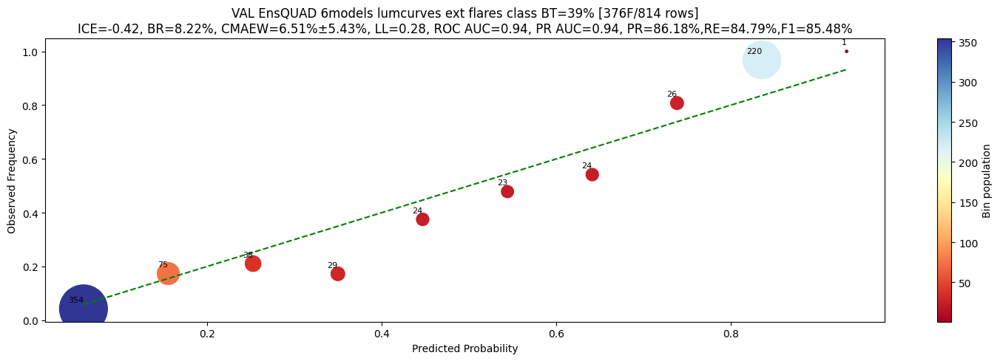

VAL EnsQUAD 6models lumcurves ext flares class BT=39%
              precision    recall  f1-score   support

           0     0.9078    0.9168    0.9123       505
           1     0.8618    0.8479    0.8548       309

    accuracy                         0.8907       814
   macro avg     0.8848    0.8824    0.8836       814
weighted avg     0.8904    0.8907    0.8905       814

ROC AUCs: 1=0.9443
PR AUCs: 1=0.9356
CALIBRATIONs: 
	1: MAEW=6.51%, STD=5.43%, COV=90%
BRIER LOSSes: 
	1=8.2197%
LOG_LOSSes: 
	1=0.2782
ICEs: 
	1=-0.4231
TOTAL INTEGRAL ERROR: -0.4231


inf checking:   0%|          | 0/375 [00:00<?, ?it/s]

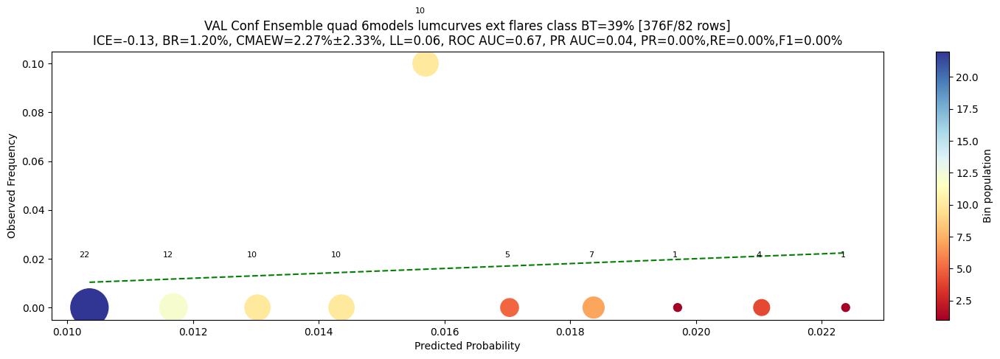

VAL Conf Ensemble quad 6models lumcurves ext flares class BT=39%
              precision    recall  f1-score   support

           0     0.9878    1.0000    0.9939        81
           1     0.0000    0.0000    0.0000         1

    accuracy                         0.9878        82
   macro avg     0.4939    0.5000    0.4969        82
weighted avg     0.9758    0.9878    0.9817        82

ROC AUCs: 1=0.6667
PR AUCs: 1=0.0357
CALIBRATIONs: 
	1: MAEW=2.27%, STD=2.33%, COV=10%
BRIER LOSSes: 
	1=1.2033%
LOG_LOSSes: 
	1=0.0650
ICEs: 
	1=-0.1342
TOTAL INTEGRAL ERROR: -0.1342
ens member 0 excluded due to high distance from the median, mae=0.041987, std=0.075516
ens member 1 excluded due to high distance from the median, mae=0.046891, std=0.081818
ens member 2 excluded due to high distance from the median, mae=0.039930, std=0.062506
ens member 3 excluded due to high distance from the median, mae=0.072897, std=0.091265
ens member 4 excluded due to high distance from the median, mae=0.076103, st

inf checking:   0%|          | 0/375 [00:00<?, ?it/s]

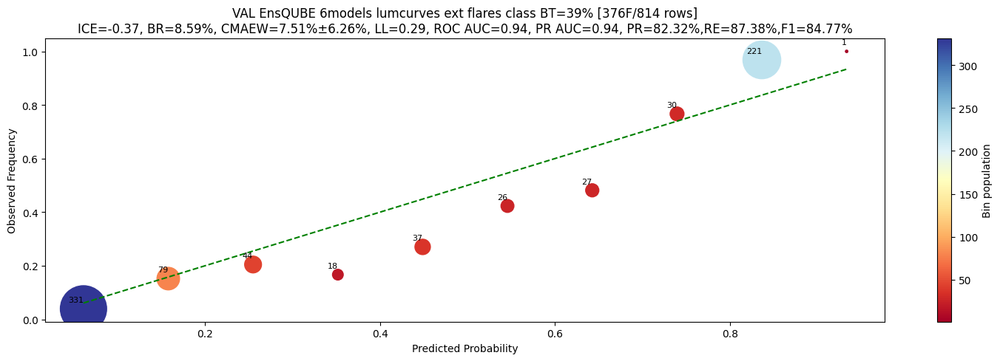

VAL EnsQUBE 6models lumcurves ext flares class BT=39%
              precision    recall  f1-score   support

           0     0.9198    0.8851    0.9021       505
           1     0.8232    0.8738    0.8477       309

    accuracy                         0.8808       814
   macro avg     0.8715    0.8795    0.8749       814
weighted avg     0.8831    0.8808    0.8815       814

ROC AUCs: 1=0.9441
PR AUCs: 1=0.9353
CALIBRATIONs: 
	1: MAEW=7.51%, STD=6.26%, COV=90%
BRIER LOSSes: 
	1=8.5881%
LOG_LOSSes: 
	1=0.2863
ICEs: 
	1=-0.3749
TOTAL INTEGRAL ERROR: -0.3749


inf checking:   0%|          | 0/375 [00:00<?, ?it/s]

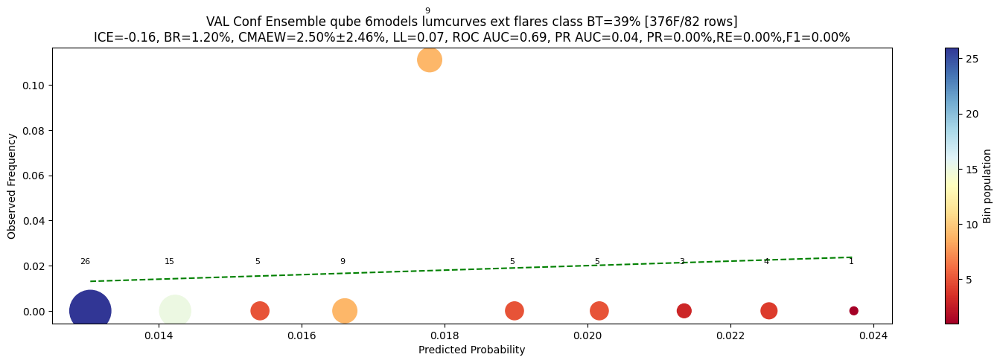

VAL Conf Ensemble qube 6models lumcurves ext flares class BT=39%
              precision    recall  f1-score   support

           0     0.9878    1.0000    0.9939        81
           1     0.0000    0.0000    0.0000         1

    accuracy                         0.9878        82
   macro avg     0.4939    0.5000    0.4969        82
weighted avg     0.9758    0.9878    0.9817        82

ROC AUCs: 1=0.6914
PR AUCs: 1=0.0385
CALIBRATIONs: 
	1: MAEW=2.50%, STD=2.46%, COV=10%
BRIER LOSSes: 
	1=1.2039%
LOG_LOSSes: 
	1=0.0654
ICEs: 
	1=-0.1618
TOTAL INTEGRAL ERROR: -0.1618
ens member 0 excluded due to high distance from the median, mae=0.041987, std=0.075516
ens member 1 excluded due to high distance from the median, mae=0.046891, std=0.081818
ens member 2 excluded due to high distance from the median, mae=0.039930, std=0.062506
ens member 3 excluded due to high distance from the median, mae=0.072897, std=0.091265
ens member 4 excluded due to high distance from the median, mae=0.076103, st

inf checking:   0%|          | 0/375 [00:00<?, ?it/s]

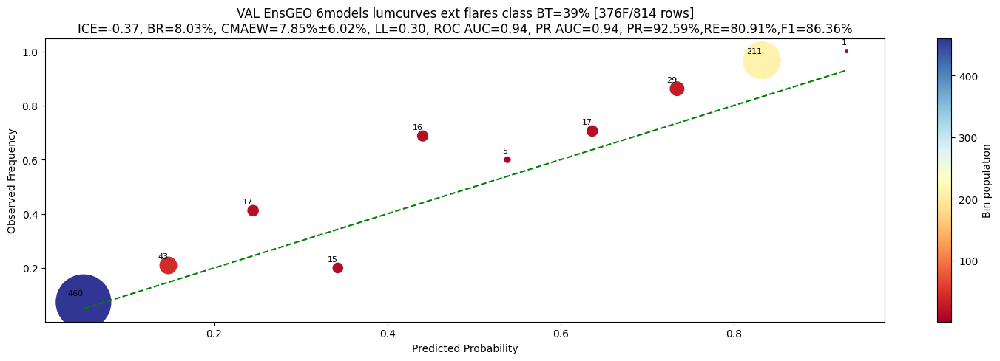

VAL EnsGEO 6models lumcurves ext flares class BT=39%
              precision    recall  f1-score   support

           0     0.8915    0.9604    0.9247       505
           1     0.9259    0.8091    0.8636       309

    accuracy                         0.9029       814
   macro avg     0.9087    0.8847    0.8941       814
weighted avg     0.9046    0.9029    0.9015       814

ROC AUCs: 1=0.9449
PR AUCs: 1=0.9366
CALIBRATIONs: 
	1: MAEW=7.85%, STD=6.02%, COV=100%
BRIER LOSSes: 
	1=8.0296%
LOG_LOSSes: 
	1=0.3046
ICEs: 
	1=-0.3731
TOTAL INTEGRAL ERROR: -0.3731


inf checking:   0%|          | 0/375 [00:00<?, ?it/s]

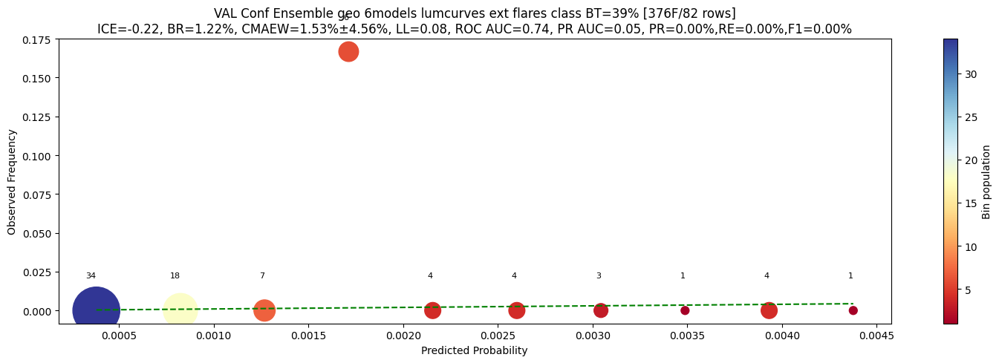

VAL Conf Ensemble geo 6models lumcurves ext flares class BT=39%
              precision    recall  f1-score   support

           0     0.9878    1.0000    0.9939        81
           1     0.0000    0.0000    0.0000         1

    accuracy                         0.9878        82
   macro avg     0.4939    0.5000    0.4969        82
weighted avg     0.9758    0.9878    0.9817        82

ROC AUCs: 1=0.7407
PR AUCs: 1=0.0455
CALIBRATIONs: 
	1: MAEW=1.53%, STD=4.56%, COV=10%
BRIER LOSSes: 
	1=1.2157%
LOG_LOSSes: 
	1=0.0791
ICEs: 
	1=-0.2237
TOTAL INTEGRAL ERROR: -0.2237


2026-01-14 23:28:56,264 - INFO - log_phase-line:44 - ----------------------------------------------------------------------------------------------------------------------------------------------------------------
2026-01-14 23:28:56,270 - INFO - log_phase-line:45 - Training suite completed for flares, 6 models.
2026-01-14 23:28:56,277 - INFO - log_phase-line:46 - ----------------------------------------------------------------------------------------------------------------------------------------------------------------
2026-01-14 23:28:56,281 - INFO - log_ram_usage-line:39 - Done. RAM usage: 0.0GB.


time: 11min 36s (started: 2026-01-14 23:17:19 +03:00)


In [30]:
target_name = "lumcurves ext"

ft_extractor = SimpleFeaturesAndTargetsExtractor(
    classification_targets=["class"],
    columns_to_drop=set(["id", "ts", "source", "dataset", "_orig_idx", "_start_idx"]),
    verbose=1,
)

mlframe_models, metadata = train_mlframe_models_suite(
    df=labeled_df_train.to_pandas(),
    target_name=target_name,
    model_name=f"flares",
    features_and_targets_extractor=ft_extractor,
    mlframe_models="cb xgb lgb hgb linear mlp".split(),
    init_common_params={"show_perf_chart": True, "show_fi": True},
    use_ordinary_models=True,
    pipeline_config=PolarsPipelineConfig(use_polarsds_pipeline=False),
    split_config=TrainingSplitConfig(
        shuffle_val=True, shuffle_test=True, test_size=0.0, val_size=0.1
    ),
    config_params_override={
        "iterations": 5000,
        "early_stopping_rounds": 500,
    },
    use_mlframe_ensembles=True,
    data_dir="data",
    # models_dir=None,
    verbose=True,
)

In [54]:
model = mlframe_models["class"]["binary_classification"][0]
np.array(model.columns)[np.argsort(model.metrics["val"]["feature_importances"])[::-1]][
    :200
]

array(['norm_to_argmin_q25', 'norm_to_argmin_mean',
       'velocity_from_argmin_mean', 'norm_wv_haar_d4_skewness',
       'norm_from_argmin_n_below_2sigma', 'velocity_from_argmin_max',
       'norm_wv_sym4_d1_kurtosis', 'velocity_from_argmin_skewness',
       'norm_max_consecutive_below_2sigma', 'norm_wv_sym4_d2_kurtosis',
       'norm_wv_haar_d5_skewness', 'norm_wv_haar_d2_mean',
       'norm_wv_haar_d3_skewness', 'vel_max_consecutive_above_1sigma',
       'mag_kurtosis', 'norm_to_argmin_kurtosis', 'mag_skewness',
       'norm_wv_db6_d1_kurtosis', 'norm_wv_db4_d1_rel_energy',
       'norm_wv_haar_d3_rel_energy',
       'norm_max_consecutive_frac_below_2sigma', 'norm_from_argmin_iqr',
       'norm_rise_decay_time_ratio', 'norm_wv_db4_d1_kurtosis',
       'norm_first_second_half_diff', 'norm_wv_haar_detail_ratio',
       'norm_from_argmin_q25', 'mag_to_argmin_kurtosis',
       'velocity_from_argmin_median', 'vel_frac_below_1sigma',
       'norm_from_argmin_std', 'norm_n_runs_above_1sig

time: 31 ms (started: 2026-01-15 00:55:45 +03:00)


In [53]:
labeled_df.shape, len(model.columns)

((9036, 481), 376)

time: 16 ms (started: 2026-01-15 00:52:30 +03:00)


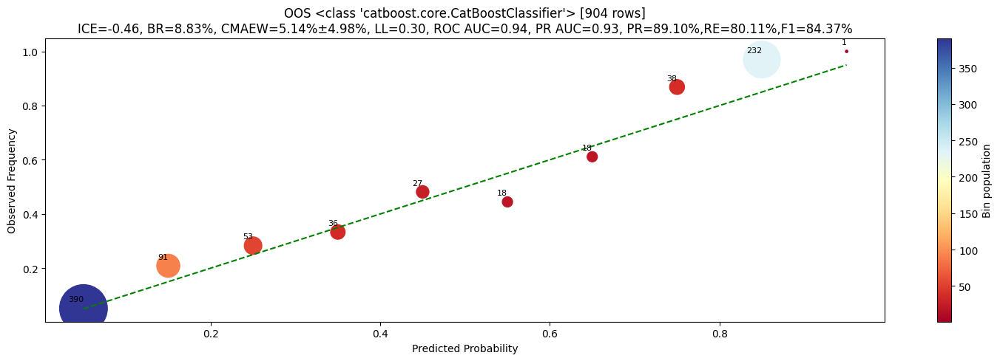

OOS <class 'catboost.core.CatBoostClassifier'>
              precision    recall  f1-score   support

           0       0.88      0.94      0.91       547
           1       0.89      0.80      0.84       357

    accuracy                           0.88       904
   macro avg       0.88      0.87      0.87       904
weighted avg       0.88      0.88      0.88       904

ROC AUCs: 1=0.94
PR AUCs: 1=0.93
CALIBRATIONs: 
	1: MAEW=5.14%, STD=4.98%, COV=90%
BRIER LOSSes: 
	1=8.83%
LOG_LOSSes: 
	1=0.30
ICEs: 
	1=-0.46
TOTAL INTEGRAL ERROR: 0.0000


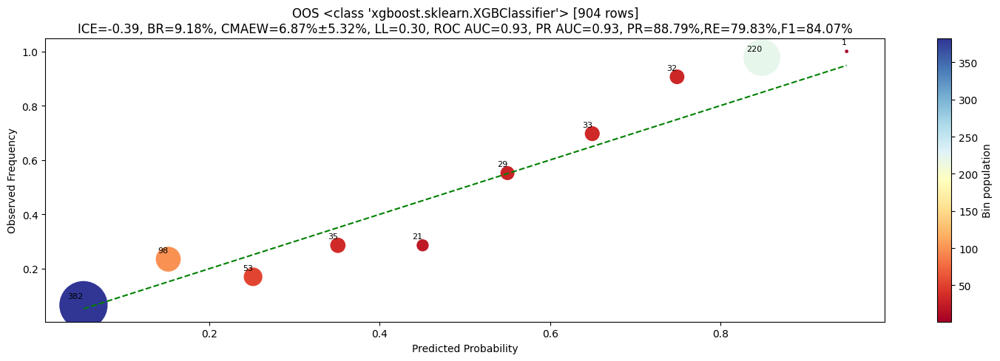

OOS <class 'xgboost.sklearn.XGBClassifier'>
              precision    recall  f1-score   support

           0       0.88      0.93      0.90       547
           1       0.89      0.80      0.84       357

    accuracy                           0.88       904
   macro avg       0.88      0.87      0.87       904
weighted avg       0.88      0.88      0.88       904

ROC AUCs: 1=0.93
PR AUCs: 1=0.93
CALIBRATIONs: 
	1: MAEW=6.87%, STD=5.32%, COV=90%
BRIER LOSSes: 
	1=9.18%
LOG_LOSSes: 
	1=0.30
ICEs: 
	1=-0.39
TOTAL INTEGRAL ERROR: 0.0000


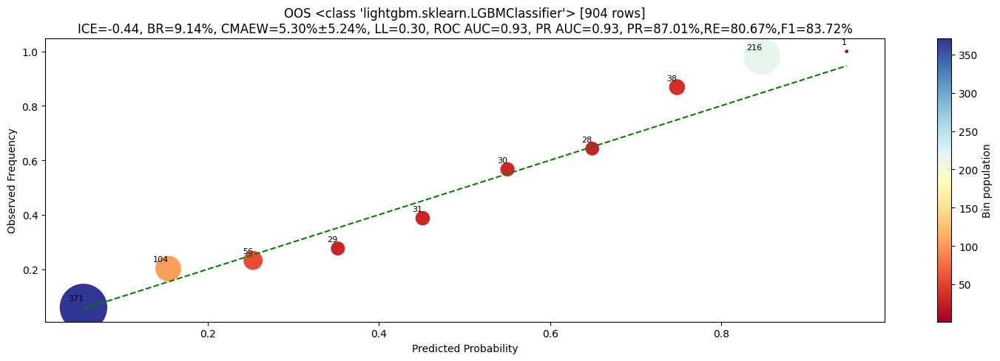

OOS <class 'lightgbm.sklearn.LGBMClassifier'>
              precision    recall  f1-score   support

           0       0.88      0.92      0.90       547
           1       0.87      0.81      0.84       357

    accuracy                           0.88       904
   macro avg       0.87      0.86      0.87       904
weighted avg       0.88      0.88      0.88       904

ROC AUCs: 1=0.93
PR AUCs: 1=0.93
CALIBRATIONs: 
	1: MAEW=5.30%, STD=5.24%, COV=90%
BRIER LOSSes: 
	1=9.14%
LOG_LOSSes: 
	1=0.30
ICEs: 
	1=-0.44
TOTAL INTEGRAL ERROR: 0.0000


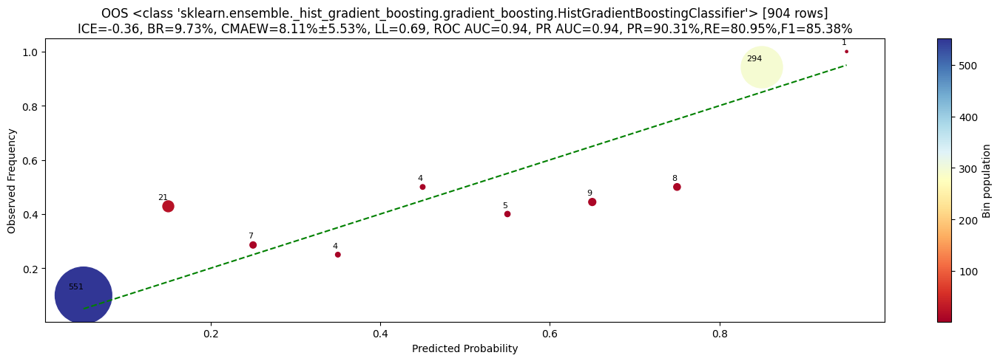

OOS <class 'sklearn.ensemble._hist_gradient_boosting.gradient_boosting.HistGradientBoostingClassifier'>
              precision    recall  f1-score   support

           0       0.88      0.94      0.91       547
           1       0.90      0.81      0.85       357

    accuracy                           0.89       904
   macro avg       0.89      0.88      0.88       904
weighted avg       0.89      0.89      0.89       904

ROC AUCs: 1=0.94
PR AUCs: 1=0.94
CALIBRATIONs: 
	1: MAEW=8.11%, STD=5.53%, COV=100%
BRIER LOSSes: 
	1=9.73%
LOG_LOSSes: 
	1=0.69
ICEs: 
	1=-0.36
TOTAL INTEGRAL ERROR: 0.0000


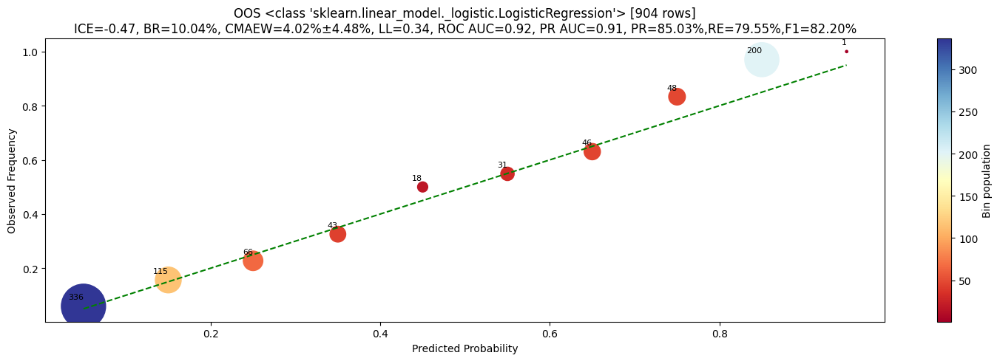

2026-01-14 23:32:31,254 - WARNING - _predict_raw-line:419 - No datamodule found from training. Creating temporary datamodule for prediction.
2026-01-14 23:32:31,257 - INFO - _predict_raw-line:424 - Using batch_size=64 for prediction


OOS <class 'sklearn.linear_model._logistic.LogisticRegression'>
              precision    recall  f1-score   support

           0       0.87      0.91      0.89       547
           1       0.85      0.80      0.82       357

    accuracy                           0.86       904
   macro avg       0.86      0.85      0.86       904
weighted avg       0.86      0.86      0.86       904

ROC AUCs: 1=0.92
PR AUCs: 1=0.91
CALIBRATIONs: 
	1: MAEW=4.02%, STD=4.48%, COV=100%
BRIER LOSSes: 
	1=10.04%
LOG_LOSSes: 
	1=0.34
ICEs: 
	1=-0.47
TOTAL INTEGRAL ERROR: 0.0000


2026-01-14 23:32:31,800 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2026-01-14 23:32:31,848 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2026-01-14 23:32:31,852 - INFO - _info-line:64 - IPU available: False, using: 0 IPUs
2026-01-14 23:32:31,856 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2026-01-14 23:32:31,867 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
R:\ProgramData\anaconda3\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:441: The 'predict_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
2026-01-14 23:32:32,062 - INFO - _predict_raw-line:506 - Generated predictions with shape (904, 2)


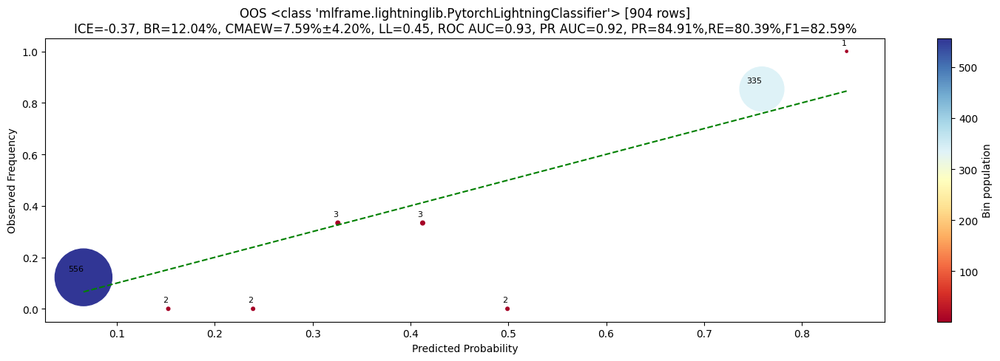

OOS <class 'mlframe.lightninglib.PytorchLightningClassifier'>
              precision    recall  f1-score   support

           0       0.88      0.91      0.89       547
           1       0.85      0.80      0.83       357

    accuracy                           0.87       904
   macro avg       0.86      0.86      0.86       904
weighted avg       0.87      0.87      0.87       904

ROC AUCs: 1=0.93
PR AUCs: 1=0.92
CALIBRATIONs: 
	1: MAEW=7.59%, STD=4.20%, COV=60%
BRIER LOSSes: 
	1=12.04%
LOG_LOSSes: 
	1=0.45
ICEs: 
	1=-0.37
TOTAL INTEGRAL ERROR: 0.0000
time: 7.69 s (started: 2026-01-14 23:32:25 +03:00)


In [34]:
temp_df = labeled_df_test.select(
    mlframe_models["class"]["binary_classification"][0].columns
).to_pandas()
for mlframe_model in mlframe_models["class"]["binary_classification"]:
    model = mlframe_model.model
    key = f"{type(model)}"

    models[key] = model
    if mlframe_model.pre_pipeline:
        tmp = mlframe_model.pre_pipeline.transform(temp_df)
    else:
        tmp = temp_df

    probs = model.predict_proba(tmp)

    metrics[key] = {}

    _, _ = report_model_perf(
        targets=targets,
        columns=None,
        df=None,
        model_name=key,
        model=None,
        target_label_encoder=None,
        preds=None,
        probs=probs,
        plot_file=join(charts_dir, key) if charts_dir else None,
        metrics=metrics[key],
        group_ids=None,
        **report_params,
    )

# 1200 labelled

In [21]:
expert_flares = pl.read_parquet(
    r"S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\flares_1229.parquet"
)

expert_flares

_init_credential_provider_builder(): credential_provider_init = None


id,mjd,mag,magerr
str,list[f64],list[f64],list[f64]
"""ZTFDR562201200012596_MJD58861.…","[58861.23541, 58861.23586, … 58861.29957]","[16.75366, 16.7579, … 16.728817]","[0.018017, 0.018043, … 0.017865]"
"""ZTFDR666202100002401_MJD58523.…","[58523.25772, 58523.26059, … 58523.41725]","[18.114702, 18.087189, … 18.153965]","[0.034244, 0.033636, … 0.035137]"
"""ZTFDR725216100005876_MJD59045.…","[59045.37828, 59045.37874, … 59045.43991]","[18.100475, 18.072289, … 18.084553]","[0.026073, 0.02562, … 0.025816]"
"""ZTFDR464211400005662_MJD58852.…","[58852.26025, 58852.2617, … 58852.42145]","[15.962255, 15.972601, … 15.963877]","[0.010907, 0.010928, … 0.01091]"
"""ZTFDR758211200013751_MJD58231.…","[58231.21907, 58231.21952, … 58231.37504]","[19.886087, 20.19469, … 20.147287]","[0.113095, 0.139863, … 0.135541]"
…,…,…,…
"""ZTFDR641209200056287_MJD59022.…","[59022.40127, 59022.40175, … 59022.46164]","[20.046057, 20.099815, … 19.906685]","[0.10726, 0.111113, … 0.097675]"
"""ZTFDR685211100049940_MJD58345.…","[58345.19289, 58345.19382, … 58345.30841]","[19.648415, 19.69327, … 19.592926]","[0.067356, 0.069587, … 0.064702]"
"""ZTFDR437203400021089_MJD58348.…","[58348.2171, 58348.22582, … 58348.33288]","[19.738668, 19.969309, … 19.654705]","[0.086035, 0.100747, … 0.081221]"


time: 391 ms (started: 2026-01-12 23:46:36 +03:00)


In [24]:
joined = expert_flares.join(
    big_features.select("id").with_row_index(), on="id", how="inner"
)
joined

id,mjd,mag,magerr,index
str,list[f64],list[f64],list[f64],u32
"""ZTFDR257202300015543_MJD58468.…","[58468.30827, 58468.30963, … 58468.39826]","[20.490963, 20.765966, … 18.599586]","[0.201443, 0.222572, … 0.059829]",7383
"""ZTFDR257205200008046_MJD58468.…","[58468.30849, 58468.30896, … 58468.39848]","[18.499256, 18.423672, … 18.047396]","[0.049542, 0.046648, … 0.034712]",17442
"""ZTFDR257206300001713_MJD58468.…","[58468.30847, 58468.30893, … 58468.39846]","[17.177025, 17.188469, … 17.010517]","[0.018669, 0.018804, … 0.01687]",24300
"""ZTFDR257207200014907_MJD58468.…","[58468.30851, 58468.30897, … 58468.3985]","[16.90571, 16.887745, … 16.906319]","[0.01599, 0.015831, … 0.015996]",27767
"""ZTFDR257208300005695_MJD58468.…","[58468.30895, 58468.31487, … 58468.39755]","[20.855076, 21.019455, … 20.981049]","[0.228064, 0.2409674, … 0.237953]",32203
…,…,…,…,…
"""ZTFDR853213200010632_MJD59034.…","[59034.39566, 59034.39613, … 59034.45699]","[19.288422, 19.11652, … 19.222881]","[0.072709, 0.063757, … 0.069143]",94004376
"""ZTFDR853214200012387_MJD59034.…","[59034.39582, 59034.3963, … 59034.45716]","[18.113796, 18.078993, … 18.078554]","[0.02951, 0.028928, … 0.028921]",94006204
"""ZTFDR853214400025203_MJD59034.…","[59034.39576, 59034.39624, … 59034.4571]","[17.89088, 17.919369, … 17.945333]","[0.026217, 0.0266, … 0.026958]",94006768


time: 29 s (started: 2026-01-12 23:56:23 +03:00)


In [23]:
clean_ram()

time: 11.5 s (started: 2026-01-12 23:56:10 +03:00)


In [26]:
labeled_df = build_labeled_dataset(
    unlabeled_samples=big_features,
    known_flares=oos_features,
    unlabeled_dataset=dataset["target"],
    known_flares_dataset=dataset["test"],
    freaky_held_out_indices=freaky_held_out_indices,
    forced_positive_indices=[55554273]
    + surely_pos
    + joined["index"].to_list(),  # tracked_pos+surely_pos
    forced_negative_indices=[83251304]
    + surely_neg
    + maybe_neg,  # tracked_neg+surely_neg+maybe_neg
    expert_labels_file=r"expert_labels.txt",
)

labeled_df

2026-01-13 00:03:46,382 - INFO - build_labeled_dataset-line:74 - Added 99 known flares (positive)
2026-01-13 00:03:46,385 - INFO - build_labeled_dataset-line:83 - Added 8 freaky held-out indices (positive)
2026-01-13 00:03:46,387 - INFO - build_labeled_dataset-line:88 - Added 3294 forced positive indices
2026-01-13 00:03:46,390 - INFO - build_labeled_dataset-line:93 - Added 3173 forced negative indices
2026-01-13 00:03:46,421 - INFO - _load_expert_labels_file-line:5416 - Loading prior expert labels from expert_labels.txt
2026-01-13 00:03:46,518 - INFO - _load_expert_labels_file-line:5443 - Expert labels file: 40 lines, 1383 pos entries, 2521 neg entries (raw)
2026-01-13 00:03:46,525 - WARNING - _load_expert_labels_file-line:5457 - Found 45 duplicate positive entries in expert labels (deduplicated)
2026-01-13 00:03:46,529 - WARNING - _load_expert_labels_file-line:5459 - Found 47 duplicate negative entries in expert labels (deduplicated)
2026-01-13 00:03:46,535 - WARNING - _load_expert_l

_orig_idx,id,class,npoints,mag_mean,mag_std,mag_min,mag_max,mag_median,mag_q25,mag_q75,mag_skewness,mag_kurtosis,mag_entropy,mag_first,mag_last,mag_arg_min,mag_arg_max,mag_n_unique,mag_trend_changes,magerr_mean,magerr_std,magerr_min,magerr_max,magerr_median,magerr_q25,magerr_q75,magerr_skewness,magerr_kurtosis,magerr_entropy,magerr_first,magerr_last,magerr_arg_min,magerr_arg_max,magerr_n_unique,magerr_trend_changes,norm_mean,…,mjd_diff_n_unique,mjd_diff_trend_changes,ts,norm_n_below_3sigma,norm_max_consecutive_below_2sigma,norm_rise_decay_idx_ratio,norm_n_local_minima,norm_n_zero_crossings,norm_rise_decay_time_ratio,mjd_span,norm_frac_below_3sigma,norm_max_consecutive_frac_below_2sigma,norm_frac_local_minima,norm_frac_zero_crossings,wv_haar_total_energy,wv_haar_detail_ratio,wv_haar_max_detail,wv_haar_d1_energy,wv_haar_d2_energy,wv_haar_d3_energy,wv_haar_d4_energy,wv_db4_total_energy,wv_db4_detail_ratio,wv_db4_max_detail,wv_db4_d1_energy,wv_db4_d2_energy,wv_db4_d3_energy,wv_db4_d4_energy,wv_sym4_total_energy,wv_sym4_detail_ratio,wv_sym4_max_detail,wv_sym4_d1_energy,wv_sym4_d2_energy,wv_sym4_d3_energy,wv_sym4_d4_energy,source,_dataset
u32,str,i32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,…,u32,u32,"datetime[μs, UTC]",i32,i32,f32,i32,i32,f32,f32,f64,f64,f64,f64,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,str,i32
0,"""ZTFDR257209100009778""",1,81,18.277956,0.750536,17.015057,20.387354,18.423584,17.687233,18.766064,0.2315,0.250924,4.393619,20.387354,18.864996,21,0,81,26,0.048074,0.031054,0.017062,0.183053,0.045382,0.026185,0.059344,2.5264,8.290339,4.231629,0.183053,0.064138,21,0,81,26,-3.208962,…,3,28,2018-12-19 00:00:00 UTC,36,37,0.366667,13,2,1.660651,0.07169,0.444444,0.45679,0.160494,0.024691,63926.714844,0.060727,46.667149,439.842834,2585.401123,642.716675,214.115494,136329.15625,0.004641,16.342651,539.052429,59.429768,34.210453,0.0,99017.6875,0.019253,31.774305,1830.143188,18.38929,57.819233,0.0,"""known_flare""",1
1,"""ZTFDR260208100017563""",1,80,19.993542,0.696953,17.942547,20.743458,20.307732,19.590908,20.544415,-1.082484,0.312565,4.381419,20.544455,19.909906,49,38,80,47,0.167013,0.05541,0.03964,0.230914,0.19325,0.125968,0.212915,-0.744423,-0.753964,4.319683,0.212918,0.155199,49,38,80,47,-1.625814,…,3,41,2019-01-10 00:00:00 UTC,24,30,1.612903,24,11,3.998388,0.070811,0.3,0.375,0.3,0.1375,560.91864,0.26003,7.486448,62.012299,9.946115,64.55471,9.342354,716.152771,0.385121,10.830528,250.993652,10.966204,13.845322,0.0,734.440674,0.093768,6.360921,48.51202,11.47657,8.878702,0.0,"""known_flare""",1
2,"""ZTFDR280214400089687""",1,96,20.389763,0.501157,18.74905,21.139164,20.576591,20.130533,20.747143,-1.102585,0.645175,4.564046,20.861336,20.375034,58,5,96,65,0.155814,0.036119,0.05539,0.211005,0.16967,0.13486,0.182202,-0.915431,-0.110681,4.534921,0.190592,0.154399,58,5,96,65,-1.101141,…,2,45,2018-07-04 00:00:00 UTC,21,25,1.552632,33,17,2.35714,0.059836,0.21875,0.260417,0.34375,0.177083,460.032196,0.602547,11.113524,119.002472,130.358643,16.676493,11.153612,514.503418,0.175024,4.857607,25.085657,22.019785,42.944954,0.0,528.267639,0.23857,6.318733,52.608711,46.819347,26.600685,0.0,"""known_flare""",1
3,"""ZTFDR281201100016537""",1,83,19.894436,0.774005,18.632027,21.014927,19.637901,19.265348,20.693279,-0.011298,-1.517447,4.418092,20.624474,19.675564,47,24,83,48,0.120904,0.050061,0.050351,0.195758,0.099438,0.077366,0.173587,0.122181,-1.639616,4.332079,0.168845,0.101924,47,24,83,48,2.579839,…,2,42,2019-06-02 00:00:00 UTC,24,25,1.333333,24,6,2.811501,0.063659,0.289157,0.301205,0.289157,0.072289,5676.127441,0.249947,27.840044,866.38562,380.510864,137.046539,34.786995,9586.669922,0.014445,5.013647,56.862946,55.540249,26.072416,0.0,7396.131836,0.039483,10.363238,198.517502,69.541054,23.963301,0.0,"""known_flare""",1
4,"""ZTFDR283211100006940""",1,23,19.219332,0.60785,17.624674,19.872463,19.485464,19.005825,19

time: 6.8 s (started: 2026-01-13 00:03:46 +03:00)


2026-01-13 00:32:56,880 - INFO - log_phase-line:44 - ----------------------------------------------------------------------------------------------------------------------------------------------------------------
2026-01-13 00:32:56,884 - INFO - log_phase-line:45 - Starting mlframe training suite: flares
2026-01-13 00:32:56,888 - INFO - log_phase-line:46 - ----------------------------------------------------------------------------------------------------------------------------------------------------------------
2026-01-13 00:32:56,892 - INFO - log_phase-line:44 - ----------------------------------------------------------------------------------------------------------------------------------------------------------------
2026-01-13 00:32:56,896 - INFO - log_phase-line:45 - PHASE 1: Data Loading & Preprocessing
2026-01-13 00:32:56,899 - INFO - log_phase-line:46 - -------------------------------------------------------------------------------------------------------------------------

Raw data:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8668 entries, 0 to 8667
Columns: 101 entries, _orig_idx to _dataset
dtypes: datetime64[us, UTC](1), float32(71), float64(4), int32(6), object(1), uint32(18)
memory usage: 3.5+ MB

Processed data:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8668 entries, 0 to 8667
Columns: 101 entries, _orig_idx to _dataset
dtypes: datetime64[us, UTC](1), float32(71), float64(4), int32(6), object(1), uint32(18)
memory usage: 3.5+ MB



,_orig_idx,class,npoints,mag_arg_min,mag_arg_max,mag_n_unique,mag_trend_changes,magerr_arg_min,magerr_arg_max,magerr_n_unique,magerr_trend_changes,norm_arg_min,norm_arg_max,norm_n_unique,norm_trend_changes,mjd_diff_arg_min,mjd_diff_arg_max,mjd_diff_n_unique,mjd_diff_trend_changes,ts,norm_n_below_3sigma,norm_max_consecutive_below_2sigma,norm_n_local_minima,norm_n_zero_crossings,norm_frac_below_3sigma,norm_max_consecutive_frac_below_2sigma,norm_frac_local_minima,norm_frac_zero_crossings,source,_dataset
0,62810774,1,14,5,1,14,6,5,1,14,6,5,1,14,6,3,0,2,8,2019-11-01 00:00:00+00:00,5,3,3,3,0.357143,0.214286,0.214286,0.214286,unlabeled_pos,0
1,12383558,0,137,98,31,137,85,98,31,137,85,98,31,137,85,0,1,2,95,2018-12-12 00:00:00+00:00,38,28,43,24,0.277372,0.204380,0.313869,0.175182,unlabeled_neg,0
2,83587987,0,120,18,101,120,76,18,101,120,76,18,101,120,76,0,3,2,89,2018-11-29 00:00:00+00:00,23,19,38,56,0.191667,0.158333,0.316667,0.466667,unlabeled_neg,0
3,25000540,1,54,3,2,54,40,3,2,54,40,3,2,54,40,2,0,2,38,2020-06-12 00:00:00+00:00,17,8,20,22,0.314815,0.148148,0.370370,0.407407,unlabeled_pos,0
4,55620959,0,14,4,11,14,6,4,11,14,6,4,11,14,6,3,0,2,9,2019-10-31 00:00:00+00:00,2,4,3,2,0.142857,0.285714,0.214286,0.142857,unlabeled_neg,0


'binary_classification class'

,proportion
i8,f64
0,0.571297
1,0.428703


,_orig_idx,class,npoints,mag_mean,mag_std,mag_min,mag_max,mag_median,mag_q25,mag_q75,...,wv_db4_d4_energy,wv_sym4_total_energy,wv_sym4_detail_ratio,wv_sym4_max_detail,wv_sym4_d1_energy,wv_sym4_d2_energy,wv_sym4_d3_energy,wv_sym4_d4_energy,source,_dataset
0,62810774,1,14,16.188883,0.104957,15.897686,16.268715,16.243862,16.133602,16.254864,...,0.000000,1007.054443,0.307833,15.780752,310.004150,0.000000,0.000000,0.000000,unlabeled_pos,0
1,12383558,0,137,18.889315,0.323345,17.766285,19.439459,19.010805,18.700691,19.110130,...,86.235641,2381.494873,0.181513,14.460941,268.842651,52.742325,27.881245,82.806534,unlabeled_neg,0
2,83587987,0,120,17.303209,0.181998,16.554974,17.479483,17.368181,17.336792,17.394014,...,985.060547,18877.566406,0.269860,36.258965,2878.584229,845.577332,317.213959,1052.932251,unlabeled_neg,0
3,25000540,1,54,20.103830,0.909558,16.963970,21.310358,20.367796,19.855347,20.718489,...,0.000000,3051.651855,0.489440,17.001421,661.406799,832.193787,0.000000,0.000000,unlabeled_pos,0
4,55620959,0,14,16.953228,0.104099,16.701599,17.075024,16.975929,16.925556,17.028734,...,0.000000,525.765686,0.284965,8.093982,149.824646,0.000000,0.000000,0.000000,unlabeled_neg,0


,_orig_idx,class,npoints,mag_mean,mag_std,mag_min,mag_max,mag_median,mag_q25,mag_q75,...,wv_db4_d4_energy,wv_sym4_total_energy,wv_sym4_detail_ratio,wv_sym4_max_detail,wv_sym4_d1_energy,wv_sym4_d2_energy,wv_sym4_d3_energy,wv_sym4_d4_energy,source,_dataset
8663,23091490,0,135,17.304546,0.084054,16.935837,17.408985,17.342617,17.248569,17.369537,...,258.939484,1598.443604,0.520610,11.860088,238.311249,132.923981,168.269455,292.660461,unlabeled_neg,0
8664,14492417,0,107,18.068125,0.125931,17.604321,18.192167,18.103971,18.082676,18.124691,...,0.000000,950.241577,0.097329,4.542583,45.886341,26.098644,20.500624,0.000000,unlabeled_neg,0
8665,17564390,0,98,17.626854,0.215663,15.956172,17.806164,17.677893,17.570911,17.750502,...,0.000000,5180.046875,0.346962,36.776077,243.573807,143.109756,1410.596802,0.000000,unlabeled_neg,0
8666,31561339,1,141,19.775326,0.227588,19.227110,20.171522,19.858055,19.620747,19.944572,...,41.600235,1149.963013,0.111420,6.213920,43.825069,11.468470,32.971123,39.864460,unlabeled_pos,0
8667,48759535,0,12,16.475153,0.184645,15.929355,16.579803,16.543631,16.526365,16.559916,...,0.000000,1196.442261,0.174047,14.142686,208.236725,0.000000,0.000000,0.000000,unlabeled_neg,0


2026-01-13 00:32:57,184 - INFO - log_ram_usage-line:39 - Done. RAM usage: 0.3GB.
2026-01-13 00:32:59,500 - INFO - log_ram_usage-line:39 - Done. RAM usage: 0.0GB.
2026-01-13 00:32:59,506 - INFO - drop_columns_from_dataframe-line:83 - Dropping 6 column(s): _orig_idx,source,class,dataset,id,ts...
2026-01-13 00:33:01,766 - INFO - log_ram_usage-line:39 - Done. RAM usage: 0.0GB.
2026-01-13 00:33:01,808 - INFO - preprocess_dataframe-line:145 - Preprocessing: (8668, 97) -> (8668, 97)
2026-01-13 00:33:01,810 - INFO - log_ram_usage-line:39 - Done. RAM usage: 0.0GB.
2026-01-13 00:33:01,811 - INFO - log_phase-line:44 - ----------------------------------------------------------------------------------------------------------------------------------------------------------------
2026-01-13 00:33:01,813 - INFO - log_phase-line:45 - PHASE 2: Train/Val/Test Splitting
2026-01-13 00:33:01,815 - INFO - log_phase-line:46 - ------------------------------------------------------------------------------------

target type:   0%|          | 0/1 [00:00<?, ?it/s]

target:   0%|          | 0/1 [00:00<?, ?it/s]

2026-01-13 00:33:06,577 - INFO - train_mlframe_models_suite-line:1107 - select_target...
2026-01-13 00:33:07,093 - INFO - configure_training_params-line:1761 - data_fits_gpu_ram=True, data_fits_cb_gpu_ram=True, cb_devices=None
2026-01-13 00:33:07,106 - INFO - log_ram_usage-line:39 - Done. RAM usage: 0.0GB.


pre_pipeline:   0%|          | 0/1 [00:00<?, ?it/s]

2026-01-13 00:33:07,136 - INFO - train_mlframe_models_suite-line:1182 - No weighting schemas from extractor, defaulting to uniform weighting.


mlframe model:   0%|          | 0/7 [00:00<?, ?it/s]

weighting schema:   0%|          | 0/1 [00:00<?, ?it/s]

2026-01-13 00:33:07,201 - INFO - process_model-line:453 - Starting train_and_evaluate CatBoostClassifier on binary_classification lumcurves+1200 flares class BT=43%, RAM usage 0.0GBs...
2026-01-13 00:33:10,667 - INFO - train_and_evaluate_model-line:1311 - training dataset shape: (7801, 97)
2026-01-13 00:33:12,249 - INFO - train_and_evaluate_model-line:1327 - Training the model...
R:\ProgramData\anaconda3\Lib\site-packages\catboost\core.py:2321: UserWarning:

Can't optimze method "evaluate" because self argument is used



MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Default metric period is 5 because PythonUserDefinedPerObject is/are not implemented for GPU
2026-01-13 00:36:03,074 - INFO - _train_model_with_fallback-line:693 - es_best_iter: 1_148
2026-01-13 00:36:03,083 - INFO - train_and_evaluate_model-line:1377 - Computing model's performance...


es_best_iter: 1_148


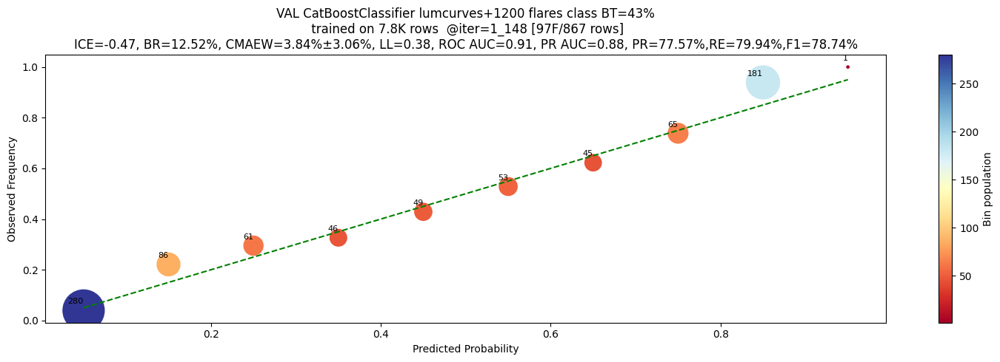

VAL CatBoostClassifier lumcurves+1200 flares class BT=43%
 trained on 7.8K rows  @iter=1_148
              precision    recall  f1-score   support

           0     0.8551    0.8366    0.8458       508
           1     0.7757    0.7994    0.7874       359

    accuracy                         0.8212       867
   macro avg     0.8154    0.8180    0.8166       867
weighted avg     0.8222    0.8212    0.8216       867

ROC AUCs: 1=0.9053
PR AUCs: 1=0.8829
CALIBRATIONs: 
	1: MAEW=3.84%, STD=3.06%, COV=90%
BRIER LOSSes: 
	1=12.5239%
LOG_LOSSes: 
	1=0.3847
ICEs: 
	1=-0.4697
TOTAL INTEGRAL ERROR: -0.4697


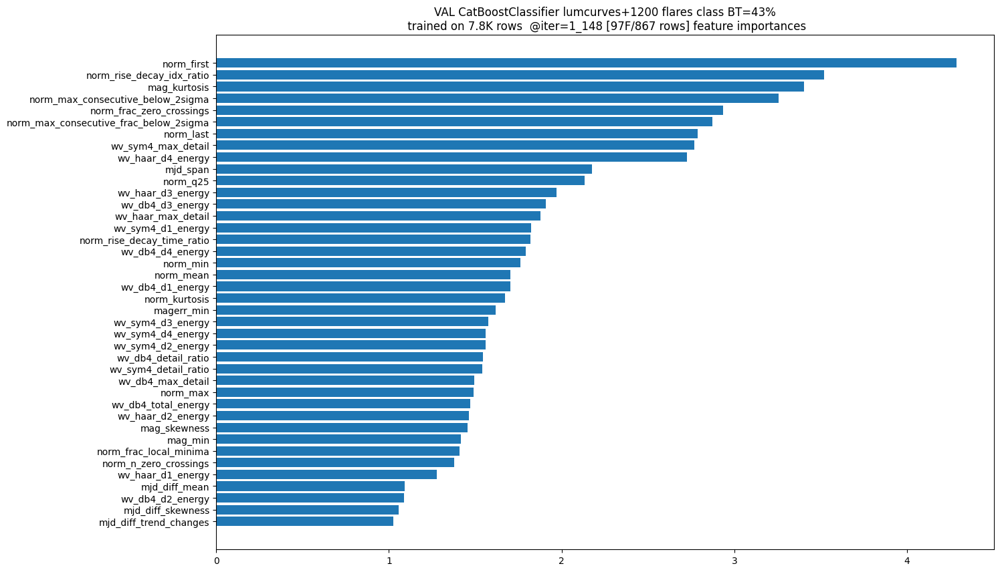

2026-01-13 00:36:07,115 - INFO - process_model-line:478 - Finished training, took 3.0 min. RAM usage 0.0GBs...
2026-01-13 00:36:07,205 - INFO - save_mlframe_model-line:55 - Model saved successfully to data\models\lumcurves1200\flares\binary_classification\class\cb.dump. Size: 0.32 Mb


weighting schema:   0%|          | 0/1 [00:00<?, ?it/s]

2026-01-13 00:36:09,398 - INFO - process_model-line:453 - Starting train_and_evaluate XGBClassifier on binary_classification lumcurves+1200 flares class BT=43%, RAM usage 0.0GBs...
2026-01-13 00:36:13,263 - INFO - train_and_evaluate_model-line:1311 - training dataset shape: (7801, 97)
2026-01-13 00:36:14,864 - INFO - train_and_evaluate_model-line:1327 - Training the model...
2026-01-13 00:36:23,800 - INFO - _train_model_with_fallback-line:693 - es_best_iter: 184
2026-01-13 00:36:23,807 - INFO - train_and_evaluate_model-line:1377 - Computing model's performance...


es_best_iter: 184


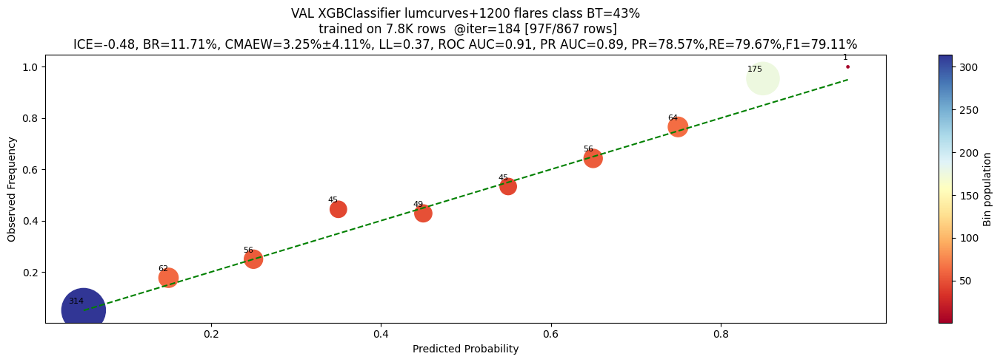

VAL XGBClassifier lumcurves+1200 flares class BT=43%
 trained on 7.8K rows  @iter=184
              precision    recall  f1-score   support

           0     0.8549    0.8465    0.8506       508
           1     0.7857    0.7967    0.7911       359

    accuracy                         0.8258       867
   macro avg     0.8203    0.8216    0.8209       867
weighted avg     0.8262    0.8258    0.8260       867

ROC AUCs: 1=0.9140
PR AUCs: 1=0.8941
CALIBRATIONs: 
	1: MAEW=3.25%, STD=4.11%, COV=90%
BRIER LOSSes: 
	1=11.7090%
LOG_LOSSes: 
	1=0.3669
ICEs: 
	1=-0.4837
TOTAL INTEGRAL ERROR: -0.4837


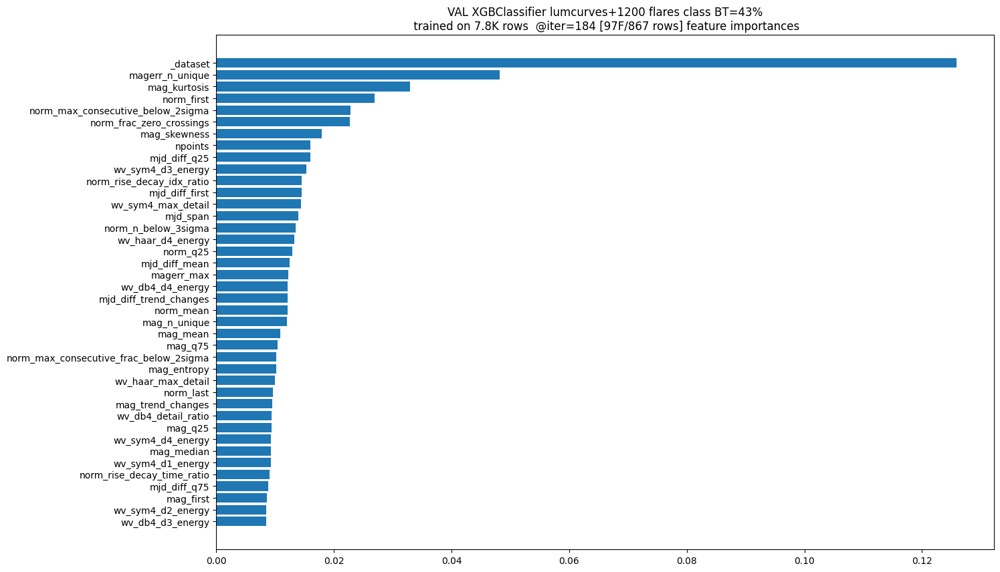

2026-01-13 00:36:28,600 - INFO - process_model-line:478 - Finished training, took 0.3 min. RAM usage 0.0GBs...
2026-01-13 00:36:28,753 - INFO - save_mlframe_model-line:55 - Model saved successfully to data\models\lumcurves1200\flares\binary_classification\class\xgb.dump. Size: 0.58 Mb


weighting schema:   0%|          | 0/1 [00:00<?, ?it/s]

2026-01-13 00:36:30,561 - INFO - process_model-line:453 - Starting train_and_evaluate LGBMClassifier on binary_classification lumcurves+1200 flares class BT=43%, RAM usage 0.0GBs...
2026-01-13 00:36:33,747 - INFO - train_and_evaluate_model-line:1311 - training dataset shape: (7801, 97)
2026-01-13 00:36:35,877 - INFO - train_and_evaluate_model-line:1327 - Training the model...
2026-01-13 00:36:42,021 - INFO - _train_model_with_fallback-line:693 - es_best_iter: 366
2026-01-13 00:36:42,027 - INFO - train_and_evaluate_model-line:1377 - Computing model's performance...


es_best_iter: 366


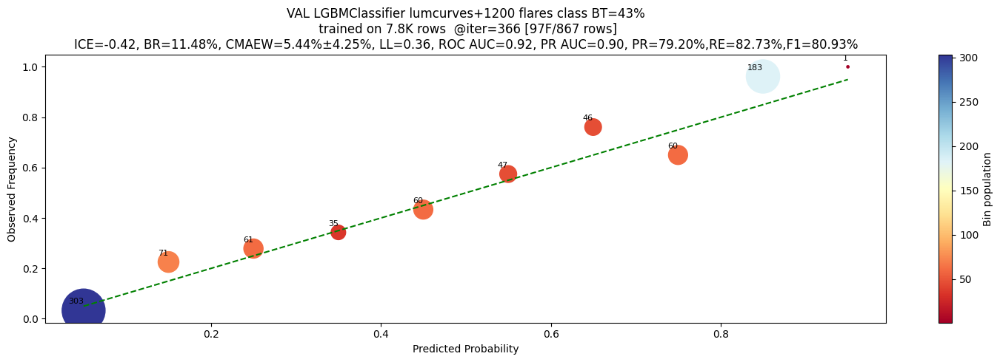

VAL LGBMClassifier lumcurves+1200 flares class BT=43%
 trained on 7.8K rows  @iter=366
              precision    recall  f1-score   support

           0     0.8740    0.8465    0.8600       508
           1     0.7920    0.8273    0.8093       359

    accuracy                         0.8385       867
   macro avg     0.8330    0.8369    0.8346       867
weighted avg     0.8400    0.8385    0.8390       867

ROC AUCs: 1=0.9189
PR AUCs: 1=0.8973
CALIBRATIONs: 
	1: MAEW=5.44%, STD=4.25%, COV=100%
BRIER LOSSes: 
	1=11.4831%
LOG_LOSSes: 
	1=0.3559
ICEs: 
	1=-0.4239
TOTAL INTEGRAL ERROR: -0.4239


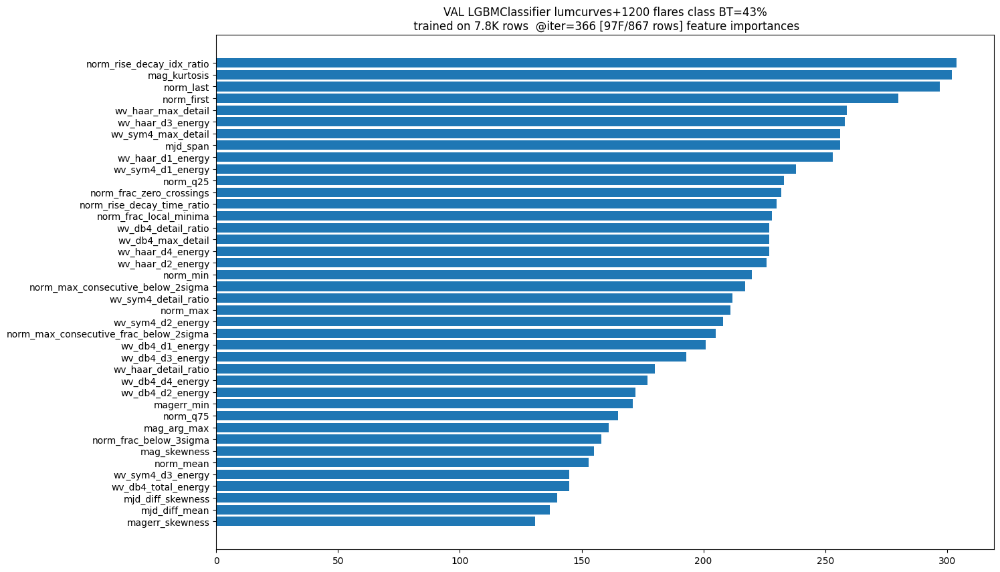

2026-01-13 00:36:45,718 - INFO - process_model-line:478 - Finished training, took 0.3 min. RAM usage 0.0GBs...
2026-01-13 00:36:45,927 - INFO - save_mlframe_model-line:55 - Model saved successfully to data\models\lumcurves1200\flares\binary_classification\class\lgb.dump. Size: 0.55 Mb


weighting schema:   0%|          | 0/1 [00:00<?, ?it/s]

2026-01-13 00:36:47,647 - INFO - process_model-line:453 - Starting train_and_evaluate NGBClassifier on binary_classification lumcurves+1200 flares class BT=43%, RAM usage 0.0GBs...
2026-01-13 00:36:49,247 - INFO - _apply_pre_pipeline_transforms-line:476 - Fitting & transforming train_df via pre_pipeline Pipeline(steps=[('imp', SimpleImputer()), ('scaler', StandardScaler())])...
2026-01-13 00:36:49,306 - INFO - log_ram_usage-line:39 - Done. RAM usage: 0.0GB.
2026-01-13 00:36:49,309 - INFO - _apply_pre_pipeline_transforms-line:482 - Transforming val_df via pre_pipeline Pipeline(steps=[('imp', SimpleImputer()), ('scaler', StandardScaler())])...
2026-01-13 00:36:49,323 - INFO - log_ram_usage-line:39 - Done. RAM usage: 0.0GB.
2026-01-13 00:36:52,490 - INFO - train_and_evaluate_model-line:1311 - training dataset shape: (7801, 97)
2026-01-13 00:36:54,069 - INFO - train_and_evaluate_model-line:1327 - Training the model...


[iter 0] loss=0.6834 val_loss=0.6347 scale=2.0000 norm=4.0000
[iter 100] loss=0.4644 val_loss=0.4820 scale=0.0010 norm=0.0017
[iter 200] loss=0.4644 val_loss=0.4820 scale=0.0010 norm=0.0017
[iter 300] loss=0.4644 val_loss=0.4821 scale=0.0010 norm=0.0017
[iter 400] loss=0.4644 val_loss=0.4821 scale=0.0010 norm=0.0017
[iter 500] loss=0.4644 val_loss=0.4821 scale=0.0010 norm=0.0017
== Early stopping achieved.
== Best iteration / VAL57 (val_loss=0.4817)


2026-01-13 00:39:55,529 - INFO - train_and_evaluate_model-line:1377 - Computing model's performance...


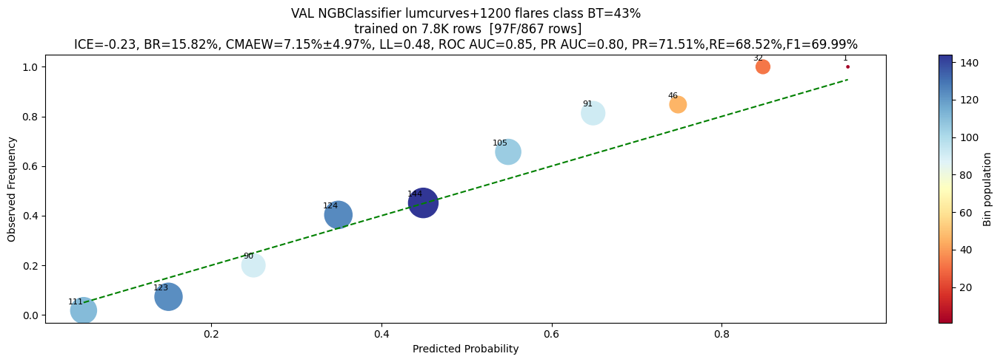

2026-01-13 00:39:56,724 - WARNING - plot_model_feature_importances-line:736 - Could not plot feature importances: index 25 is out of bounds for axis 0 with size 1. Maybe data shape is changed within a pipeline?


VAL NGBClassifier lumcurves+1200 flares class BT=43%
 trained on 7.8K rows 
              precision    recall  f1-score   support

           0     0.7839    0.8071    0.7953       508
           1     0.7151    0.6852    0.6999       359

    accuracy                         0.7566       867
   macro avg     0.7495    0.7462    0.7476       867
weighted avg     0.7554    0.7566    0.7558       867

ROC AUCs: 1=0.8497
PR AUCs: 1=0.7989
CALIBRATIONs: 
	1: MAEW=7.15%, STD=4.97%, COV=100%
BRIER LOSSes: 
	1=15.8187%
LOG_LOSSes: 
	1=0.4821
ICEs: 
	1=-0.2273
TOTAL INTEGRAL ERROR: -0.2273


2026-01-13 00:39:58,302 - INFO - process_model-line:478 - Finished training, took 3.2 min. RAM usage 0.0GBs...
2026-01-13 00:39:59,058 - INFO - save_mlframe_model-line:55 - Model saved successfully to data\models\lumcurves1200\flares\binary_classification\class\ngb.dump. Size: 0.15 Mb


weighting schema:   0%|          | 0/1 [00:00<?, ?it/s]

2026-01-13 00:40:00,814 - INFO - process_model-line:453 - Starting train_and_evaluate HistGradientBoostingClassifier on binary_classification lumcurves+1200 flares class BT=43%, RAM usage 0.0GBs...
2026-01-13 00:40:04,590 - INFO - train_and_evaluate_model-line:1311 - training dataset shape: (7801, 97)
2026-01-13 00:40:06,176 - INFO - train_and_evaluate_model-line:1327 - Training the model...
2026-01-13 00:40:15,792 - INFO - train_and_evaluate_model-line:1377 - Computing model's performance...


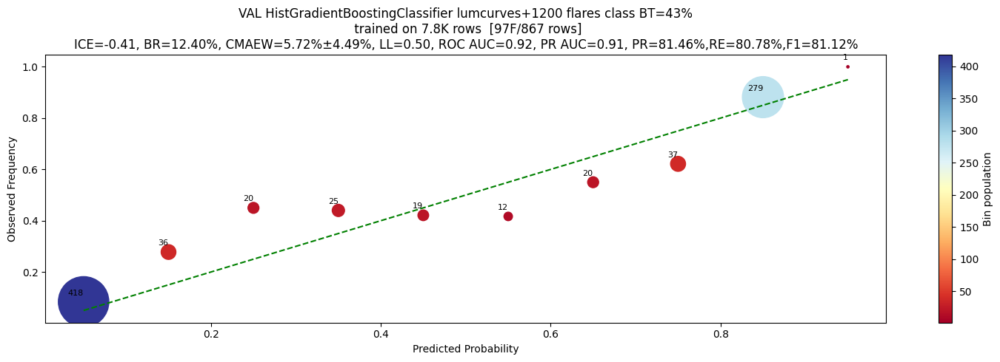

VAL HistGradientBoostingClassifier lumcurves+1200 flares class BT=43%
 trained on 7.8K rows 
              precision    recall  f1-score   support

           0     0.8650    0.8701    0.8675       508
           1     0.8146    0.8078    0.8112       359

    accuracy                         0.8443       867
   macro avg     0.8398    0.8389    0.8394       867
weighted avg     0.8441    0.8443    0.8442       867

ROC AUCs: 1=0.9231
PR AUCs: 1=0.9058
CALIBRATIONs: 
	1: MAEW=5.72%, STD=4.49%, COV=90%
BRIER LOSSes: 
	1=12.4043%
LOG_LOSSes: 
	1=0.5007
ICEs: 
	1=-0.4141
TOTAL INTEGRAL ERROR: -0.4141


2026-01-13 00:40:19,318 - INFO - process_model-line:478 - Finished training, took 0.3 min. RAM usage 0.0GBs...
2026-01-13 00:40:20,142 - INFO - save_mlframe_model-line:55 - Model saved successfully to data\models\lumcurves1200\flares\binary_classification\class\hgb.dump. Size: 0.97 Mb


weighting schema:   0%|          | 0/1 [00:00<?, ?it/s]

2026-01-13 00:40:22,093 - INFO - process_model-line:453 - Starting train_and_evaluate LogisticRegression on binary_classification lumcurves+1200 flares class BT=43%, RAM usage 0.0GBs...
2026-01-13 00:40:23,691 - INFO - _apply_pre_pipeline_transforms-line:462 - Using pre-fitted pipeline (transform only): Pipeline(steps=[('imp', SimpleImputer()), ('scaler', StandardScaler())])
2026-01-13 00:40:23,752 - INFO - log_ram_usage-line:39 - Done. RAM usage: 0.0GB.
2026-01-13 00:40:23,755 - INFO - _apply_pre_pipeline_transforms-line:470 - Transforming val_df via pre_pipeline...
2026-01-13 00:40:23,768 - INFO - log_ram_usage-line:39 - Done. RAM usage: 0.0GB.
2026-01-13 00:40:26,971 - INFO - train_and_evaluate_model-line:1311 - training dataset shape: (7801, 97)
2026-01-13 00:40:28,553 - INFO - train_and_evaluate_model-line:1327 - Training the model...
2026-01-13 00:40:31,072 - INFO - train_and_evaluate_model-line:1377 - Computing model's performance...


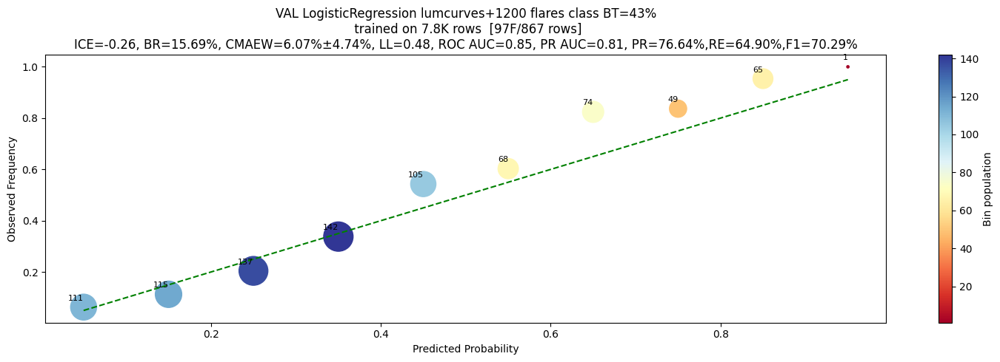

VAL LogisticRegression lumcurves+1200 flares class BT=43%
 trained on 7.8K rows 
              precision    recall  f1-score   support

           0     0.7762    0.8602    0.8161       508
           1     0.7664    0.6490    0.7029       359

    accuracy                         0.7728       867
   macro avg     0.7713    0.7546    0.7595       867
weighted avg     0.7722    0.7728    0.7692       867

ROC AUCs: 1=0.8474
PR AUCs: 1=0.8116
CALIBRATIONs: 
	1: MAEW=6.07%, STD=4.74%, COV=100%
BRIER LOSSes: 
	1=15.6908%
LOG_LOSSes: 
	1=0.4843
ICEs: 
	1=-0.2626
TOTAL INTEGRAL ERROR: -0.2626


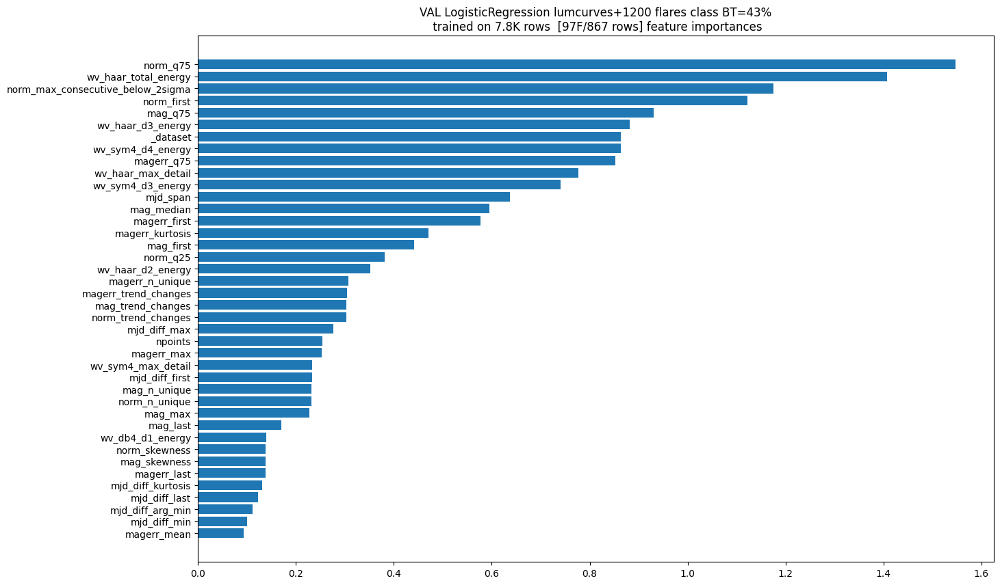

2026-01-13 00:40:34,695 - INFO - process_model-line:478 - Finished training, took 0.2 min. RAM usage 0.0GBs...
2026-01-13 00:40:34,744 - INFO - save_mlframe_model-line:55 - Model saved successfully to data\models\lumcurves1200\flares\binary_classification\class\linear.dump. Size: 0.02 Mb


weighting schema:   0%|          | 0/1 [00:00<?, ?it/s]

2026-01-13 00:40:36,527 - INFO - process_model-line:453 - Starting train_and_evaluate PytorchLightningClassifier on binary_classification lumcurves+1200 flares class BT=43%, RAM usage 0.0GBs...
2026-01-13 00:40:38,123 - INFO - _apply_pre_pipeline_transforms-line:435 - Skipping pre_pipeline fit/transform (using cached DFs)
2026-01-13 00:40:42,059 - INFO - train_and_evaluate_model-line:1311 - training dataset shape: (7801, 97)
2026-01-13 00:40:43,643 - INFO - train_and_evaluate_model-line:1327 - Training the model...
2026-01-13 00:40:43,664 - INFO - generate_mlp-line:1355 - Network architecture: 97->100->66->44->29->19->13->8->5->3->2->2 [C, n=388, w=22.5k]
2026-01-13 00:40:43,670 - INFO - generate_mlp-line:1400 - Applied kaiming_normal_ initialization to Linear weights; normal_/constant_ for BatchNorm weights/biases and Linear biases
2026-01-13 00:40:43,675 - INFO - __init__-line:1090 - Initialized BestEpochModelCheckpoint with monitor=val_ICE, mode=min
2026-01-13 00:40:43,677 - INFO - 

Sanity Checking: |                                                                               | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:441: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
2026-01-13 00:40:44,442 - INFO - on_validation_end-line:1115 - New best model at epoch 0 with val_ICE=0.5487
R:\ProgramData\anaconda3\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
R:\ProgramData\anaconda3\Lib\site-packages\lightning\pytorch\loops\fit_loop.py:298: The number of training batches (8) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |                                                                                      | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:40:45,029 - INFO - on_validation_end-line:1115 - New best model at epoch 0 with val_ICE=0.4218
INFO: Metric val_ICE improved. New best score: 0.422
2026-01-13 00:40:45,042 - INFO - _log_info-line:273 - Metric val_ICE improved. New best score: 0.422


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:40:47,791 - INFO - on_validation_end-line:1115 - New best model at epoch 9 with val_ICE=0.4183
INFO: Metric val_ICE improved by 0.003 >= min_delta = 0.001. New best score: 0.418
2026-01-13 00:40:47,799 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.003 >= min_delta = 0.001. New best score: 0.418


Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:40:48,285 - INFO - on_validation_end-line:1115 - New best model at epoch 10 with val_ICE=0.4114
INFO: Metric val_ICE improved by 0.007 >= min_delta = 0.001. New best score: 0.411
2026-01-13 00:40:48,295 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.007 >= min_delta = 0.001. New best score: 0.411


Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:40:48,708 - INFO - on_validation_end-line:1115 - New best model at epoch 11 with val_ICE=0.4004
INFO: Metric val_ICE improved by 0.011 >= min_delta = 0.001. New best score: 0.400
2026-01-13 00:40:48,718 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.011 >= min_delta = 0.001. New best score: 0.400


Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:40:49,187 - INFO - on_validation_end-line:1115 - New best model at epoch 12 with val_ICE=0.3956
INFO: Metric val_ICE improved by 0.005 >= min_delta = 0.001. New best score: 0.396
2026-01-13 00:40:49,200 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.005 >= min_delta = 0.001. New best score: 0.396


Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:40:49,663 - INFO - on_validation_end-line:1115 - New best model at epoch 13 with val_ICE=0.3893
INFO: Metric val_ICE improved by 0.006 >= min_delta = 0.001. New best score: 0.389
2026-01-13 00:40:49,672 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.006 >= min_delta = 0.001. New best score: 0.389


Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:40:50,091 - INFO - on_validation_end-line:1115 - New best model at epoch 14 with val_ICE=0.3812
INFO: Metric val_ICE improved by 0.008 >= min_delta = 0.001. New best score: 0.381
2026-01-13 00:40:50,102 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.008 >= min_delta = 0.001. New best score: 0.381


Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:40:50,522 - INFO - on_validation_end-line:1115 - New best model at epoch 15 with val_ICE=0.3634
INFO: Metric val_ICE improved by 0.018 >= min_delta = 0.001. New best score: 0.363
2026-01-13 00:40:50,530 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.018 >= min_delta = 0.001. New best score: 0.363


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:40:51,991 - INFO - on_validation_end-line:1115 - New best model at epoch 19 with val_ICE=0.3444
INFO: Metric val_ICE improved by 0.019 >= min_delta = 0.001. New best score: 0.344
2026-01-13 00:40:51,999 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.019 >= min_delta = 0.001. New best score: 0.344


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:40:54,358 - INFO - on_validation_end-line:1115 - New best model at epoch 26 with val_ICE=0.3390
INFO: Metric val_ICE improved by 0.005 >= min_delta = 0.001. New best score: 0.339
2026-01-13 00:40:54,366 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.005 >= min_delta = 0.001. New best score: 0.339


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:40:58,293 - INFO - on_validation_end-line:1115 - New best model at epoch 40 with val_ICE=0.3353
INFO: Metric val_ICE improved by 0.004 >= min_delta = 0.001. New best score: 0.335
2026-01-13 00:40:58,301 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.004 >= min_delta = 0.001. New best score: 0.335


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:40:59,701 - INFO - on_validation_end-line:1115 - New best model at epoch 45 with val_ICE=0.3298
INFO: Metric val_ICE improved by 0.005 >= min_delta = 0.001. New best score: 0.330
2026-01-13 00:40:59,709 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.005 >= min_delta = 0.001. New best score: 0.330


Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:00,119 - INFO - on_validation_end-line:1115 - New best model at epoch 46 with val_ICE=0.3104
INFO: Metric val_ICE improved by 0.019 >= min_delta = 0.001. New best score: 0.310
2026-01-13 00:41:00,130 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.019 >= min_delta = 0.001. New best score: 0.310


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:00,995 - INFO - on_validation_end-line:1115 - New best model at epoch 48 with val_ICE=0.2944
INFO: Metric val_ICE improved by 0.016 >= min_delta = 0.001. New best score: 0.294
2026-01-13 00:41:01,004 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.016 >= min_delta = 0.001. New best score: 0.294


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:01,694 - INFO - on_validation_end-line:1115 - New best model at epoch 50 with val_ICE=0.2743
INFO: Metric val_ICE improved by 0.020 >= min_delta = 0.001. New best score: 0.274
2026-01-13 00:41:01,704 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.020 >= min_delta = 0.001. New best score: 0.274


Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:02,072 - INFO - on_validation_end-line:1115 - New best model at epoch 51 with val_ICE=0.2720
INFO: Metric val_ICE improved by 0.002 >= min_delta = 0.001. New best score: 0.272
2026-01-13 00:41:02,079 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.002 >= min_delta = 0.001. New best score: 0.272


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:02,716 - INFO - on_validation_end-line:1115 - New best model at epoch 53 with val_ICE=0.2681
INFO: Metric val_ICE improved by 0.004 >= min_delta = 0.001. New best score: 0.268
2026-01-13 00:41:02,726 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.004 >= min_delta = 0.001. New best score: 0.268


Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:03,177 - INFO - on_validation_end-line:1115 - New best model at epoch 54 with val_ICE=0.2666
INFO: Metric val_ICE improved by 0.002 >= min_delta = 0.001. New best score: 0.267
2026-01-13 00:41:03,186 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.002 >= min_delta = 0.001. New best score: 0.267


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:06,055 - INFO - on_validation_end-line:1115 - New best model at epoch 63 with val_ICE=0.2620
INFO: Metric val_ICE improved by 0.005 >= min_delta = 0.001. New best score: 0.262
2026-01-13 00:41:06,064 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.005 >= min_delta = 0.001. New best score: 0.262


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:06,815 - INFO - on_validation_end-line:1115 - New best model at epoch 65 with val_ICE=0.2521
INFO: Metric val_ICE improved by 0.010 >= min_delta = 0.001. New best score: 0.252
2026-01-13 00:41:06,826 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.010 >= min_delta = 0.001. New best score: 0.252


Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:07,329 - INFO - on_validation_end-line:1115 - New best model at epoch 66 with val_ICE=0.2500
INFO: Metric val_ICE improved by 0.002 >= min_delta = 0.001. New best score: 0.250
2026-01-13 00:41:07,341 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.002 >= min_delta = 0.001. New best score: 0.250


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:08,541 - INFO - on_validation_end-line:1115 - New best model at epoch 69 with val_ICE=0.2392
INFO: Metric val_ICE improved by 0.011 >= min_delta = 0.001. New best score: 0.239
2026-01-13 00:41:08,552 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.011 >= min_delta = 0.001. New best score: 0.239


Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:09,029 - INFO - on_validation_end-line:1115 - New best model at epoch 70 with val_ICE=0.2351
INFO: Metric val_ICE improved by 0.004 >= min_delta = 0.001. New best score: 0.235
2026-01-13 00:41:09,040 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.004 >= min_delta = 0.001. New best score: 0.235


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:09,741 - INFO - on_validation_end-line:1115 - New best model at epoch 72 with val_ICE=0.2268
INFO: Metric val_ICE improved by 0.008 >= min_delta = 0.001. New best score: 0.227
2026-01-13 00:41:09,750 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.008 >= min_delta = 0.001. New best score: 0.227


Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:10,139 - INFO - on_validation_end-line:1115 - New best model at epoch 73 with val_ICE=0.2022
INFO: Metric val_ICE improved by 0.025 >= min_delta = 0.001. New best score: 0.202
2026-01-13 00:41:10,147 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.025 >= min_delta = 0.001. New best score: 0.202


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:10,854 - INFO - on_validation_end-line:1115 - New best model at epoch 75 with val_ICE=0.1951
INFO: Metric val_ICE improved by 0.007 >= min_delta = 0.001. New best score: 0.195
2026-01-13 00:41:10,862 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.007 >= min_delta = 0.001. New best score: 0.195


Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:11,362 - INFO - on_validation_end-line:1115 - New best model at epoch 76 with val_ICE=0.1626
INFO: Metric val_ICE improved by 0.032 >= min_delta = 0.001. New best score: 0.163
2026-01-13 00:41:11,376 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.032 >= min_delta = 0.001. New best score: 0.163


Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:11,966 - INFO - on_validation_end-line:1115 - New best model at epoch 77 with val_ICE=0.1512
INFO: Metric val_ICE improved by 0.011 >= min_delta = 0.001. New best score: 0.151
2026-01-13 00:41:11,980 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.011 >= min_delta = 0.001. New best score: 0.151


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:14,373 - INFO - on_validation_end-line:1115 - New best model at epoch 85 with val_ICE=0.1345
INFO: Metric val_ICE improved by 0.017 >= min_delta = 0.001. New best score: 0.135
2026-01-13 00:41:14,381 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.017 >= min_delta = 0.001. New best score: 0.135


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:15,051 - INFO - on_validation_end-line:1115 - New best model at epoch 87 with val_ICE=0.1237
INFO: Metric val_ICE improved by 0.011 >= min_delta = 0.001. New best score: 0.124
2026-01-13 00:41:15,061 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.011 >= min_delta = 0.001. New best score: 0.124


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:15,739 - INFO - on_validation_end-line:1115 - New best model at epoch 89 with val_ICE=0.1146
INFO: Metric val_ICE improved by 0.009 >= min_delta = 0.001. New best score: 0.115
2026-01-13 00:41:15,747 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.009 >= min_delta = 0.001. New best score: 0.115


Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:16,201 - INFO - on_validation_end-line:1115 - New best model at epoch 90 with val_ICE=0.1092
INFO: Metric val_ICE improved by 0.005 >= min_delta = 0.001. New best score: 0.109
2026-01-13 00:41:16,209 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.005 >= min_delta = 0.001. New best score: 0.109


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:17,164 - INFO - on_validation_end-line:1115 - New best model at epoch 93 with val_ICE=0.1074
INFO: Metric val_ICE improved by 0.002 >= min_delta = 0.001. New best score: 0.107
2026-01-13 00:41:17,171 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.002 >= min_delta = 0.001. New best score: 0.107


Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:17,508 - INFO - on_validation_end-line:1115 - New best model at epoch 94 with val_ICE=0.0833
INFO: Metric val_ICE improved by 0.024 >= min_delta = 0.001. New best score: 0.083
2026-01-13 00:41:17,516 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.024 >= min_delta = 0.001. New best score: 0.083


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:19,210 - INFO - on_validation_end-line:1115 - New best model at epoch 100 with val_ICE=0.0548
INFO: Metric val_ICE improved by 0.029 >= min_delta = 0.001. New best score: 0.055
2026-01-13 00:41:19,221 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.029 >= min_delta = 0.001. New best score: 0.055


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:20,090 - INFO - on_validation_end-line:1115 - New best model at epoch 103 with val_ICE=0.0428
INFO: Metric val_ICE improved by 0.012 >= min_delta = 0.001. New best score: 0.043
2026-01-13 00:41:20,099 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.012 >= min_delta = 0.001. New best score: 0.043


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:21,262 - INFO - on_validation_end-line:1115 - New best model at epoch 106 with val_ICE=0.0421


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:22,581 - INFO - on_validation_end-line:1115 - New best model at epoch 110 with val_ICE=0.0207
INFO: Metric val_ICE improved by 0.022 >= min_delta = 0.001. New best score: 0.021
2026-01-13 00:41:22,591 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.022 >= min_delta = 0.001. New best score: 0.021


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:23,939 - INFO - on_validation_end-line:1115 - New best model at epoch 114 with val_ICE=-0.0108
INFO: Metric val_ICE improved by 0.031 >= min_delta = 0.001. New best score: -0.011
2026-01-13 00:41:23,947 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.031 >= min_delta = 0.001. New best score: -0.011


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:26,062 - INFO - on_validation_end-line:1115 - New best model at epoch 121 with val_ICE=-0.0181
INFO: Metric val_ICE improved by 0.007 >= min_delta = 0.001. New best score: -0.018
2026-01-13 00:41:26,069 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.007 >= min_delta = 0.001. New best score: -0.018


Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:26,412 - INFO - on_validation_end-line:1115 - New best model at epoch 122 with val_ICE=-0.0289
INFO: Metric val_ICE improved by 0.011 >= min_delta = 0.001. New best score: -0.029
2026-01-13 00:41:26,421 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.011 >= min_delta = 0.001. New best score: -0.029


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:29,267 - INFO - on_validation_end-line:1115 - New best model at epoch 131 with val_ICE=-0.0335
INFO: Metric val_ICE improved by 0.005 >= min_delta = 0.001. New best score: -0.034
2026-01-13 00:41:29,274 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.005 >= min_delta = 0.001. New best score: -0.034


Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:29,613 - INFO - on_validation_end-line:1115 - New best model at epoch 132 with val_ICE=-0.0507
INFO: Metric val_ICE improved by 0.017 >= min_delta = 0.001. New best score: -0.051
2026-01-13 00:41:29,620 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.017 >= min_delta = 0.001. New best score: -0.051


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:30,287 - INFO - on_validation_end-line:1115 - New best model at epoch 134 with val_ICE=-0.0763
INFO: Metric val_ICE improved by 0.026 >= min_delta = 0.001. New best score: -0.076
2026-01-13 00:41:30,296 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.026 >= min_delta = 0.001. New best score: -0.076


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:32,529 - INFO - on_validation_end-line:1115 - New best model at epoch 141 with val_ICE=-0.0801
INFO: Metric val_ICE improved by 0.004 >= min_delta = 0.001. New best score: -0.080
2026-01-13 00:41:32,536 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.004 >= min_delta = 0.001. New best score: -0.080


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:33,484 - INFO - on_validation_end-line:1115 - New best model at epoch 144 with val_ICE=-0.0840
INFO: Metric val_ICE improved by 0.004 >= min_delta = 0.001. New best score: -0.084
2026-01-13 00:41:33,494 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.004 >= min_delta = 0.001. New best score: -0.084


Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:33,935 - INFO - on_validation_end-line:1115 - New best model at epoch 145 with val_ICE=-0.0955
INFO: Metric val_ICE improved by 0.012 >= min_delta = 0.001. New best score: -0.096
2026-01-13 00:41:33,942 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.012 >= min_delta = 0.001. New best score: -0.096


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:37,659 - INFO - on_validation_end-line:1115 - New best model at epoch 158 with val_ICE=-0.1110
INFO: Metric val_ICE improved by 0.016 >= min_delta = 0.001. New best score: -0.111
2026-01-13 00:41:37,667 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.016 >= min_delta = 0.001. New best score: -0.111


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:38,800 - INFO - on_validation_end-line:1115 - New best model at epoch 162 with val_ICE=-0.1127
INFO: Metric val_ICE improved by 0.002 >= min_delta = 0.001. New best score: -0.113
2026-01-13 00:41:38,808 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.002 >= min_delta = 0.001. New best score: -0.113


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:39,691 - INFO - on_validation_end-line:1115 - New best model at epoch 165 with val_ICE=-0.1161
INFO: Metric val_ICE improved by 0.003 >= min_delta = 0.001. New best score: -0.116
2026-01-13 00:41:39,699 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.003 >= min_delta = 0.001. New best score: -0.116


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:40,328 - INFO - on_validation_end-line:1115 - New best model at epoch 167 with val_ICE=-0.1266
INFO: Metric val_ICE improved by 0.010 >= min_delta = 0.001. New best score: -0.127
2026-01-13 00:41:40,337 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.010 >= min_delta = 0.001. New best score: -0.127


Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:40,710 - INFO - on_validation_end-line:1115 - New best model at epoch 168 with val_ICE=-0.1338
INFO: Metric val_ICE improved by 0.007 >= min_delta = 0.001. New best score: -0.134
2026-01-13 00:41:40,722 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.007 >= min_delta = 0.001. New best score: -0.134


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:41,844 - INFO - on_validation_end-line:1115 - New best model at epoch 172 with val_ICE=-0.1445
INFO: Metric val_ICE improved by 0.011 >= min_delta = 0.001. New best score: -0.144
2026-01-13 00:41:41,852 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.011 >= min_delta = 0.001. New best score: -0.144


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:43,875 - INFO - on_validation_end-line:1115 - New best model at epoch 179 with val_ICE=-0.1512
INFO: Metric val_ICE improved by 0.007 >= min_delta = 0.001. New best score: -0.151
2026-01-13 00:41:43,882 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.007 >= min_delta = 0.001. New best score: -0.151


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:45,040 - INFO - on_validation_end-line:1115 - New best model at epoch 183 with val_ICE=-0.1821
INFO: Metric val_ICE improved by 0.031 >= min_delta = 0.001. New best score: -0.182
2026-01-13 00:41:45,048 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.031 >= min_delta = 0.001. New best score: -0.182


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:47,311 - INFO - on_validation_end-line:1115 - New best model at epoch 191 with val_ICE=-0.1834
INFO: Metric val_ICE improved by 0.001 >= min_delta = 0.001. New best score: -0.183
2026-01-13 00:41:47,319 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.001 >= min_delta = 0.001. New best score: -0.183


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:49,299 - INFO - on_validation_end-line:1115 - New best model at epoch 198 with val_ICE=-0.1987
INFO: Metric val_ICE improved by 0.015 >= min_delta = 0.001. New best score: -0.199
2026-01-13 00:41:49,307 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.015 >= min_delta = 0.001. New best score: -0.199


Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:49,769 - INFO - on_validation_end-line:1115 - New best model at epoch 199 with val_ICE=-0.2024
INFO: Metric val_ICE improved by 0.004 >= min_delta = 0.001. New best score: -0.202
2026-01-13 00:41:49,781 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.004 >= min_delta = 0.001. New best score: -0.202


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:58,834 - INFO - on_validation_end-line:1115 - New best model at epoch 232 with val_ICE=-0.2132
INFO: Metric val_ICE improved by 0.011 >= min_delta = 0.001. New best score: -0.213
2026-01-13 00:41:58,841 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.011 >= min_delta = 0.001. New best score: -0.213


Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:41:59,286 - INFO - on_validation_end-line:1115 - New best model at epoch 233 with val_ICE=-0.2297
INFO: Metric val_ICE improved by 0.017 >= min_delta = 0.001. New best score: -0.230
2026-01-13 00:41:59,296 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.017 >= min_delta = 0.001. New best score: -0.230


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:42:09,274 - INFO - on_validation_end-line:1115 - New best model at epoch 269 with val_ICE=-0.2302


Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:42:09,629 - INFO - on_validation_end-line:1115 - New best model at epoch 270 with val_ICE=-0.2469
INFO: Metric val_ICE improved by 0.017 >= min_delta = 0.001. New best score: -0.247
2026-01-13 00:42:09,638 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.017 >= min_delta = 0.001. New best score: -0.247


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:42:18,383 - INFO - on_validation_end-line:1115 - New best model at epoch 302 with val_ICE=-0.2584
INFO: Metric val_ICE improved by 0.012 >= min_delta = 0.001. New best score: -0.258
2026-01-13 00:42:18,392 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.012 >= min_delta = 0.001. New best score: -0.258


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:42:22,303 - INFO - on_validation_end-line:1115 - New best model at epoch 316 with val_ICE=-0.2734
INFO: Metric val_ICE improved by 0.015 >= min_delta = 0.001. New best score: -0.273
2026-01-13 00:42:22,311 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.015 >= min_delta = 0.001. New best score: -0.273


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:42:23,773 - INFO - on_validation_end-line:1115 - New best model at epoch 321 with val_ICE=-0.2875
INFO: Metric val_ICE improved by 0.014 >= min_delta = 0.001. New best score: -0.287
2026-01-13 00:42:23,780 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.014 >= min_delta = 0.001. New best score: -0.287


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:42:24,880 - INFO - on_validation_end-line:1115 - New best model at epoch 325 with val_ICE=-0.2883


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:42:29,403 - INFO - on_validation_end-line:1115 - New best model at epoch 341 with val_ICE=-0.3067
INFO: Metric val_ICE improved by 0.019 >= min_delta = 0.001. New best score: -0.307
2026-01-13 00:42:29,409 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.019 >= min_delta = 0.001. New best score: -0.307


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:42:31,367 - INFO - on_validation_end-line:1115 - New best model at epoch 348 with val_ICE=-0.3163
INFO: Metric val_ICE improved by 0.010 >= min_delta = 0.001. New best score: -0.316
2026-01-13 00:42:31,374 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.010 >= min_delta = 0.001. New best score: -0.316


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:42:36,159 - INFO - on_validation_end-line:1115 - New best model at epoch 362 with val_ICE=-0.3201
INFO: Metric val_ICE improved by 0.004 >= min_delta = 0.001. New best score: -0.320
2026-01-13 00:42:36,167 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.004 >= min_delta = 0.001. New best score: -0.320


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:42:38,079 - INFO - on_validation_end-line:1115 - New best model at epoch 369 with val_ICE=-0.3328
INFO: Metric val_ICE improved by 0.013 >= min_delta = 0.001. New best score: -0.333
2026-01-13 00:42:38,087 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.013 >= min_delta = 0.001. New best score: -0.333


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:42:41,370 - INFO - on_validation_end-line:1115 - New best model at epoch 381 with val_ICE=-0.3576
INFO: Metric val_ICE improved by 0.025 >= min_delta = 0.001. New best score: -0.358
2026-01-13 00:42:41,378 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.025 >= min_delta = 0.001. New best score: -0.358


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:42:43,068 - INFO - on_validation_end-line:1115 - New best model at epoch 387 with val_ICE=-0.3627
INFO: Metric val_ICE improved by 0.005 >= min_delta = 0.001. New best score: -0.363
2026-01-13 00:42:43,077 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.005 >= min_delta = 0.001. New best score: -0.363


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:42:44,375 - INFO - on_validation_end-line:1115 - New best model at epoch 391 with val_ICE=-0.3696
INFO: Metric val_ICE improved by 0.007 >= min_delta = 0.001. New best score: -0.370
2026-01-13 00:42:44,387 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.007 >= min_delta = 0.001. New best score: -0.370


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:42:49,140 - INFO - on_validation_end-line:1115 - New best model at epoch 408 with val_ICE=-0.4006
INFO: Metric val_ICE improved by 0.031 >= min_delta = 0.001. New best score: -0.401
2026-01-13 00:42:49,150 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.031 >= min_delta = 0.001. New best score: -0.401


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:42:58,072 - INFO - on_validation_end-line:1115 - New best model at epoch 441 with val_ICE=-0.4247
INFO: Metric val_ICE improved by 0.024 >= min_delta = 0.001. New best score: -0.425
2026-01-13 00:42:58,083 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.024 >= min_delta = 0.001. New best score: -0.425


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:43:13,476 - INFO - on_validation_end-line:1115 - New best model at epoch 497 with val_ICE=-0.4268
INFO: Metric val_ICE improved by 0.002 >= min_delta = 0.001. New best score: -0.427
2026-01-13 00:43:13,487 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.002 >= min_delta = 0.001. New best score: -0.427


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:43:26,347 - INFO - on_validation_end-line:1115 - New best model at epoch 545 with val_ICE=-0.4580
INFO: Metric val_ICE improved by 0.031 >= min_delta = 0.001. New best score: -0.458
2026-01-13 00:43:26,357 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.031 >= min_delta = 0.001. New best score: -0.458


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:43:49,521 - INFO - on_validation_end-line:1115 - New best model at epoch 630 with val_ICE=-0.4670
INFO: Metric val_ICE improved by 0.009 >= min_delta = 0.001. New best score: -0.467
2026-01-13 00:43:49,530 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.009 >= min_delta = 0.001. New best score: -0.467


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:43:53,123 - INFO - on_validation_end-line:1115 - New best model at epoch 643 with val_ICE=-0.4671


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:44:25,966 - INFO - on_validation_end-line:1115 - New best model at epoch 765 with val_ICE=-0.4868
INFO: Metric val_ICE improved by 0.020 >= min_delta = 0.001. New best score: -0.487
2026-01-13 00:44:25,974 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.020 >= min_delta = 0.001. New best score: -0.487


Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:44:26,326 - INFO - on_validation_end-line:1115 - New best model at epoch 766 with val_ICE=-0.5066
INFO: Metric val_ICE improved by 0.020 >= min_delta = 0.001. New best score: -0.507
2026-01-13 00:44:26,334 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.020 >= min_delta = 0.001. New best score: -0.507


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:44:38,670 - INFO - on_validation_end-line:1115 - New best model at epoch 810 with val_ICE=-0.5184
INFO: Metric val_ICE improved by 0.012 >= min_delta = 0.001. New best score: -0.518
2026-01-13 00:44:38,681 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.012 >= min_delta = 0.001. New best score: -0.518


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

2026-01-13 00:46:53,794 - INFO - on_validation_end-line:1115 - New best model at epoch 1308 with val_ICE=-0.5194
INFO: Metric val_ICE improved by 0.001 >= min_delta = 0.001. New best score: -0.519
2026-01-13 00:46:53,803 - INFO - _log_info-line:273 - Metric val_ICE improved by 0.001 >= min_delta = 0.001. New best score: -0.519


Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

INFO: Monitored metric val_ICE did not improve in the last 500 records. Best score: -0.519. Signaling Trainer to stop.
2026-01-13 00:49:11,796 - INFO - _log_info-line:273 - Monitored metric val_ICE did not improve in the last 500 records. Best score: -0.519. Signaling Trainer to stop.
2026-01-13 00:49:11,811 - INFO - on_train_end-line:1814 - Loading best model from S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\logs\model-val_ICE=-0.5194.ckpt (score: -0.5194)
2026-01-13 00:49:11,953 - INFO - on_train_end-line:1834 - Loaded weights from epoch 1308
2026-01-13 00:49:12,008 - INFO - _fit_common-line:322 - Best epoch recorded: 1308
2026-01-13 00:49:13,692 - INFO - _train_model_with_fallback-line:693 - es_best_iter: 1_308
2026-01-13 00:49:13,697 - INFO - train_and_evaluate_model-line:1377 - Computing model's performance...
2026-01-13 00:49:13,701 - WARNING - _predict_raw-line:419 - No datamodule found from training. Creating temporary datamodule for prediction.
2026-01-13 0

es_best_iter: 1_308


2026-01-13 00:49:14,183 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2026-01-13 00:49:14,187 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2026-01-13 00:49:14,191 - INFO - _info-line:64 - IPU available: False, using: 0 IPUs
2026-01-13 00:49:14,194 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
2026-01-13 00:49:14,200 - WARNING - _predict_raw-line:470 - Model was in training mode during prediction. Switching to eval mode.
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2026-01-13 00:49:14,211 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
R:\ProgramData\anaconda3\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:441: The 'predict_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
2026-01-13 00:49:14,357 - INFO - _predict_raw-line:506 - Generate

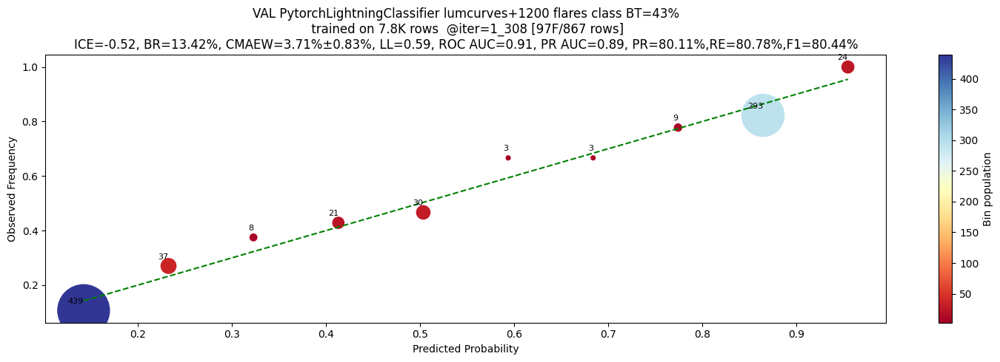

VAL PytorchLightningClassifier lumcurves+1200 flares class BT=43%
 trained on 7.8K rows  @iter=1_308
              precision    recall  f1-score   support

           0     0.8634    0.8583    0.8608       508
           1     0.8011    0.8078    0.8044       359

    accuracy                         0.8374       867
   macro avg     0.8322    0.8330    0.8326       867
weighted avg     0.8376    0.8374    0.8375       867

ROC AUCs: 1=0.9080
PR AUCs: 1=0.8925
CALIBRATIONs: 
	1: MAEW=3.71%, STD=0.83%, COV=100%
BRIER LOSSes: 
	1=13.4173%
LOG_LOSSes: 
	1=0.5940
ICEs: 
	1=-0.5194
TOTAL INTEGRAL ERROR: -0.5194


2026-01-13 00:49:17,651 - INFO - process_model-line:478 - Finished training, took 8.7 min. RAM usage 0.0GBs...
2026-01-13 00:49:17,914 - INFO - save_mlframe_model-line:55 - Model saved successfully to data\models\lumcurves1200\flares\binary_classification\class\mlp.dump. Size: 2.09 Mb
2026-01-13 00:49:19,917 - INFO - train_mlframe_models_suite-line:1276 - evaluating simple ensembles...


ens member 0 excluded due to high distance from the median, mae=0.067589, std=0.106103
ens member 1 excluded due to high distance from the median, mae=0.051010, std=0.081614
ens member 2 excluded due to high distance from the median, mae=0.049071, std=0.077706
ens member 3 excluded due to high distance from the median, mae=0.165514, std=0.135212
ens member 4 excluded due to high distance from the median, mae=0.105180, std=0.114117
ens member 5 excluded due to high distance from the median, mae=0.165362, std=0.149365
ens member 6 excluded due to high distance from the median, mae=0.142459, std=0.162325
ensemble_probabilistic_predictions filters too restrictive (7 vs 7), skipping them


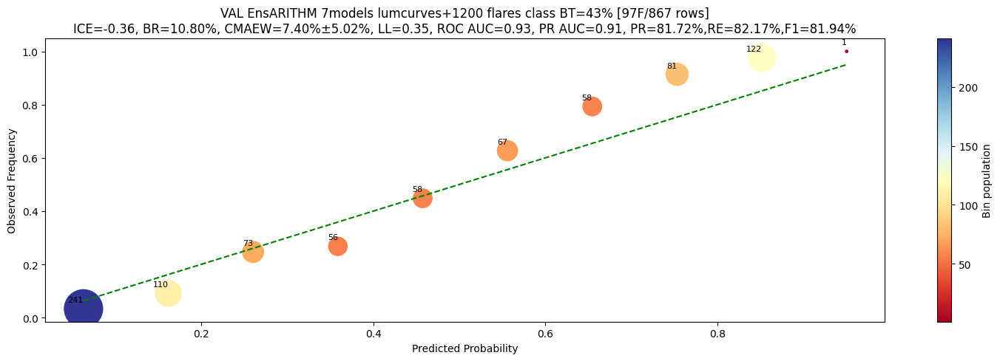

VAL EnsARITHM 7models lumcurves+1200 flares class BT=43%
              precision    recall  f1-score   support

           0     0.8735    0.8701    0.8718       508
           1     0.8172    0.8217    0.8194       359

    accuracy                         0.8501       867
   macro avg     0.8453    0.8459    0.8456       867
weighted avg     0.8502    0.8501    0.8501       867

ROC AUCs: 1=0.9253
PR AUCs: 1=0.9057
CALIBRATIONs: 
	1: MAEW=7.40%, STD=5.02%, COV=100%
BRIER LOSSes: 
	1=10.8041%
LOG_LOSSes: 
	1=0.3519
ICEs: 
	1=-0.3629
TOTAL INTEGRAL ERROR: -0.3629


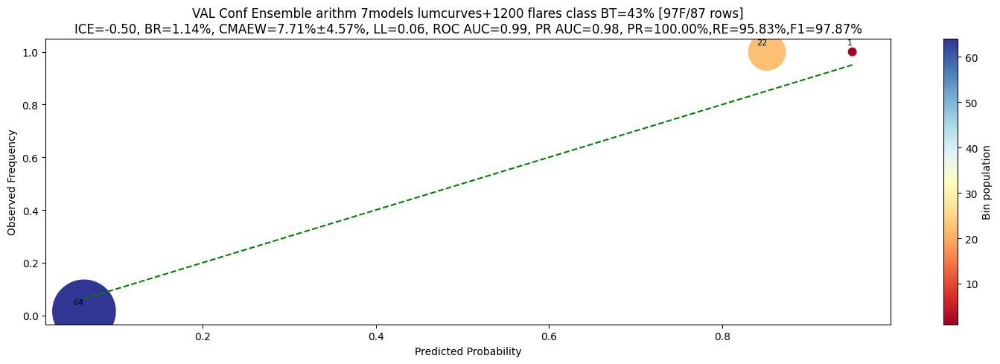

VAL Conf Ensemble arithm 7models lumcurves+1200 flares class BT=43%
              precision    recall  f1-score   support

           0     0.9844    1.0000    0.9921        63
           1     1.0000    0.9583    0.9787        24

    accuracy                         0.9885        87
   macro avg     0.9922    0.9792    0.9854        87
weighted avg     0.9887    0.9885    0.9884        87

ROC AUCs: 1=0.9881
PR AUCs: 1=0.9821
CALIBRATIONs: 
	1: MAEW=7.71%, STD=4.57%, COV=30%
BRIER LOSSes: 
	1=1.1423%
LOG_LOSSes: 
	1=0.0627
ICEs: 
	1=-0.5032
TOTAL INTEGRAL ERROR: -0.5032
ens member 0 excluded due to high distance from the median, mae=0.067589, std=0.106103
ens member 1 excluded due to high distance from the median, mae=0.051010, std=0.081614
ens member 2 excluded due to high distance from the median, mae=0.049071, std=0.077706
ens member 3 excluded due to high distance from the median, mae=0.165514, std=0.135212
ens member 4 excluded due to high distance from the median, mae=0.105180,

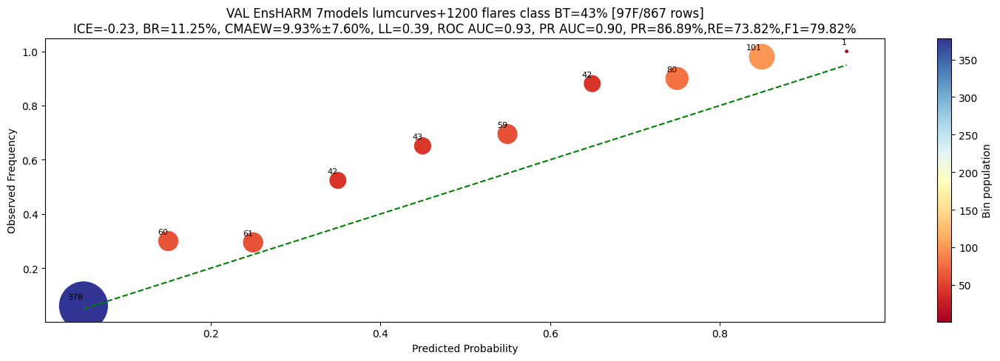

VAL EnsHARM 7models lumcurves+1200 flares class BT=43%
              precision    recall  f1-score   support

           0     0.8327    0.9213    0.8748       508
           1     0.8689    0.7382    0.7982       359

    accuracy                         0.8454       867
   macro avg     0.8508    0.8297    0.8365       867
weighted avg     0.8477    0.8454    0.8431       867

ROC AUCs: 1=0.9255
PR AUCs: 1=0.9032
CALIBRATIONs: 
	1: MAEW=9.93%, STD=7.60%, COV=100%
BRIER LOSSes: 
	1=11.2537%
LOG_LOSSes: 
	1=0.3915
ICEs: 
	1=-0.2339
TOTAL INTEGRAL ERROR: -0.2339


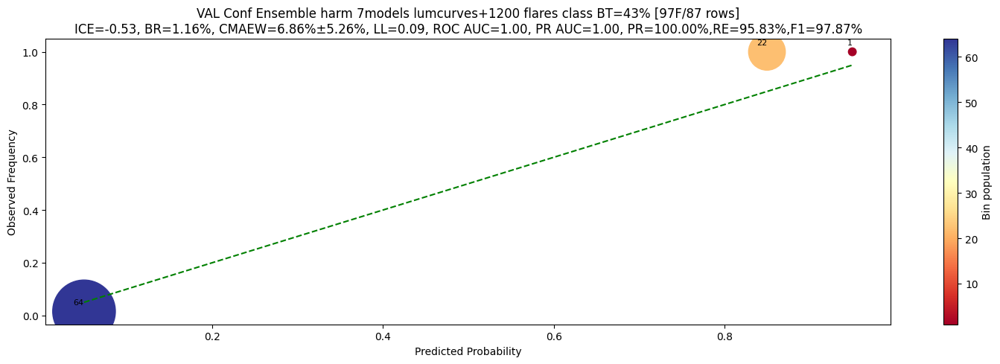

VAL Conf Ensemble harm 7models lumcurves+1200 flares class BT=43%
              precision    recall  f1-score   support

           0     0.9844    1.0000    0.9921        63
           1     1.0000    0.9583    0.9787        24

    accuracy                         0.9885        87
   macro avg     0.9922    0.9792    0.9854        87
weighted avg     0.9887    0.9885    0.9884        87

ROC AUCs: 1=0.9987
PR AUCs: 1=0.9968
CALIBRATIONs: 
	1: MAEW=6.86%, STD=5.26%, COV=30%
BRIER LOSSes: 
	1=1.1573%
LOG_LOSSes: 
	1=0.0914
ICEs: 
	1=-0.5323
TOTAL INTEGRAL ERROR: -0.5323
ens member 0 excluded due to high distance from the median, mae=0.067589, std=0.106103
ens member 1 excluded due to high distance from the median, mae=0.051010, std=0.081614
ens member 2 excluded due to high distance from the median, mae=0.049071, std=0.077706
ens member 3 excluded due to high distance from the median, mae=0.165514, std=0.135212
ens member 4 excluded due to high distance from the median, mae=0.105180, s

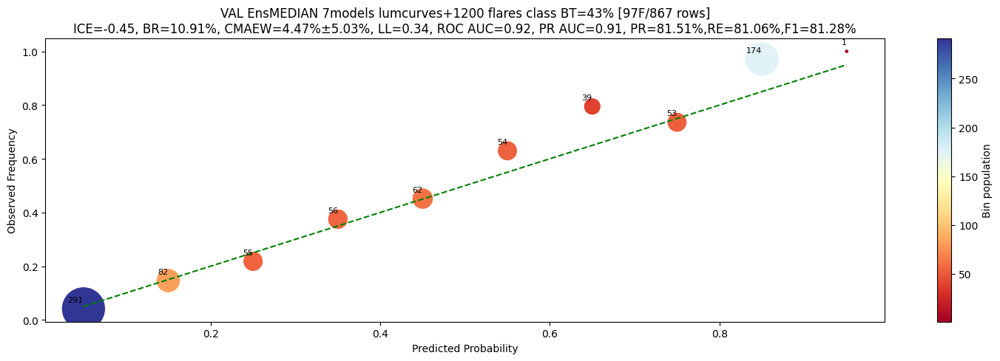

VAL EnsMEDIAN 7models lumcurves+1200 flares class BT=43%
              precision    recall  f1-score   support

           0     0.8667    0.8701    0.8684       508
           1     0.8151    0.8106    0.8128       359

    accuracy                         0.8454       867
   macro avg     0.8409    0.8403    0.8406       867
weighted avg     0.8453    0.8454    0.8454       867

ROC AUCs: 1=0.9233
PR AUCs: 1=0.9059
CALIBRATIONs: 
	1: MAEW=4.47%, STD=5.03%, COV=90%
BRIER LOSSes: 
	1=10.9101%
LOG_LOSSes: 
	1=0.3428
ICEs: 
	1=-0.4471
TOTAL INTEGRAL ERROR: -0.4471


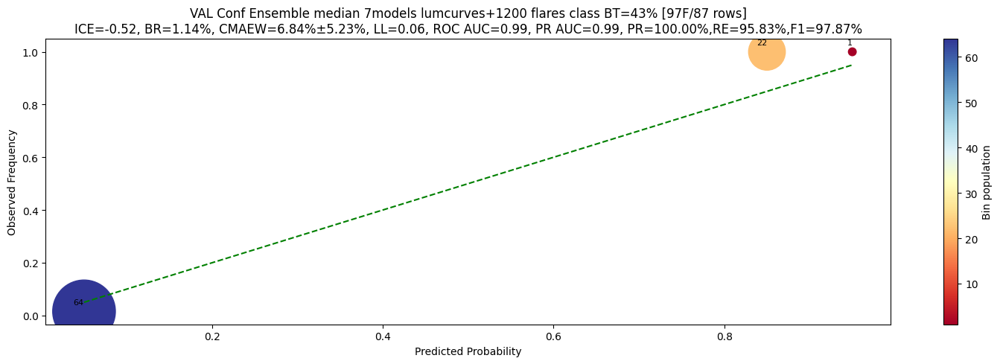

VAL Conf Ensemble median 7models lumcurves+1200 flares class BT=43%
              precision    recall  f1-score   support

           0     0.9844    1.0000    0.9921        63
           1     1.0000    0.9583    0.9787        24

    accuracy                         0.9885        87
   macro avg     0.9922    0.9792    0.9854        87
weighted avg     0.9887    0.9885    0.9884        87

ROC AUCs: 1=0.9914
PR AUCs: 1=0.9854
CALIBRATIONs: 
	1: MAEW=6.84%, STD=5.23%, COV=30%
BRIER LOSSes: 
	1=1.1433%
LOG_LOSSes: 
	1=0.0607
ICEs: 
	1=-0.5211
TOTAL INTEGRAL ERROR: -0.5211
ens member 0 excluded due to high distance from the median, mae=0.067589, std=0.106103
ens member 1 excluded due to high distance from the median, mae=0.051010, std=0.081614
ens member 2 excluded due to high distance from the median, mae=0.049071, std=0.077706
ens member 3 excluded due to high distance from the median, mae=0.165514, std=0.135212
ens member 4 excluded due to high distance from the median, mae=0.105180,

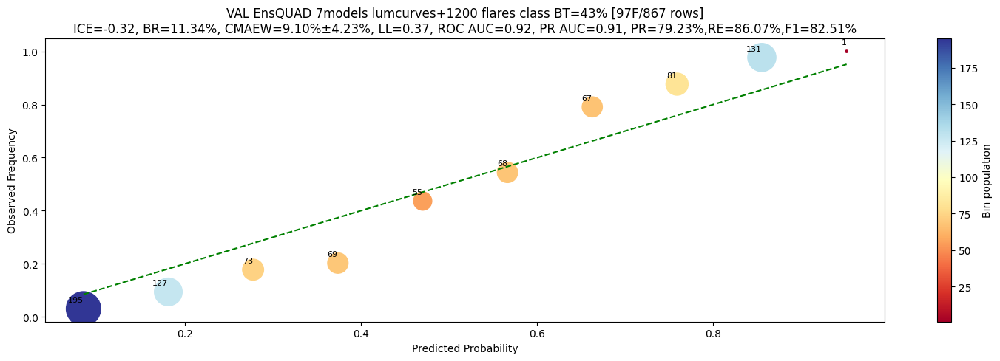

VAL EnsQUAD 7models lumcurves+1200 flares class BT=43%
              precision    recall  f1-score   support

           0     0.8952    0.8406    0.8670       508
           1     0.7923    0.8607    0.8251       359

    accuracy                         0.8489       867
   macro avg     0.8437    0.8506    0.8461       867
weighted avg     0.8526    0.8489    0.8497       867

ROC AUCs: 1=0.9231
PR AUCs: 1=0.9050
CALIBRATIONs: 
	1: MAEW=9.10%, STD=4.23%, COV=100%
BRIER LOSSes: 
	1=11.3399%
LOG_LOSSes: 
	1=0.3684
ICEs: 
	1=-0.3220
TOTAL INTEGRAL ERROR: -0.3220


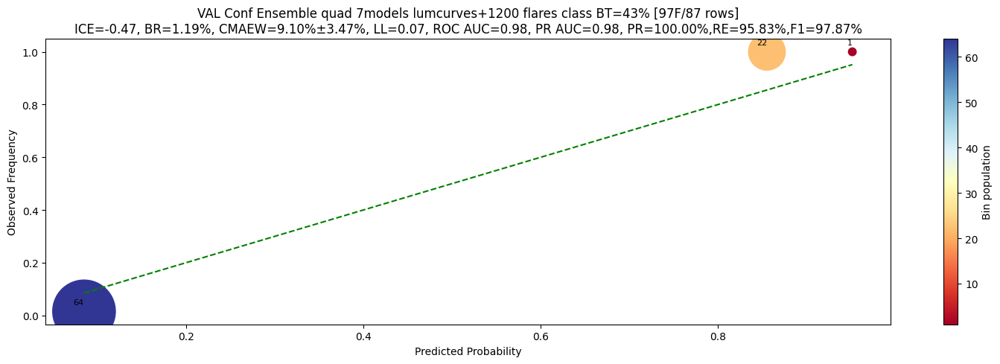

VAL Conf Ensemble quad 7models lumcurves+1200 flares class BT=43%
              precision    recall  f1-score   support

           0     0.9844    1.0000    0.9921        63
           1     1.0000    0.9583    0.9787        24

    accuracy                         0.9885        87
   macro avg     0.9922    0.9792    0.9854        87
weighted avg     0.9887    0.9885    0.9884        87

ROC AUCs: 1=0.9828
PR AUCs: 1=0.9783
CALIBRATIONs: 
	1: MAEW=9.10%, STD=3.47%, COV=30%
BRIER LOSSes: 
	1=1.1938%
LOG_LOSSes: 
	1=0.0713
ICEs: 
	1=-0.4749
TOTAL INTEGRAL ERROR: -0.4749
ens member 0 excluded due to high distance from the median, mae=0.067589, std=0.106103
ens member 1 excluded due to high distance from the median, mae=0.051010, std=0.081614
ens member 2 excluded due to high distance from the median, mae=0.049071, std=0.077706
ens member 3 excluded due to high distance from the median, mae=0.165514, std=0.135212
ens member 4 excluded due to high distance from the median, mae=0.105180, s

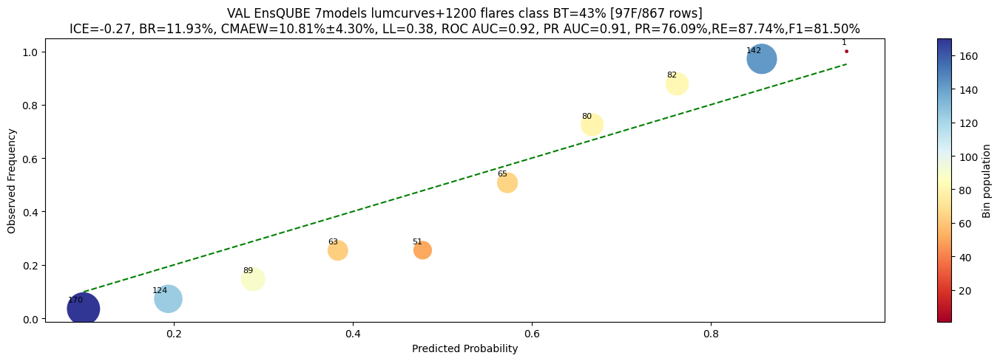

VAL EnsQUBE 7models lumcurves+1200 flares class BT=43%
              precision    recall  f1-score   support

           0     0.9029    0.8051    0.8512       508
           1     0.7609    0.8774    0.8150       359

    accuracy                         0.8351       867
   macro avg     0.8319    0.8413    0.8331       867
weighted avg     0.8441    0.8351    0.8362       867

ROC AUCs: 1=0.9220
PR AUCs: 1=0.9052
CALIBRATIONs: 
	1: MAEW=10.81%, STD=4.30%, COV=100%
BRIER LOSSes: 
	1=11.9322%
LOG_LOSSes: 
	1=0.3834
ICEs: 
	1=-0.2654
TOTAL INTEGRAL ERROR: -0.2654


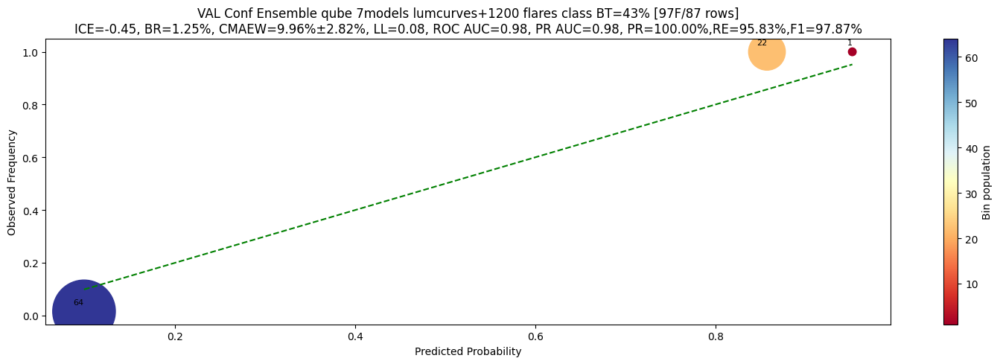

VAL Conf Ensemble qube 7models lumcurves+1200 flares class BT=43%
              precision    recall  f1-score   support

           0     0.9844    1.0000    0.9921        63
           1     1.0000    0.9583    0.9787        24

    accuracy                         0.9885        87
   macro avg     0.9922    0.9792    0.9854        87
weighted avg     0.9887    0.9885    0.9884        87

ROC AUCs: 1=0.9769
PR AUCs: 1=0.9753
CALIBRATIONs: 
	1: MAEW=9.96%, STD=2.82%, COV=30%
BRIER LOSSes: 
	1=1.2543%
LOG_LOSSes: 
	1=0.0779
ICEs: 
	1=-0.4526
TOTAL INTEGRAL ERROR: -0.4526
ens member 0 excluded due to high distance from the median, mae=0.067589, std=0.106103
ens member 1 excluded due to high distance from the median, mae=0.051010, std=0.081614
ens member 2 excluded due to high distance from the median, mae=0.049071, std=0.077706
ens member 3 excluded due to high distance from the median, mae=0.165514, std=0.135212
ens member 4 excluded due to high distance from the median, mae=0.105180, s

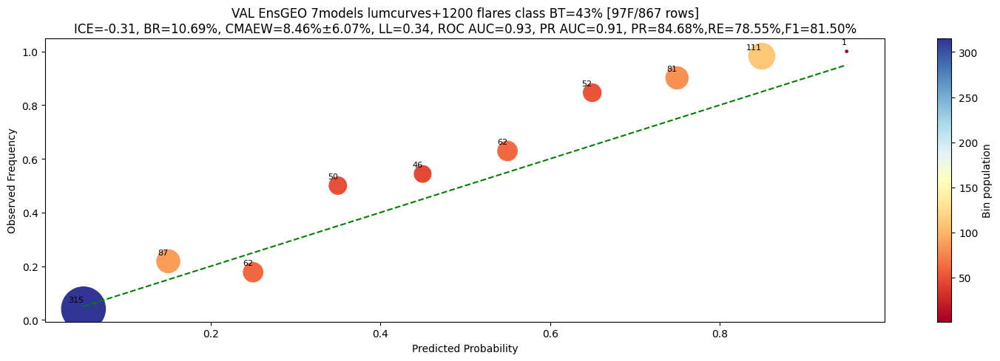

VAL EnsGEO 7models lumcurves+1200 flares class BT=43%
              precision    recall  f1-score   support

           0     0.8558    0.8996    0.8772       508
           1     0.8468    0.7855    0.8150       359

    accuracy                         0.8524       867
   macro avg     0.8513    0.8426    0.8461       867
weighted avg     0.8521    0.8524    0.8514       867

ROC AUCs: 1=0.9274
PR AUCs: 1=0.9054
CALIBRATIONs: 
	1: MAEW=8.46%, STD=6.07%, COV=100%
BRIER LOSSes: 
	1=10.6871%
LOG_LOSSes: 
	1=0.3438
ICEs: 
	1=-0.3136
TOTAL INTEGRAL ERROR: -0.3136


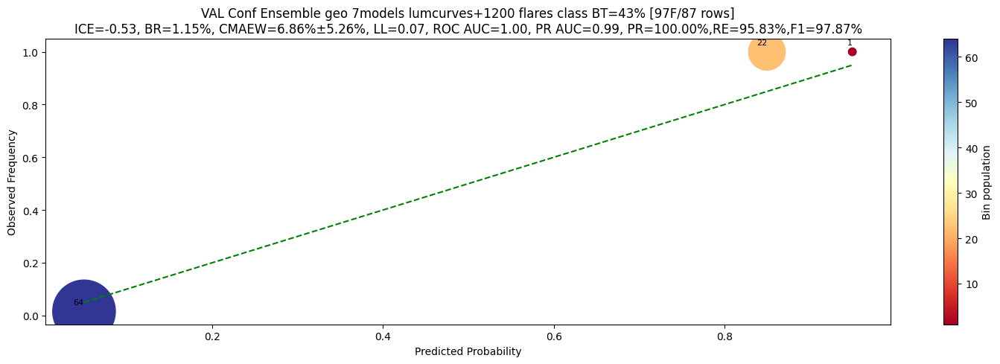

VAL Conf Ensemble geo 7models lumcurves+1200 flares class BT=43%
              precision    recall  f1-score   support

           0     0.9844    1.0000    0.9921        63
           1     1.0000    0.9583    0.9787        24

    accuracy                         0.9885        87
   macro avg     0.9922    0.9792    0.9854        87
weighted avg     0.9887    0.9885    0.9884        87

ROC AUCs: 1=0.9954
PR AUCs: 1=0.9906
CALIBRATIONs: 
	1: MAEW=6.86%, STD=5.26%, COV=30%
BRIER LOSSes: 
	1=1.1471%
LOG_LOSSes: 
	1=0.0656
ICEs: 
	1=-0.5267
TOTAL INTEGRAL ERROR: -0.5267


2026-01-13 00:50:37,815 - INFO - log_phase-line:44 - ----------------------------------------------------------------------------------------------------------------------------------------------------------------
2026-01-13 00:50:37,821 - INFO - log_phase-line:45 - Training suite completed for flares, 7 models.
2026-01-13 00:50:37,828 - INFO - log_phase-line:46 - ----------------------------------------------------------------------------------------------------------------------------------------------------------------
2026-01-13 00:50:37,831 - INFO - log_ram_usage-line:39 - Done. RAM usage: 0.0GB.


time: 17min 40s (started: 2026-01-13 00:32:56 +03:00)


In [38]:
target_name = "lumcurves+1200"

ft_extractor = SimpleFeaturesAndTargetsExtractor(
    classification_targets=["class"],
    columns_to_drop=set(["id", "ts", "source", "dataset", "_orig_idx"]),
    verbose=1,
)

mlframe_models, metadata = train_mlframe_models_suite(
    df=labeled_df_train.to_pandas(),
    target_name=target_name,
    model_name=f"flares",
    features_and_targets_extractor=ft_extractor,
    mlframe_models="cb xgb lgb ngb hgb linear mlp".split(),
    init_common_params={"show_perf_chart": True, "show_fi": True},
    use_ordinary_models=True,
    pipeline_config=PolarsPipelineConfig(use_polarsds_pipeline=False),
    split_config=TrainingSplitConfig(
        shuffle_val=True, shuffle_test=True, test_size=0.0, val_size=0.1
    ),
    config_params_override={
        "iterations": 5000,
        "early_stopping_rounds": 500,
    },
    use_mlframe_ensembles=True,
    data_dir="data",
    # models_dir=None,
    verbose=True,
)

In [36]:
models = {}
metrics = {}
training_times = {}
predicting_times = {}

from timeit import default_timer as timer

time: 0 ns (started: 2026-01-13 00:31:23 +03:00)


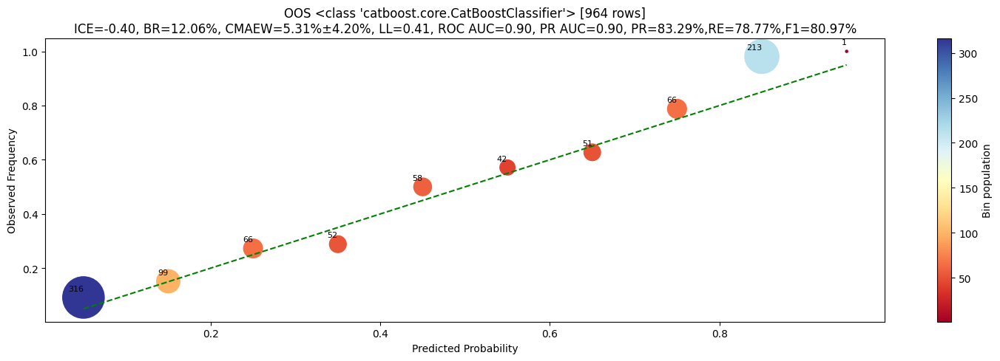

OOS <class 'catboost.core.CatBoostClassifier'>
              precision    recall  f1-score   support

           0       0.84      0.88      0.86       540
           1       0.83      0.79      0.81       424

    accuracy                           0.84       964
   macro avg       0.84      0.83      0.83       964
weighted avg       0.84      0.84      0.84       964

ROC AUCs: 1=0.90
PR AUCs: 1=0.90
CALIBRATIONs: 
	1: MAEW=5.31%, STD=4.20%, COV=90%
BRIER LOSSes: 
	1=12.06%
LOG_LOSSes: 
	1=0.41
ICEs: 
	1=-0.40
TOTAL INTEGRAL ERROR: 0.0000


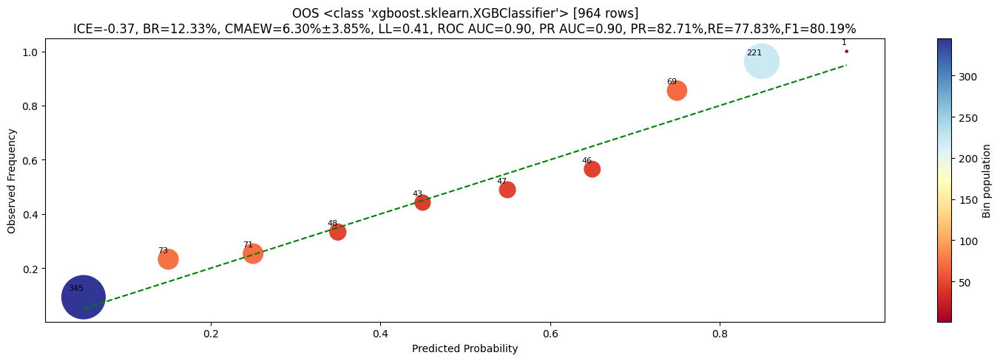

OOS <class 'xgboost.sklearn.XGBClassifier'>
              precision    recall  f1-score   support

           0       0.83      0.87      0.85       540
           1       0.83      0.78      0.80       424

    accuracy                           0.83       964
   macro avg       0.83      0.83      0.83       964
weighted avg       0.83      0.83      0.83       964

ROC AUCs: 1=0.90
PR AUCs: 1=0.90
CALIBRATIONs: 
	1: MAEW=6.30%, STD=3.85%, COV=100%
BRIER LOSSes: 
	1=12.33%
LOG_LOSSes: 
	1=0.41
ICEs: 
	1=-0.37
TOTAL INTEGRAL ERROR: 0.0000


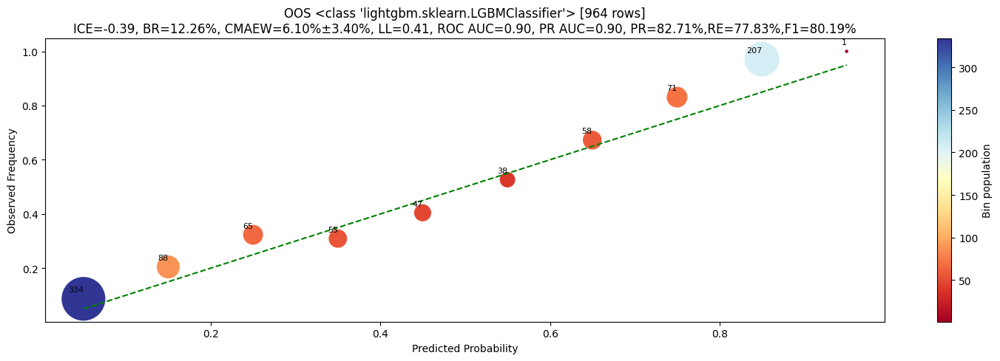

OOS <class 'lightgbm.sklearn.LGBMClassifier'>
              precision    recall  f1-score   support

           0       0.83      0.87      0.85       540
           1       0.83      0.78      0.80       424

    accuracy                           0.83       964
   macro avg       0.83      0.83      0.83       964
weighted avg       0.83      0.83      0.83       964

ROC AUCs: 1=0.90
PR AUCs: 1=0.90
CALIBRATIONs: 
	1: MAEW=6.10%, STD=3.40%, COV=100%
BRIER LOSSes: 
	1=12.26%
LOG_LOSSes: 
	1=0.41
ICEs: 
	1=-0.39
TOTAL INTEGRAL ERROR: 0.0000


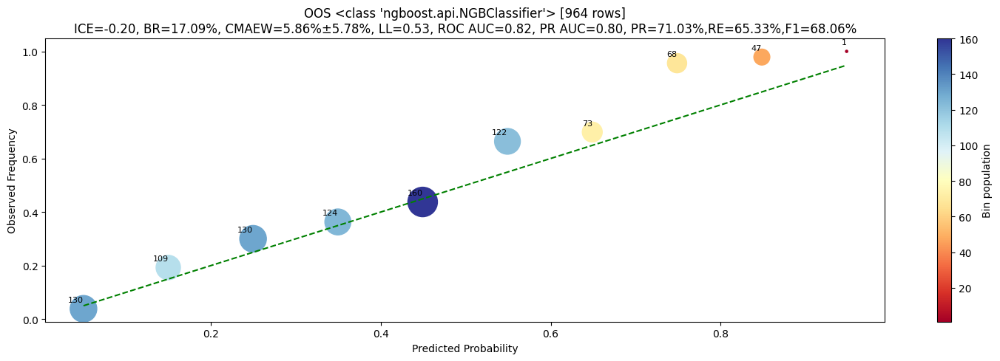

OOS <class 'ngboost.api.NGBClassifier'>
              precision    recall  f1-score   support

           0       0.74      0.79      0.77       540
           1       0.71      0.65      0.68       424

    accuracy                           0.73       964
   macro avg       0.73      0.72      0.72       964
weighted avg       0.73      0.73      0.73       964

ROC AUCs: 1=0.82
PR AUCs: 1=0.80
CALIBRATIONs: 
	1: MAEW=5.86%, STD=5.78%, COV=100%
BRIER LOSSes: 
	1=17.09%
LOG_LOSSes: 
	1=0.53
ICEs: 
	1=-0.20
TOTAL INTEGRAL ERROR: 0.0000


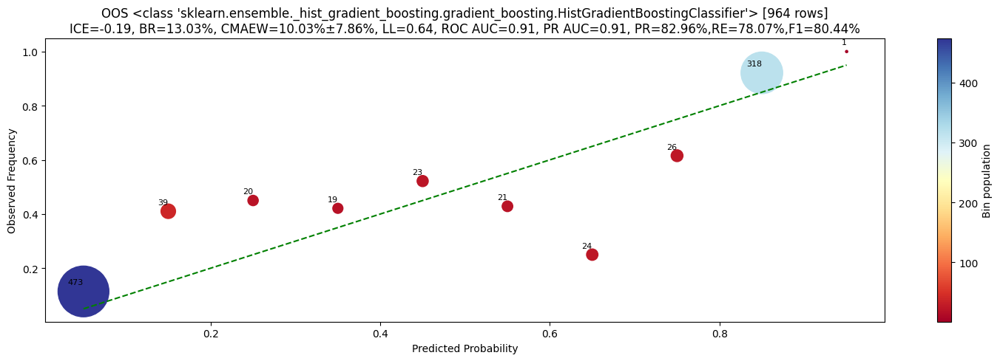

OOS <class 'sklearn.ensemble._hist_gradient_boosting.gradient_boosting.HistGradientBoostingClassifier'>
              precision    recall  f1-score   support

           0       0.84      0.87      0.85       540
           1       0.83      0.78      0.80       424

    accuracy                           0.83       964
   macro avg       0.83      0.83      0.83       964
weighted avg       0.83      0.83      0.83       964

ROC AUCs: 1=0.91
PR AUCs: 1=0.91
CALIBRATIONs: 
	1: MAEW=10.03%, STD=7.86%, COV=100%
BRIER LOSSes: 
	1=13.03%
LOG_LOSSes: 
	1=0.64
ICEs: 
	1=-0.19
TOTAL INTEGRAL ERROR: 0.0000


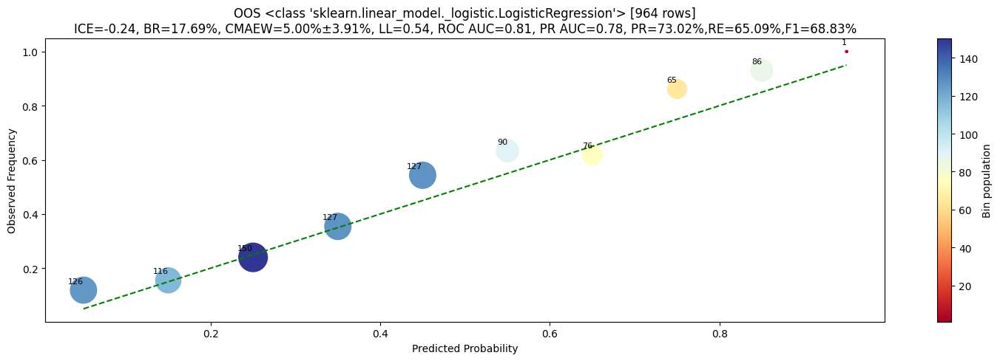

2026-01-13 00:31:31,101 - WARNING - _predict_raw-line:419 - No datamodule found from training. Creating temporary datamodule for prediction.
2026-01-13 00:31:31,104 - INFO - _predict_raw-line:424 - Using batch_size=64 for prediction


OOS <class 'sklearn.linear_model._logistic.LogisticRegression'>
              precision    recall  f1-score   support

           0       0.75      0.81      0.78       540
           1       0.73      0.65      0.69       424

    accuracy                           0.74       964
   macro avg       0.74      0.73      0.73       964
weighted avg       0.74      0.74      0.74       964

ROC AUCs: 1=0.81
PR AUCs: 1=0.78
CALIBRATIONs: 
	1: MAEW=5.00%, STD=3.91%, COV=100%
BRIER LOSSes: 
	1=17.69%
LOG_LOSSes: 
	1=0.54
ICEs: 
	1=-0.24
TOTAL INTEGRAL ERROR: 0.0000


2026-01-13 00:31:31,617 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2026-01-13 00:31:31,621 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2026-01-13 00:31:31,625 - INFO - _info-line:64 - IPU available: False, using: 0 IPUs
2026-01-13 00:31:31,628 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2026-01-13 00:31:31,638 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
R:\ProgramData\anaconda3\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:441: The 'predict_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
2026-01-13 00:31:31,817 - INFO - _predict_raw-line:506 - Generated predictions with shape (964, 2)


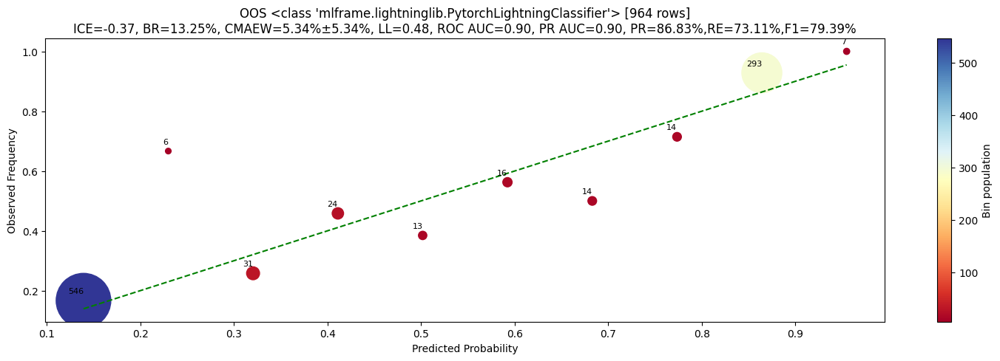

OOS <class 'mlframe.lightninglib.PytorchLightningClassifier'>
              precision    recall  f1-score   support

           0       0.81      0.91      0.86       540
           1       0.87      0.73      0.79       424

    accuracy                           0.83       964
   macro avg       0.84      0.82      0.83       964
weighted avg       0.84      0.83      0.83       964

ROC AUCs: 1=0.90
PR AUCs: 1=0.90
CALIBRATIONs: 
	1: MAEW=5.34%, STD=5.34%, COV=100%
BRIER LOSSes: 
	1=13.25%
LOG_LOSSes: 
	1=0.48
ICEs: 
	1=-0.37
TOTAL INTEGRAL ERROR: 0.0000
time: 8.14 s (started: 2026-01-13 00:31:24 +03:00)


In [37]:
temp_df = labeled_df_test.select(
    mlframe_models["class"]["binary_classification"][0].columns
).to_pandas()
for mlframe_model in mlframe_models["class"]["binary_classification"]:
    model = mlframe_model.model
    key = f"{type(model)}"

    models[key] = model
    if mlframe_model.pre_pipeline:
        tmp = mlframe_model.pre_pipeline.transform(temp_df)
    else:
        tmp = temp_df

    probs = model.predict_proba(tmp)

    metrics[key] = {}

    _, _ = report_model_perf(
        targets=targets,
        columns=None,
        df=None,
        model_name=key,
        model=None,
        target_label_encoder=None,
        preds=None,
        probs=probs,
        plot_file=join(charts_dir, key) if charts_dir else None,
        metrics=metrics[key],
        group_ids=None,
        **report_params,
    )